# Phase 3 - Modeling

**Note 1: the following starting code only generates a single random train/test split when default_seed is used. You need to modify the code to generate 100 independent train/test splits with different seeds and report the average results on those independent splits along with standard deviation.**

**Note 2: You are completely free to use your own implementation.**

In [56]:
# Load general utilities
# ----------------------
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.axes as ax
import datetime
import numpy as np
import pickle
import time
import seaborn as sns

# Load sklearn utilities
# ----------------------
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import accuracy_score, classification_report, roc_auc_score, roc_curve, brier_score_loss, mean_squared_error, r2_score

from sklearn.calibration import calibration_curve

# Load classifiers
# ----------------
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import RidgeClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import BaggingClassifier

# Other Packages
# --------------
from scipy.stats import kendalltau
from sklearn.neural_network import MLPRegressor
from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor
from sklearn.cluster import KMeans
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
from scipy.interpolate import spline

# Load debugger, if required
#import pixiedust
pd.options.mode.chained_assignment = None #'warn'

# suppress all warnings
import warnings
warnings.filterwarnings("ignore")

In [57]:
# Define a function that, given a CVGridSearch object, finds the
# percentage difference between the best and worst scores
def find_score_variation(cv_model):
    all_scores = cv_model.cv_results_['mean_test_score']
    return( np.abs((max(all_scores) - min(all_scores))) * 100 / max(all_scores) )

    '''
    which_min_score = np.argmin(all_scores)
    
    all_perc_diff = []
    
    try:
        all_perc_diff.append( np.abs(all_scores[which_min_score - 1] - all_scores[which_min_score])*100 / min(all_scores) )
    except:
        pass
    
    try:
        all_perc_diff.append( np.abs(all_scores[which_min_score + 1] - all_scores[which_min_score])*100 / min(all_scores) )
    except:
        pass
    
    return ( np.mean(all_perc_diff) )
    '''

# Define a function that checks, given a CVGridSearch object,
# whether the optimal parameters lie on the edge of the search
# grid
def find_opt_params_on_edge(cv_model):
    out = False
    
    for i in cv_model.param_grid:
        if cv_model.best_params_[i] in [ cv_model.param_grid[i][0], cv_model.param_grid[i][-1] ]:
            out = True
            break
            
    return out

## Define a default random seed and an output file

In [58]:
default_seed = 1
output_file = "output_sample"

In [59]:
# Create a function to print a line to our output file

def dump_to_output(key, value):
    with open(output_file, "a") as f:
        f.write(",".join([str(default_seed), key, str(value)]) + "\n")

## Load the data and engineer the features

In [60]:
# Read the data and features from the pickle file saved in CS-Phase 2
data, discrete_features, continuous_features, ret_cols = pickle.load( open( "clean_data.pickle", "rb" ) )

In [61]:
data.head()

,id,loan_amnt,funded_amnt,term,int_rate,installment,grade,emp_length,home_ownership,annual_inc,...,revol_util,total_pymnt,last_pymnt_d,recoveries,loan_length,term_num,ret_PESS,ret_OPT,ret_INTa,ret_INTb
0,1077501,5000.0,5000.0,36 months,10.65,162.87,B,10+ years,RENT,24000.0,...,83.7,5863.155187,2015-01-01,0.0,37.027454,36,0.057544,0.055947,0.054598,0.088129
1,1077430,2500.0,2500.0,60 months,15.27,59.83,C,< 1 year,RENT,30000.0,...,9.4,1014.530000,2013-04-01,122.9,16.000329,60,-0.128670,-0.128670,-0.110200,-0.095511
2,1077175,2400.0,2400.0,36 months,15.96,84.33,C,10+ years,RENT,12252.0,...,98.5,3005.666844,2014-06-01,0.0,29.996509,36,0.084120,0.100956,0.073804,0.113010
3,1076863,10000.0,10000.0,36 months,13.49,339.31,C,10+ years,RENT,49200.0,...,21.0,12231.890000,2015-01-01,0.0,37.027454,36,0.074396,0.072332,0.065575,0.100551
4,1075358,3000.0,3000.0,60 months,12.69,67.79,B,1 year,RENT,80000.0,...,53.9,4066.908161,2017-01-01,0.0,61.044375,60,0.071127,0.069910,0.087466,0.114497


In [62]:
## Create the outcome columns: True if loan_status is either Charged Off or Default, False otherwise
data['outcome'] = (data.loan_status == 'Charged Off') | (data.loan_status == 'Default')

In [63]:
# Create a feature for the length of a person's credit history at the time the loan is issued
data['cr_hist'] = (data.issue_d - data.earliest_cr_line) / np.timedelta64(1, 'M')
continuous_features.append('cr_hist')

In [64]:
# Randomly assign each row to a training and test set. We do this now because we will be fitting a variety of models on various time periods, and we would like every period to use the *same* training/test split
np.random.seed(default_seed)
## create the train columns where the value is True if it is a train instance and False otherwise. Hint: use np.random.choice with 70% for training and 30% for testing
data['train'] = np.random.rand(len(data))<0.7

In [65]:
# Create a matrix of features and outcomes, with dummies. Record the names of the dummies for later use
X_continuous = data[continuous_features].values

X_discrete = pd.get_dummies(data[discrete_features], dummy_na = True, prefix_sep = "::", drop_first = True)
discrete_features_dummies = X_discrete.columns.tolist()
X_discrete = X_discrete.values

X = np.concatenate( (X_continuous, X_discrete), axis = 1 )

y = data.outcome.values

train = data.train.values

## Prepare functions to fit and evaluate models

In [66]:
def prepare_data(data_subset = np.array([True]*len(data)),
                    n_samples_train = 30000,
                    n_samples_test = 20000,
                    feature_subset = None,
                    date_range_train = (data.issue_d.min(), data.issue_d.max()),
                    date_range_test = (data.issue_d.min(), data.issue_d.max()),
                    random_state = default_seed):
    '''
    This function will prepare the data for classification or regression.
    It expects the following parameters:
      - data_subset: a numpy array with as many entries as rows in the
                     dataset. Each entry should be True if that row
                     should be used, or False if it should be ignored
      - n_samples_train: the total number of samples to be used for training.
                         Will trigger an error if this number is larger than
                         the number of rows available after all filters have
                         been applied
      - n_samples_test: as above for testing
      - feature_subect: A list containing the names of the features to be
                        used in the model. In None, all features in X are
                        used
      - date_range_train: a tuple containing two dates. All rows with loans
                          issued outside of these two dates will be ignored in
                          training
      - date_range_test: as above for testing
      - random_state: the random seed to use when selecting a subset of rows
      
    Note that this function assumes the data has a "Train" column, and will
    select all training rows from the rows with "True" in that column, and all
    the testing rows from those with a "False" in that column.
    
    This function returns a dictionary with the following entries
      - X_train: the matrix of training data
      - y_train: the array of training labels
      - train_set: a Boolean vector with as many entries as rows in the data
                  that denotes the rows that were used in the train set
      - X_test: the matrix of testing data
      - y_test: the array of testing labels
      - test_set: a Boolean vector with as many entries as rows in the data
                  that denotes the rows that were used in the test set
    '''
    
    np.random.seed(random_state)
        
    # Filter down the data to the required date range, and downsample
    # as required
    filter_train = ( train & (data.issue_d >= date_range_train[0]) &
                            (data.issue_d <= date_range_train[1]) & data_subset ).values
    filter_test = ( (train == False) & (data.issue_d >= date_range_test[0])
                            & (data.issue_d <= date_range_test[1]) & data_subset ).values
    
    filter_train[ np.random.choice( np.where(filter_train)[0], size = filter_train.sum()
                                                   - n_samples_train, replace = False ) ] = False
    filter_test[ np.random.choice( np.where(filter_test)[0], size = filter_test.sum()
                                                   - n_samples_test, replace = False ) ] = False
    
    # Prepare the training and test set
    X_train = X[ filter_train , :]
    X_test = X[ filter_test, :]
    if feature_subset != None:
        cols = [i for i, j in enumerate(continuous_features + discrete_features_dummies)
                                                     if j.split("::")[0] in feature_subset]
        X_train = X_train[ : , cols ]
        X_test = X_test[ : , cols ]
        
    y_train = y[ filter_train ]
    y_test = y[ filter_test ]
    
    # Scale the variables
    scaler = preprocessing.MinMaxScaler()

    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    
    # return training and testing data
    out = {'X_train':X_train, 'y_train':y_train, 'train_set':filter_train, 
           'X_test':X_test, 'y_test':y_test, 'test_set':filter_test}
    
    return out

In [80]:
def fit_classification(model, data_dict,
                          cv_parameters = {},
                          model_name = None,
                          random_state = default_seed,
                          output_to_file = True,
                          print_to_screen = True):
    '''
    This function will fit a classification model to data and print various evaluation
    measures. It expects the following parameters
      - model: an sklearn model object
      - data_dict: the dictionary containing both training and testing data;
                   returned by the prepare_data function
      - cv_parameters: a dictionary of parameters that should be optimized
                       over using cross-validation. Specifically, each named
                       entry in the dictionary should correspond to a parameter,
                       and each element should be a list containing the values
                       to optimize over
      - model_name: the name of the model being fit, for printouts
      - random_state: the random seed to use
      - output_to_file: if the results will be saved to the output file
      - print_to_screen: if the results will be printed on screen
    
    If the model provided does not have a predict_proba function, we will
    simply print accuracy diagnostics and return.
    
    If the model provided does have a predict_proba function, we first
    figure out the optimal threshold that maximizes the accuracy and
    print out accuracy diagnostics. We then print an ROC curve, sensitivity/
    specificity curve, and calibration curve.
    
    This function returns a dictionary with the following entries
      - model: the best fitted model
      - y_pred: predictions for the test set
      - y_pred_probs: probability predictions for the test set, if the model
                      supports them
      - y_pred_score: prediction scores for the test set, if the model does not 
                      output probabilities.
    '''
        
    np.random.seed(random_state)
    
    # --------------------------
    #   Step 1 - Load the data
    # --------------------------
    X_train = data_dict['X_train']
    y_train = data_dict['y_train']
    
    X_test = data_dict['X_test']
    y_test = data_dict['y_test']
    
    filter_train = data_dict['train_set']    
  
    # --------------------------
    #   Step 2 - Fit the model
    # --------------------------

    cv_model = GridSearchCV(model, cv_parameters, scoring = 'f1_macro',n_jobs=-1)
    
    start_time = time.time()
    cv_model.fit(X_train, y_train)
    end_time = time.time()
    
    best_model = cv_model.best_estimator_
    
    if print_to_screen:

        if model_name != None:
            print("=========================================================")
            print("  Model: " + model_name)
            print("=========================================================")

        print("Fit time: " + str(round(end_time - start_time, 2)) + " seconds")
        print("Optimal parameters:")
        print(cv_model.best_params_)
        print("")
    
    # -------------------------------
    #   Step 3 - Evaluate the model
    # -------------------------------
    
    # If possible, make probability predictions
    try:
        y_pred_probs = best_model.predict_proba(X_test)[:,1]
        fpr, tpr, thresholds = roc_curve(y_test, y_pred_probs)
        
        probs_predicted = True
    except:
        probs_predicted = False
    
    # Make predictions; if we were able to find probabilities, use
    # the threshold that maximizes the accuracy in the training set.
    # If not, just use the learner's predict function
    if probs_predicted:
        y_train_pred_probs = best_model.predict_proba(X_train)[:,1]
        fpr_train, tpr_train, thresholds_train = roc_curve(y_train, y_train_pred_probs)
        
        true_pos_train = tpr_train*(y_train.sum())
        true_neg_train = (1 - fpr_train) *(1-y_train).sum()
        
        best_threshold_index = np.argmax(true_pos_train + true_neg_train)
        best_threshold = 1 if best_threshold_index == 0 else thresholds_train[ best_threshold_index ]
        
        if print_to_screen:
            print("Accuracy-maximizing threshold was: " + str(best_threshold))
        
        y_pred = (y_pred_probs > best_threshold)
    else:
        y_pred = best_model.predict(X_test)
    
    if print_to_screen:
        print("Accuracy: ", accuracy_score(y_test, y_pred))
        print(classification_report(y_test, y_pred, target_names =['No default', 'Default'], digits = 4))

    if print_to_screen:
        if probs_predicted:        
            plt.figure(figsize = (13, 4.5))
            plt.subplot(2, 2, 1)

            plt.title("ROC Curve (AUC = %0.2f)"% roc_auc_score(y_test, y_pred_probs))
            plt.plot(fpr, tpr, 'b')
            plt.plot([0,1],[0,1],'r--')
            plt.xlim([0,1]); plt.ylim([0,1])
            plt.ylabel('True Positive Rate')
            plt.xlabel('False Positive Rate')

            plt.subplot(2, 2, 3)

            plt.plot(thresholds, tpr, 'b', label = 'Sensitivity')
            plt.plot(thresholds, 1 -fpr, 'r', label = 'Specificity')
            plt.legend(loc = 'lower right')
            plt.xlim([0,1]); plt.ylim([0,1])
            plt.xlabel('Threshold')

            plt.subplot(2, 2, 2)

            fp_0, mpv_0 = calibration_curve(y_test, y_pred_probs, n_bins = 10)
            plt.plot([0,1], [0,1], 'k:', label='Perfectly calibrated')
            plt.plot(mpv_0, fp_0, 's-')
            plt.ylabel('Fraction of Positives')
            plt.xlim([0,1]); plt.ylim([0,1])
            plt.legend(loc ='upper left')
            
            plt.subplot(2, 2, 4)
            plt.hist(y_pred_probs, range=(0, 1), bins=10, histtype="step", lw=2)
            plt.xlim([0,1]); plt.ylim([0,20000])
            plt.xlabel('Mean Predicted Probability')
            plt.ylabel('Count')
            
            #plt.tight_layout()
            plt.show()
        
    # Additional Score Check
    if probs_predicted:
        y_train_score = y_train_pred_probs
    else:
        y_train_score = best_model.decision_function(X_train)
        
    tau, p_value = kendalltau(y_train_score, data.grade[filter_train])
    if print_to_screen:
        print("")
        print("Similarity to LC grade ranking: ", tau)
    
    if probs_predicted:
        brier_score = brier_score_loss(y_test, y_pred_probs)
        if print_to_screen:
            print("Brier score:", brier_score)
    
    # Return the model predictions, and the
    # test set
    # -------------------------------------
    out = {'model':best_model, 'y_pred_labels':y_pred}
    
    if probs_predicted:
        out.update({'y_pred_probs':y_pred_probs})
    else:
        y_pred_score = best_model.decision_function(X_test)
        out.update({'y_pred_score':y_pred_score})
        
    # Output results to file
    # ----------------------
    if probs_predicted and output_to_file:
        # Check whether any of the CV parameters are on the edge of
        # the search space
        opt_params_on_edge = find_opt_params_on_edge(cv_model)
        dump_to_output(model_name + "::search_on_edge", opt_params_on_edge)
        if print_to_screen:
            print("Were parameters on edge? : " + str(opt_params_on_edge))
        
        # Find out how different the scores are for the different values
        # tested for by cross-validation. If they're not too different, then
        # even if the parameters are off the edge of the search grid, we should
        # be ok
        score_variation = find_score_variation(cv_model)
        dump_to_output(model_name + "::score_variation", score_variation)
        if print_to_screen:
            print("Score variations around CV search grid : " + str(score_variation))
        
        # Print out all the scores
        dump_to_output(model_name + "::all_cv_scores", str(cv_model.cv_results_['mean_test_score']))
        if print_to_screen:
            print( str(cv_model.cv_results_['mean_test_score']) )
        
        # Dump the AUC to file
        dump_to_output(model_name + "::roc_auc", roc_auc_score(y_test, y_pred_probs) )
        
    return out

## Train and Test different machine learning classification models

The machine learning models listed in the following are just our suggestions. You are free to try any other models that you would like to experiment with.

In [81]:
## define your set of features to use in different models
your_features = set(continuous_features + discrete_features_dummies)
# prepare the train, test data for training models
data_dict = prepare_data(feature_subset = your_features)

all_features = pd.Series(continuous_features + discrete_features_dummies)
idx = [i for i, j in enumerate(continuous_features + discrete_features_dummies)
                                                     if j.split("::")[0] in your_features]
selected_features = all_features[idx]
selected_features.reset_index(drop=True,inplace=True)

### Baseline

In [92]:
from sklearn.dummy import DummyClassifier
data_dict = prepare_data(feature_subset = your_features)

  Model: DUMMY
Fit time: 0.11 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.8114
              precision    recall  f1-score   support

  No default     0.8114    1.0000    0.8959     16228
     Default     0.0000    0.0000    0.0000      3772

   micro avg     0.8114    0.8114    0.8114     20000
   macro avg     0.4057    0.5000    0.4479     20000
weighted avg     0.6584    0.8114    0.7269     20000



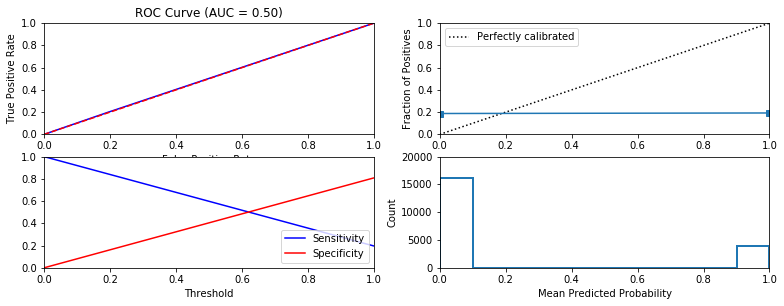


Similarity to LC grade ranking:  0.005030723098100823
Brier score: 0.307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.50416349]


In [93]:
dummy = DummyClassifier()
dummy = fit_classification(dummy,model_name="DUMMY",data_dict = data_dict)

### Naive Bayes

  Model: GNB
Fit time: 0.8 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.8114
              precision    recall  f1-score   support

  No default     0.8114    1.0000    0.8959     16228
     Default     0.0000    0.0000    0.0000      3772

   micro avg     0.8114    0.8114    0.8114     20000
   macro avg     0.4057    0.5000    0.4479     20000
weighted avg     0.6584    0.8114    0.7269     20000



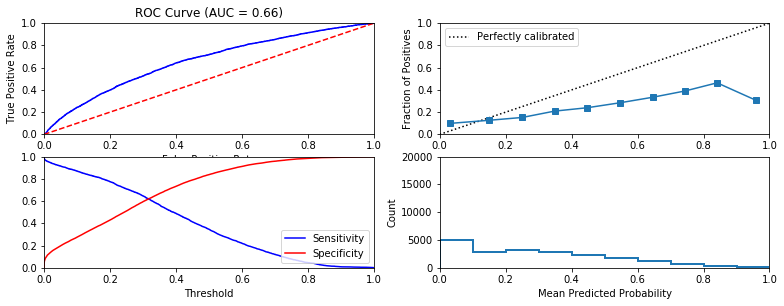


Similarity to LC grade ranking:  0.5648107600667457
Brier score: 0.1763051355973664
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.58147937]


In [94]:
## Train and test a naive bayes classifier

gnb = GaussianNB()
gnb = fit_classification(gnb,model_name="GNB",data_dict = data_dict )

### $l_1$ regularized logistic regression

  Model: L1_LOGIT
Fit time: 3.78 seconds
Optimal parameters:
{'C': 10000}

Accuracy-maximizing threshold was: 0.5107994284810536
Accuracy:  0.81135
              precision    recall  f1-score   support

  No default     0.8136    0.9956    0.8954     16228
     Default     0.4965    0.0186    0.0358      3772

   micro avg     0.8114    0.8114    0.8114     20000
   macro avg     0.6550    0.5071    0.4656     20000
weighted avg     0.7538    0.8114    0.7333     20000



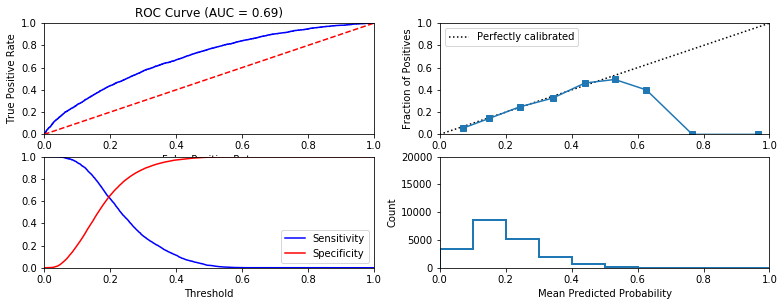


Similarity to LC grade ranking:  0.7102157025514351
Brier score: 0.1421824956421662
Were parameters on edge? : False
Score variations around CV search grid : 3.8178872387085487
[0.44669863 0.44669863 0.44669863 0.44669863 0.4491033  0.46100429
 0.46426512 0.46443005 0.46426512 0.46426512 0.46426512]


In [102]:
## Train and test a l_1 regularized logistic regression classifier

l1_logistic = LogisticRegression(penalty='l1')
cv_parameters = {'C':[0.00001,0.0001,0.001,0.01,0.1,1,1000,10000,100000,1e10,1e20]}

l1_logistic = fit_classification(l1_logistic,model_name="L1_LOGIT",cv_parameters = cv_parameters, data_dict = data_dict )

### $l_2$ regularized logistic regression

  Model: L2_LOGIT
Fit time: 0.98 seconds
Optimal parameters:
{'C': 1000}

Accuracy-maximizing threshold was: 0.5112297042756119
Accuracy:  0.81145
              precision    recall  f1-score   support

  No default     0.8136    0.9957    0.8955     16228
     Default     0.5036    0.0186    0.0358      3772

   micro avg     0.8115    0.8115    0.8115     20000
   macro avg     0.6586    0.5072    0.4657     20000
weighted avg     0.7551    0.8115    0.7334     20000



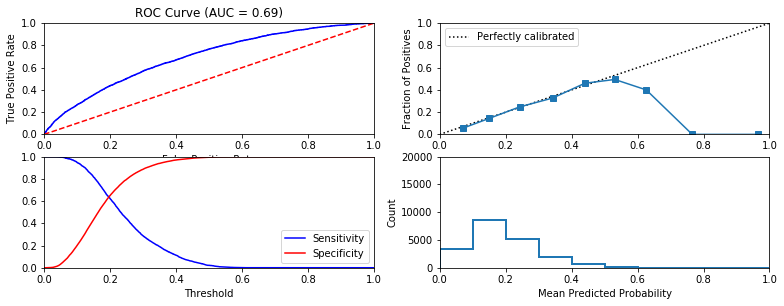


Similarity to LC grade ranking:  0.7102487910340867
Brier score: 0.1421922708863996
Were parameters on edge? : False
Score variations around CV search grid : 3.8178872387085487
[0.44669863 0.44669863 0.44669863 0.44669863 0.44806309 0.46272583
 0.46443005 0.46443005]


In [104]:
## Train and test a l_1 regularized logistic regression classifier

l2_logistic = LogisticRegression(penalty='l2')
cv_parameters = {'C':[0.00001,0.0001,0.001,0.01,0.1,10,1000,100000]}

l2_logistic = fit_classification(l2_logistic,model_name="L2_LOGIT",cv_parameters = cv_parameters, data_dict = data_dict )

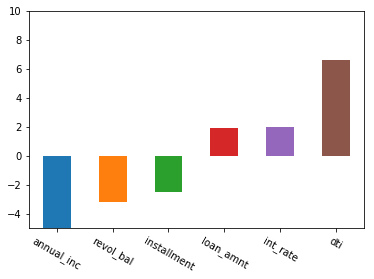

In [105]:
## plot top 3 features with the most positive (and negative) weights 
top_and_bottom_idx = list(np.argsort(l2_logistic['model'].coef_)[0,:3]) + list(np.argsort(l2_logistic['model'].coef_)[0,-3:])
bplot = pd.Series(l2_logistic['model'].coef_[0,top_and_bottom_idx])
xticks = selected_features[top_and_bottom_idx]
p1 = bplot.plot(kind='bar',rot=-30,ylim=(-5,10))
p1.set_xticklabels(xticks)
plt.show()

### Decision tree

  Model: DECISION TREE
Fit time: 2.03 seconds
Optimal parameters:
{'max_depth': None, 'max_leaf_nodes': None}

Accuracy-maximizing threshold was: 1.0
Accuracy:  0.8114
              precision    recall  f1-score   support

  No default     0.8114    1.0000    0.8959     16228
     Default     0.0000    0.0000    0.0000      3772

   micro avg     0.8114    0.8114    0.8114     20000
   macro avg     0.4057    0.5000    0.4479     20000
weighted avg     0.6584    0.8114    0.7269     20000



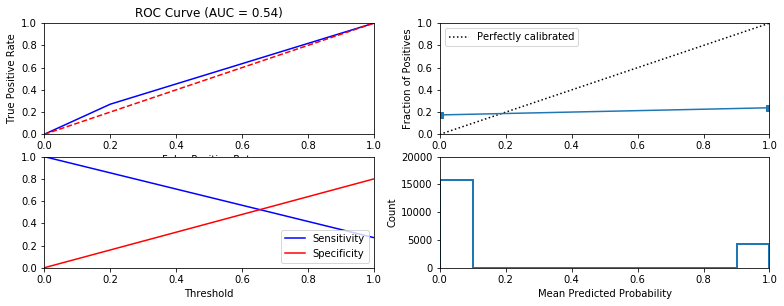


Similarity to LC grade ranking:  0.2061405434562905
Brier score: 0.3003
Were parameters on edge? : True
Score variations around CV search grid : 16.036127732604704
[0.5320129  0.44669863 0.44669863 0.45733015 0.44669863 0.44669863
 0.44669863 0.44669863 0.45421537 0.44669863 0.44669863 0.45734021
 0.49931702 0.44669863 0.44669863 0.45733015 0.52835243 0.44669863
 0.44669863 0.45733015]


In [107]:
## Train and test a decision tree classifier

decision_tree = DecisionTreeClassifier()
cv_parameters = {'max_depth':[None,2,5,10,15],'max_leaf_nodes':[None,5,10,20]}

decision_tree = fit_classification(decision_tree,model_name="DECISION TREE",cv_parameters = cv_parameters, data_dict = data_dict )

### Random forest

  Model: RF
Fit time: 71.8 seconds
Optimal parameters:
{'max_depth': None, 'n_estimators': 50}

Accuracy-maximizing threshold was: 0.48
Accuracy:  0.80605
              precision    recall  f1-score   support

  No default     0.8162    0.9821    0.8915     16228
     Default     0.3869    0.0485    0.0862      3772

   micro avg     0.8061    0.8061    0.8061     20000
   macro avg     0.6015    0.5153    0.4889     20000
weighted avg     0.7352    0.8061    0.7396     20000



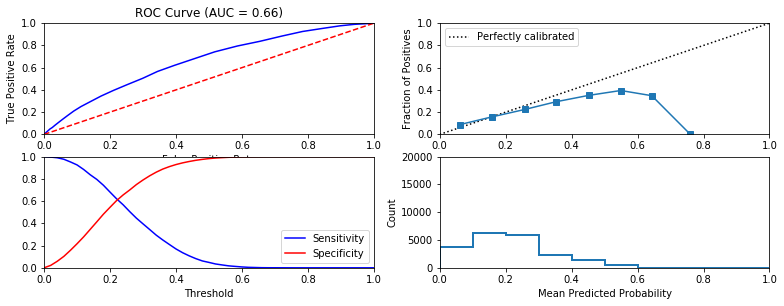


Similarity to LC grade ranking:  0.41443929790385625
Brier score: 0.14799918000000004
Were parameters on edge? : True
Score variations around CV search grid : 6.710713564519411
[0.47882072 0.4740103  0.47551672 0.47418863 0.44668843 0.44668843
 0.44669863 0.44669863 0.45379047 0.45405629 0.45296165 0.45293057
 0.47002559 0.46753096 0.46662396 0.46522923]


In [108]:
## Train and test a random forest classifier

random_forest = RandomForestClassifier()
cv_parameters = {'n_estimators':[50,100,150,200],'max_depth':[None,5,10,15]}

random_forest = fit_classification(random_forest,model_name="RF",cv_parameters = cv_parameters, data_dict = data_dict )

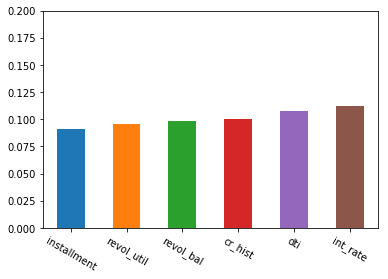

In [109]:
## Plot top 6 most significant features
top_idx = list(np.argsort(random_forest['model'].feature_importances_)[-6:]) 
bplot = pd.Series(random_forest['model'].feature_importances_[top_idx])
xticks = selected_features[top_idx]
p2 = bplot.plot(kind='bar',rot=-30,ylim=(0,0.2))
p2.set_xticklabels(xticks)
plt.show()

### Multi-layer perceptron

  Model: MLP
Fit time: 452.33 seconds
Optimal parameters:
{'alpha': 0.0001, 'hidden_layer_sizes': (50, 100, 50)}

Accuracy-maximizing threshold was: 0.44483726235624155
Accuracy:  0.796
              precision    recall  f1-score   support

  No default     0.8216    0.9562    0.8838     16228
     Default     0.3615    0.1066    0.1646      3772

   micro avg     0.7960    0.7960    0.7960     20000
   macro avg     0.5915    0.5314    0.5242     20000
weighted avg     0.7348    0.7960    0.7482     20000



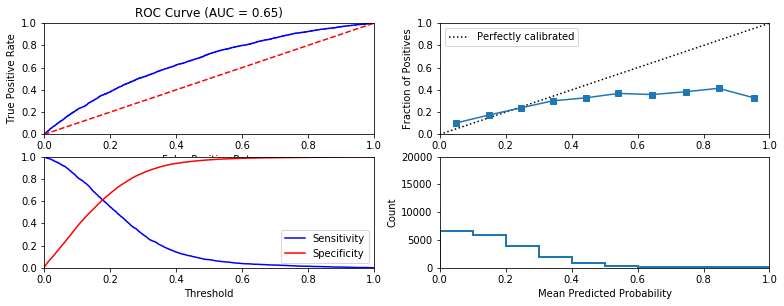


Similarity to LC grade ranking:  0.4781632810649553
Brier score: 0.15182295153179723
Were parameters on edge? : True
Score variations around CV search grid : 13.208641755232728
[0.47520892 0.51466925 0.50682486 0.45083629 0.44668843 0.44669863]


In [110]:
## Train and test a multi-layer perceptron classifier

mlp = MLPClassifier(activation='relu')
cv_parameters = {
    'hidden_layer_sizes': [(50,50), (50,100,50),(50,100,100,50)],
    'alpha': [0.0001, 0.05],
}

mlp = fit_classification(mlp,model_name="MLP",cv_parameters = cv_parameters, data_dict = data_dict )

## Train and Test logistic regression model with features derived by LendingClub

  Model: LC1_ONLY_LOGIT
Fit time: 0.4 seconds
Optimal parameters:
{'C': 0.01}

Accuracy-maximizing threshold was: 1
Accuracy:  0.8054
             precision    recall  f1-score   support

 No default     0.8054    1.0000    0.8922     16108
    Default     0.0000    0.0000    0.0000      3892

avg / total     0.6487    0.8054    0.7186     20000



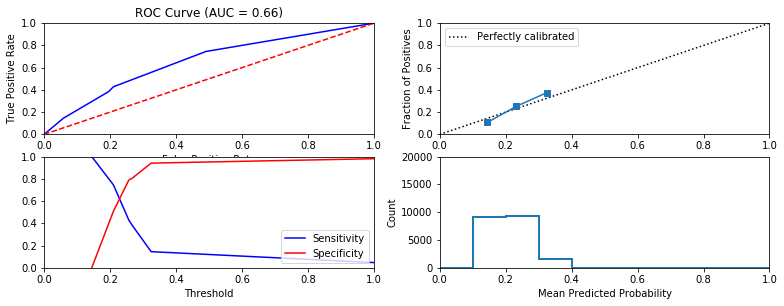


Similarity to LC grade ranking:  0.9064601721155785
Brier score: 0.14954044520834803
Were parameters on edge? : True
Score variations around CV search grid : 0.0
[0.8051 0.8051 0.8051 0.8051]


In [87]:
## Find a lendingClub-defined feature and train a l1-regularized logistic regression model on data with only that feature
a_lendingclub_feature = set(['grade'])

data_dict = prepare_data(feature_subset = a_lendingclub_feature)
lc1_only_logistic = LogisticRegression(penalty='l1')
cv_parameters = {'C':[0.01,0.1,1,10]}
lc1_only_logistic = fit_classification(lc1_only_logistic,model_name="LC1_ONLY_LOGIT",cv_parameters=cv_parameters,data_dict = data_dict)

  Model: LC2_ONLY_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{'C': 0.01}

Accuracy-maximizing threshold was: 1
Accuracy:  0.8054
             precision    recall  f1-score   support

 No default     0.8054    1.0000    0.8922     16108
    Default     0.0000    0.0000    0.0000      3892

avg / total     0.6487    0.8054    0.7186     20000



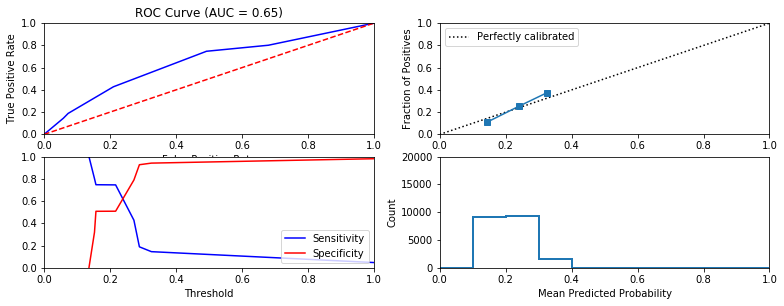


Similarity to LC grade ranking:  0.7370993011988386
Brier score: 0.14946426912497632
Were parameters on edge? : True
Score variations around CV search grid : 0.0
[0.8051 0.8051 0.8051 0.8051]


In [88]:
## train a l2-regularized logistic regression model on data with only that feature
lc2_only_logistic = LogisticRegression(penalty='l2')
cv_parameters = {'C':[0.01,0.1,1,10]}
lc2_only_logistic = fit_classification(lc2_only_logistic,model_name="LC2_ONLY_LOGIT",cv_parameters=cv_parameters,data_dict = data_dict)

## Train and test all the models you have tried previously after removing features derived by LendingClub 

  Model: DECISION TREE
Fit time: 4.53 seconds
Optimal parameters:
{'max_depth': None, 'max_leaf_nodes': 5}

Accuracy-maximizing threshold was: 1
Accuracy:  0.8054
             precision    recall  f1-score   support

 No default     0.8054    1.0000    0.8922     16108
    Default     0.0000    0.0000    0.0000      3892

avg / total     0.6487    0.8054    0.7186     20000



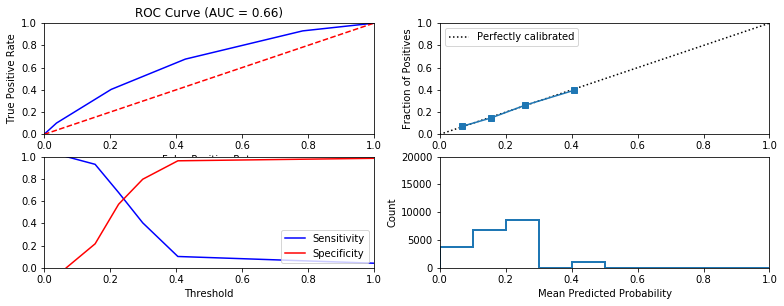


Similarity to LC grade ranking:  0.8803460424618581
Brier score: 0.14856146515486246
Were parameters on edge? : True
Score variations around CV search grid : 13.439324307539446
[0.6969     0.8051     0.8051     0.80353333 0.8051     0.8051
 0.8051     0.8051     0.80256667 0.8051     0.8051     0.8034
 0.7839     0.8051     0.8051     0.80353333 0.74623333 0.8051
 0.8051     0.80353333]


In [89]:
features = set(continuous_features + discrete_features_dummies) - set(['grade'])
data_dict = prepare_data(feature_subset = features)
decision_tree = DecisionTreeClassifier()
cv_parameters = {'max_depth':[None,2,5,10,15],'max_leaf_nodes':[None,5,10,20]}
decision_tree = fit_classification(decision_tree,model_name="DECISION TREE",cv_parameters = cv_parameters, data_dict = data_dict)

  Model: RF
Fit time: 94.97 seconds
Optimal parameters:
{'max_depth': 5, 'n_estimators': 50}

Accuracy-maximizing threshold was: 0.3659171818196318
Accuracy:  0.8066
             precision    recall  f1-score   support

 No default     0.8084    0.9960    0.8924     16108
    Default     0.5779    0.0229    0.0440      3892

avg / total     0.7635    0.8066    0.7273     20000



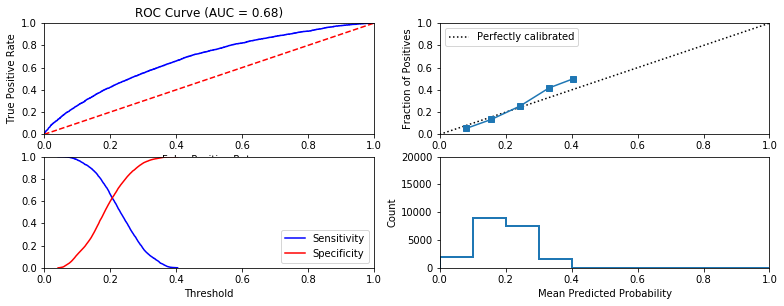


Similarity to LC grade ranking:  0.6923945773039181
Brier score: 0.14758513715019927
Were parameters on edge? : True
Score variations around CV search grid : 0.6748644060779283
[0.79966667 0.80163333 0.80223333 0.8051     0.8051     0.8051
 0.80453333 0.80493333 0.80496667 0.80423333 0.80356667 0.80366667]


In [90]:
random_forest = RandomForestClassifier()
cv_parameters = {'n_estimators':[50,100,150],'max_depth':[None,5,10,15]}
random_forest = fit_classification(random_forest,model_name="RF",cv_parameters = cv_parameters, data_dict = data_dict)

  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



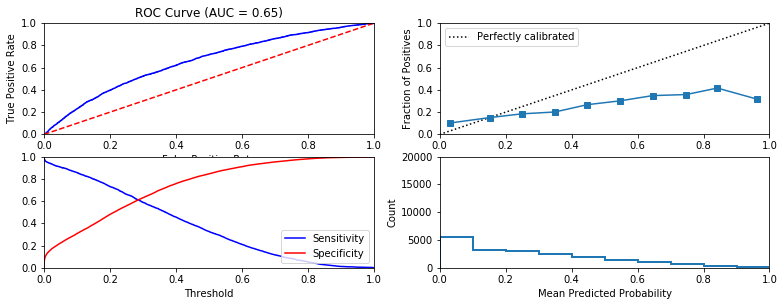


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.25 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



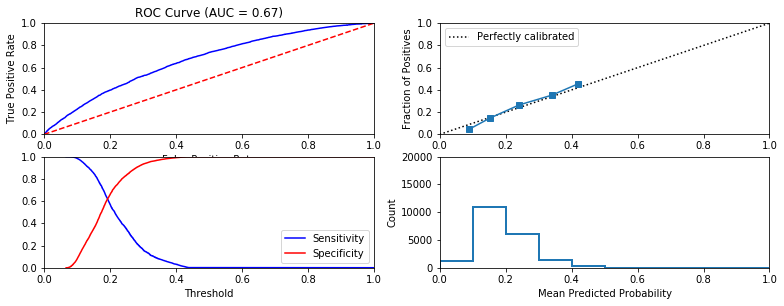


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



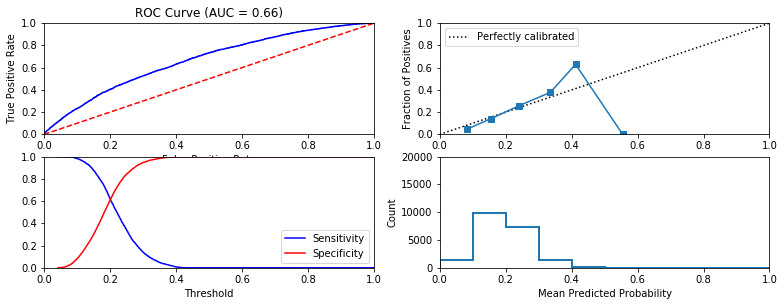


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.21 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



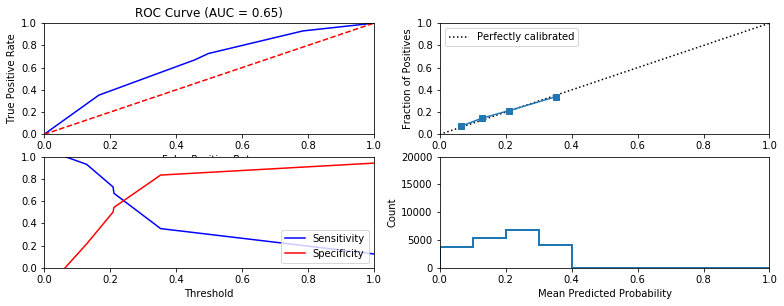


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.96 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



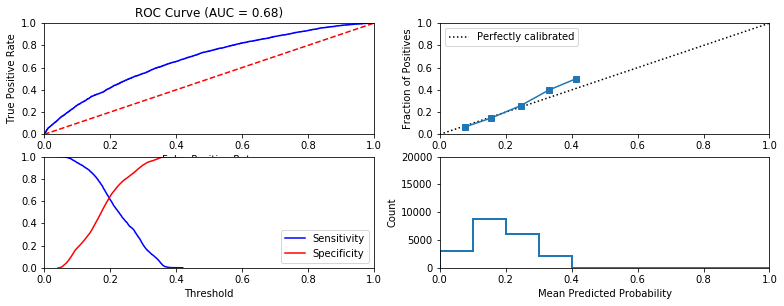


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.13 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



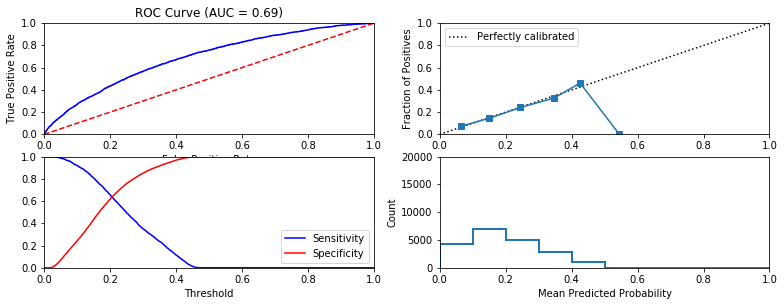


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



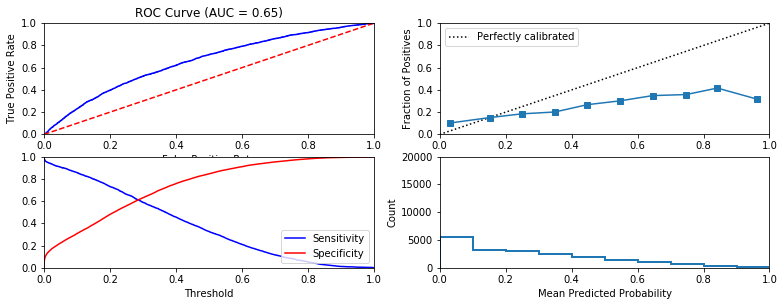


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



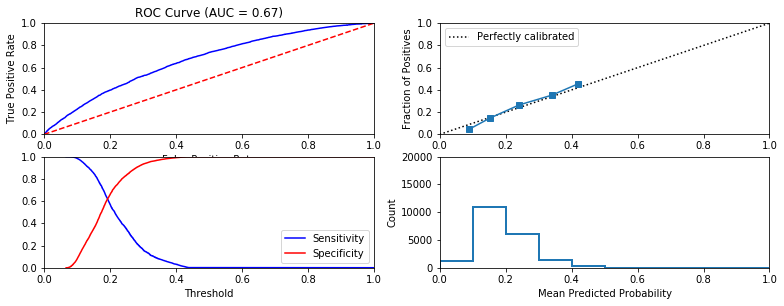


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.15 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



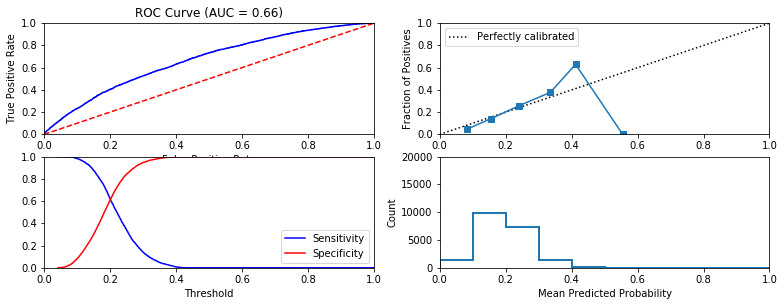


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.25 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



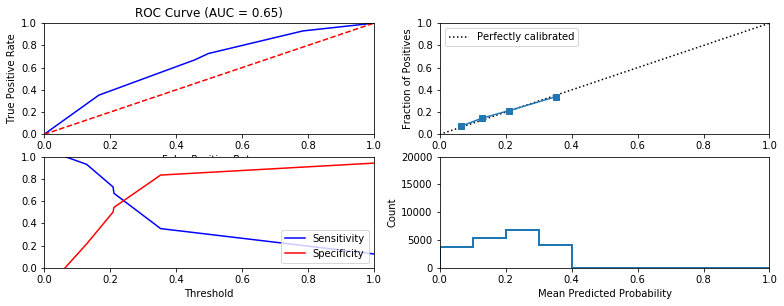


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.94 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



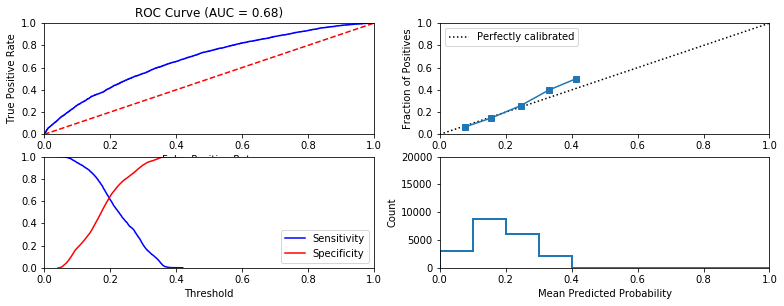


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



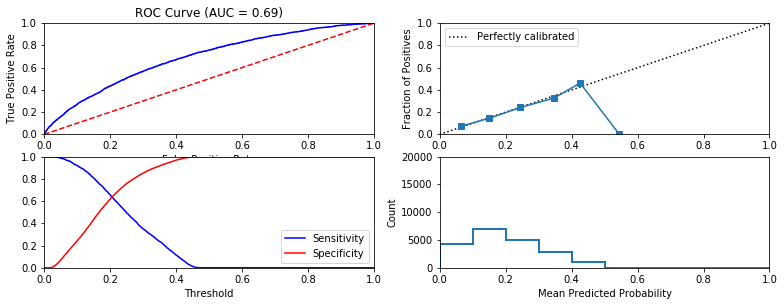


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



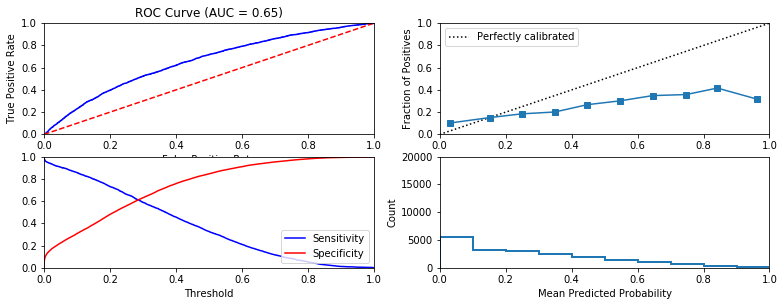


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



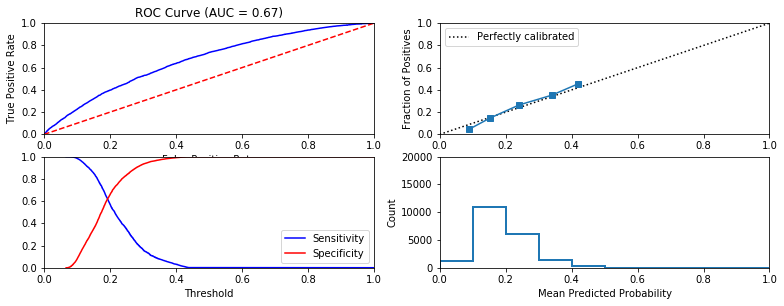


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.2 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



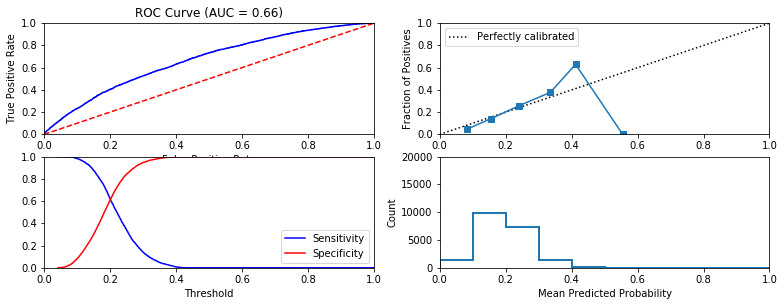


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



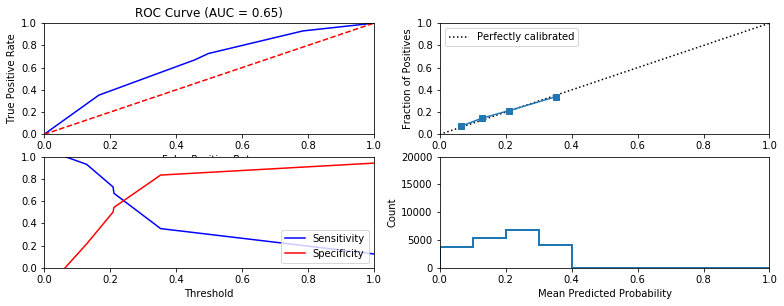


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



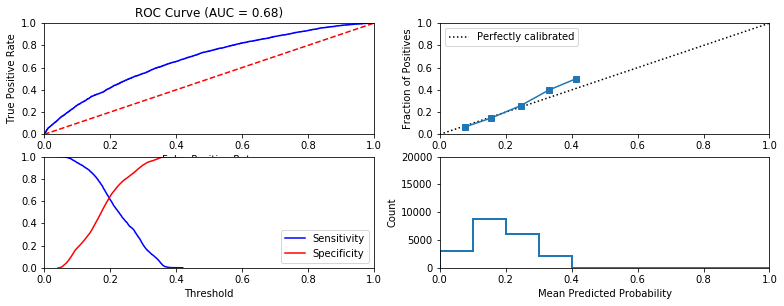


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



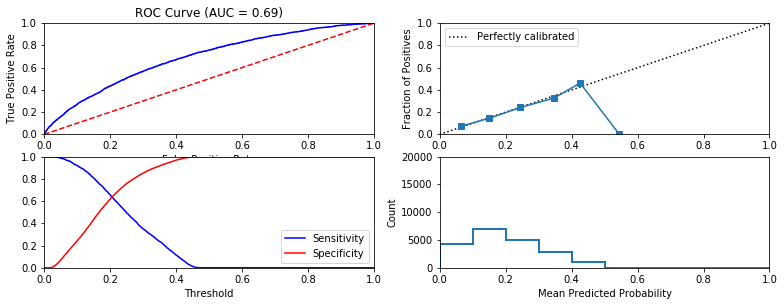


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



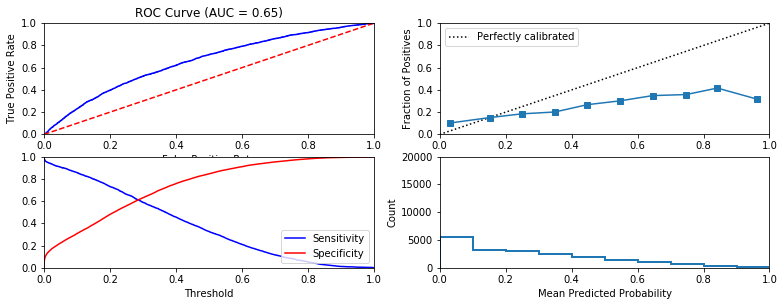


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



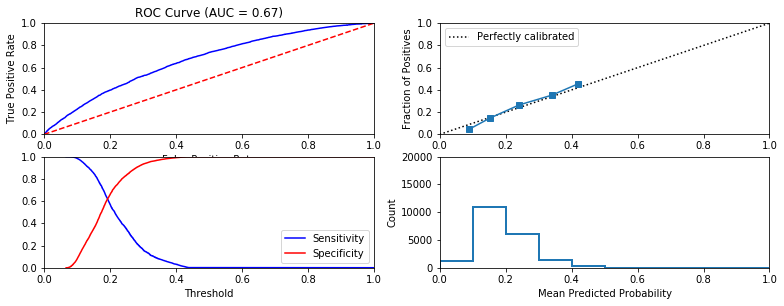


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



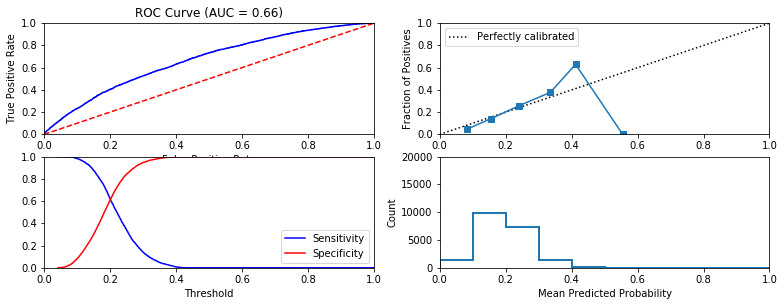


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



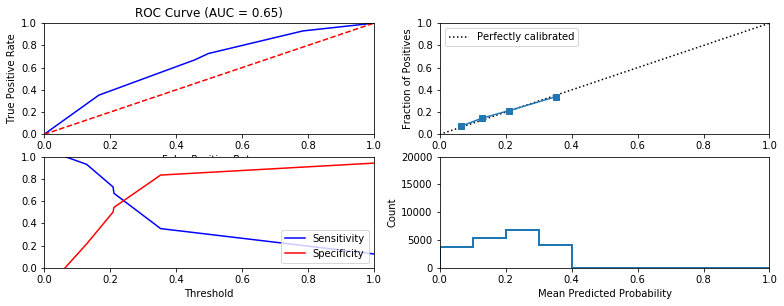


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.86 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



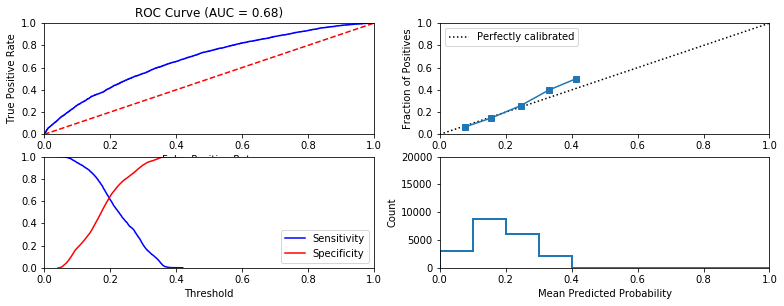


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.63 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



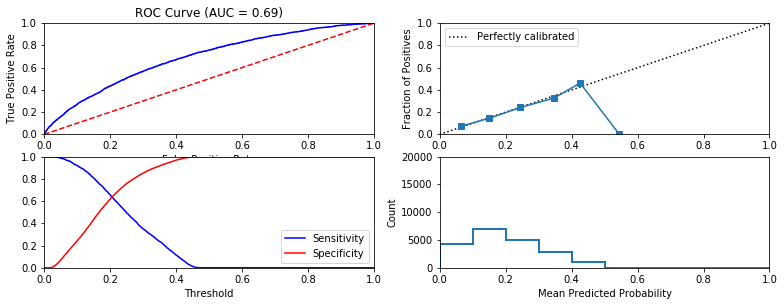


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



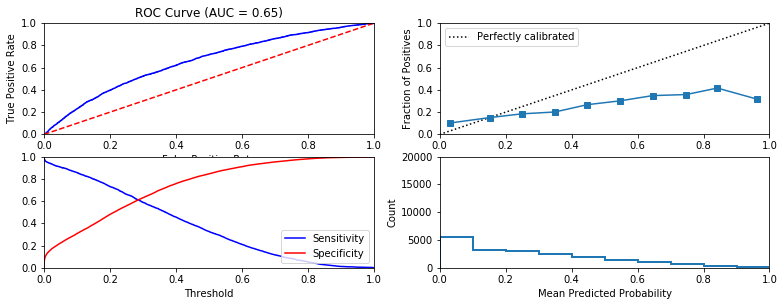


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



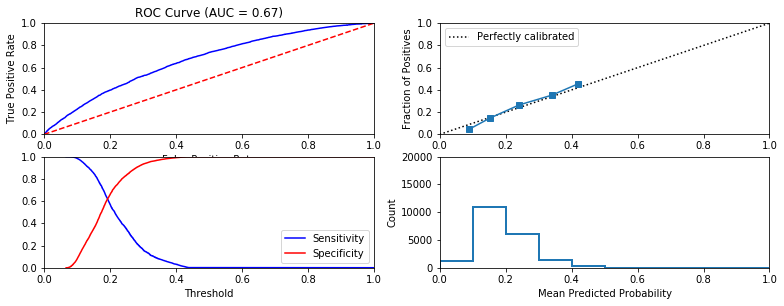


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



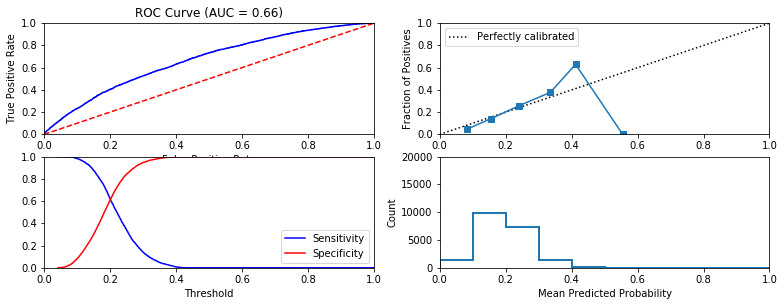


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.21 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



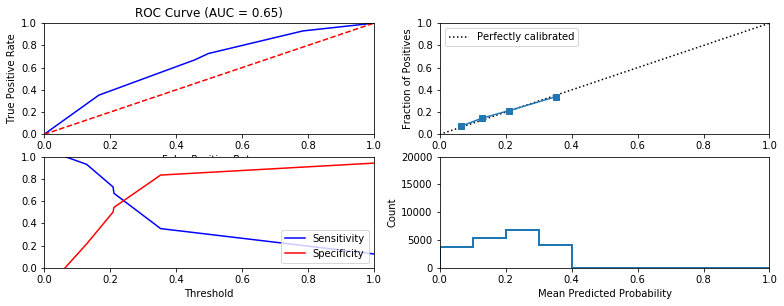


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.75 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



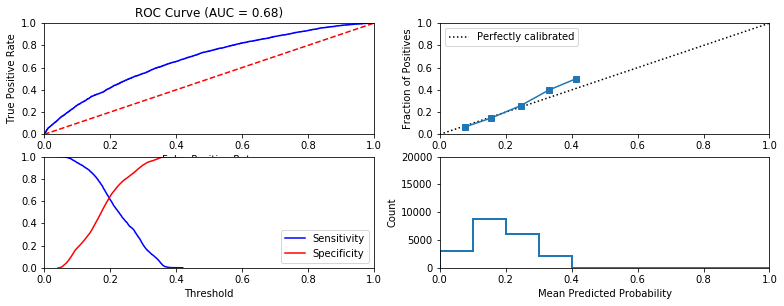


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.5 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



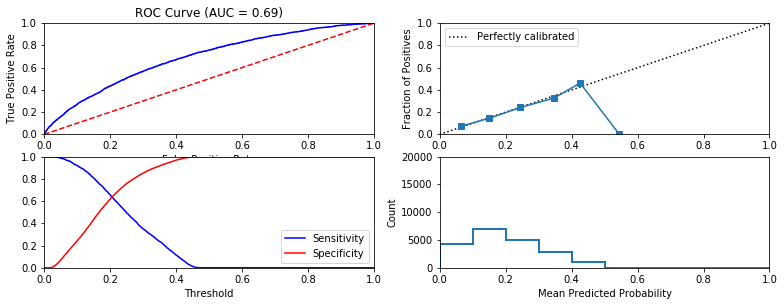


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



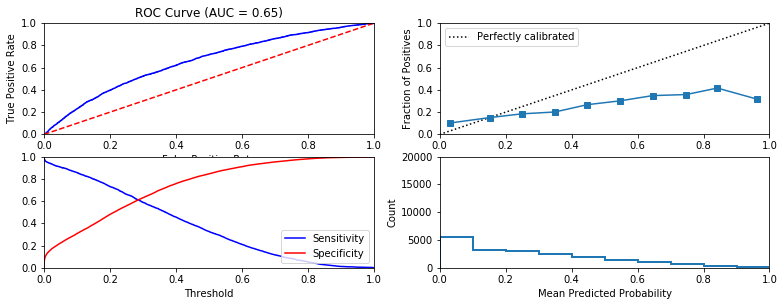


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



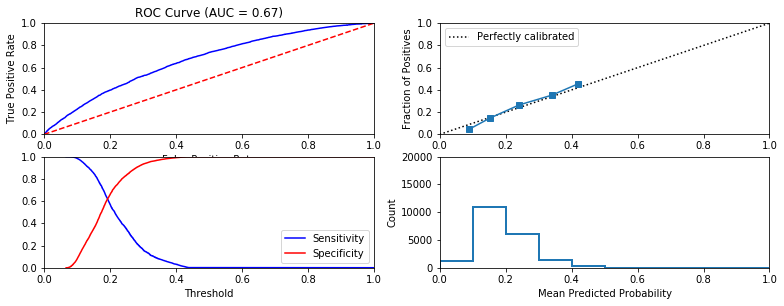


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



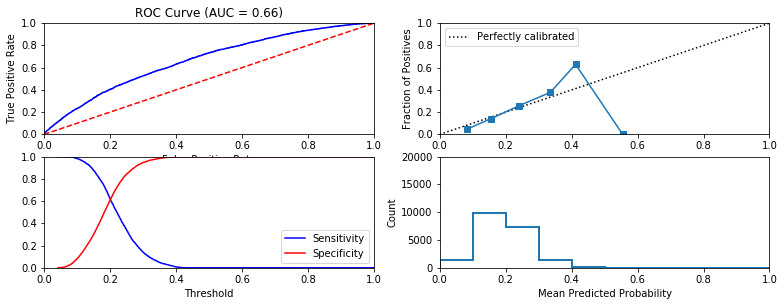


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



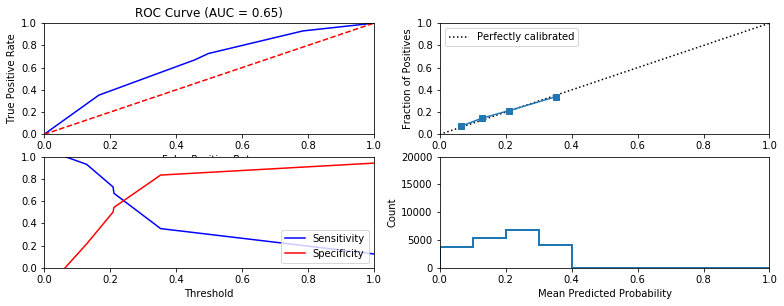


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.81 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



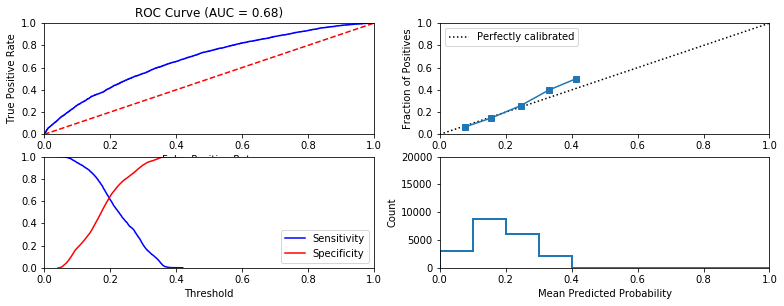


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.77 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



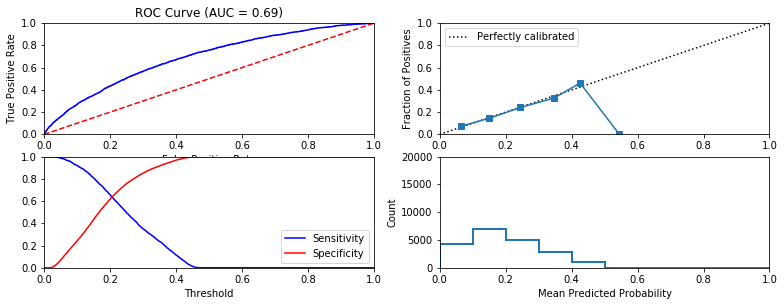


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



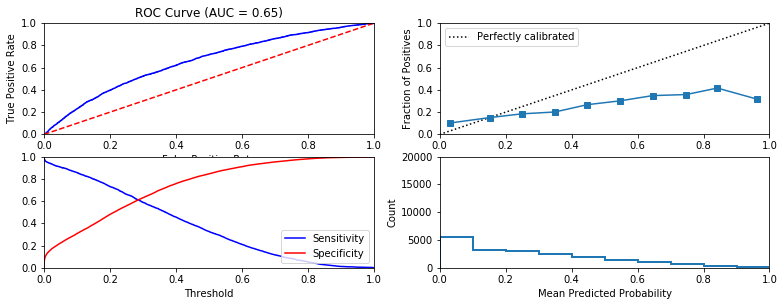


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



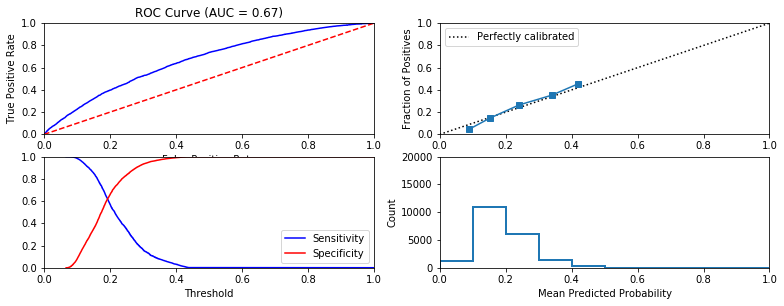


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



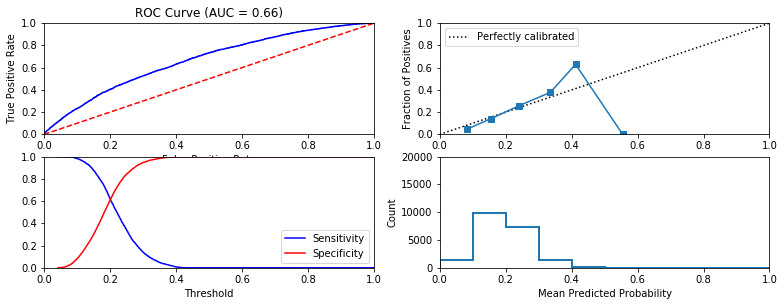


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



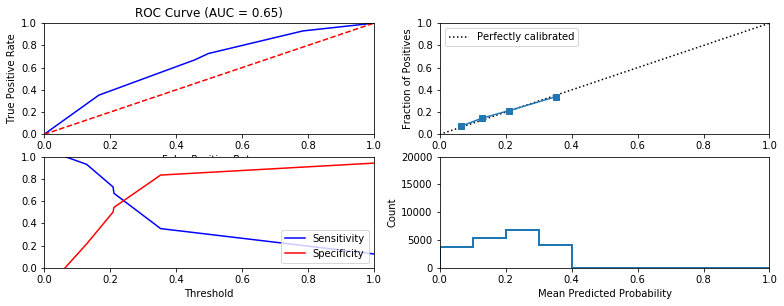


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.78 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



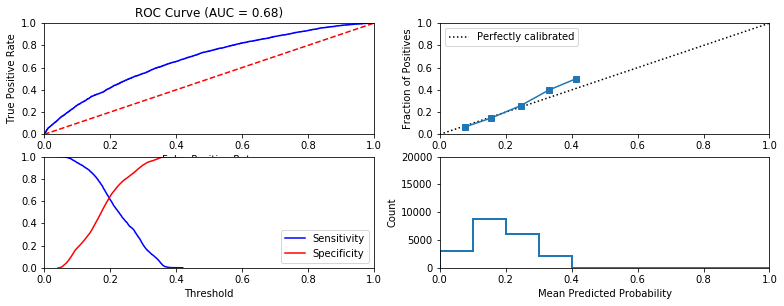


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.36 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



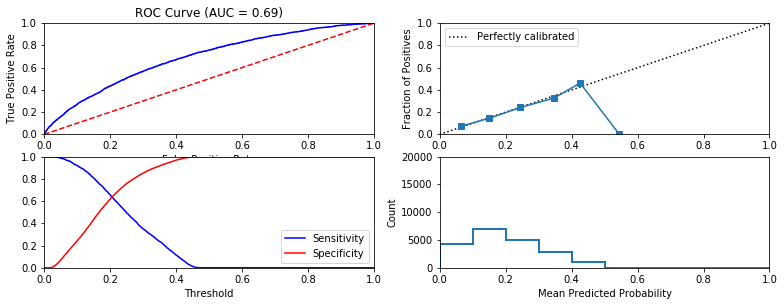


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



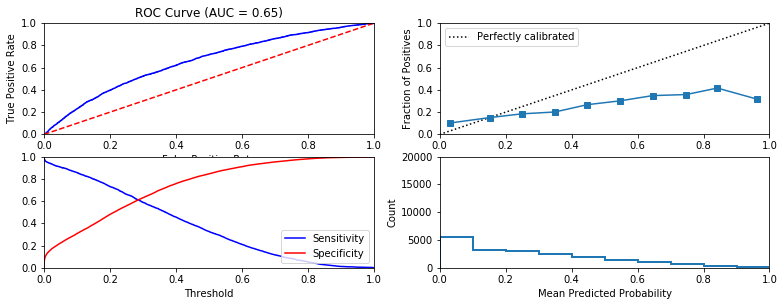


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



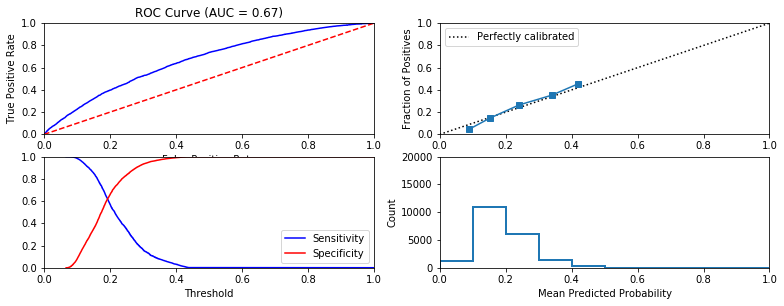


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



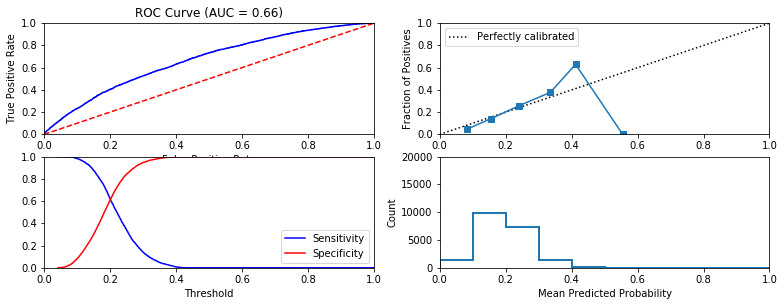


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



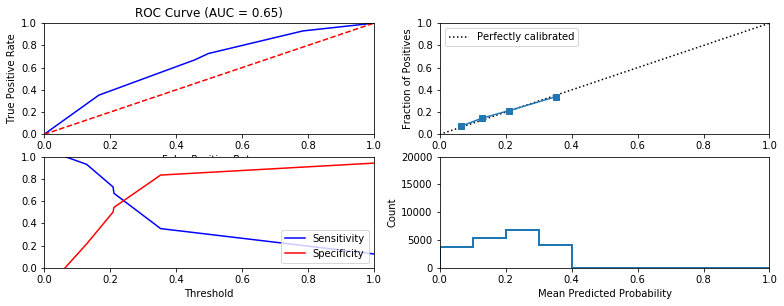


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.75 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



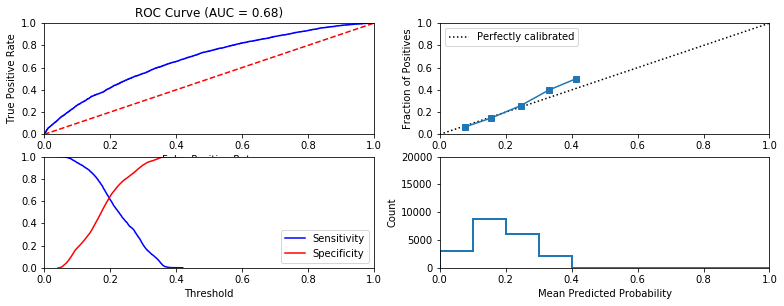


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.77 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



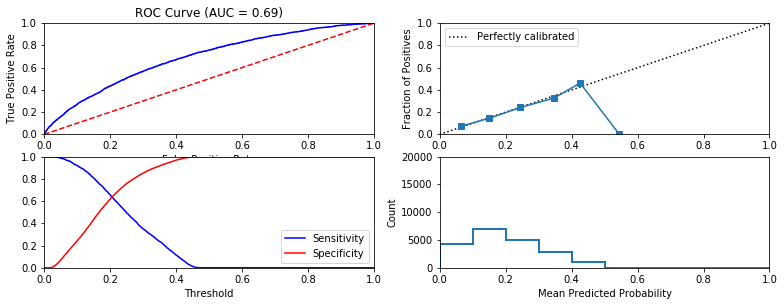


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



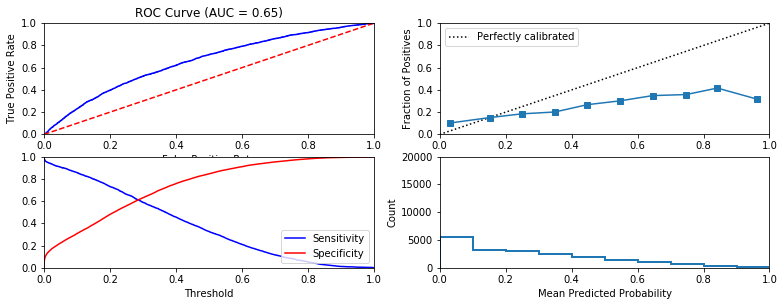


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



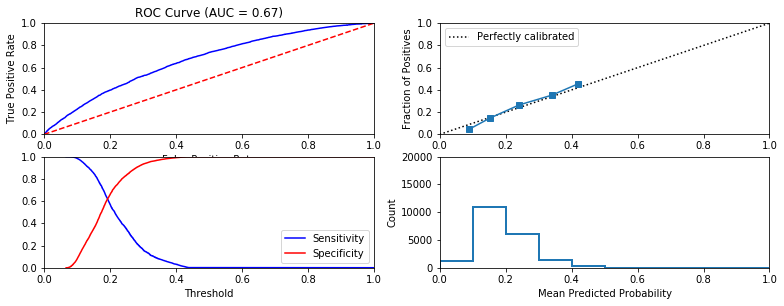


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



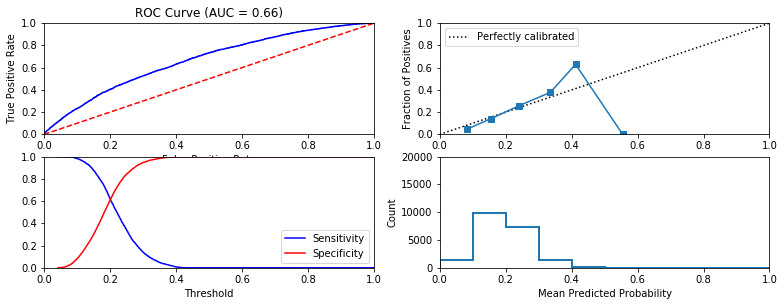


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



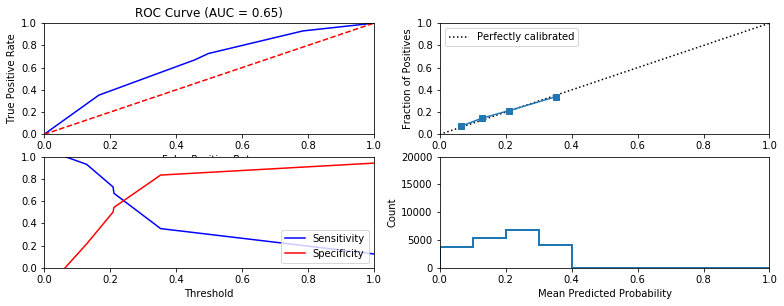


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 3.0 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



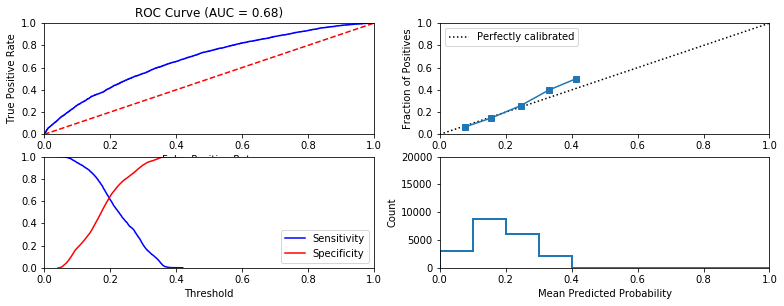


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.78 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



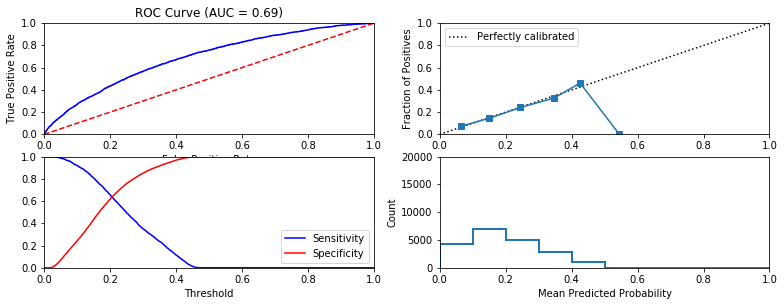


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



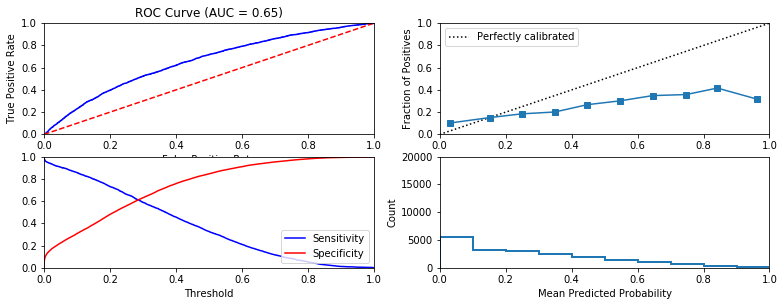


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



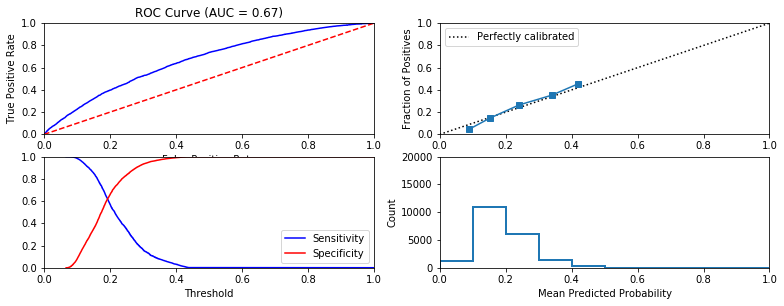


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



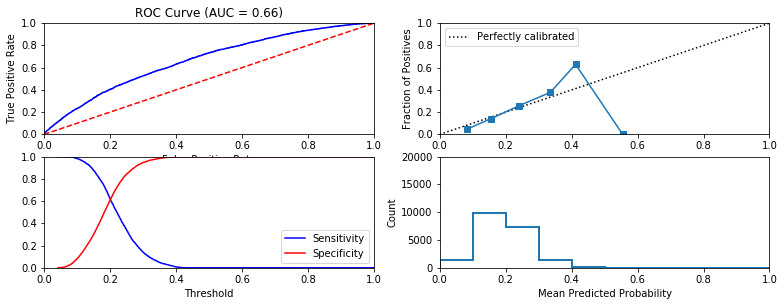


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



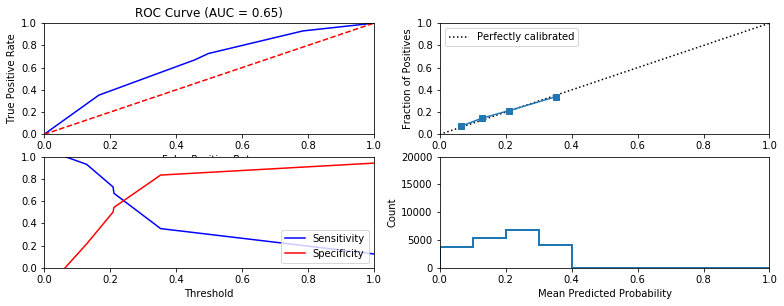


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.8 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



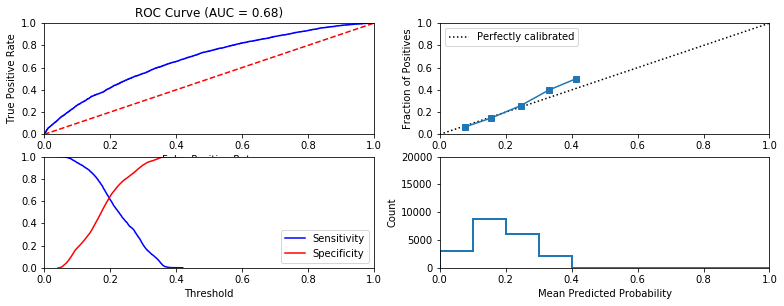


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.35 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



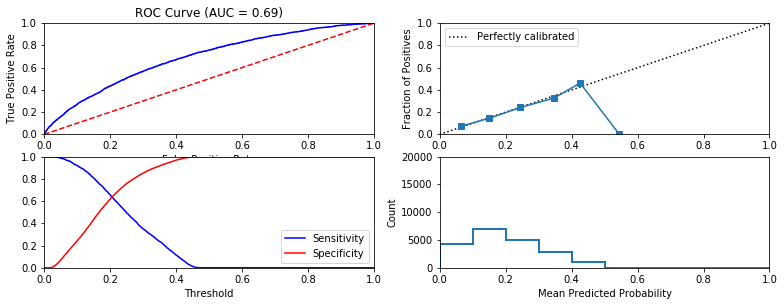


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



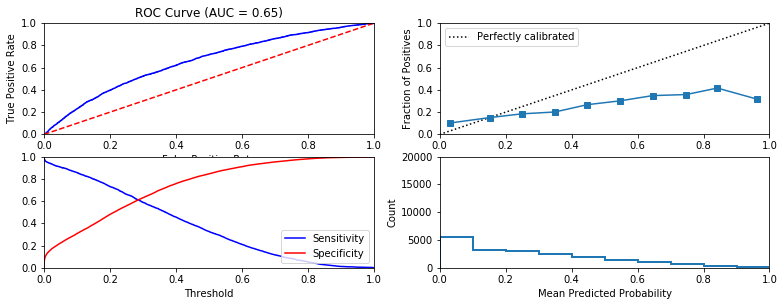


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



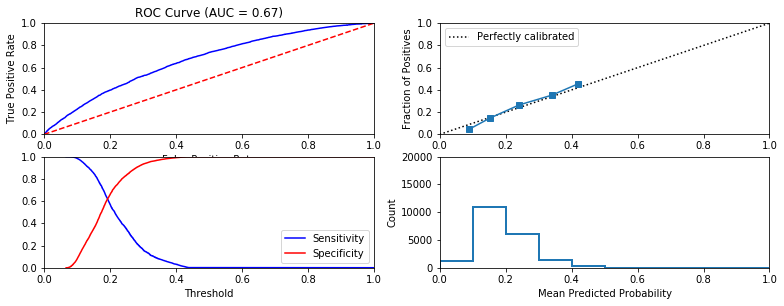


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



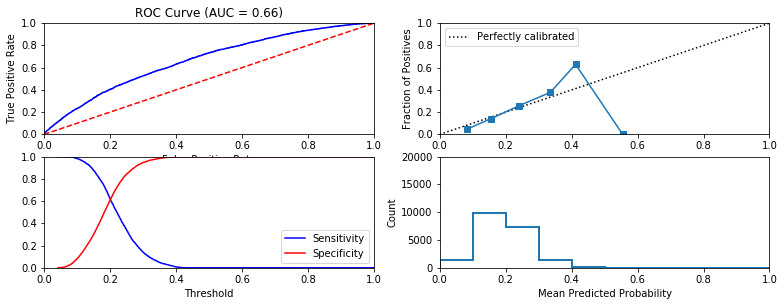


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



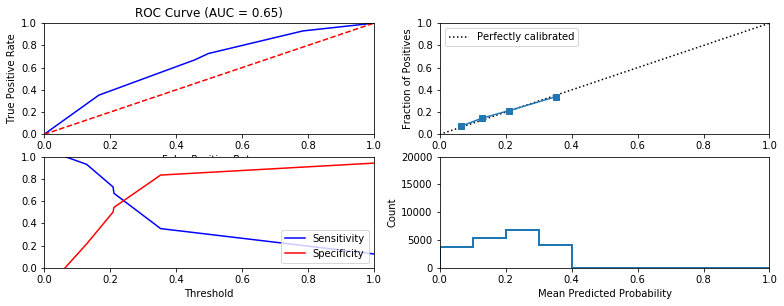


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.77 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



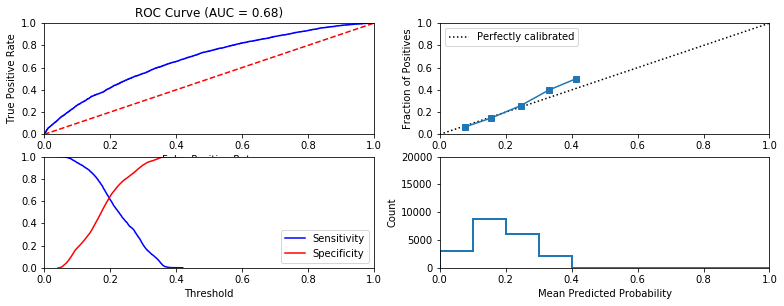


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.48 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



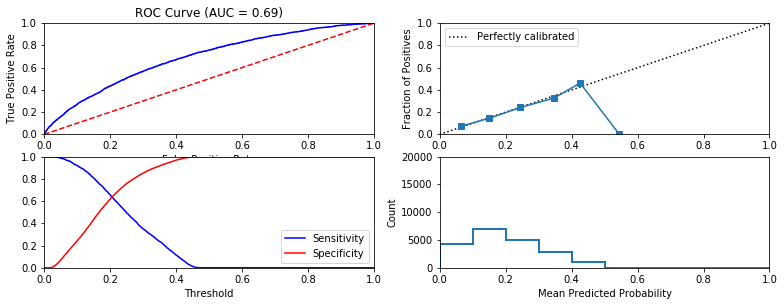


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



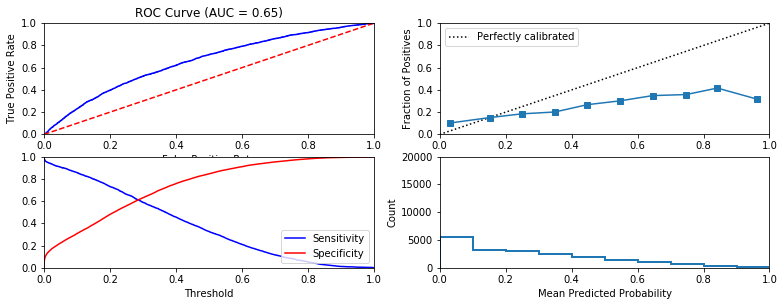


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



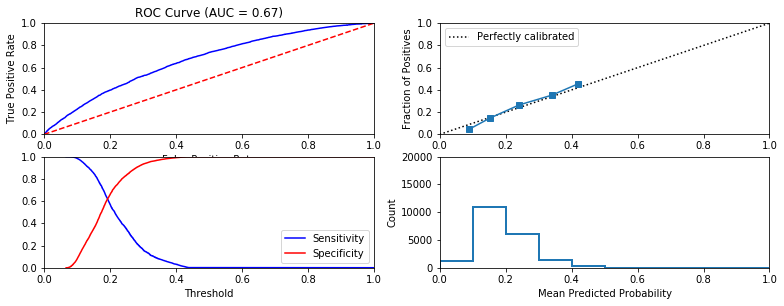


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



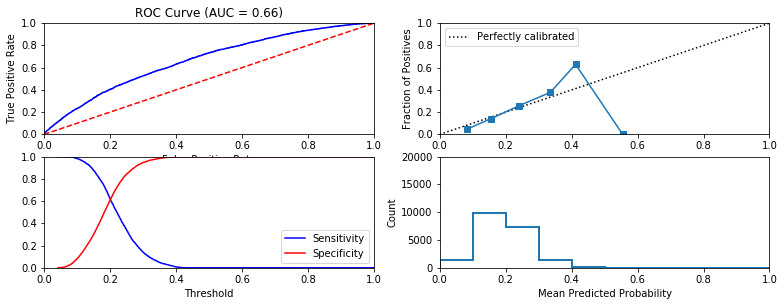


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



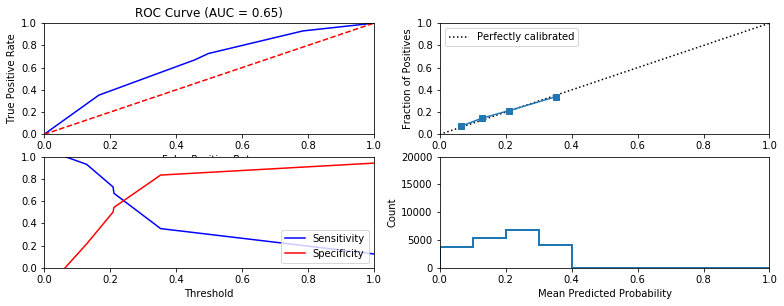


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.84 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



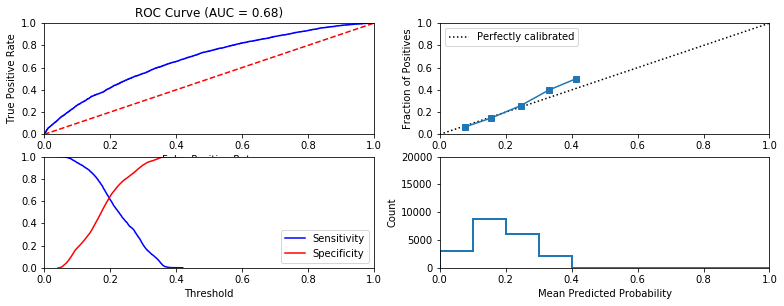


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.5 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



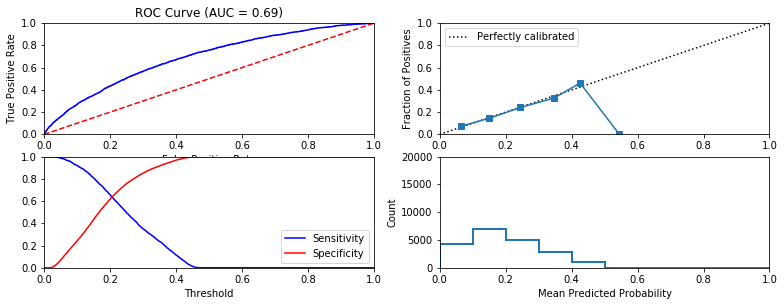


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



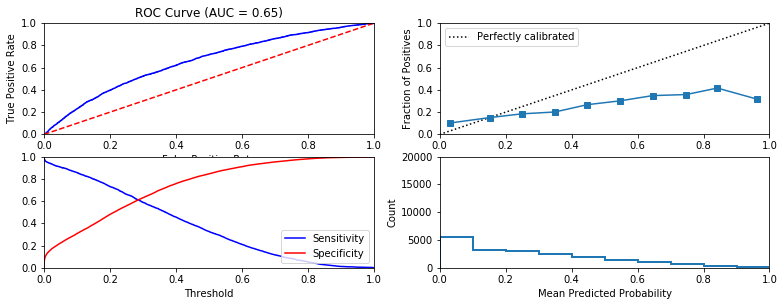


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



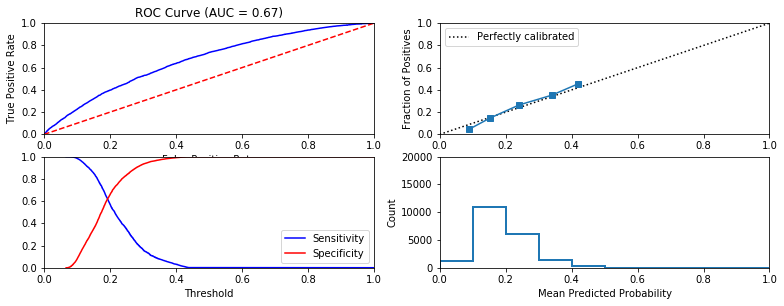


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



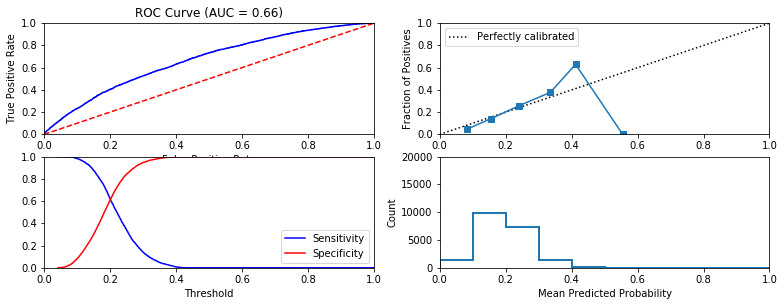


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



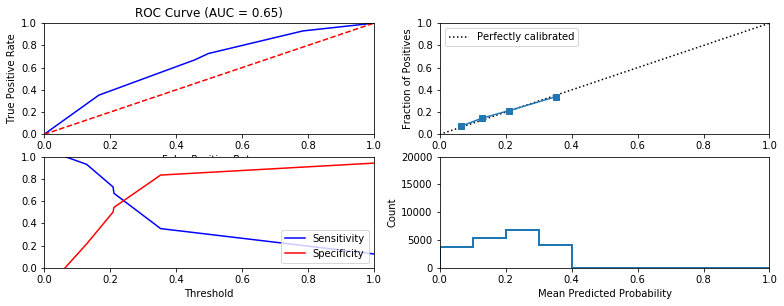


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



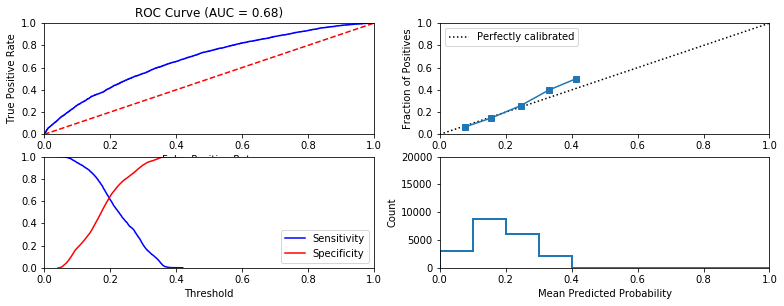


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.86 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



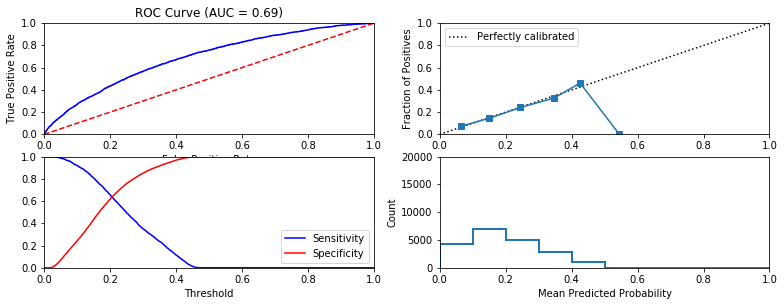


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



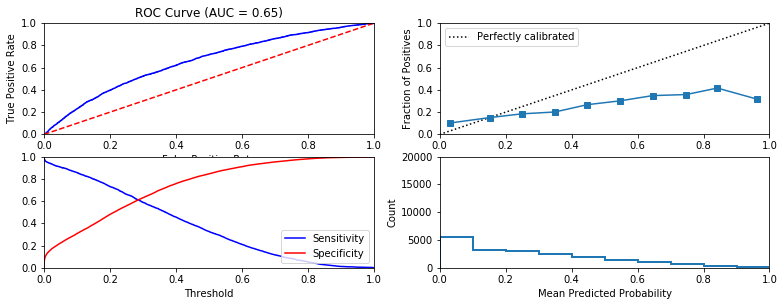


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



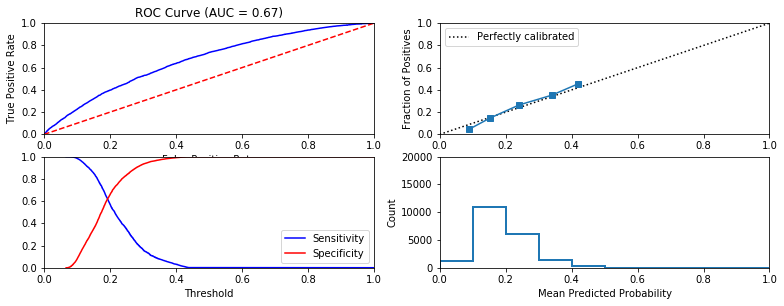


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



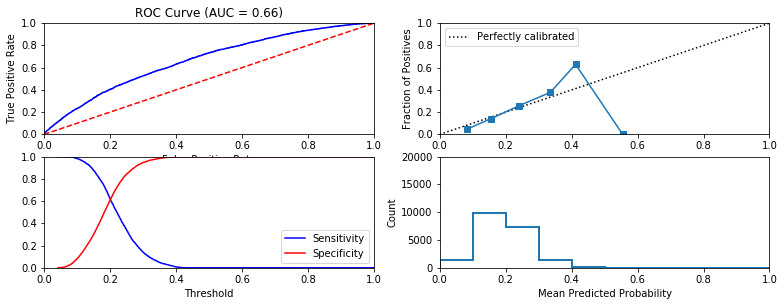


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



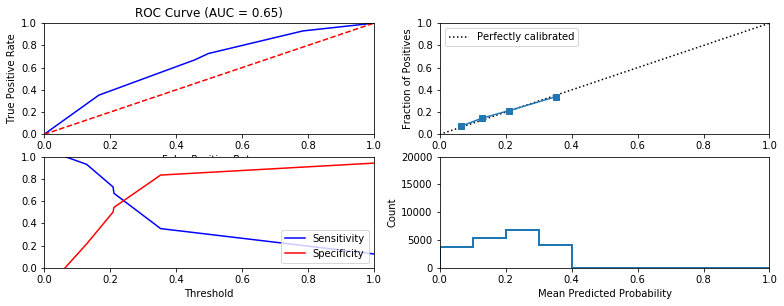


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



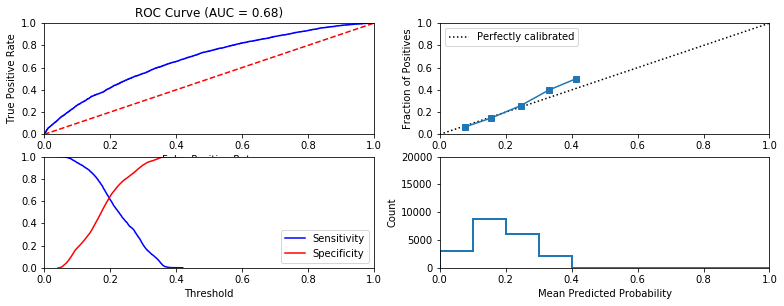


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



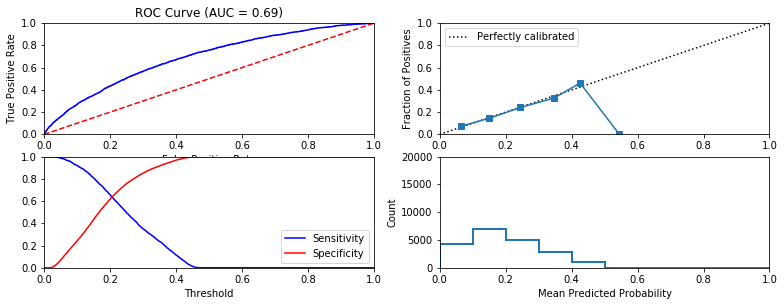


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



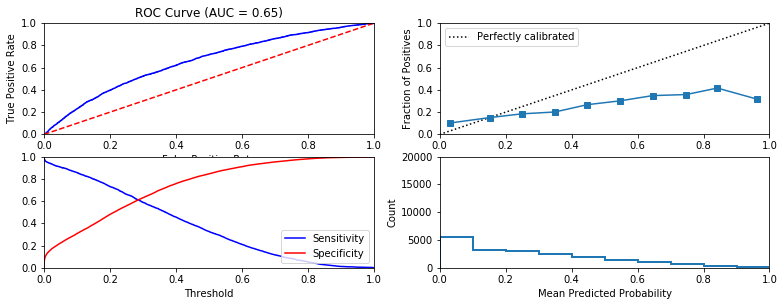


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



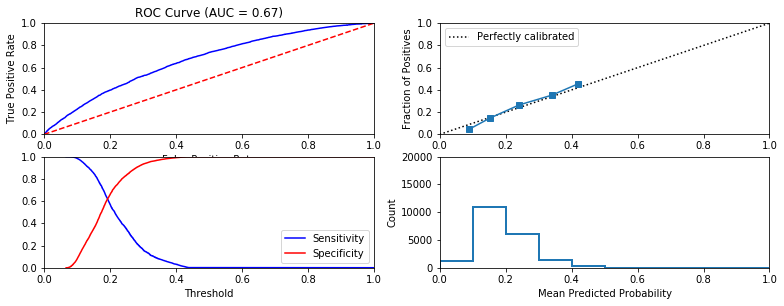


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



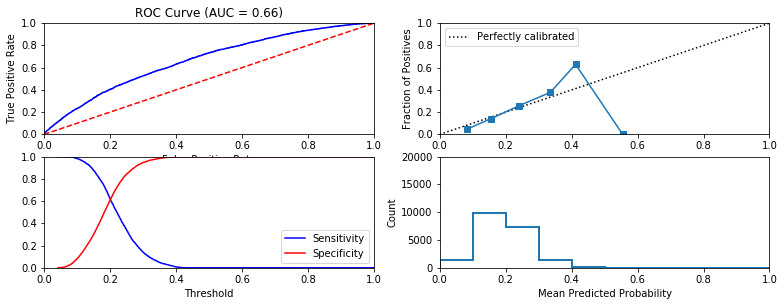


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



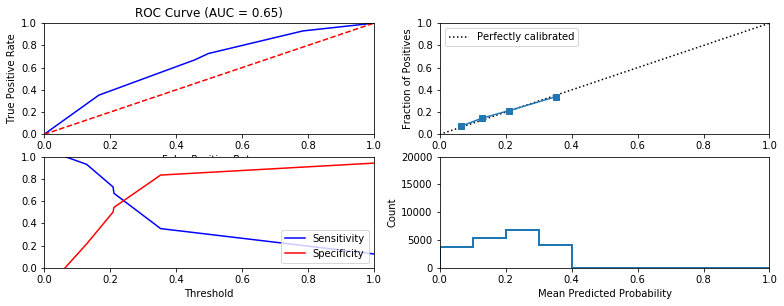


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



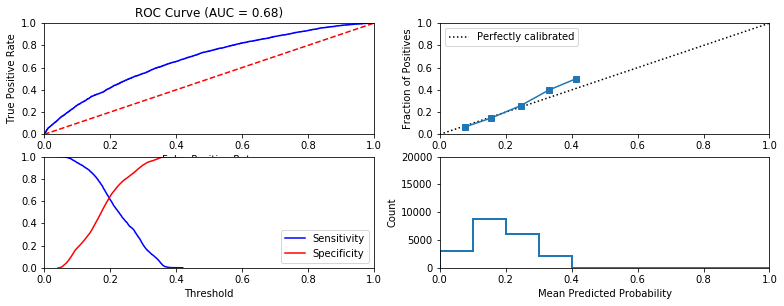


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.53 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



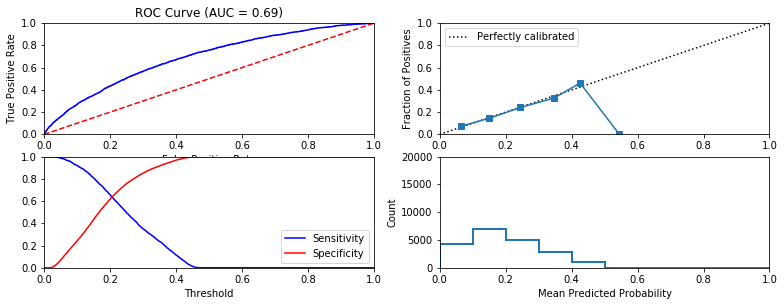


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



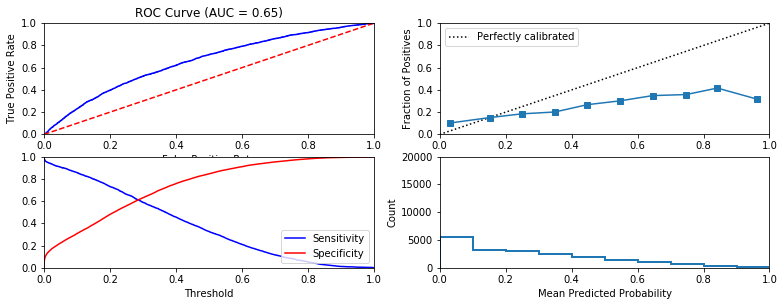


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



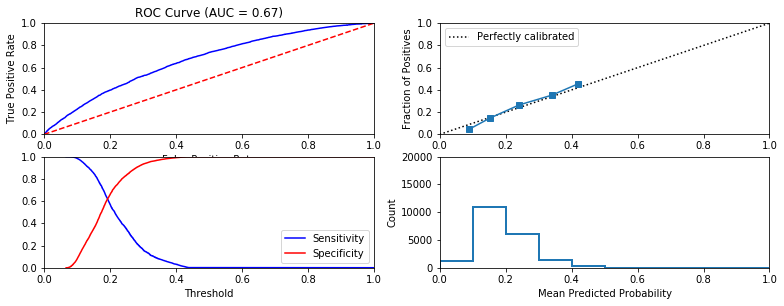


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



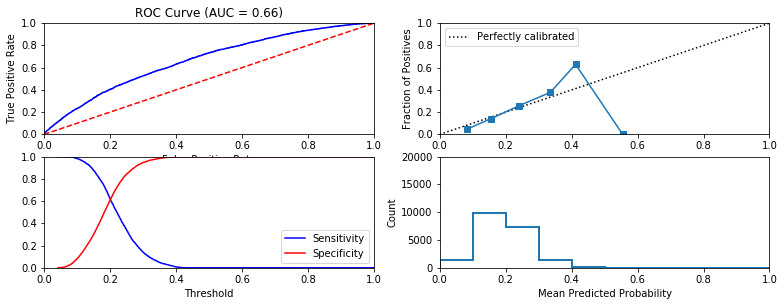


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.21 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



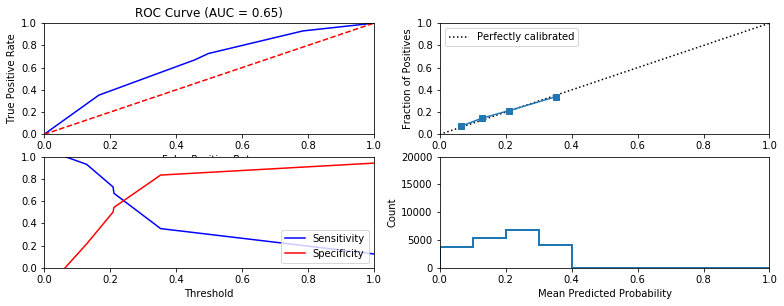


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



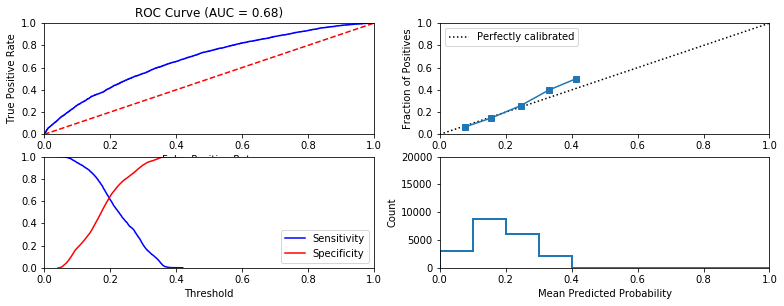


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.69 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



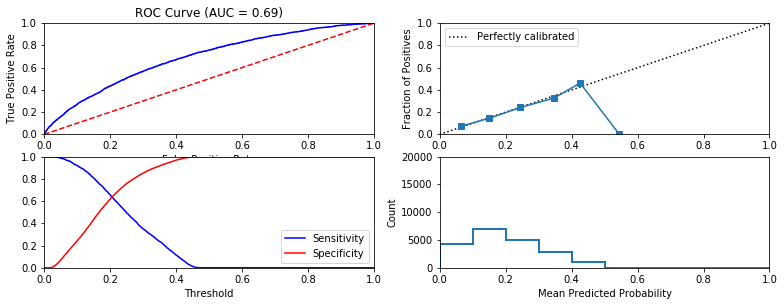


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



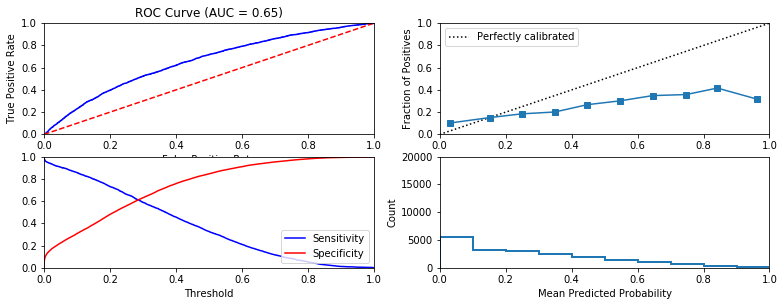


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



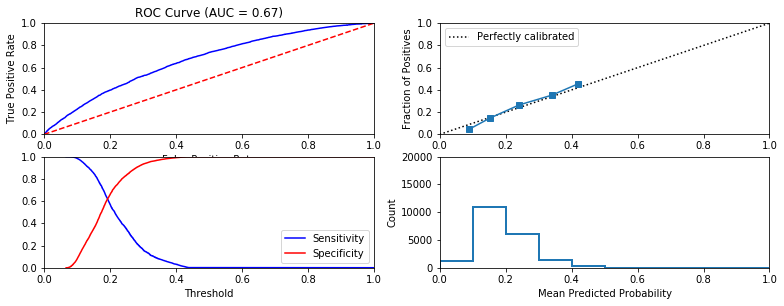


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



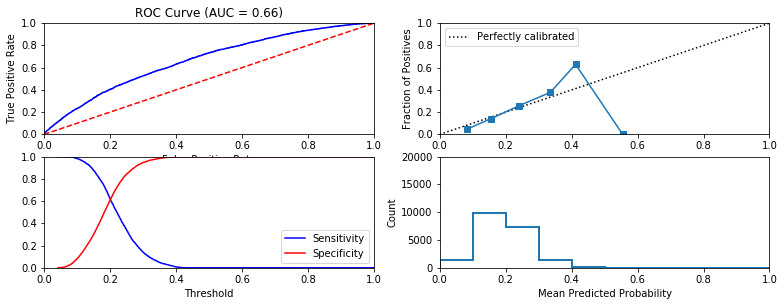


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



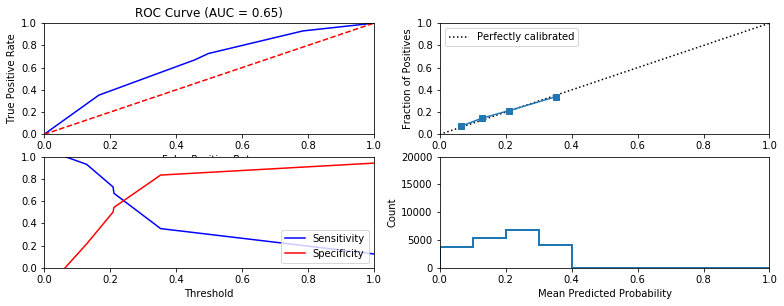


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.79 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



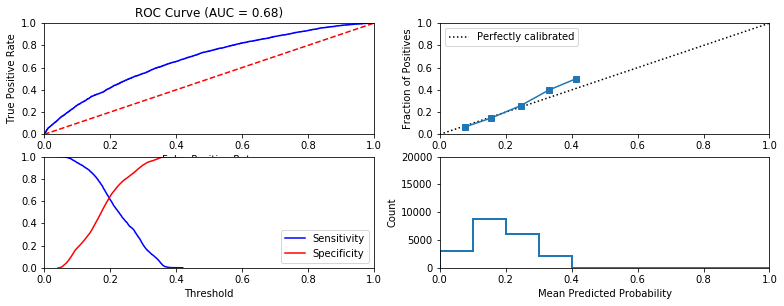


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.52 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



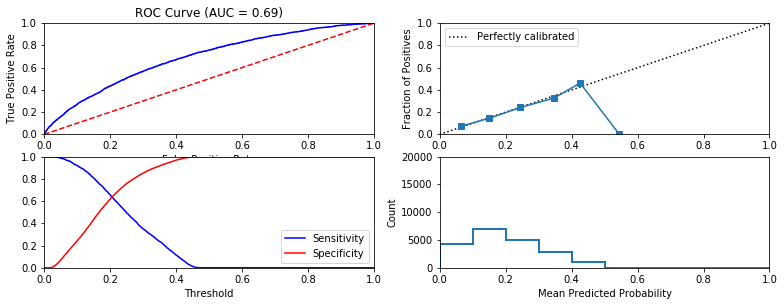


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



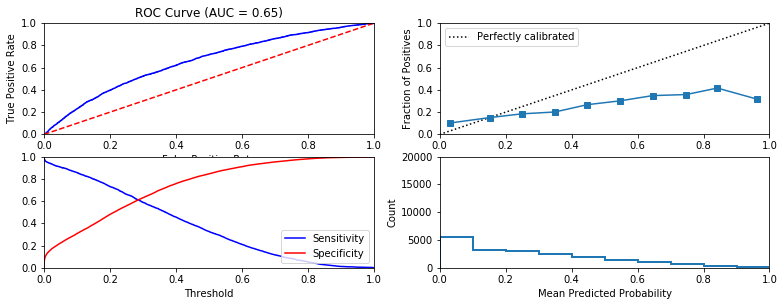


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



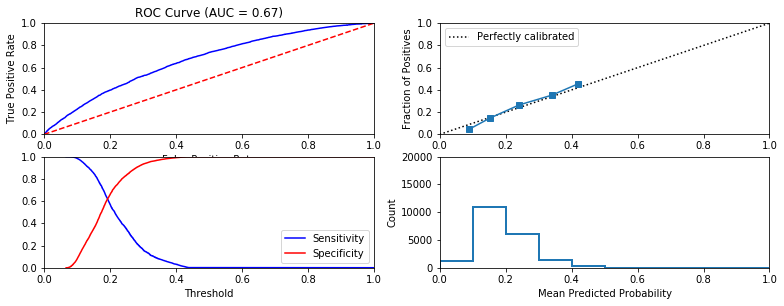


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



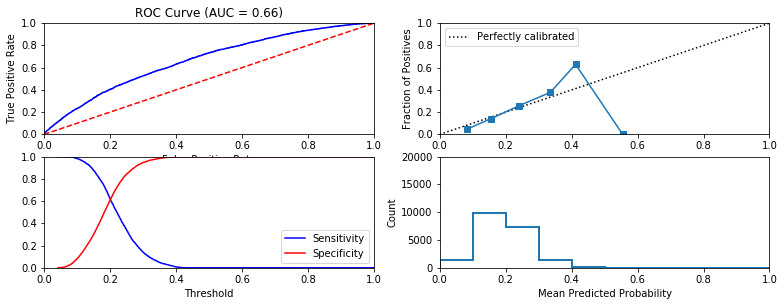


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



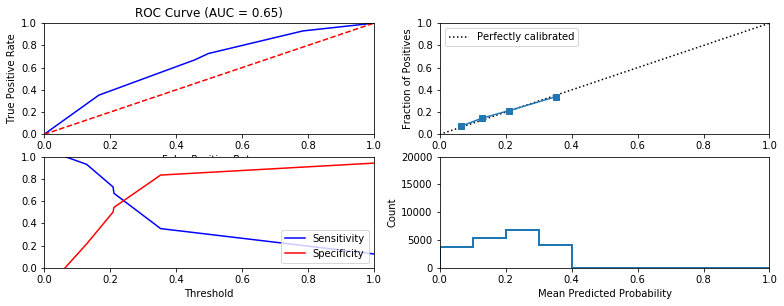


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.7 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



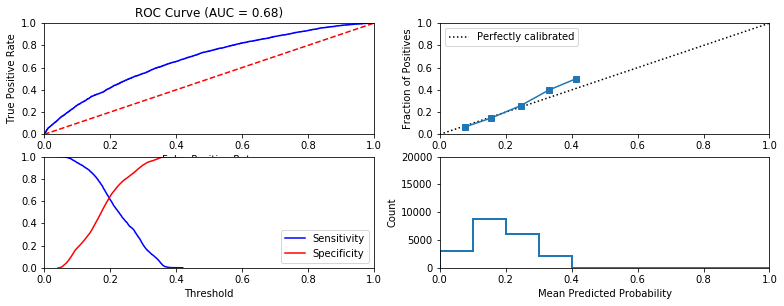


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.79 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



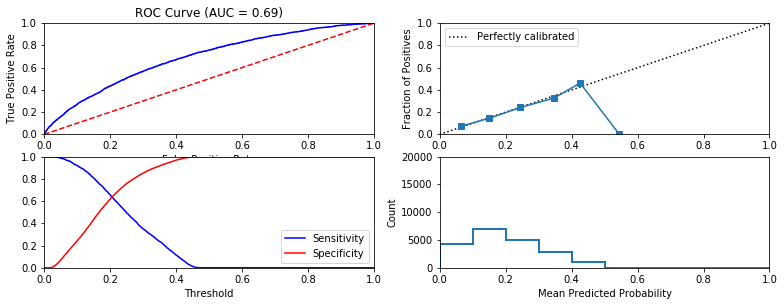


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



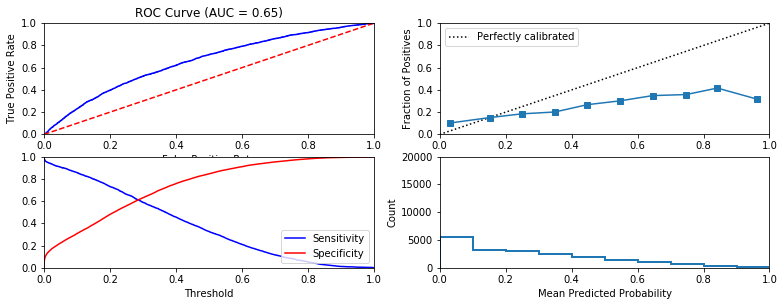


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



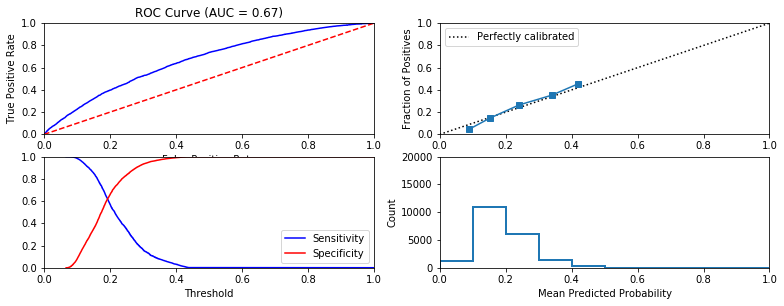


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



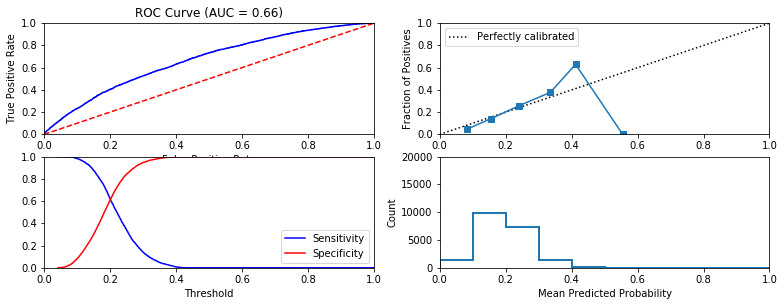


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



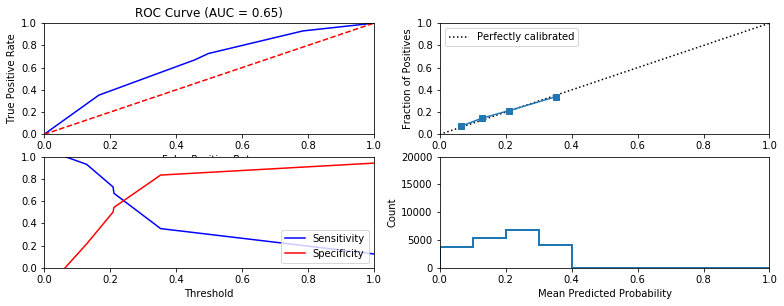


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



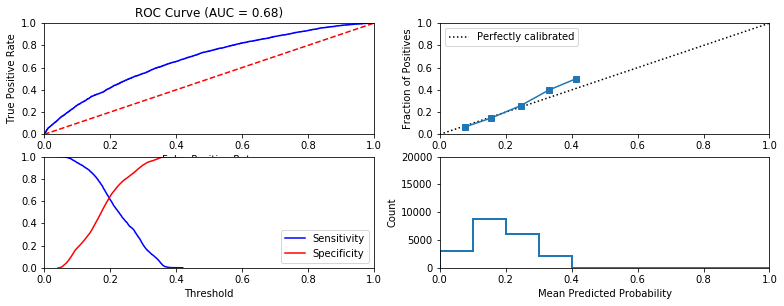


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.67 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



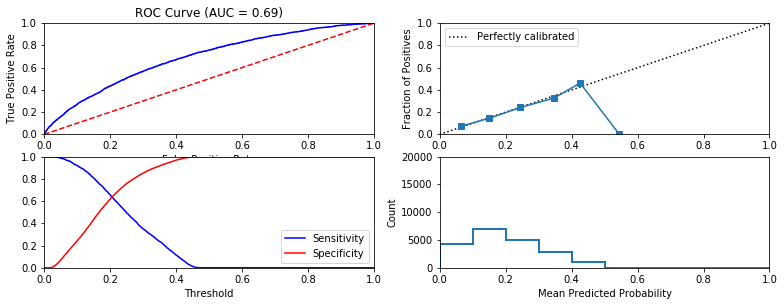


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



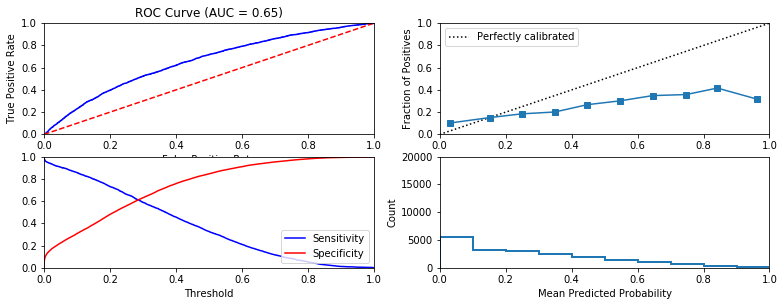


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



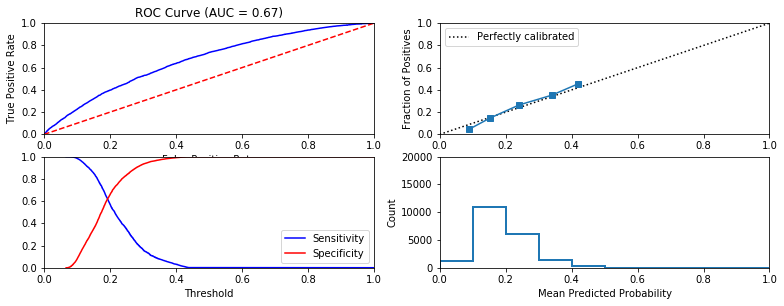


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



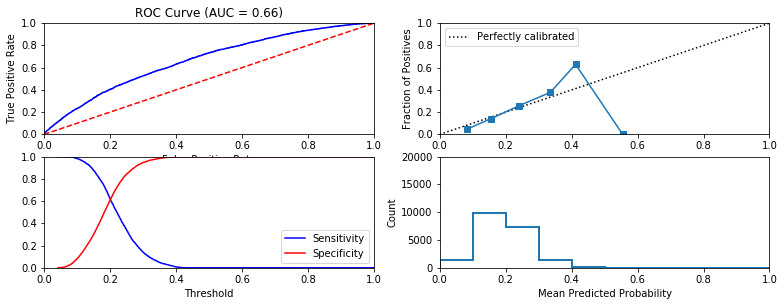


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



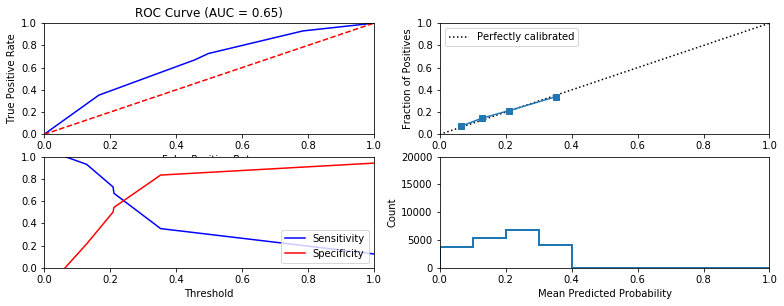


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.78 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



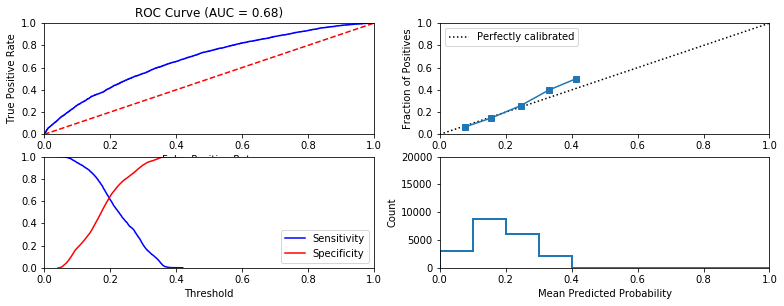


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.49 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



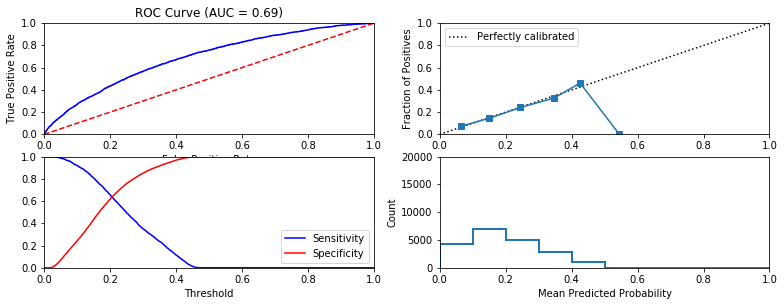


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



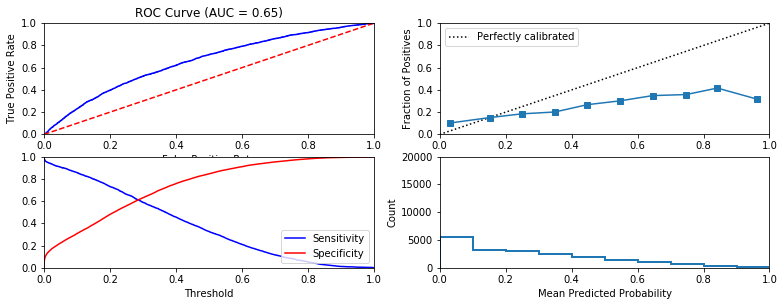


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



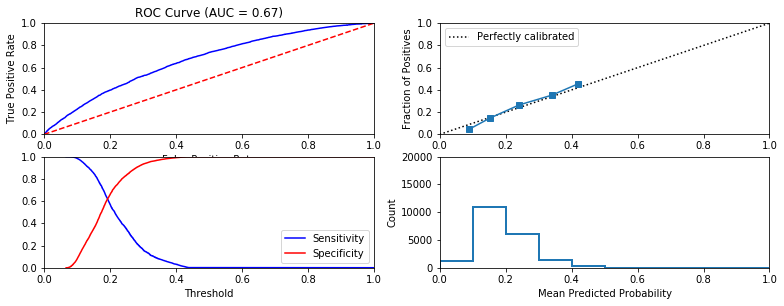


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



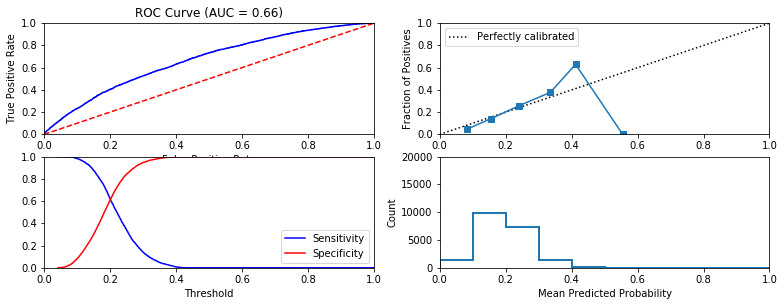


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



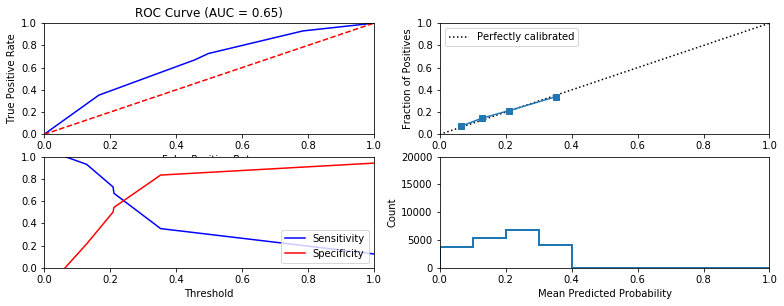


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.82 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



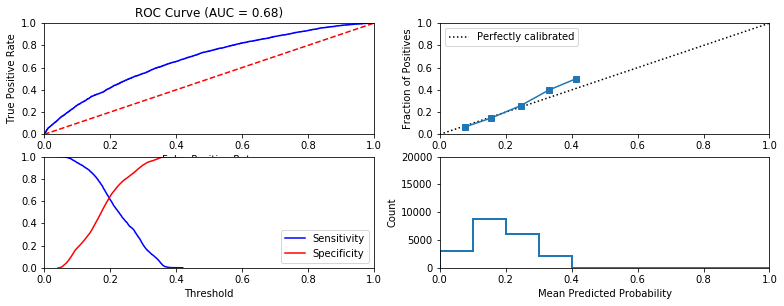


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.9 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



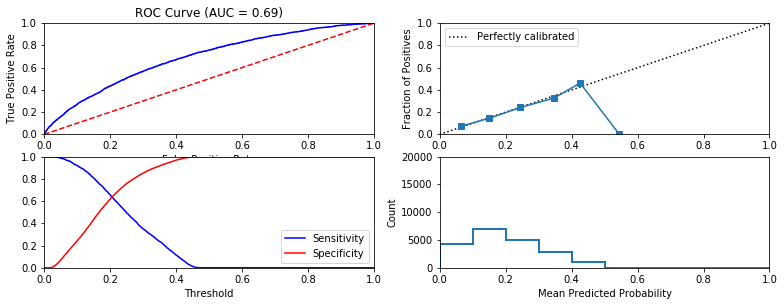


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



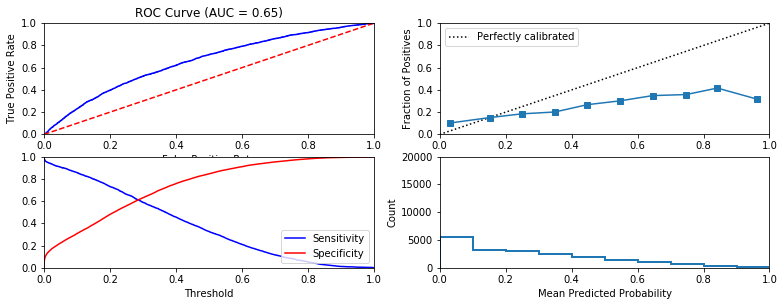


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.25 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



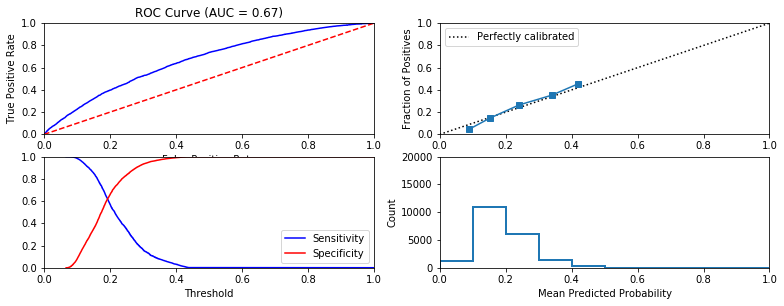


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



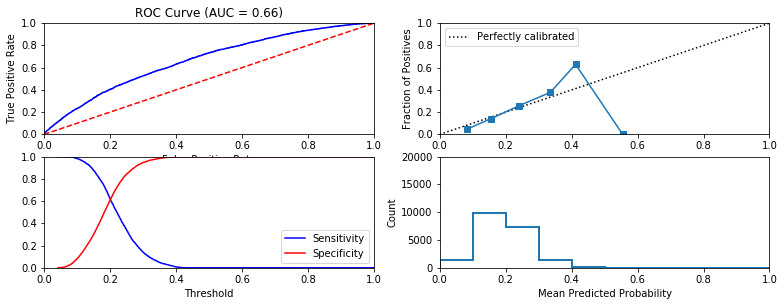


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



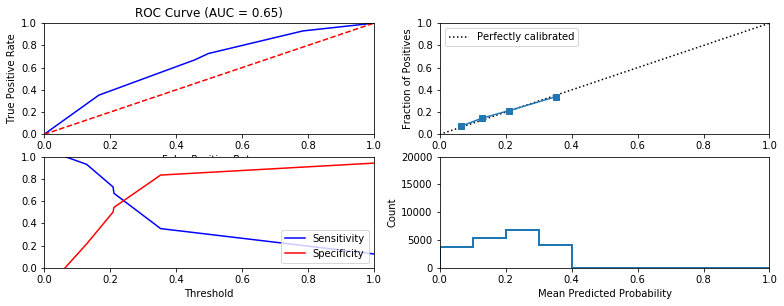


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.71 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



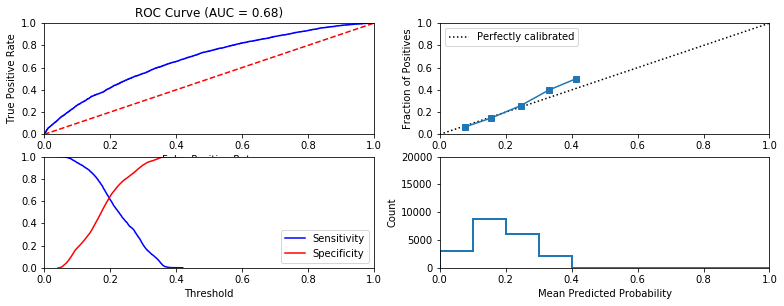


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



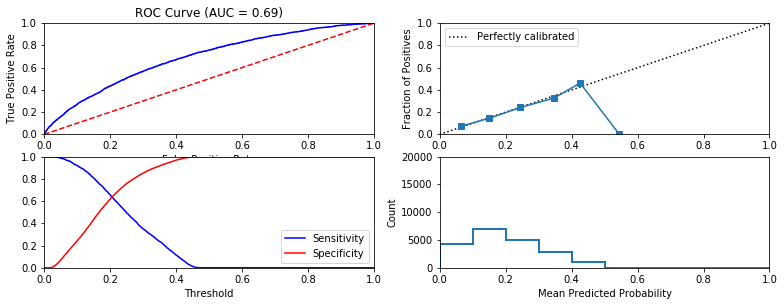


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



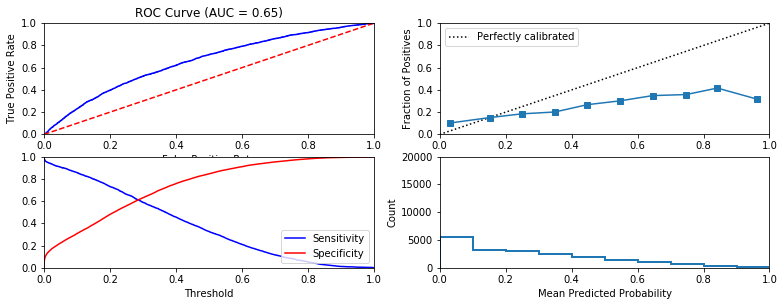


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



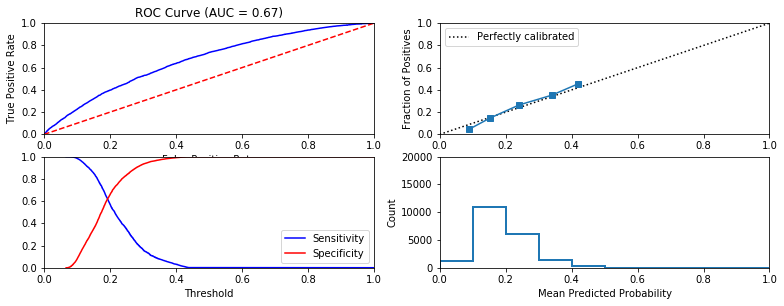


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



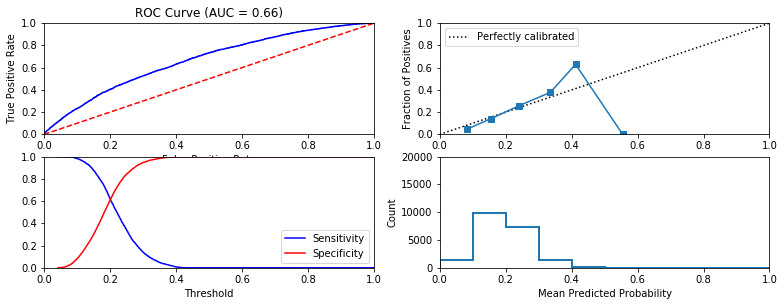


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.21 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



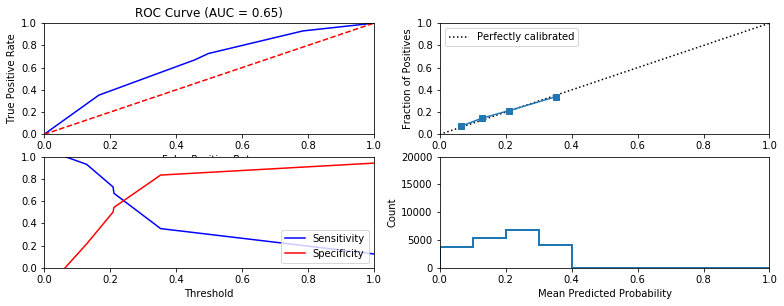


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.82 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



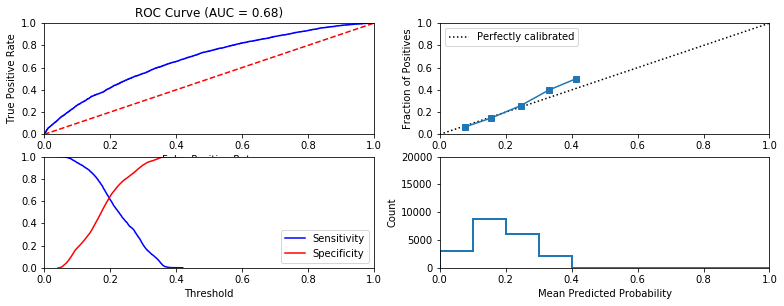


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.83 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



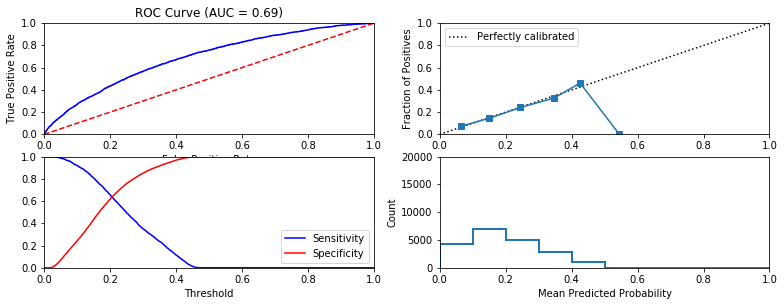


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



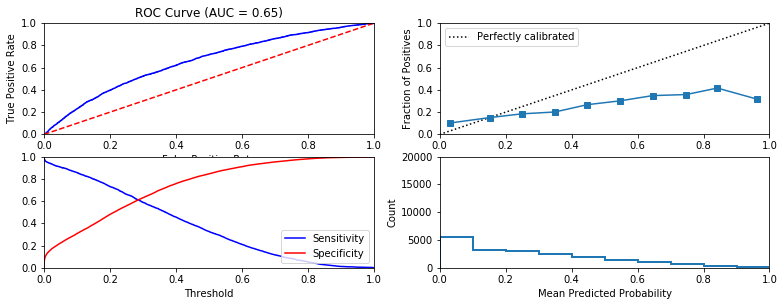


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



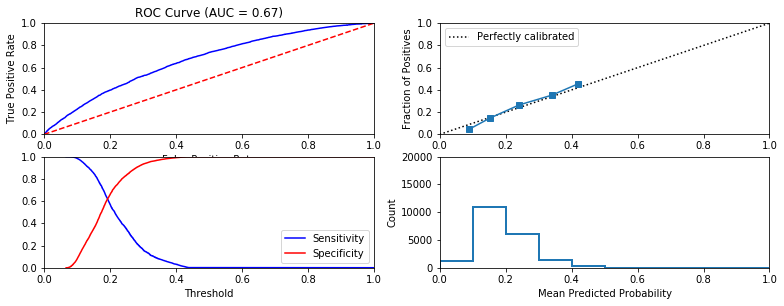


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



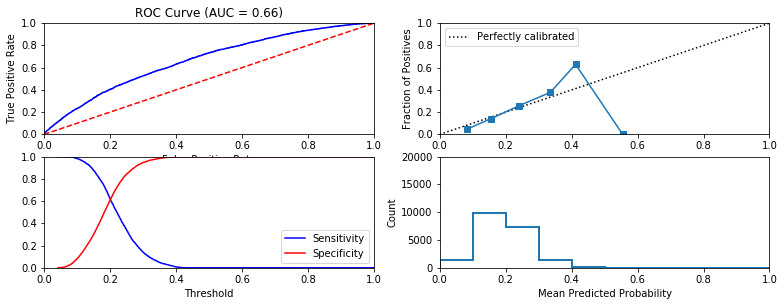


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



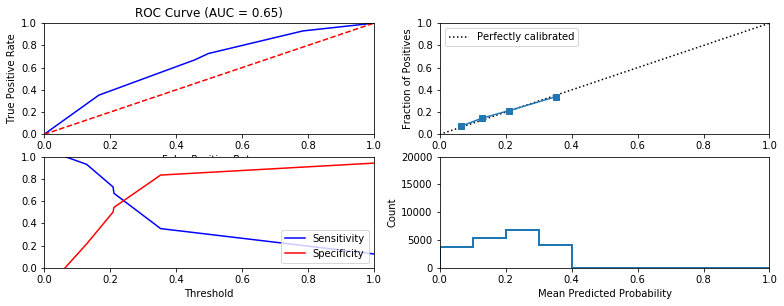


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



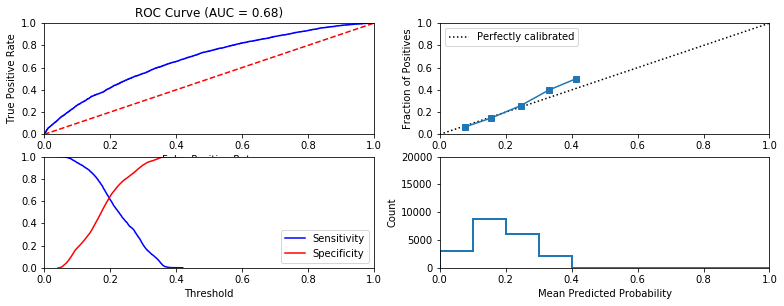


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.48 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



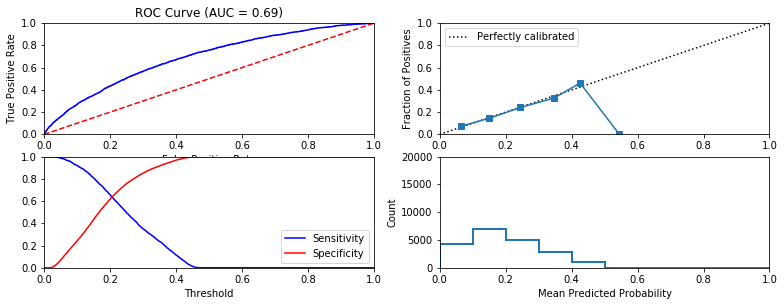


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



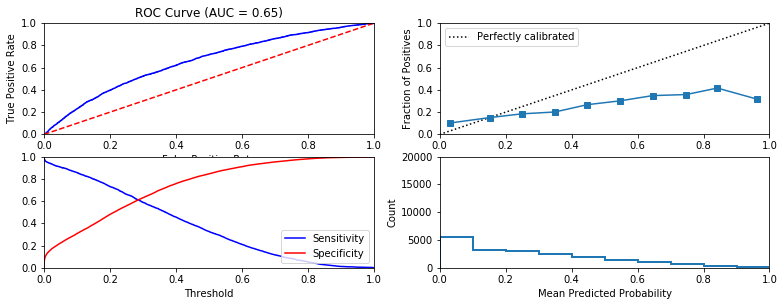


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



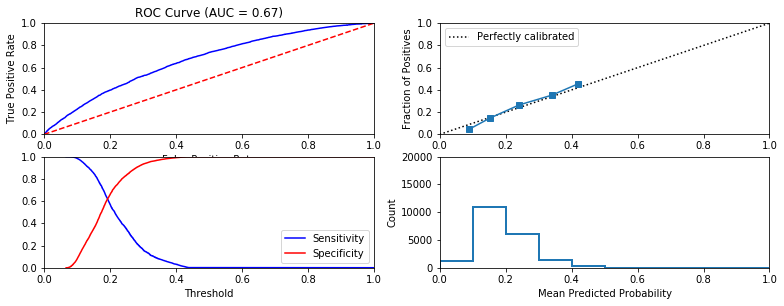


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



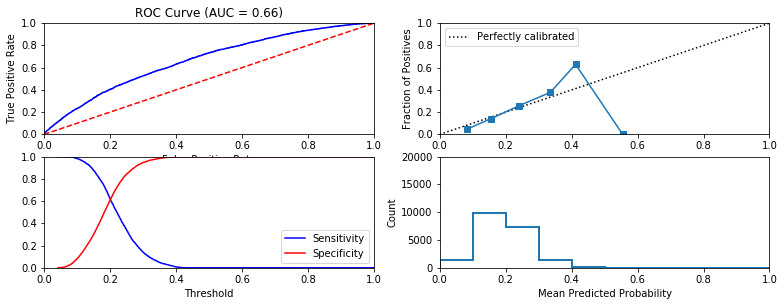


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



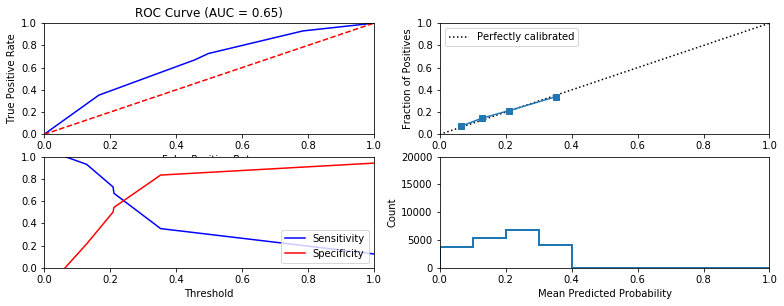


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



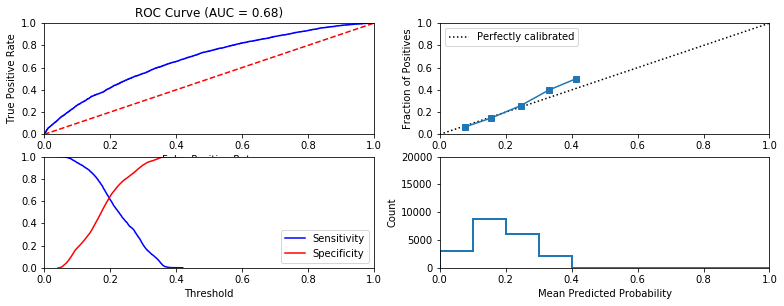


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.6 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



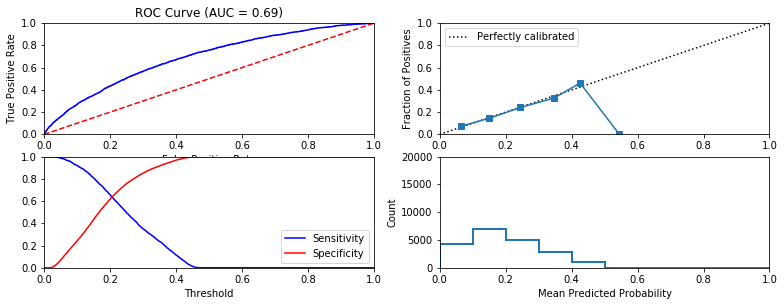


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



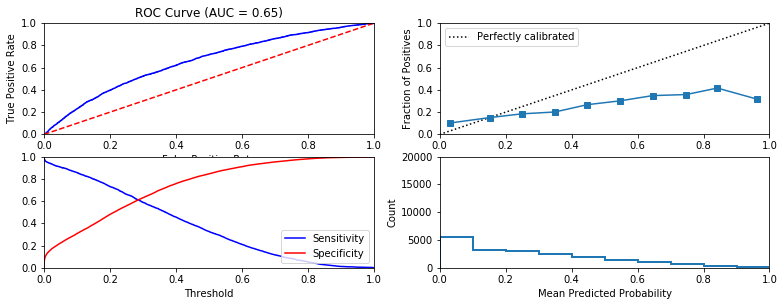


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



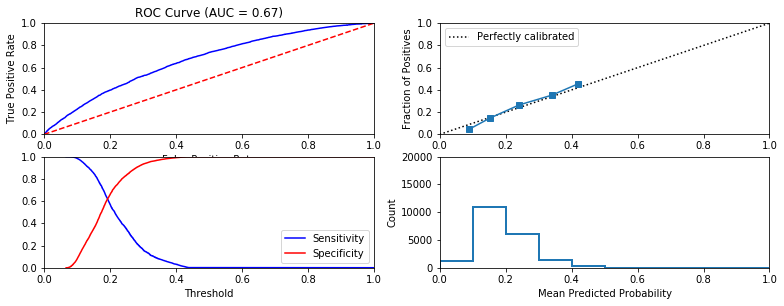


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



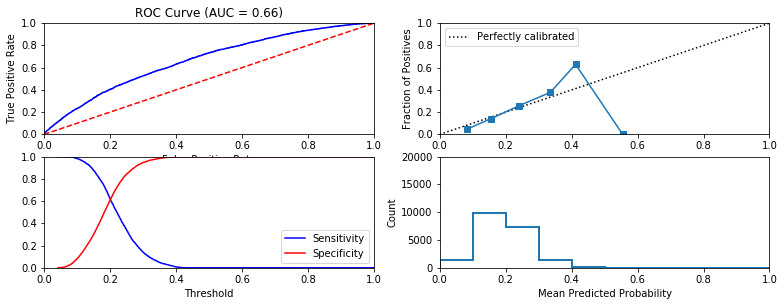


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.21 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



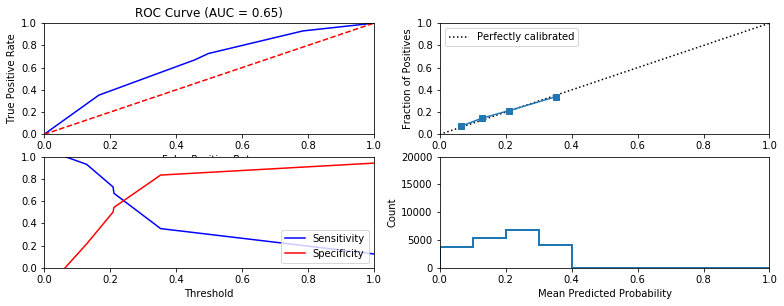


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



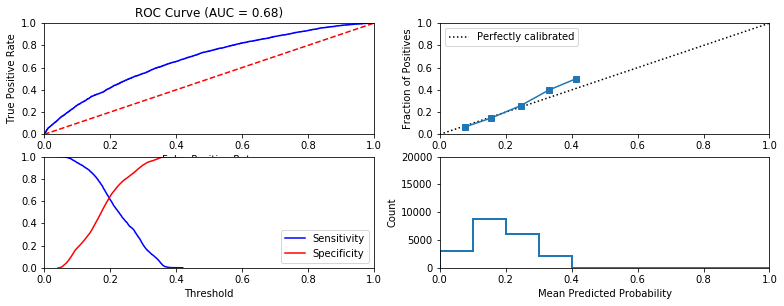


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.9 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



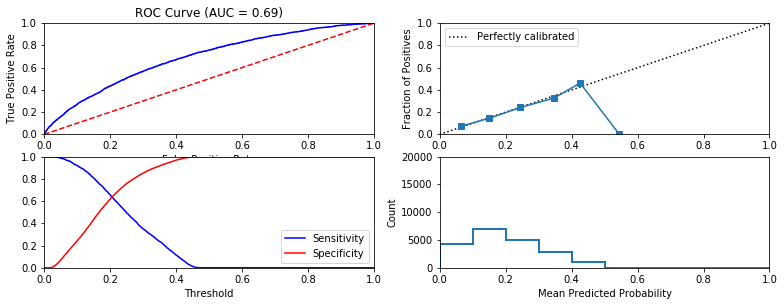


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



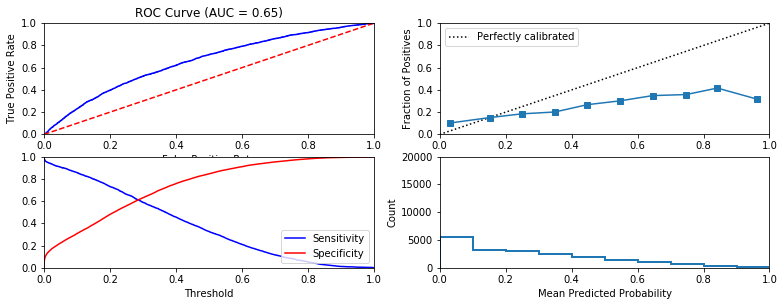


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



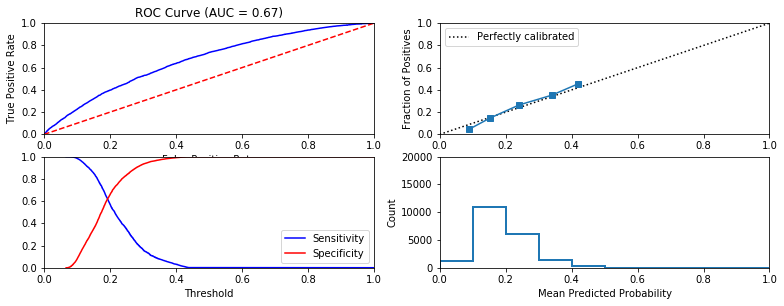


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



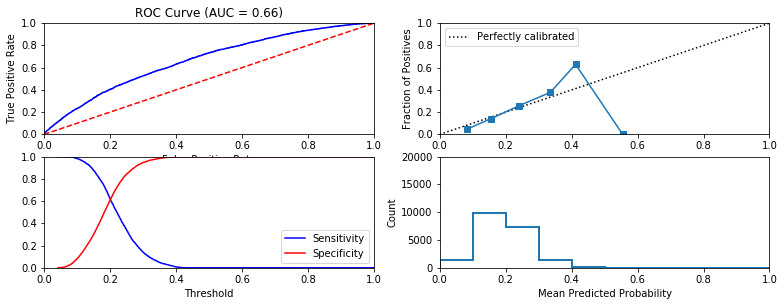


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



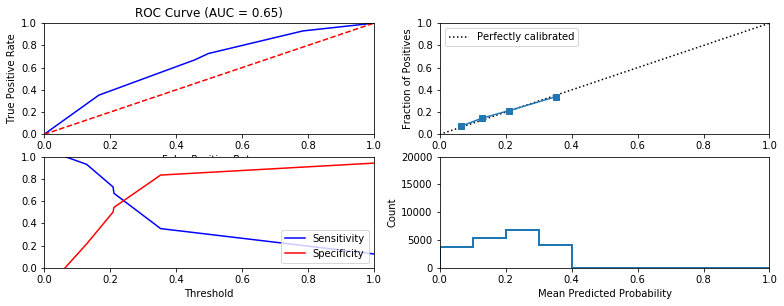


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



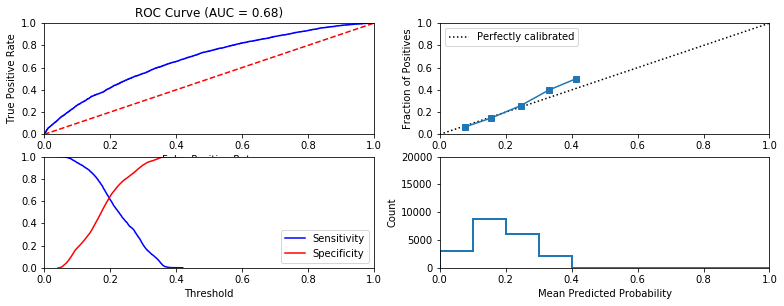


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.03 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



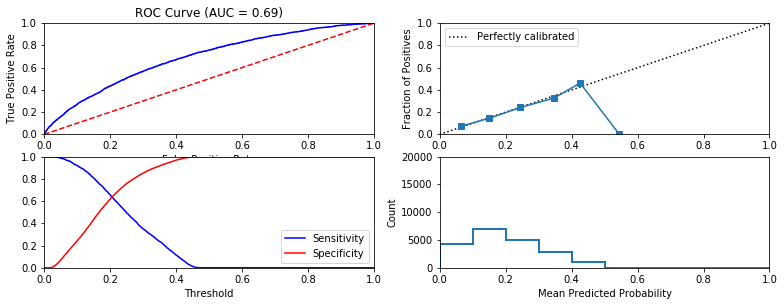


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



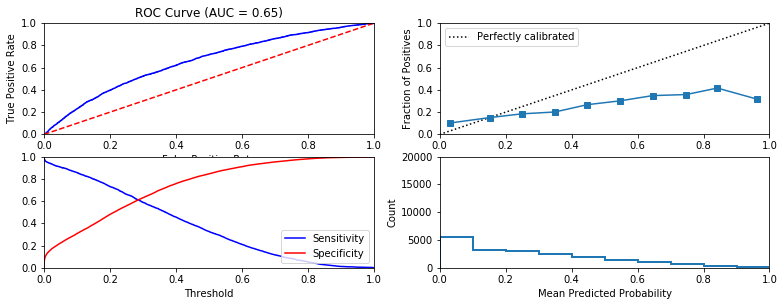


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



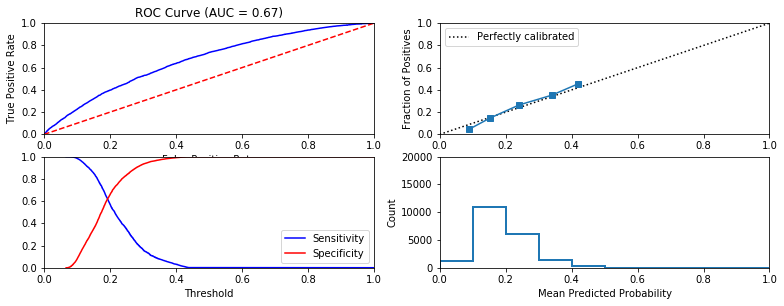


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



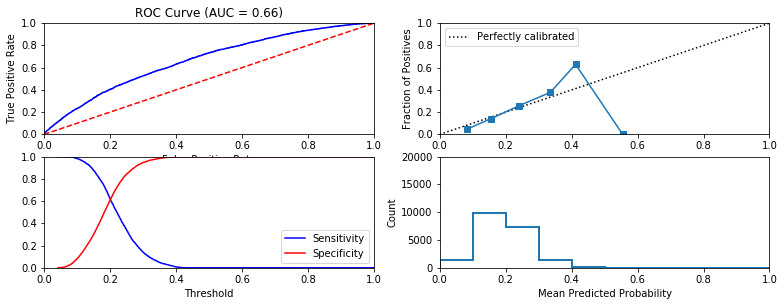


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.24 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



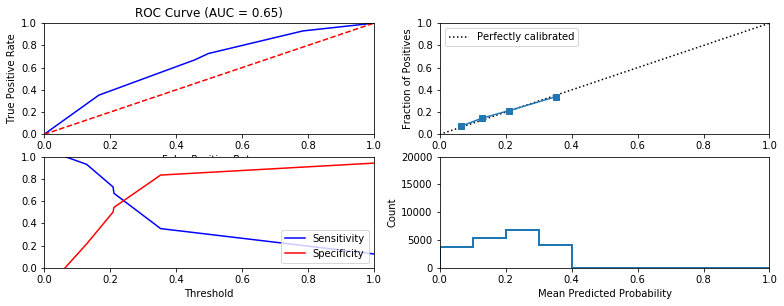


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



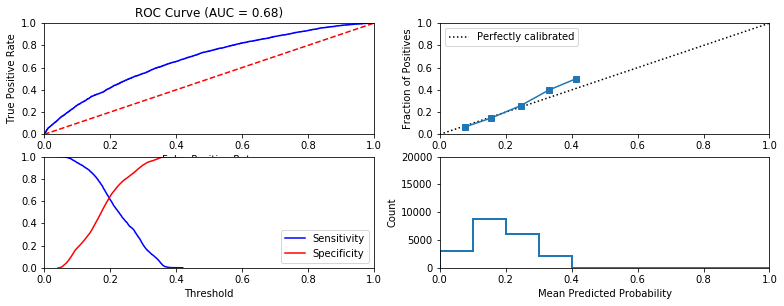


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.8 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



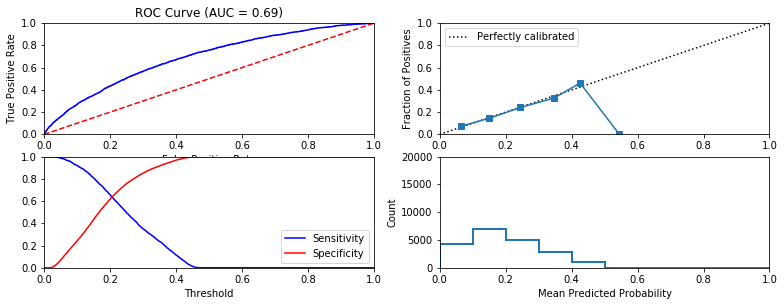


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



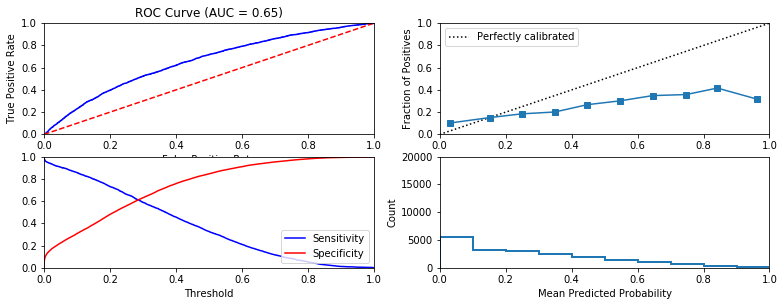


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



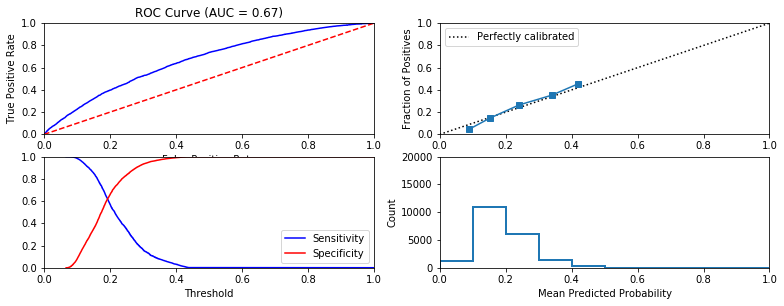


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



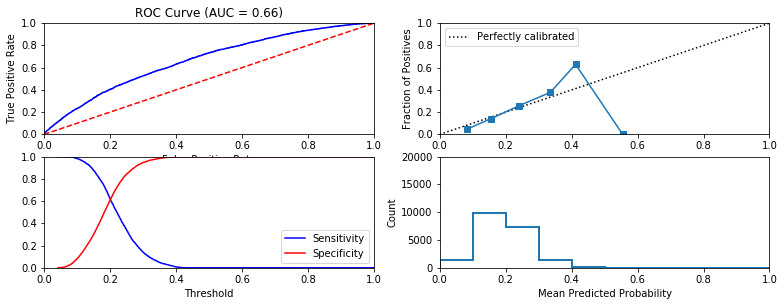


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



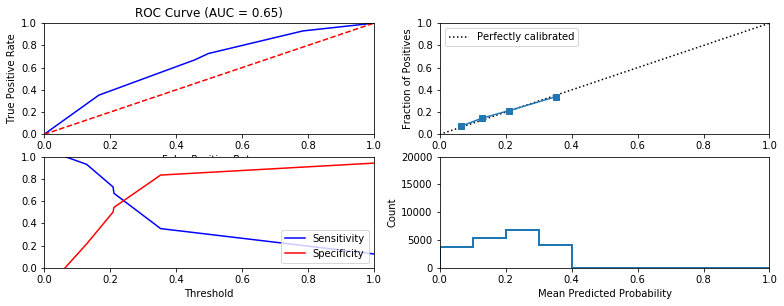


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



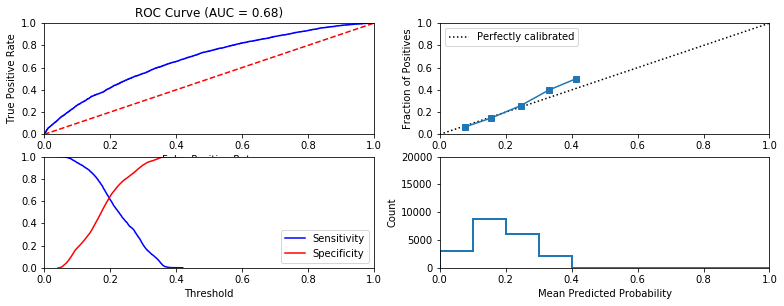


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.71 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



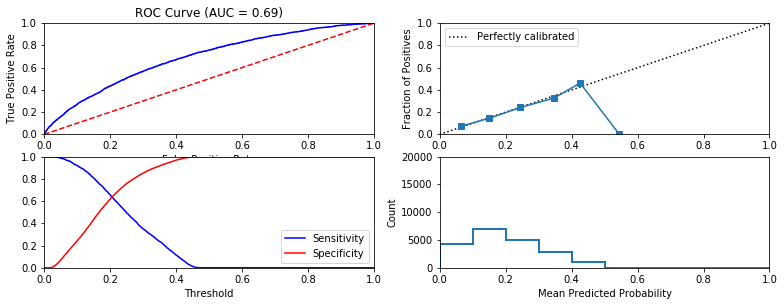


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



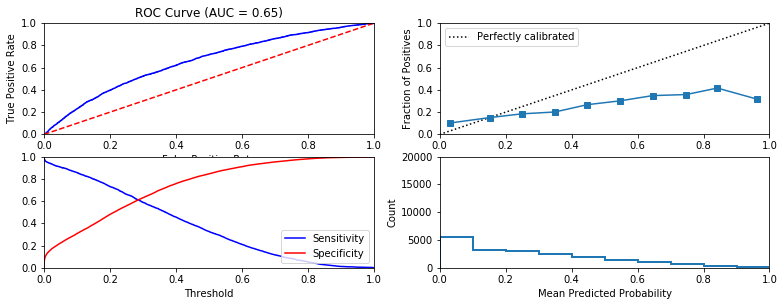


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



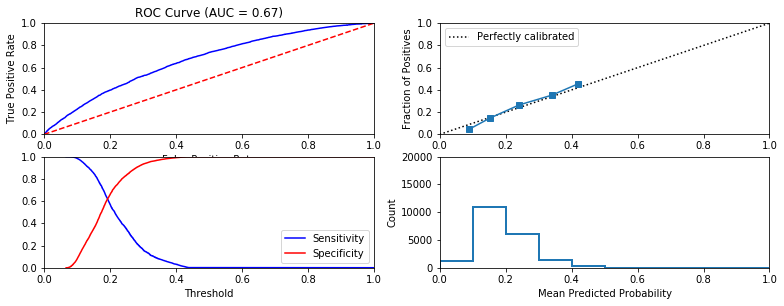


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



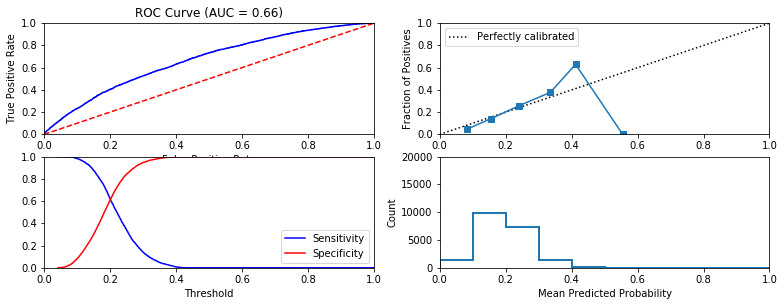


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



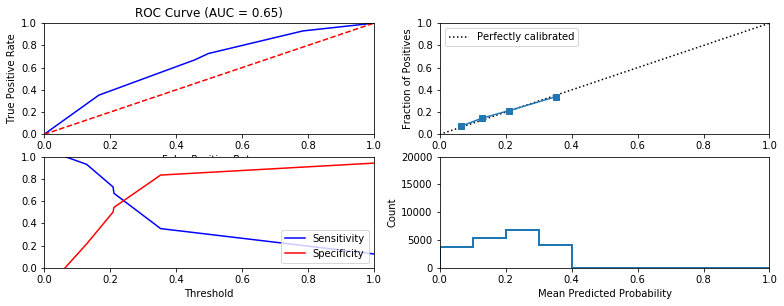


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.71 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



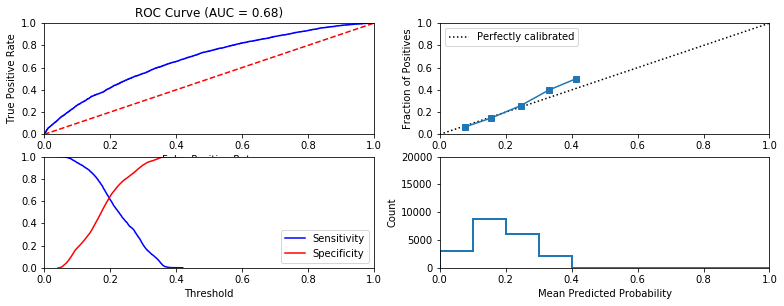


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.54 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



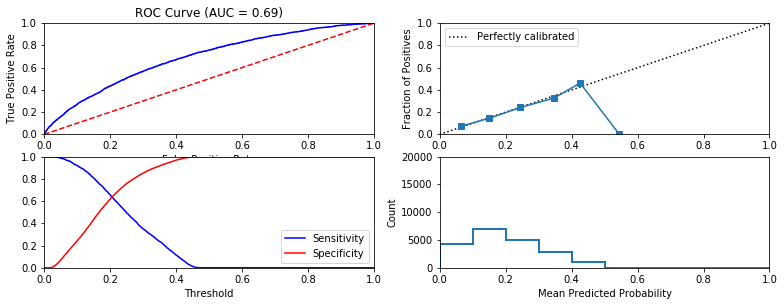


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



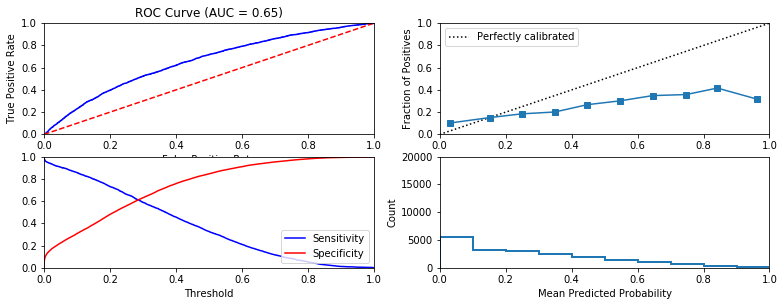


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



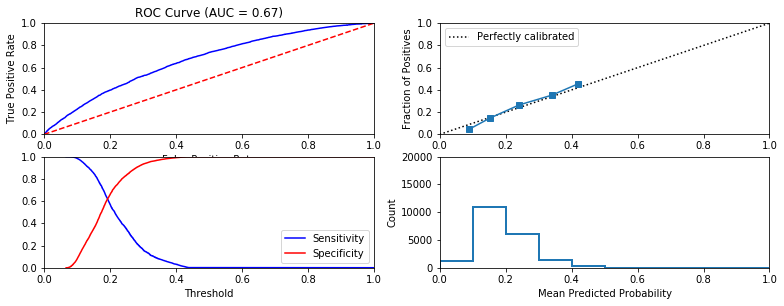


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



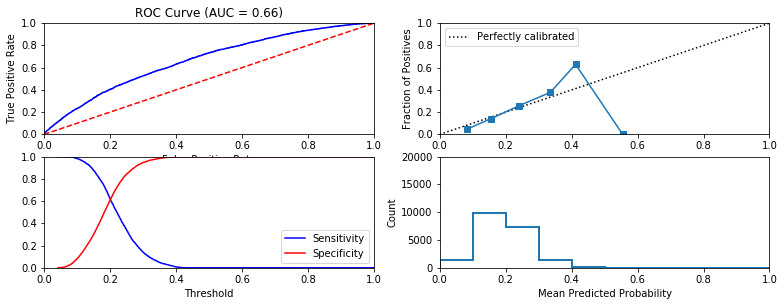


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



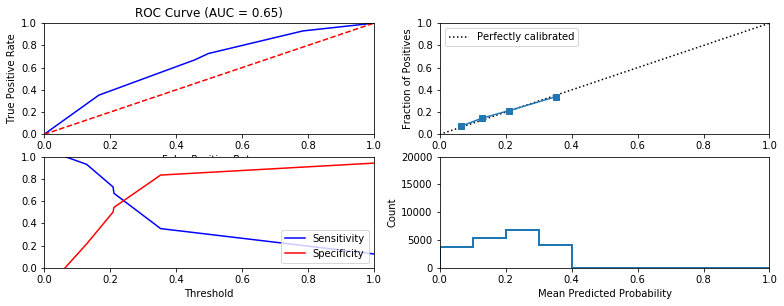


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



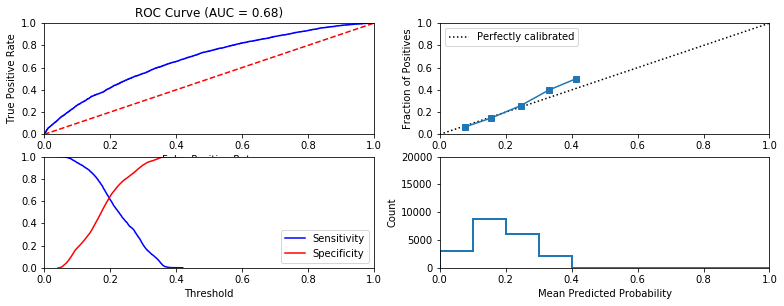


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.6 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



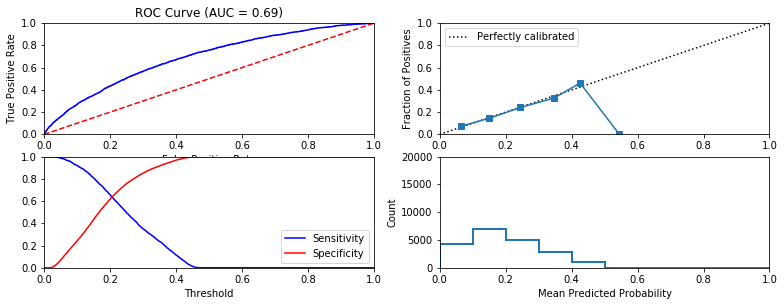


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



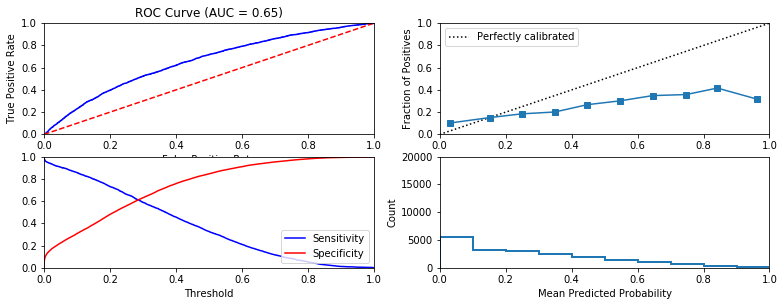


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



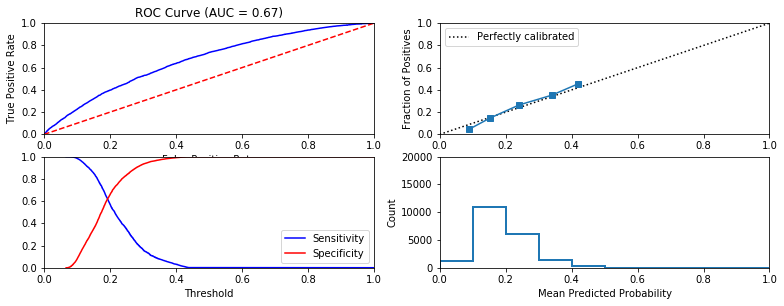


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



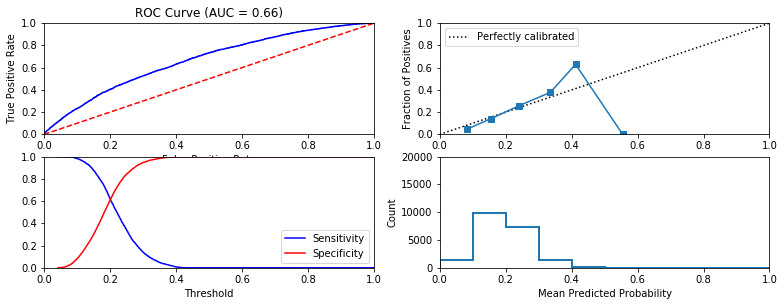


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



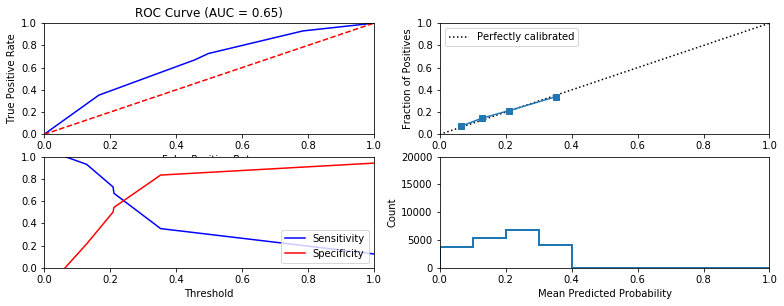


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.81 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



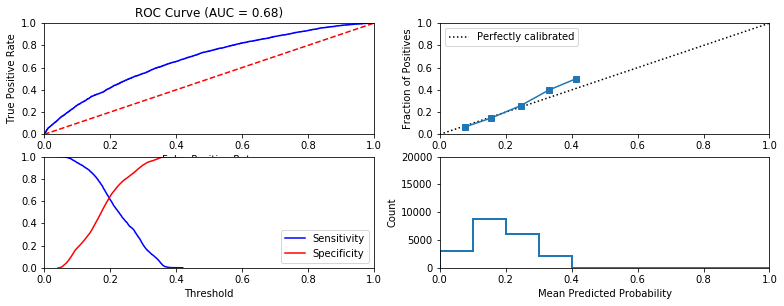


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.51 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



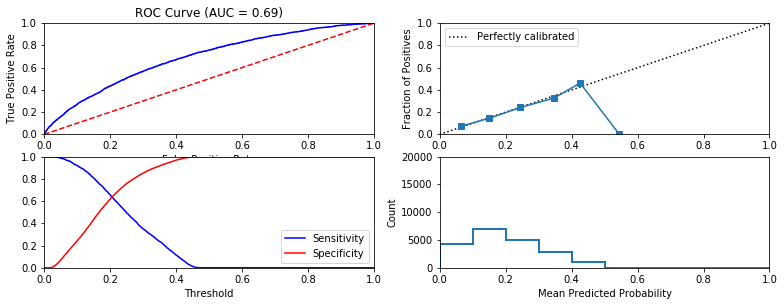


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



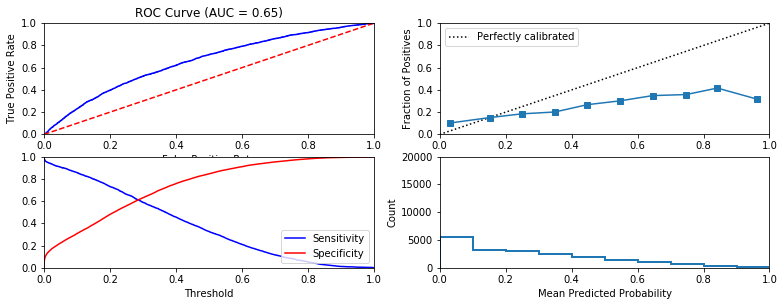


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



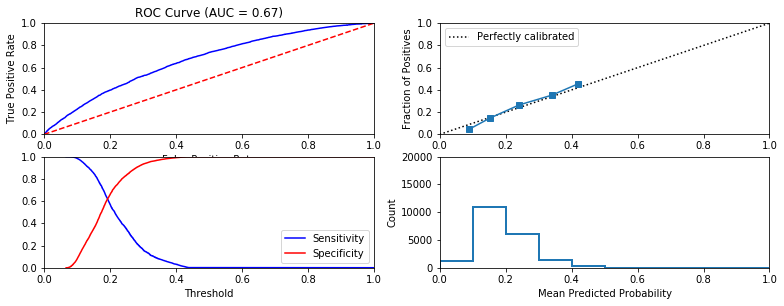


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



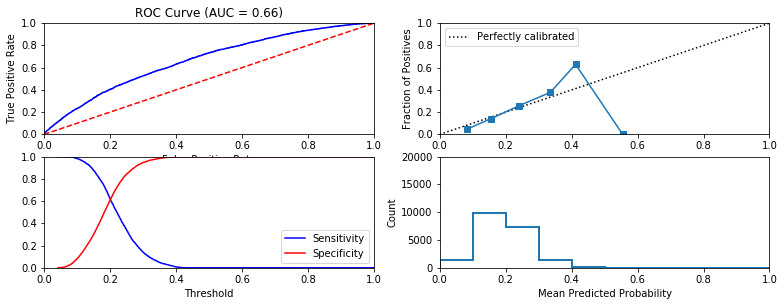


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



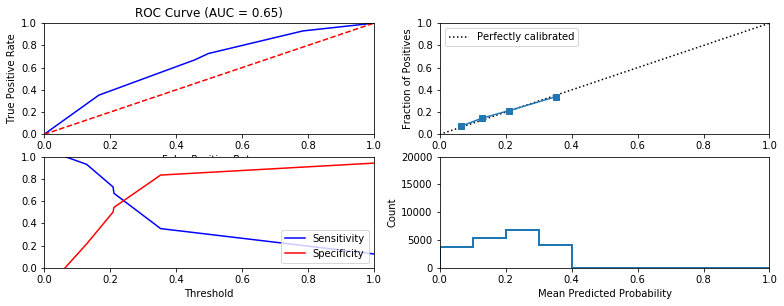


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



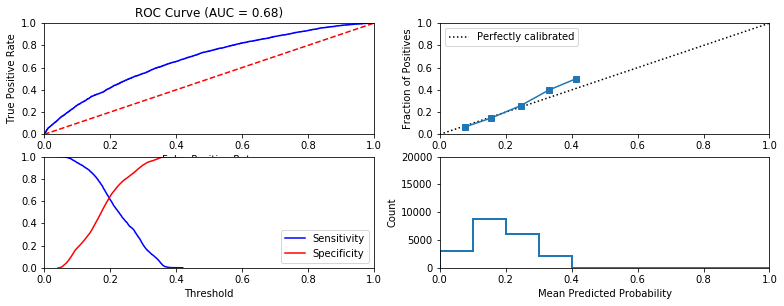


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



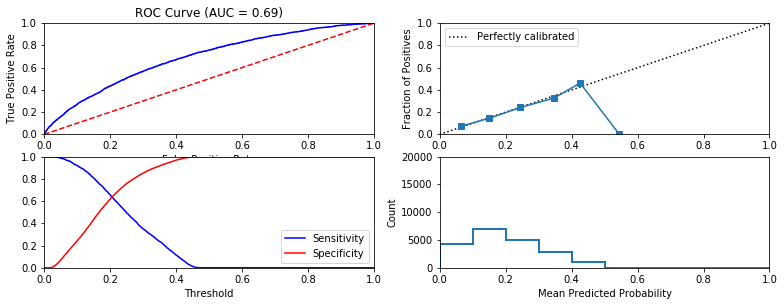


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



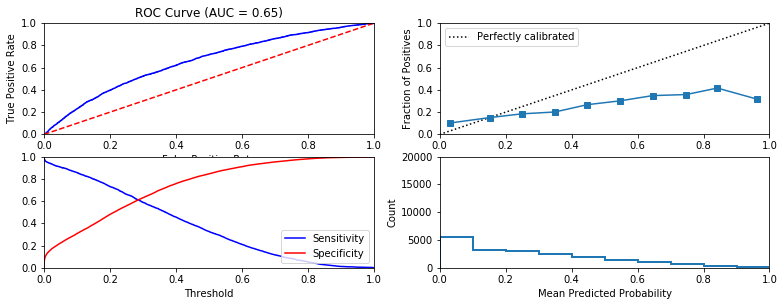


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



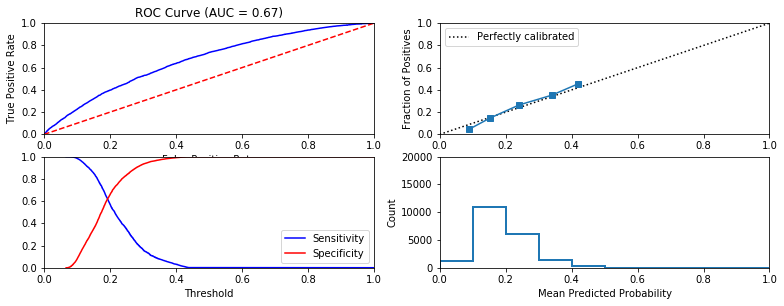


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



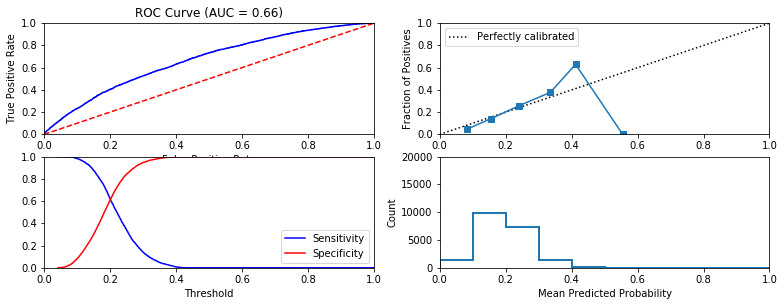


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



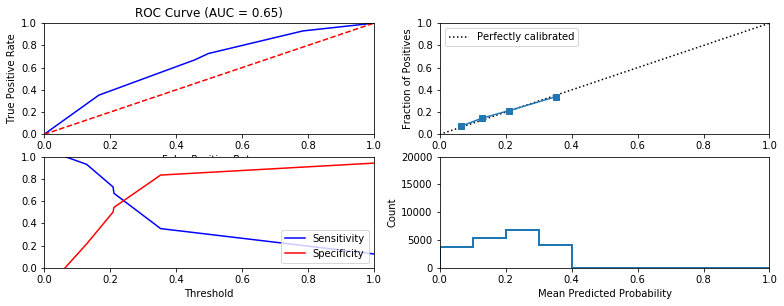


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.69 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



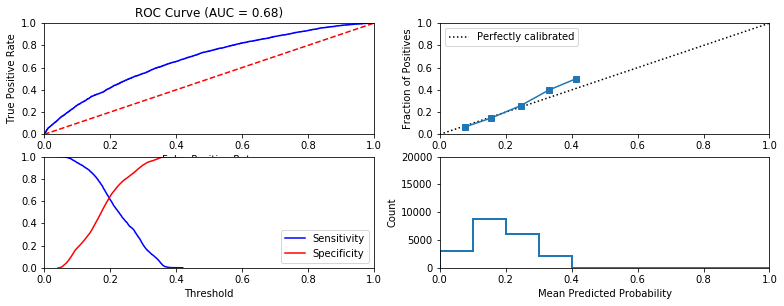


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.62 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



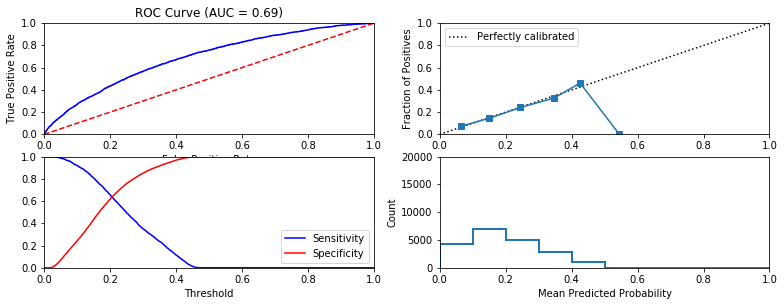


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



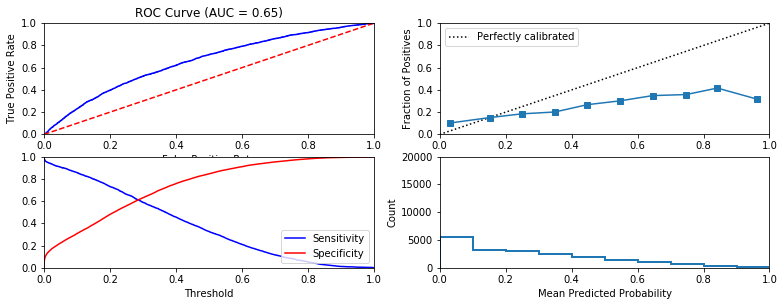


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



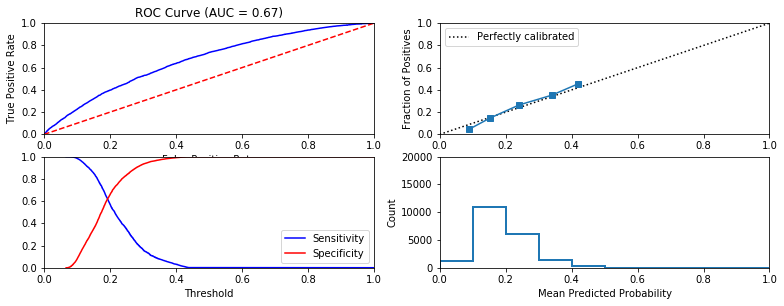


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.15 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



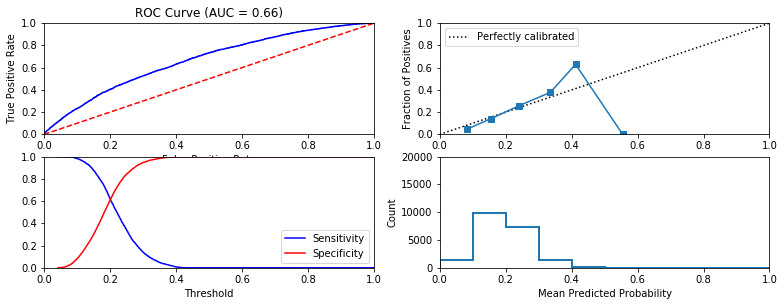


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.21 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



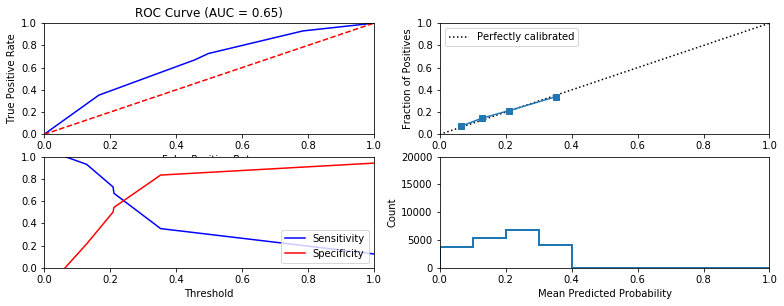


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



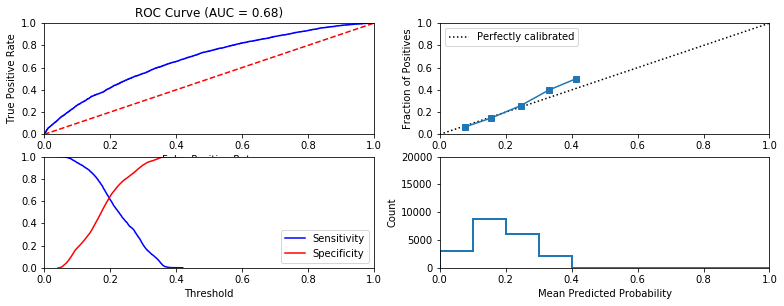


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.42 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



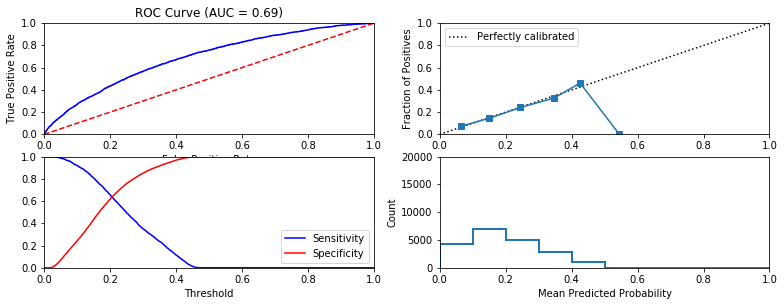


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



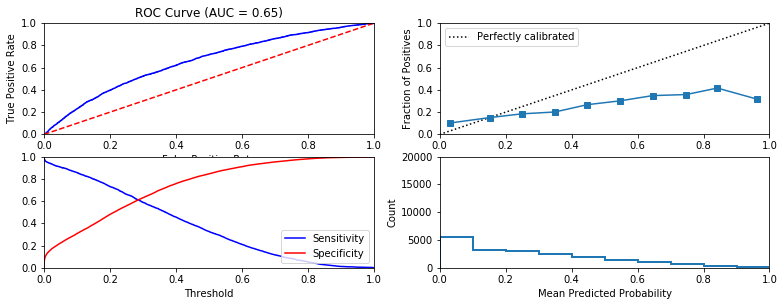


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



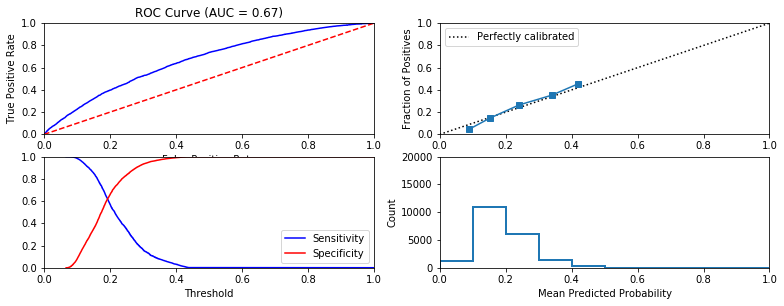


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



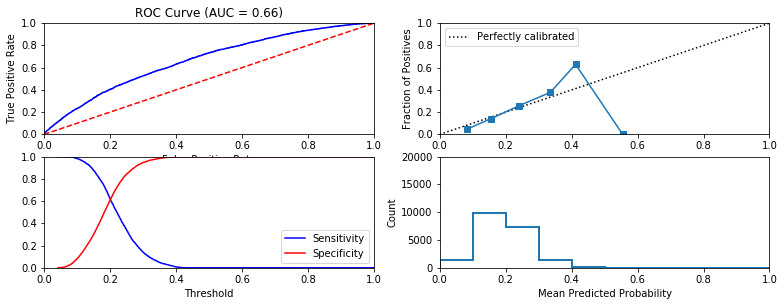


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



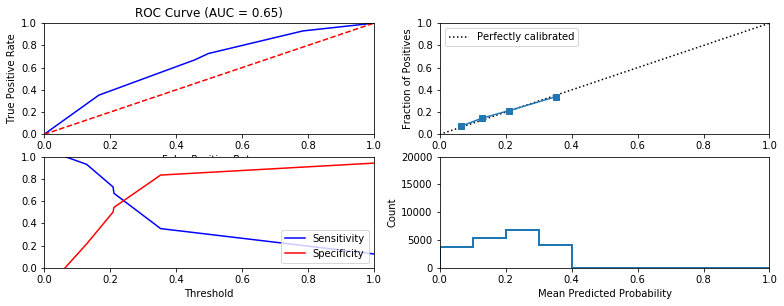


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.75 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



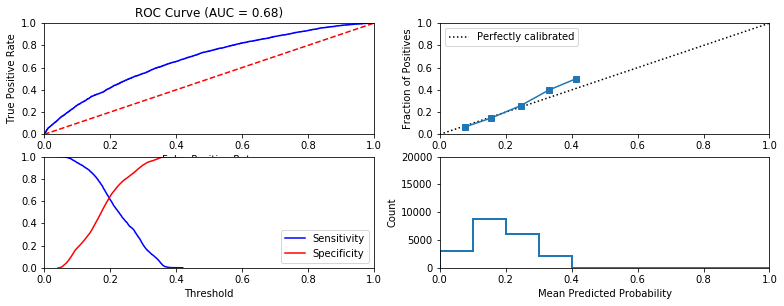


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.36 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



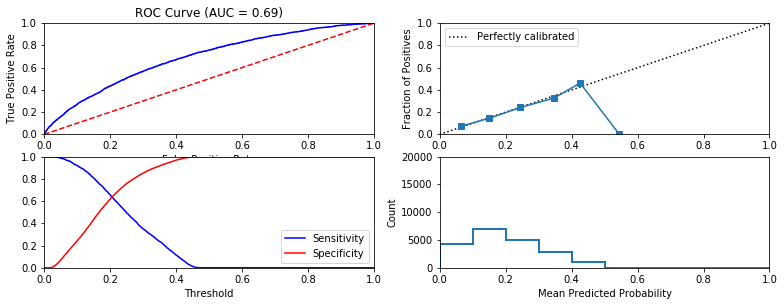


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



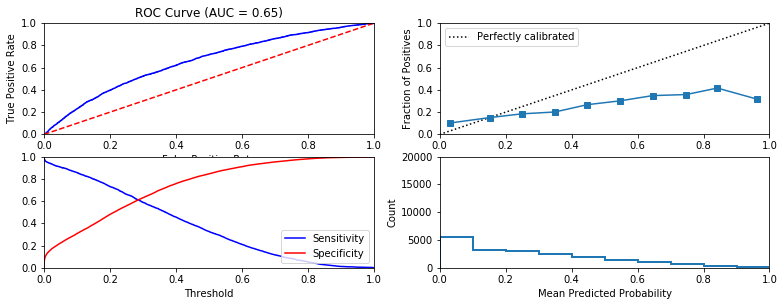


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



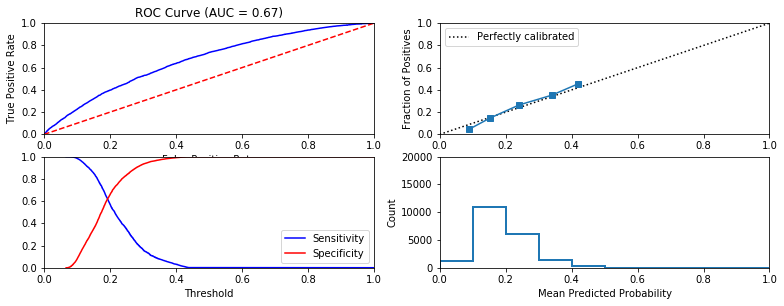


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



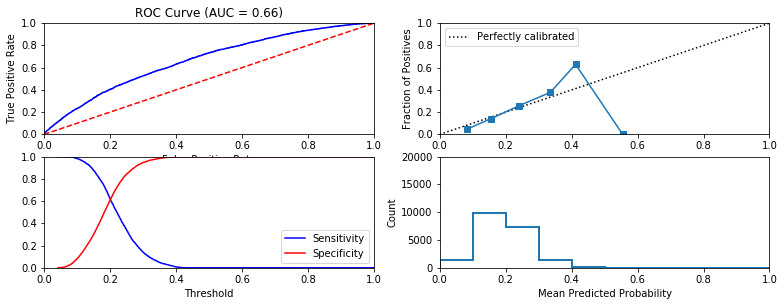


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



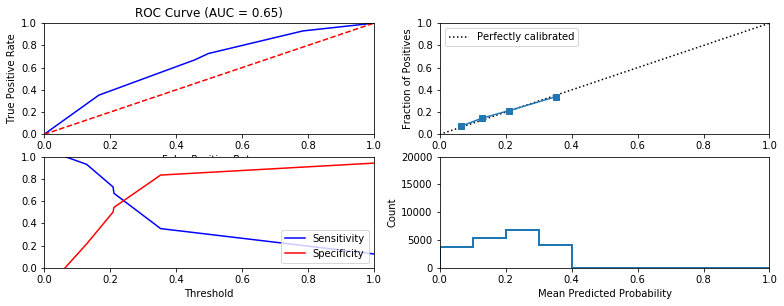


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



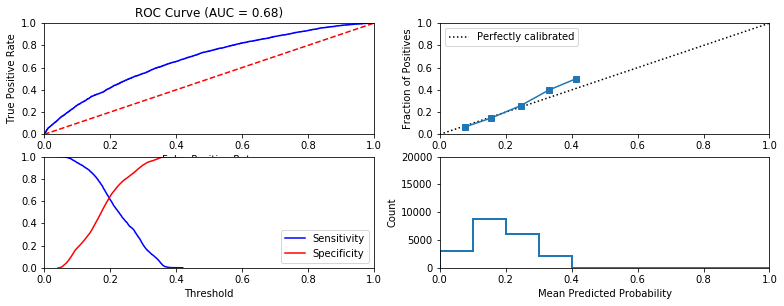


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



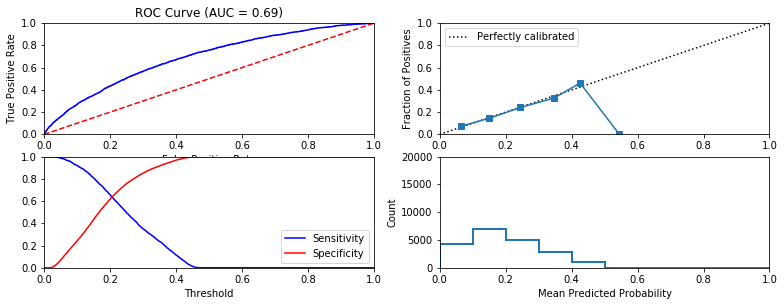


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



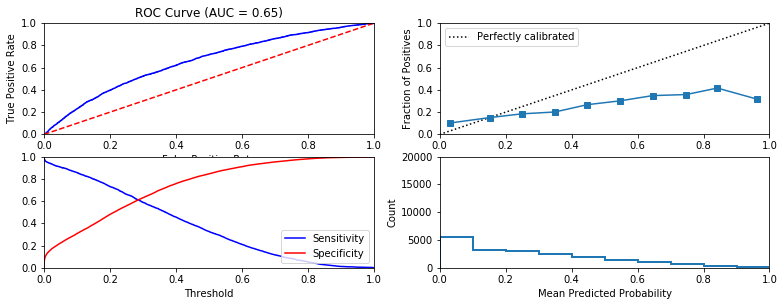


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



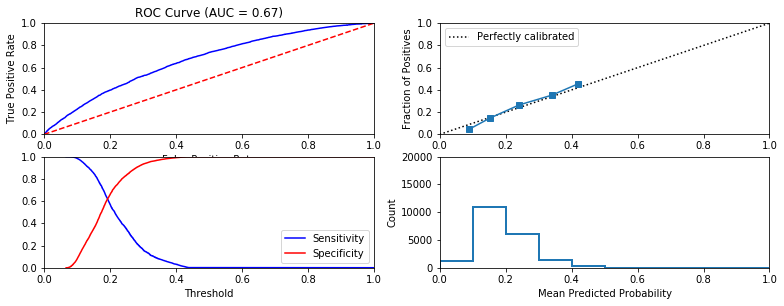


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



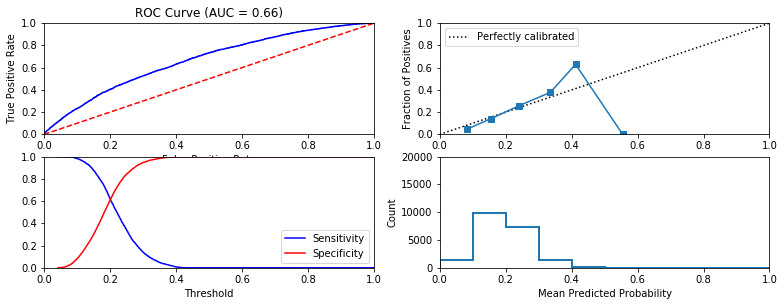


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



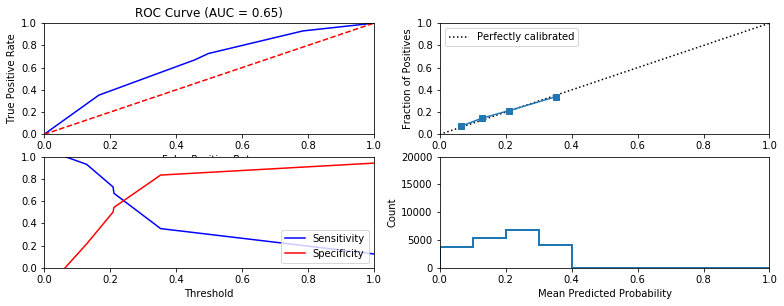


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.8 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



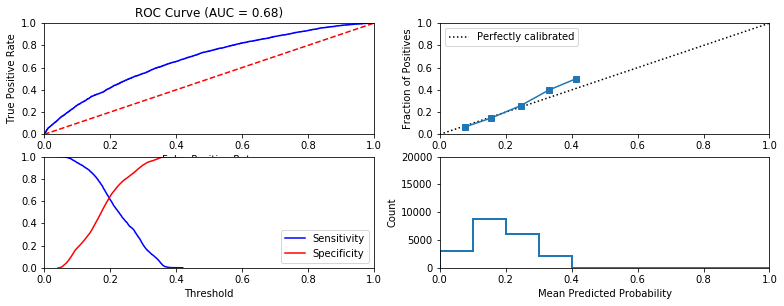


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.97 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



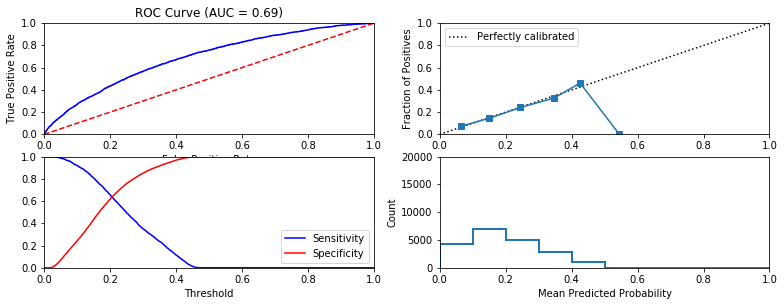


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



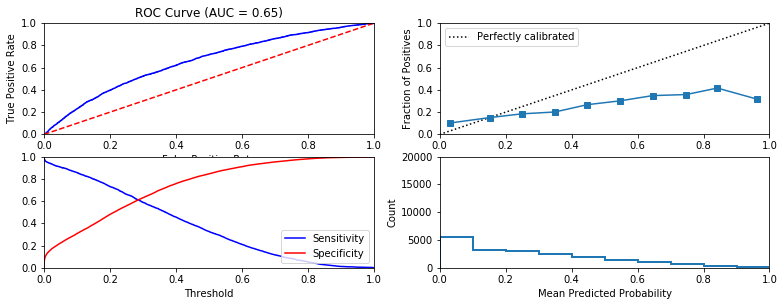


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



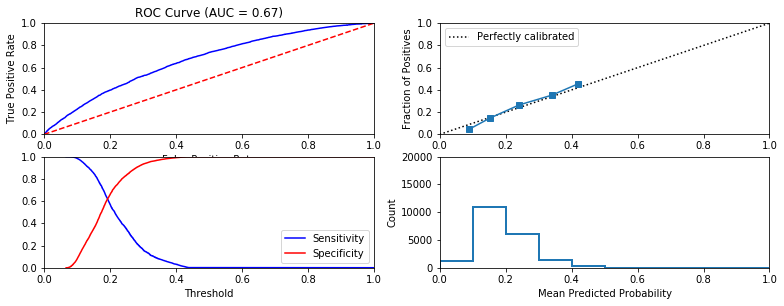


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



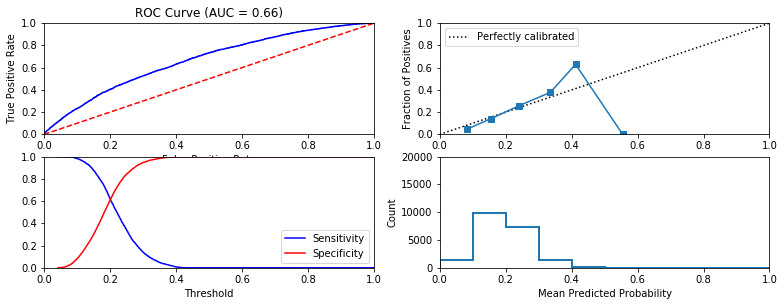


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



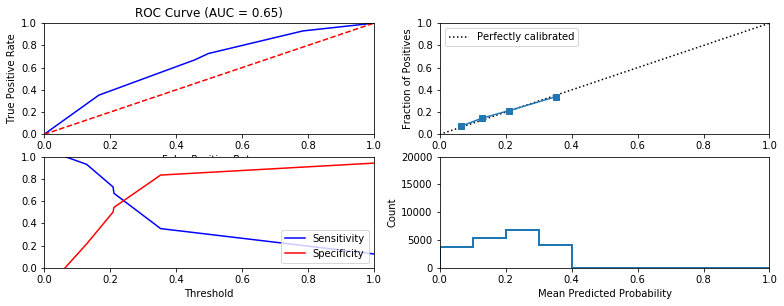


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.79 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



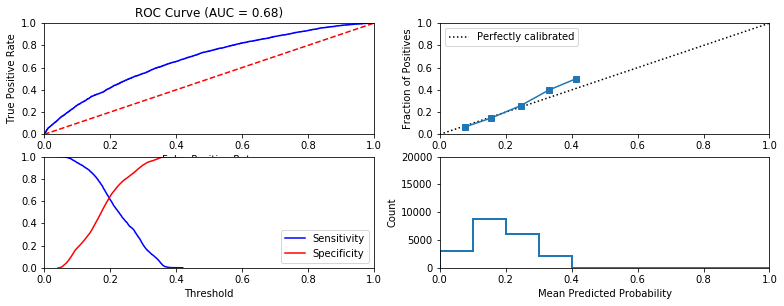


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.53 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



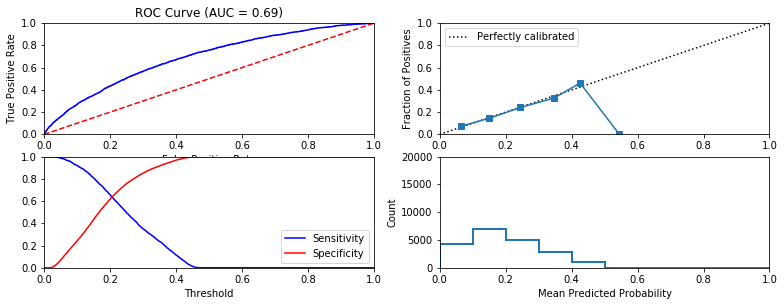


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



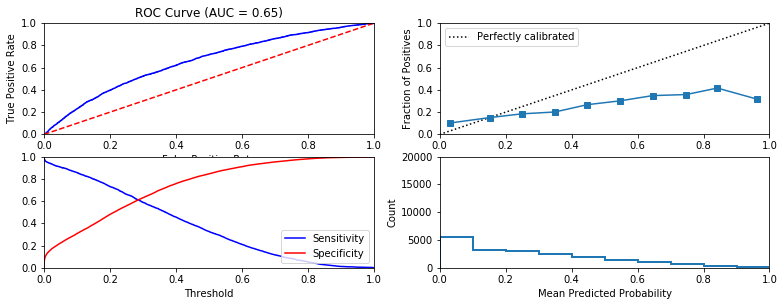


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



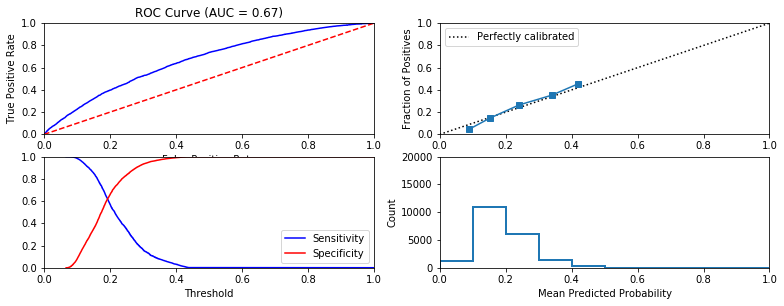


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



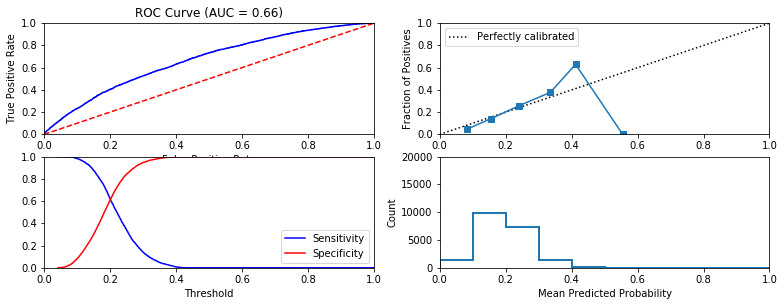


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



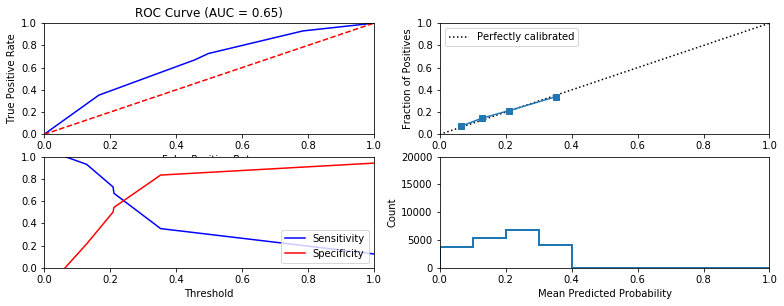


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



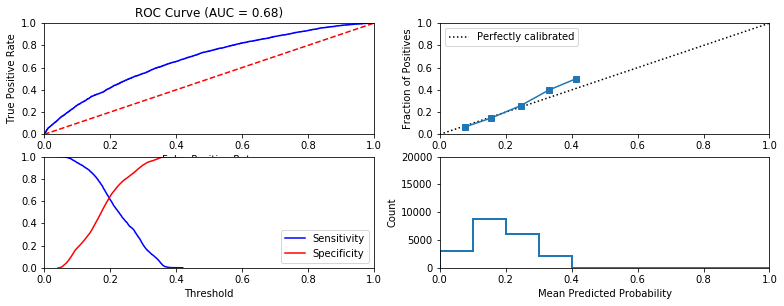


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.55 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



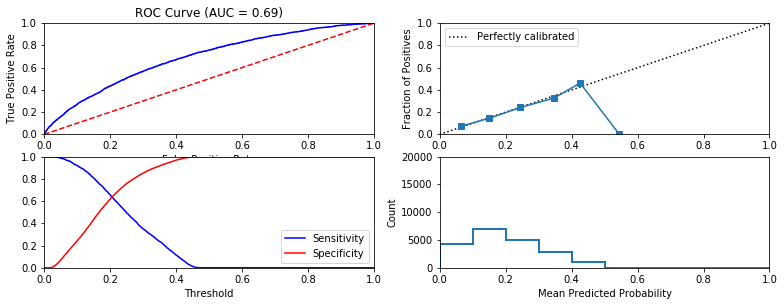


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



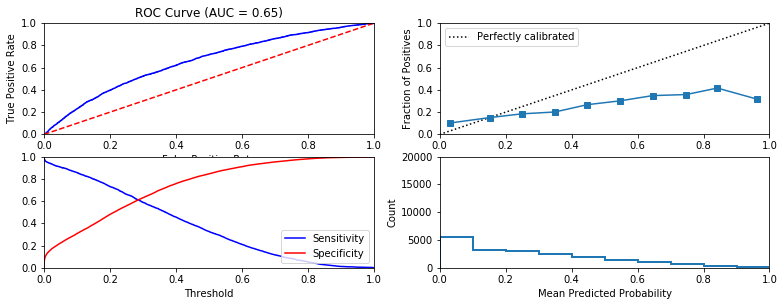


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



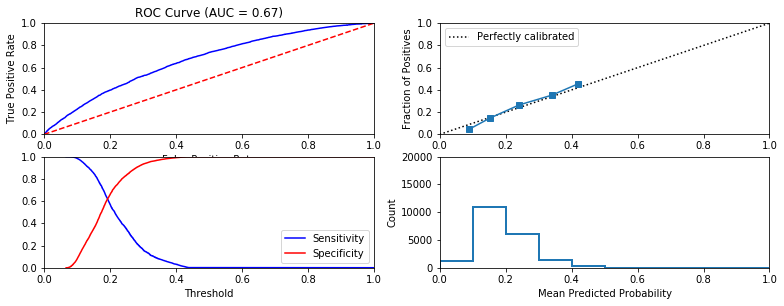


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



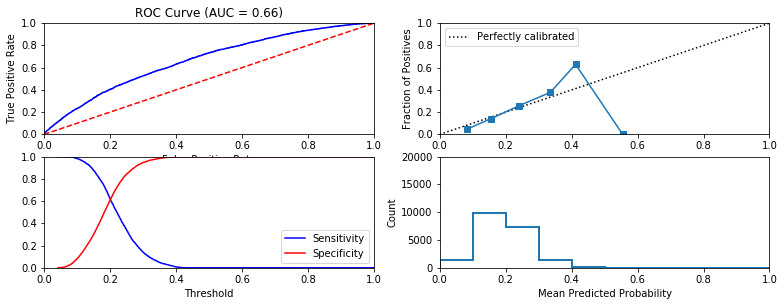


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



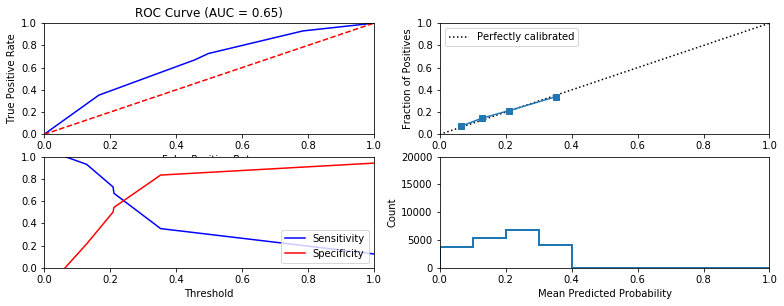


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



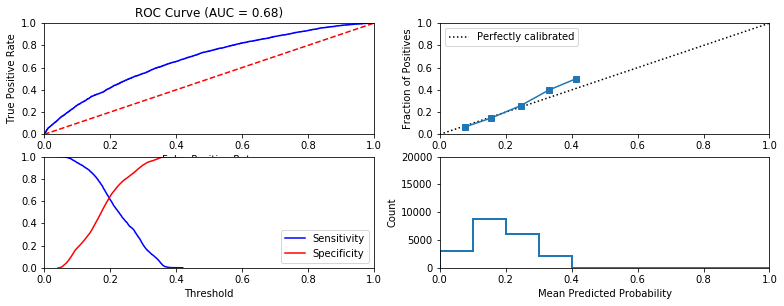


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.52 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



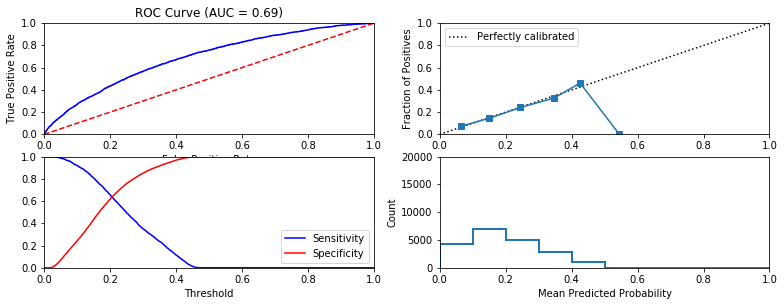


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



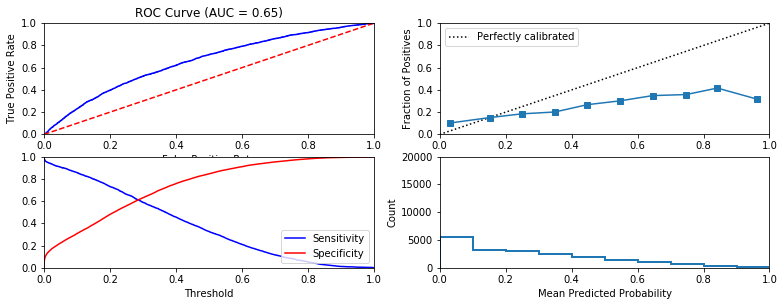


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



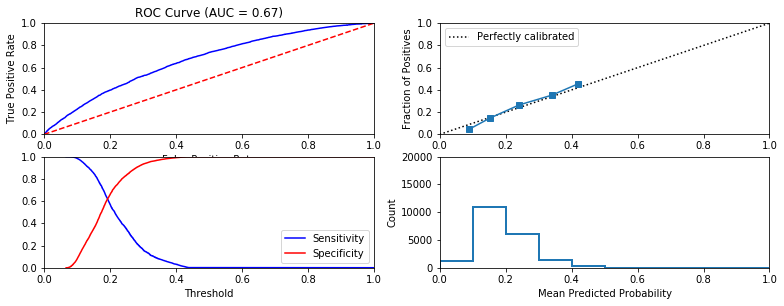


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



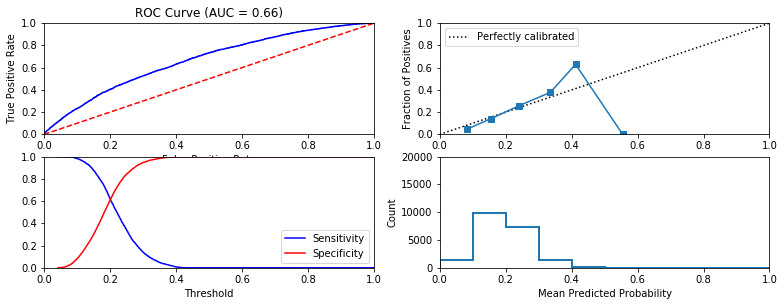


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



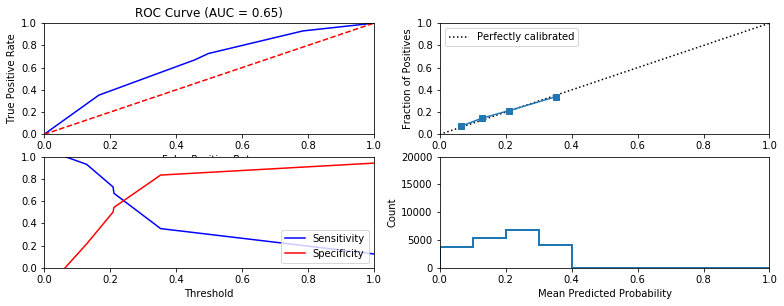


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



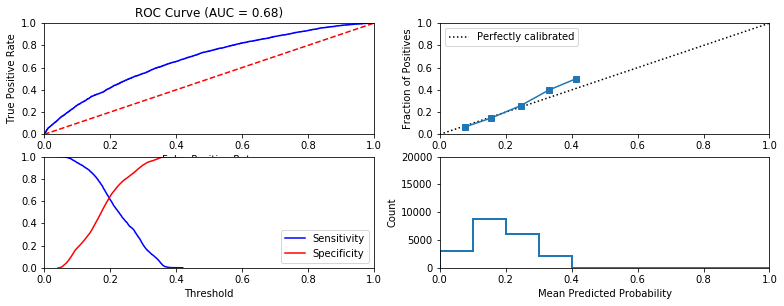


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.61 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



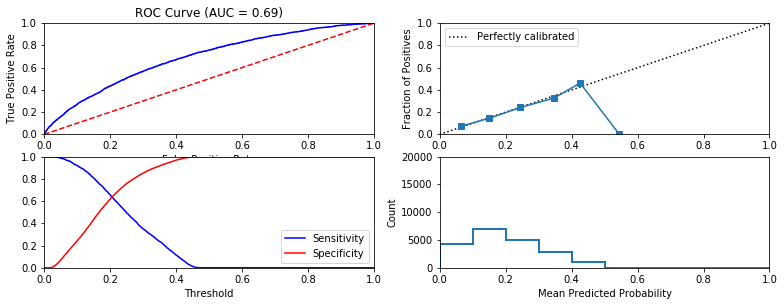


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



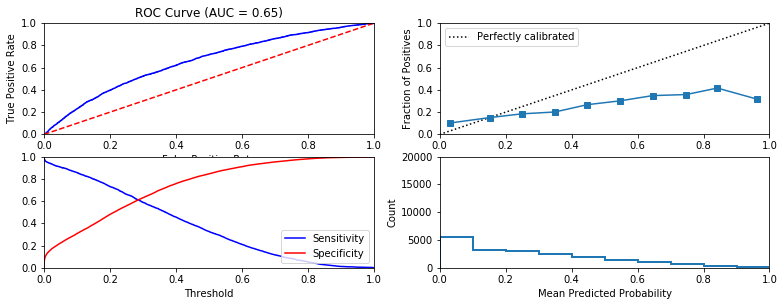


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



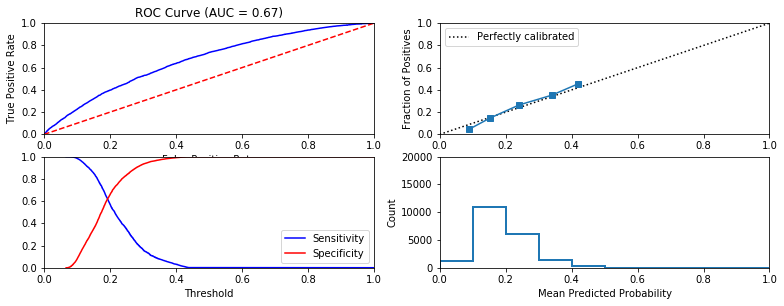


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



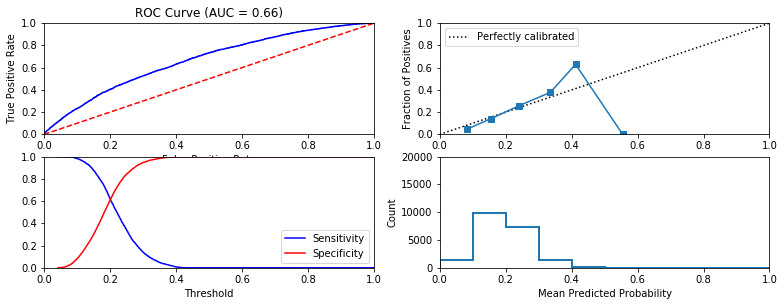


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



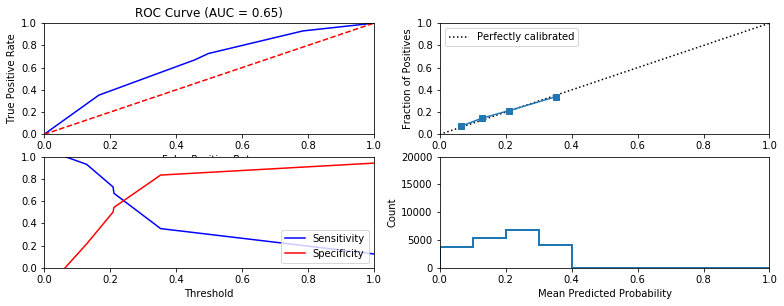


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.71 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



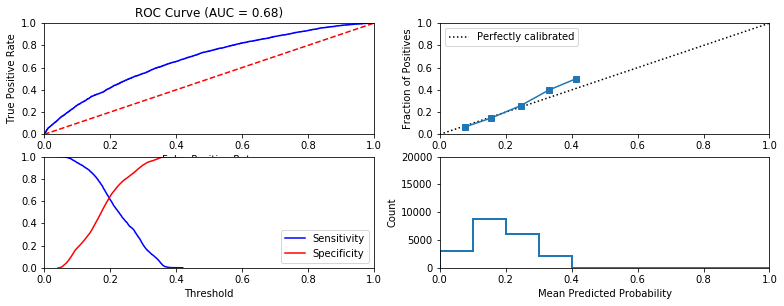


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.84 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



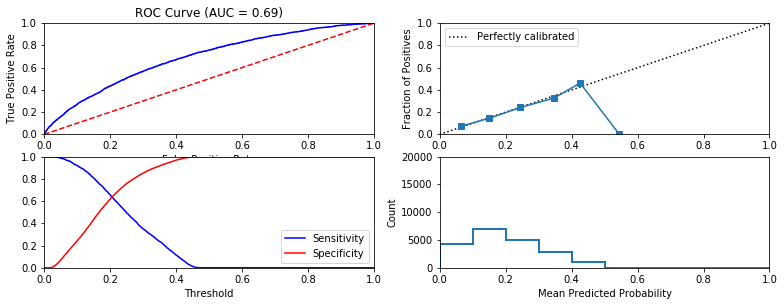


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



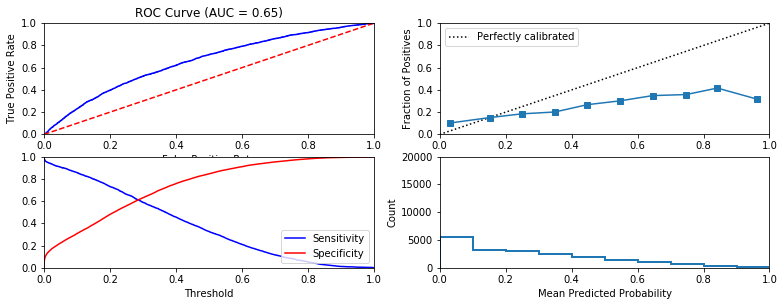


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



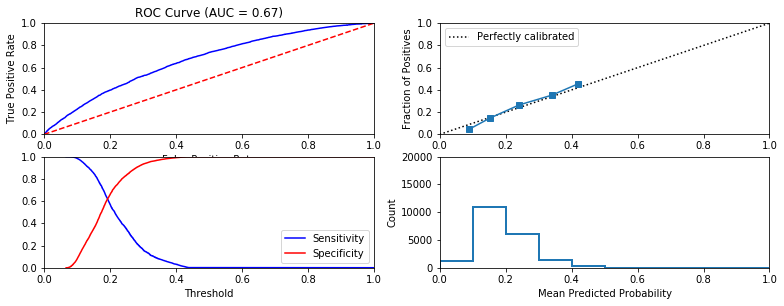


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



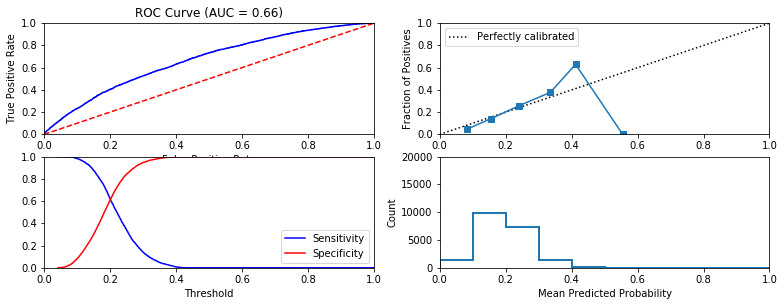


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



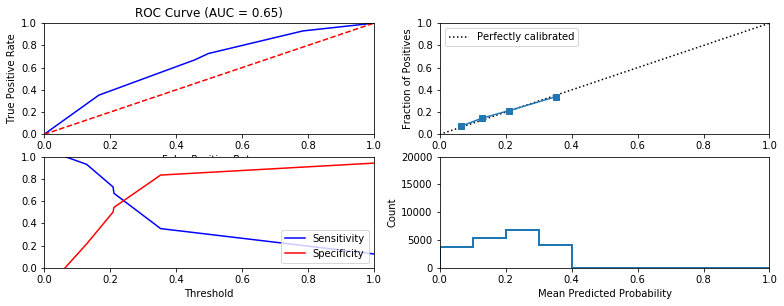


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.75 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



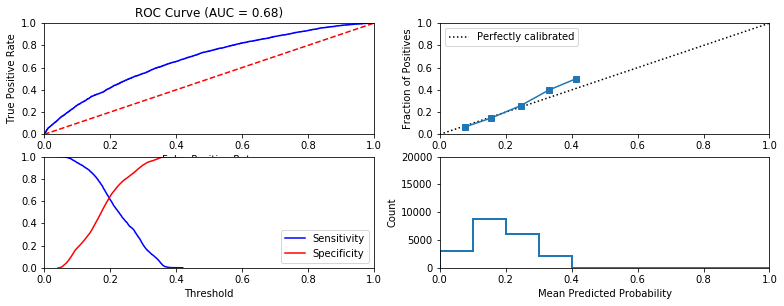


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.46 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



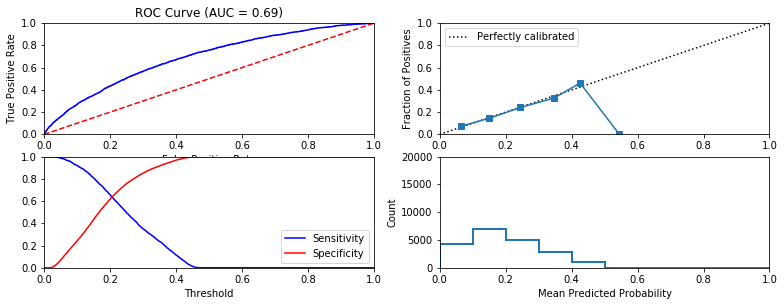


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



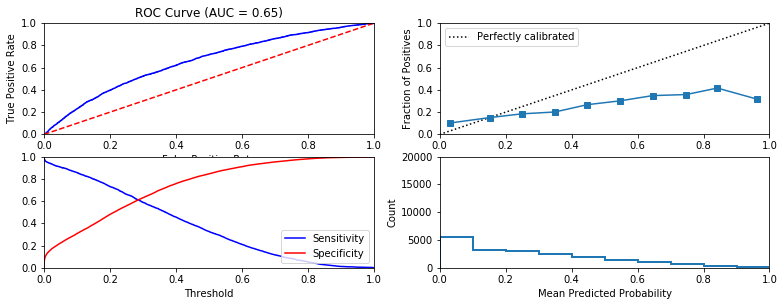


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



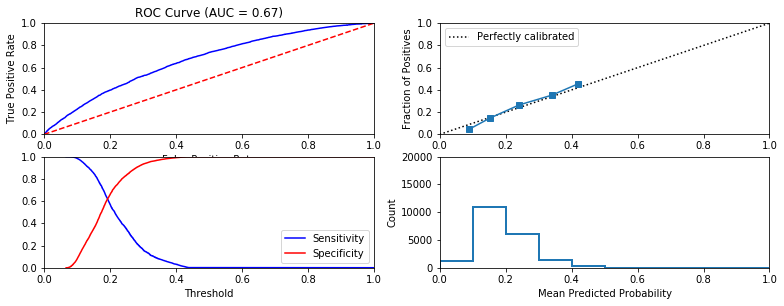


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



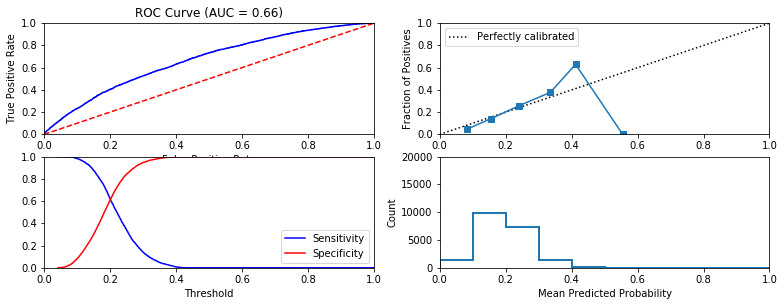


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



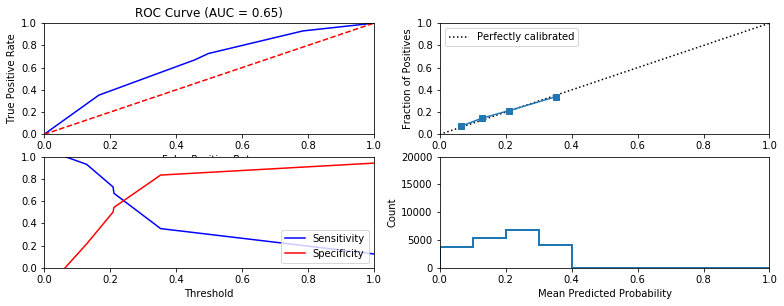


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



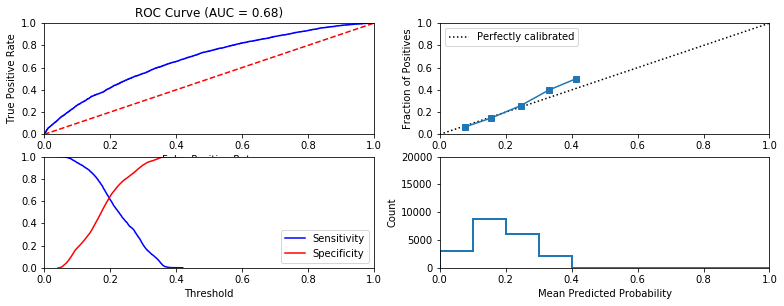


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.57 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



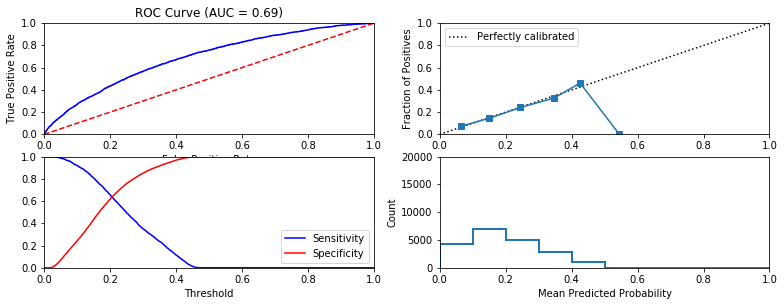


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



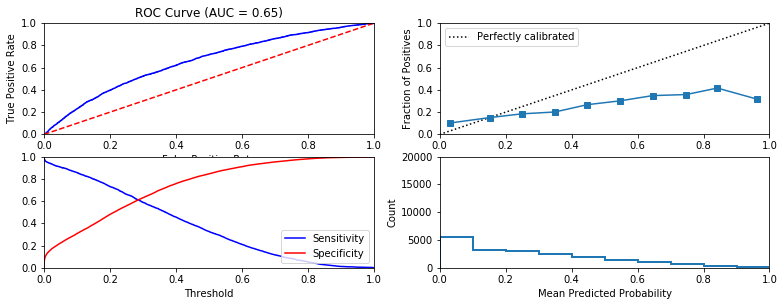


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



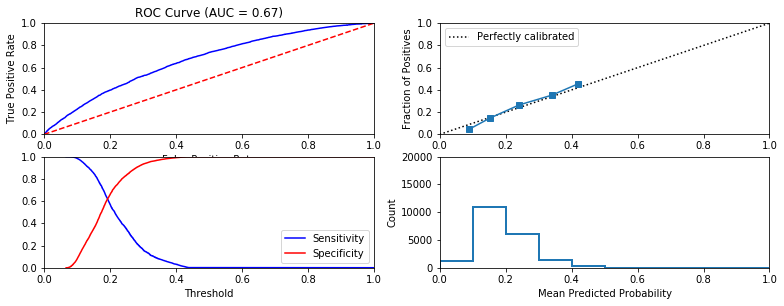


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



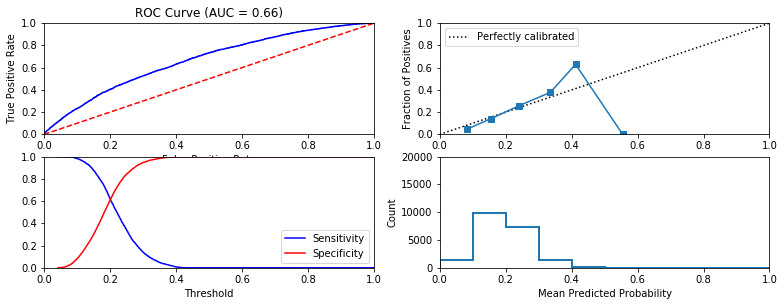


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



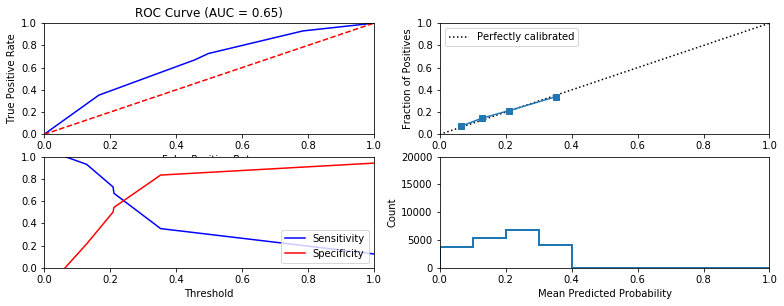


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



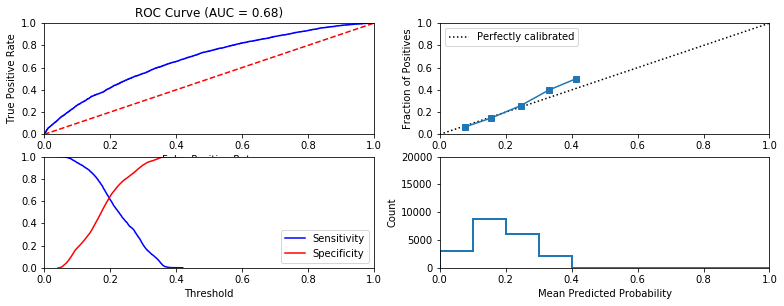


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.6 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



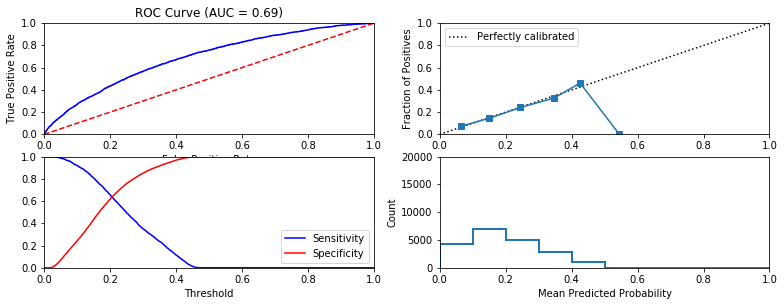


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



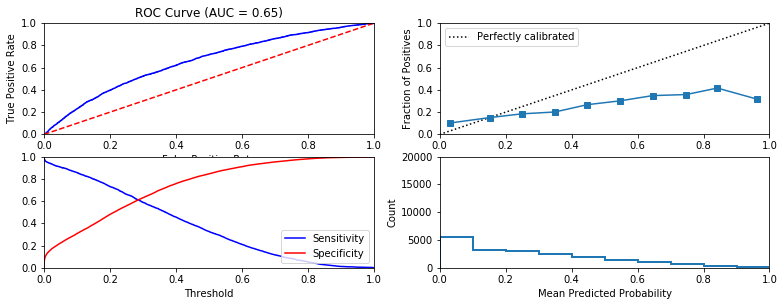


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



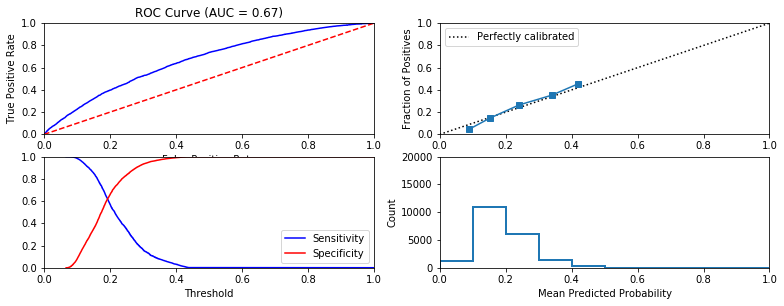


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



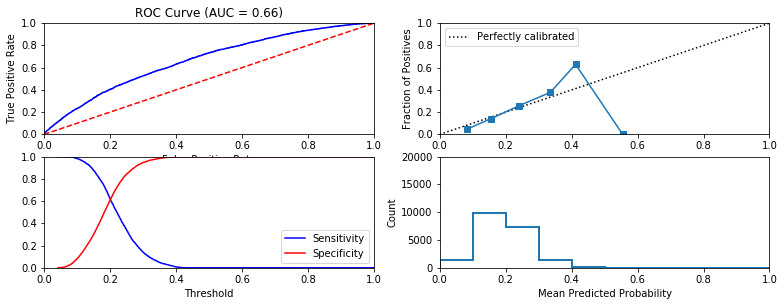


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



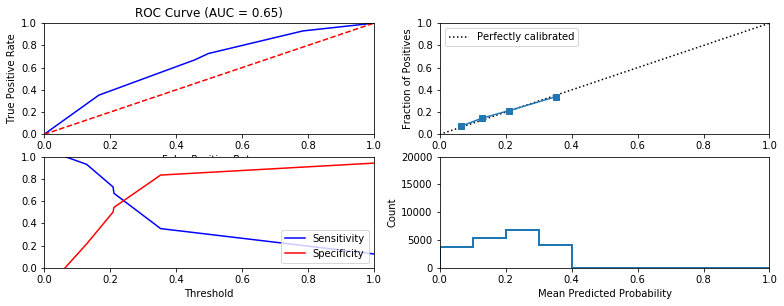


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



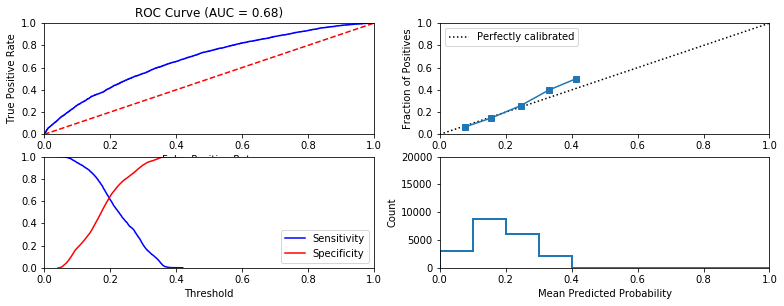


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.62 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



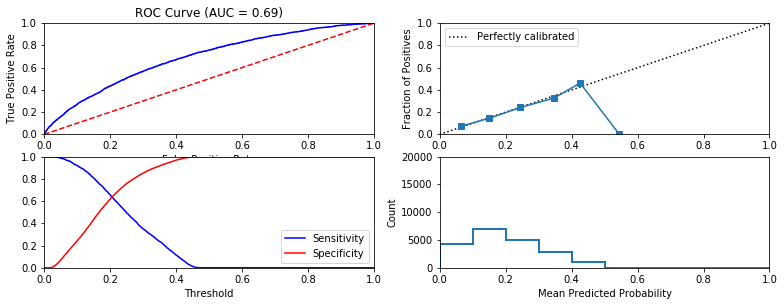


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



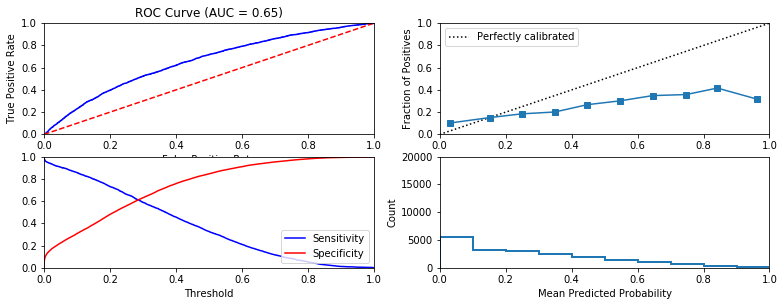


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



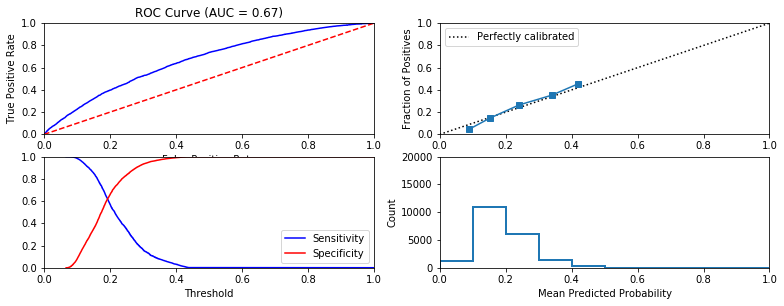


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



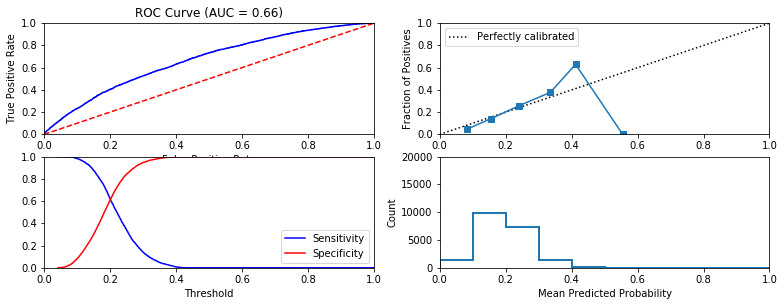


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.24 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



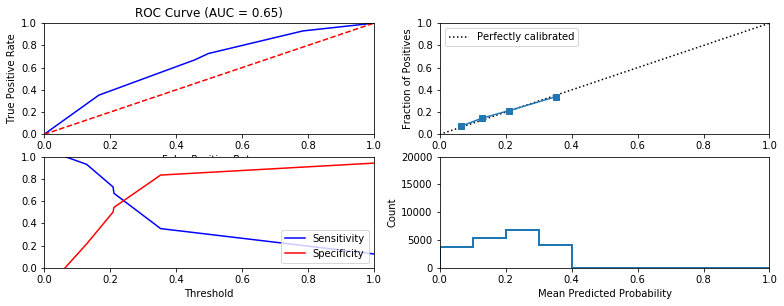


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.71 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



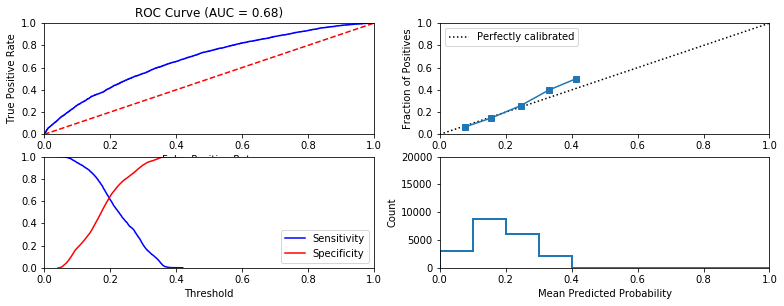


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



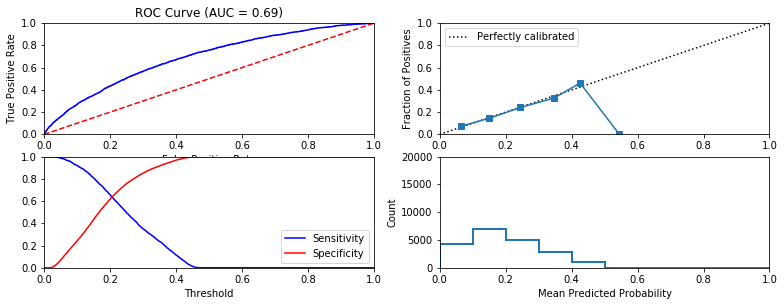


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



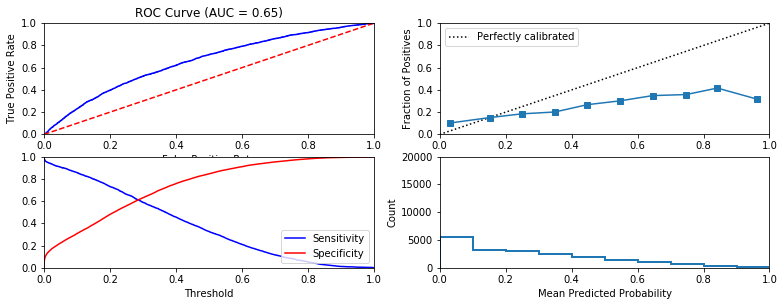


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



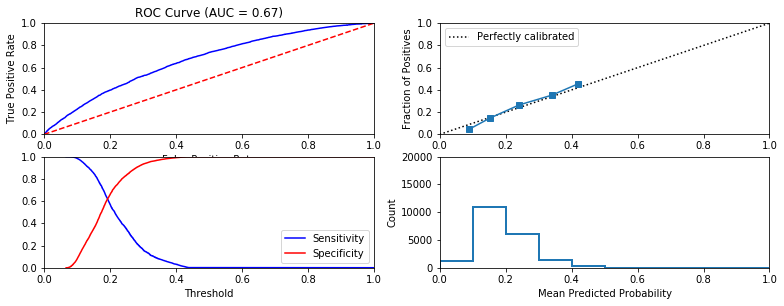


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



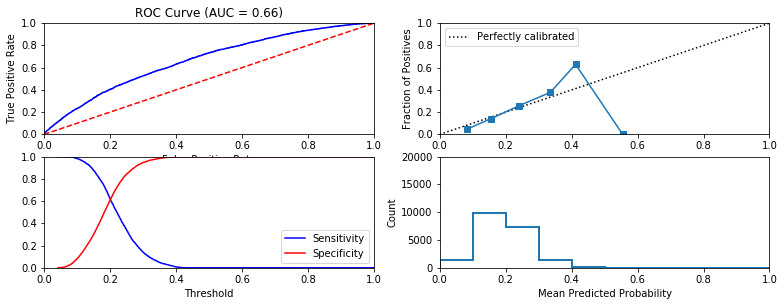


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



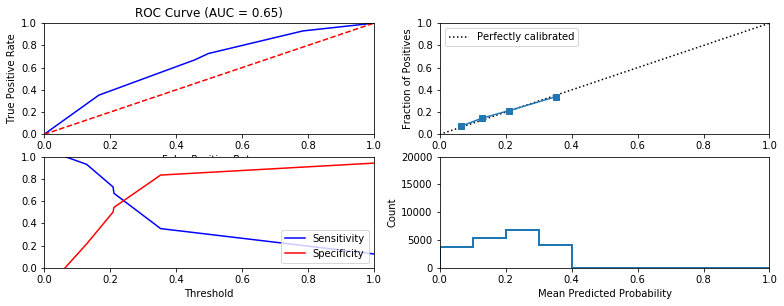


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.78 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



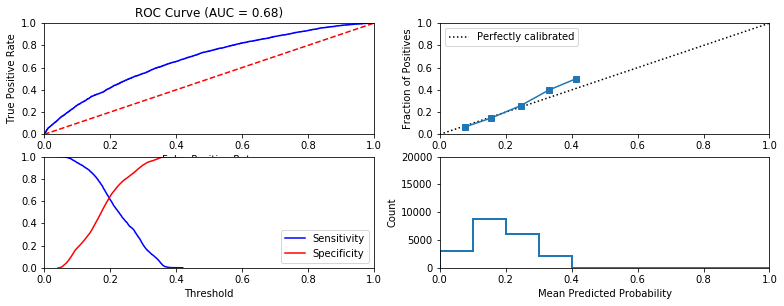


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.57 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



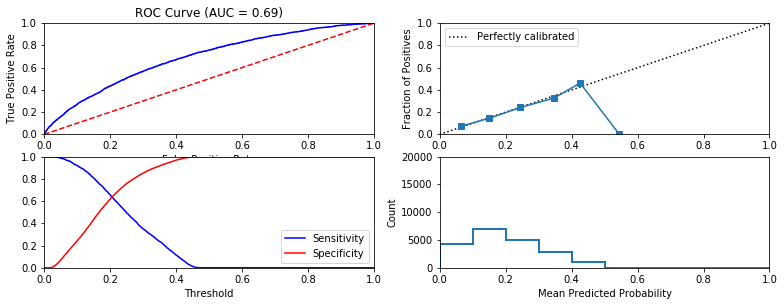


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



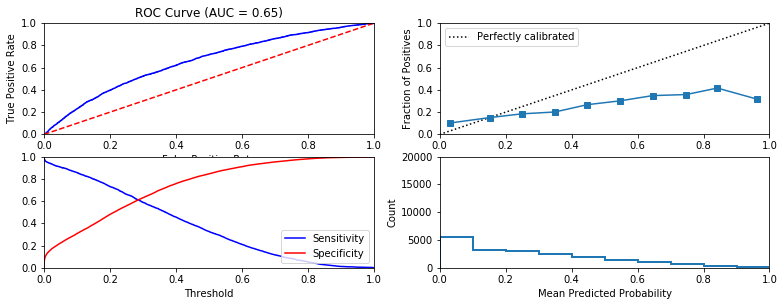


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.32 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



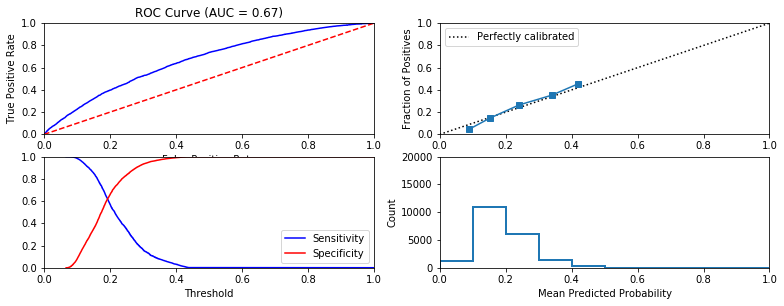


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



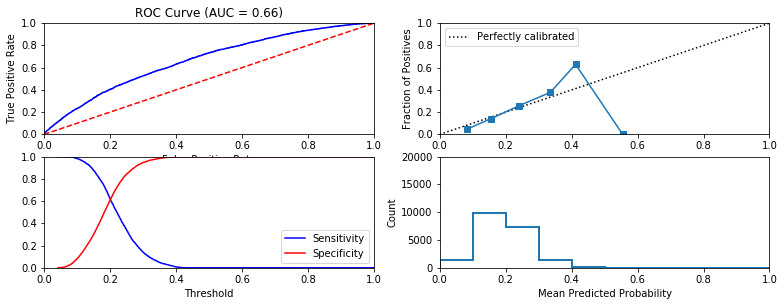


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



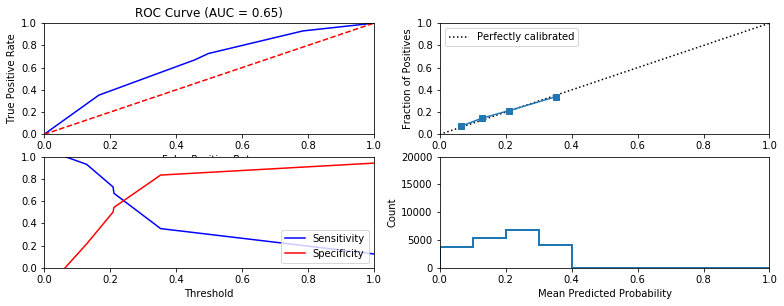


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.75 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



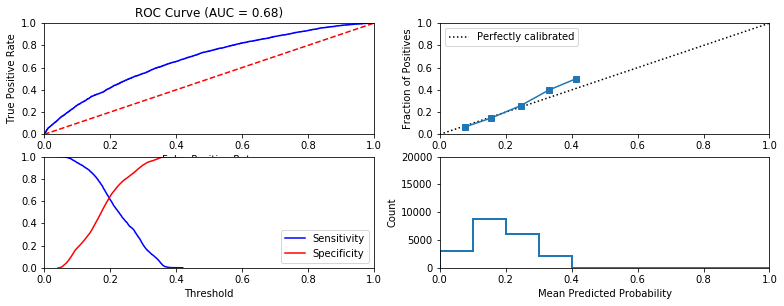


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.66 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



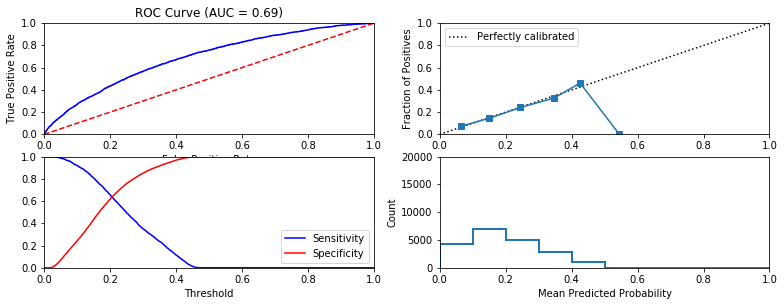


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



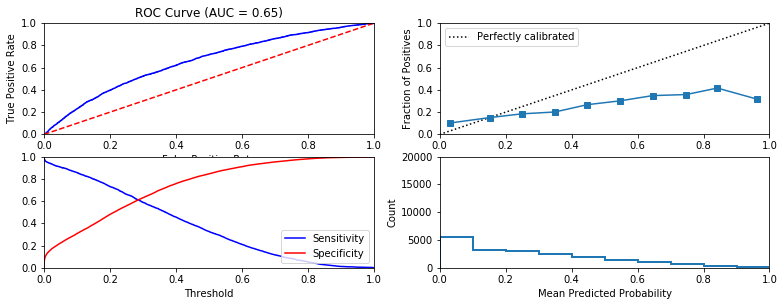


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



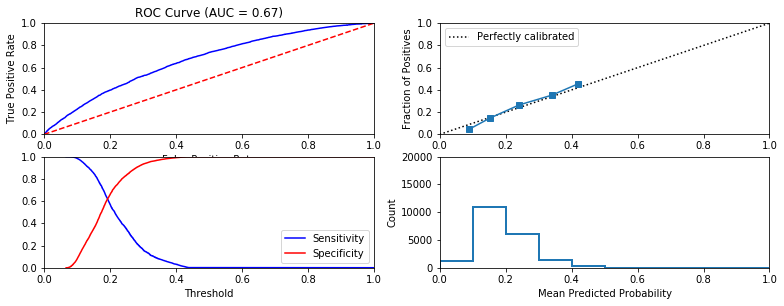


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



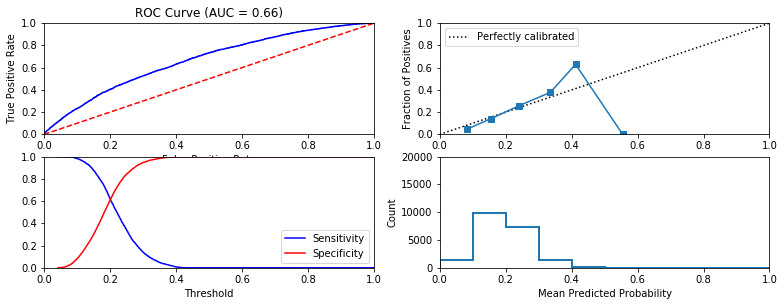


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



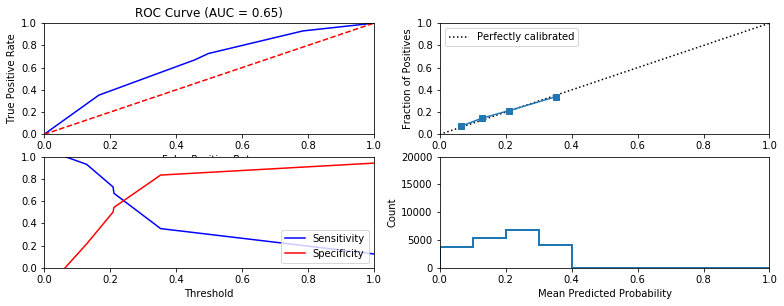


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



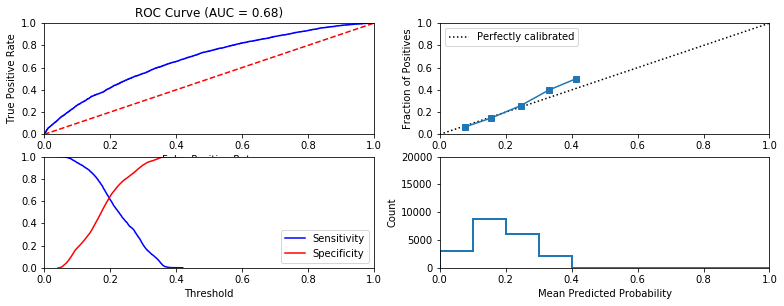


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.77 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



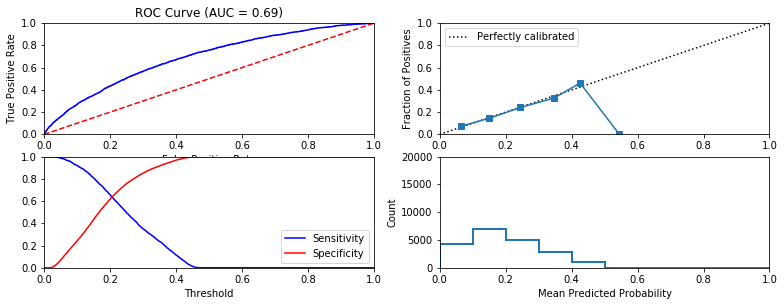


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



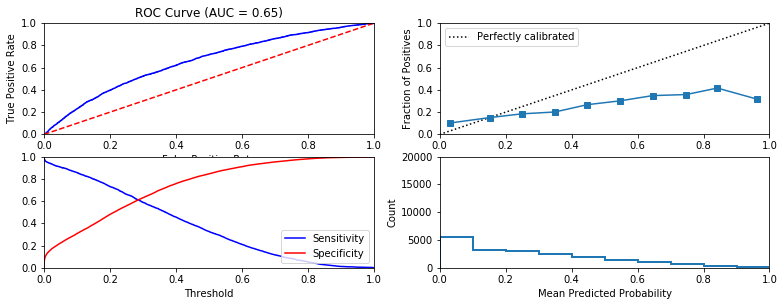


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



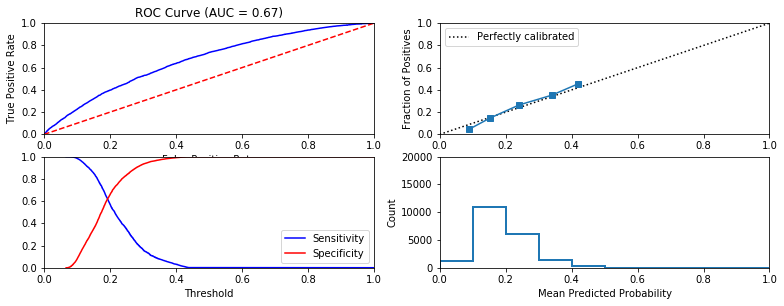


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



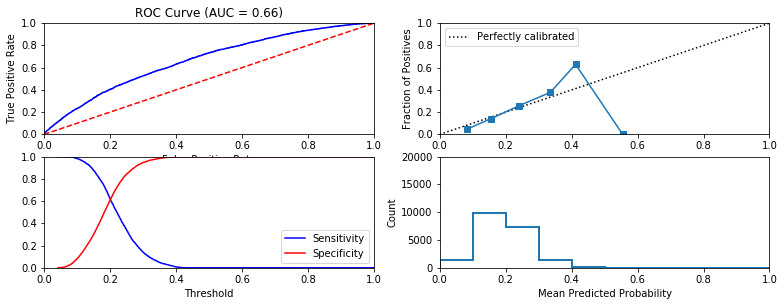


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



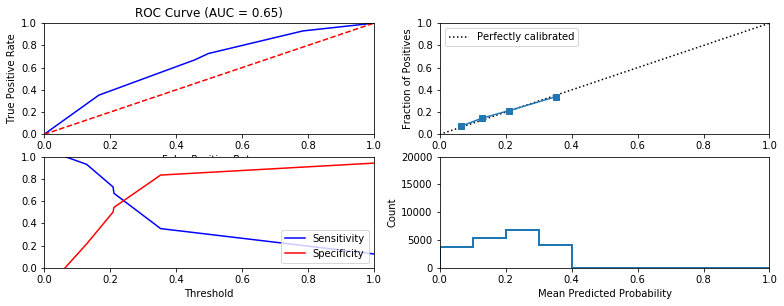


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.71 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



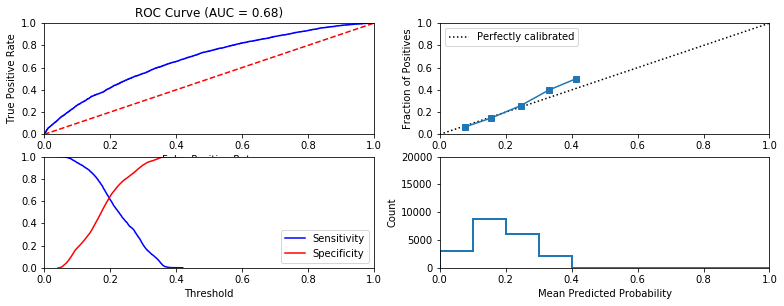


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



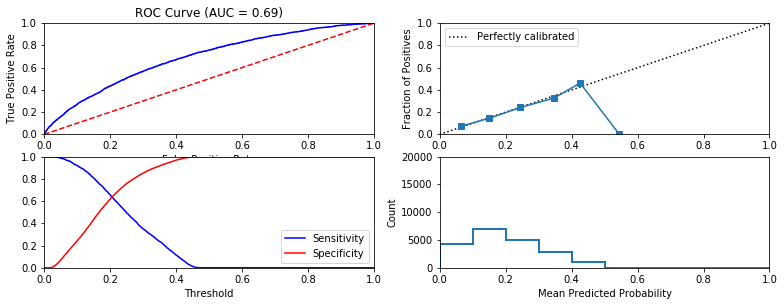


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



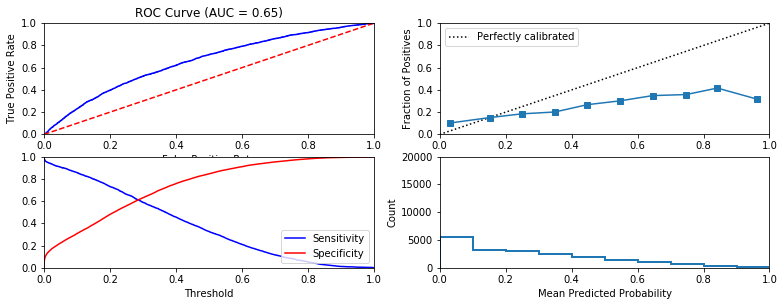


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.3 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



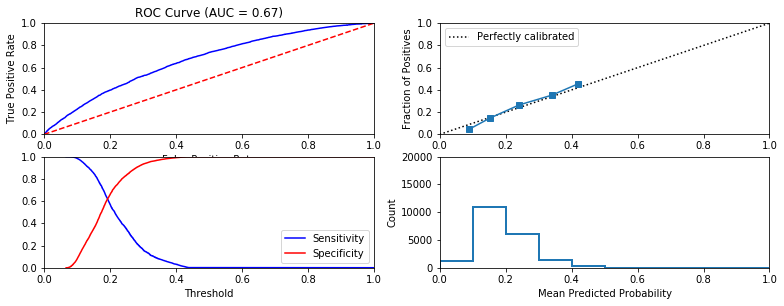


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



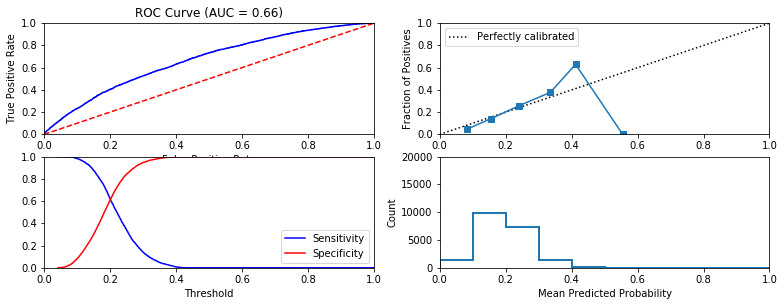


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



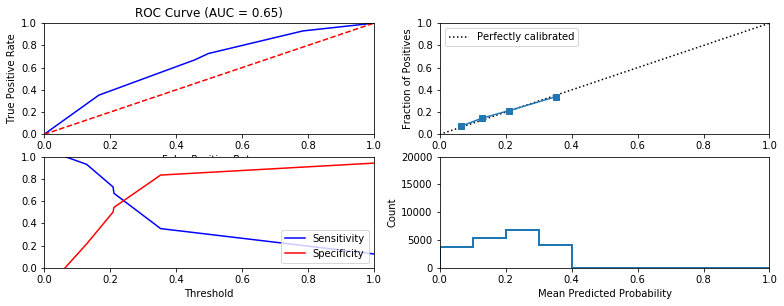


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.78 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



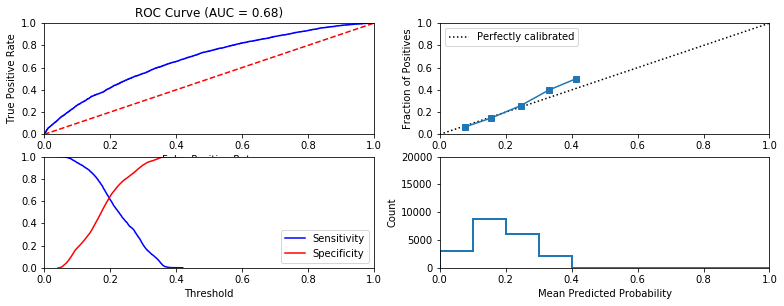


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



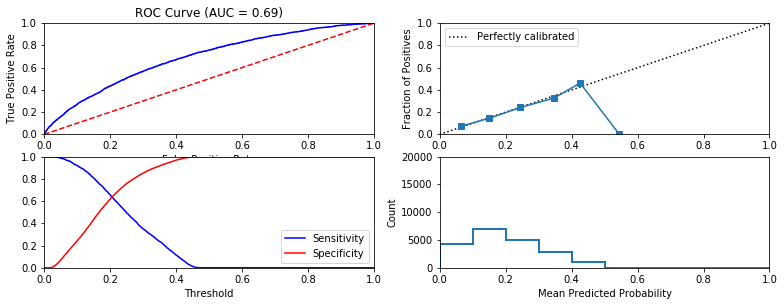


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



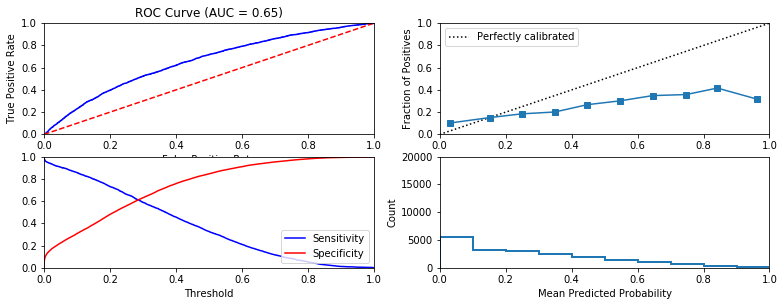


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



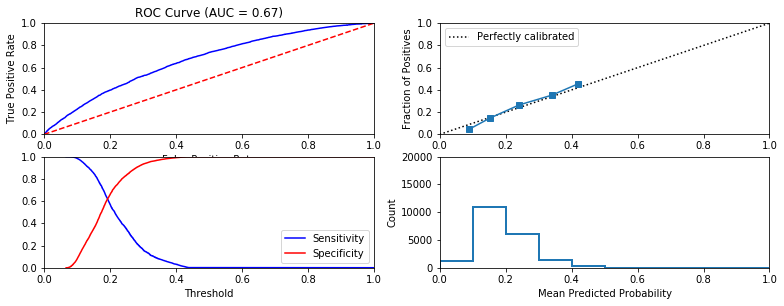


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



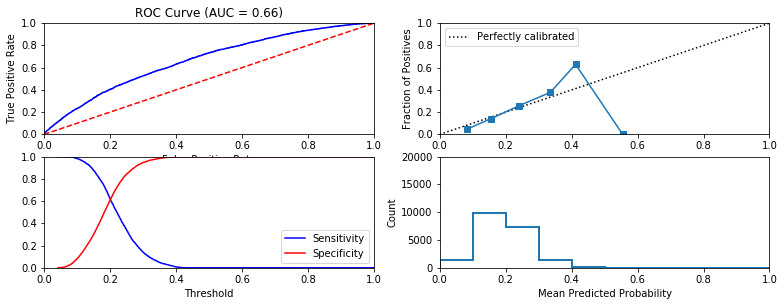


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



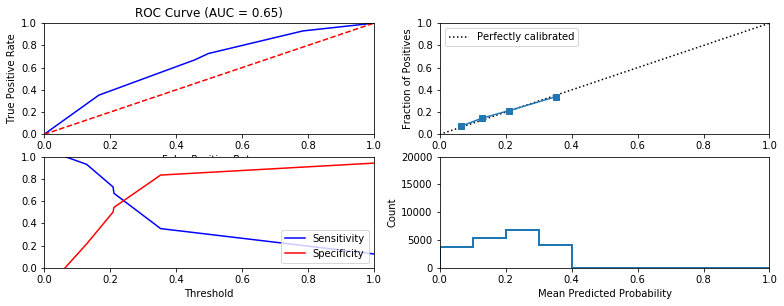


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.77 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



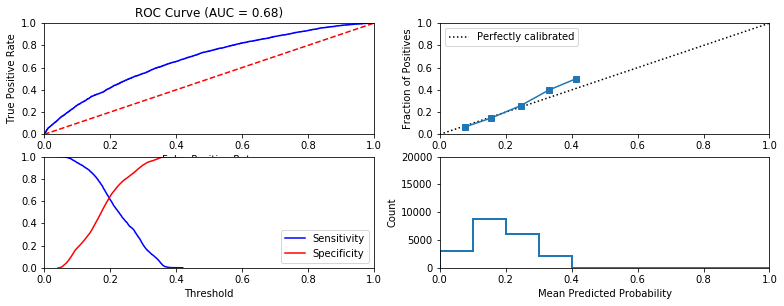


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.58 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



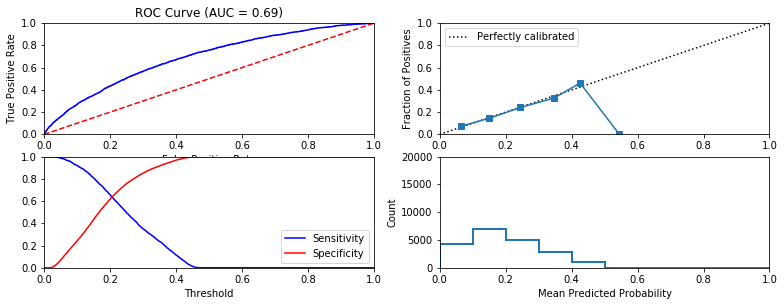


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



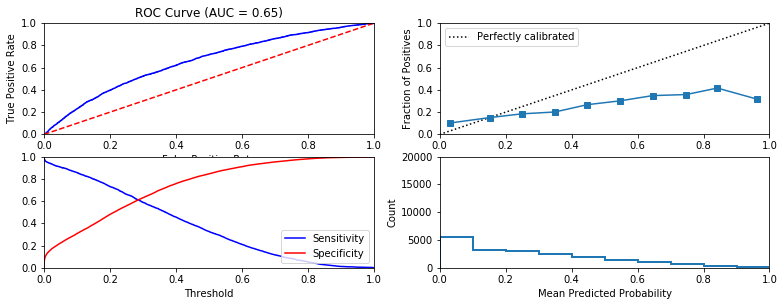


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



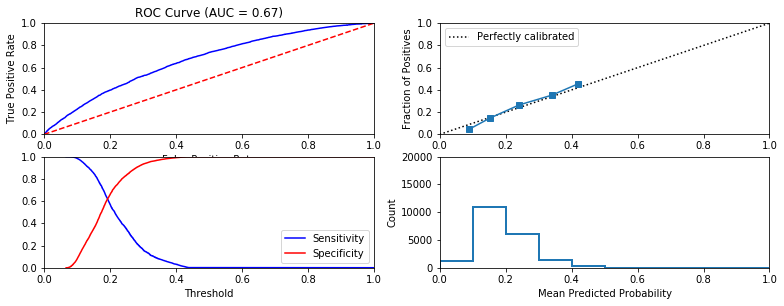


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.24 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



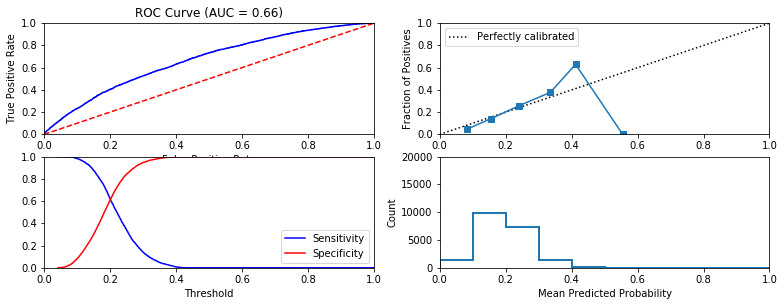


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.24 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



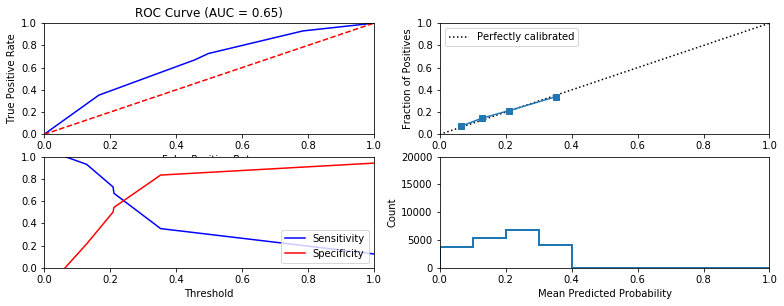


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



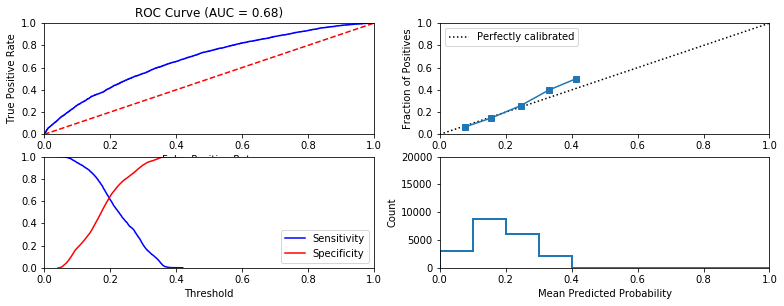


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.38 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



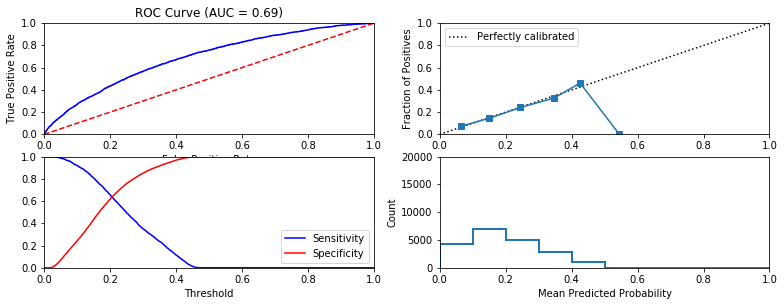


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



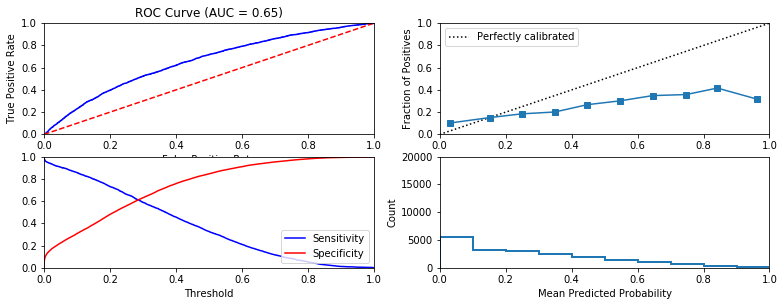


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



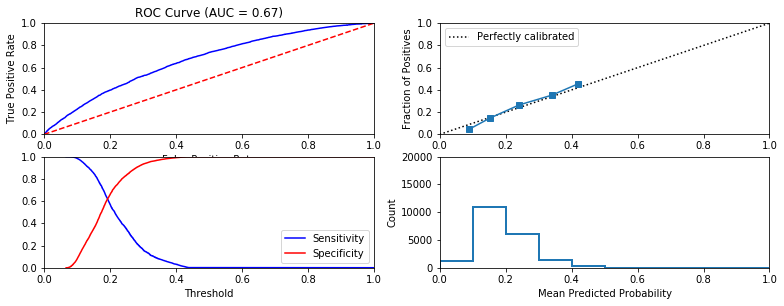


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



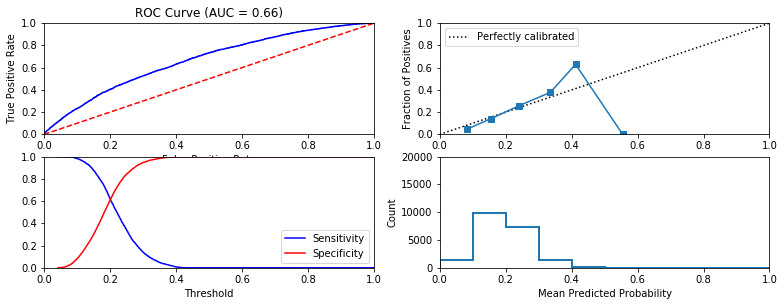


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



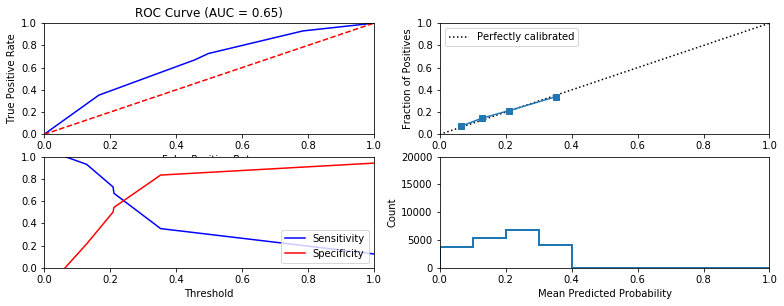


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



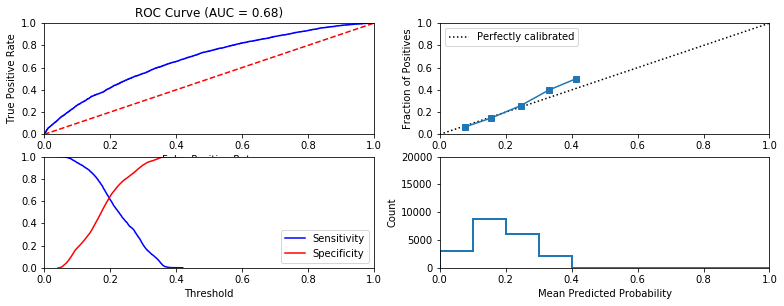


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.04 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



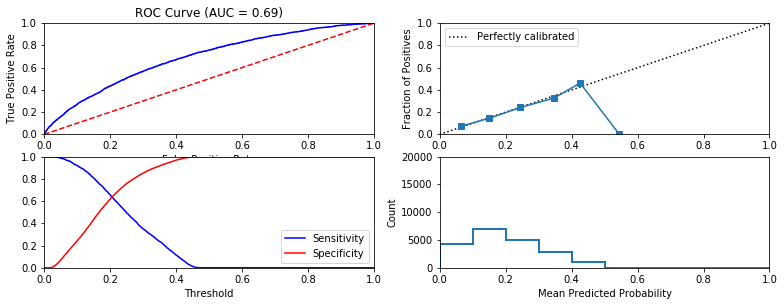


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



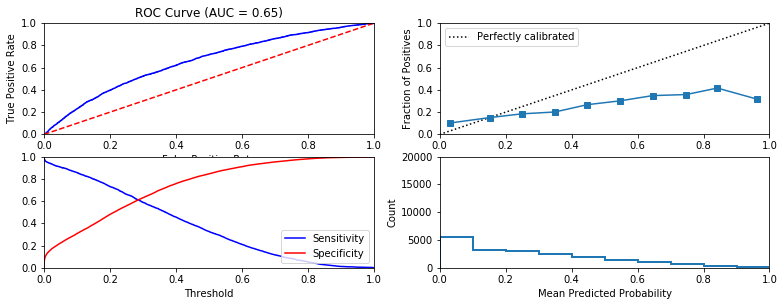


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



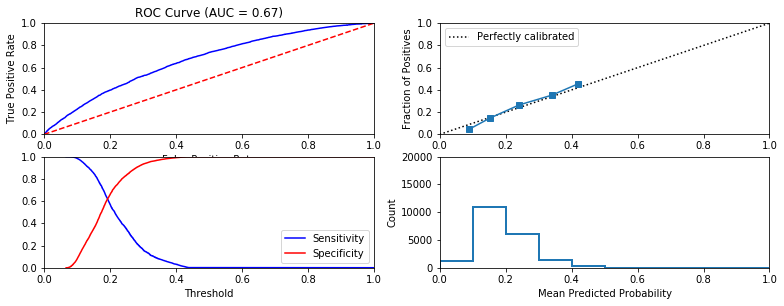


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



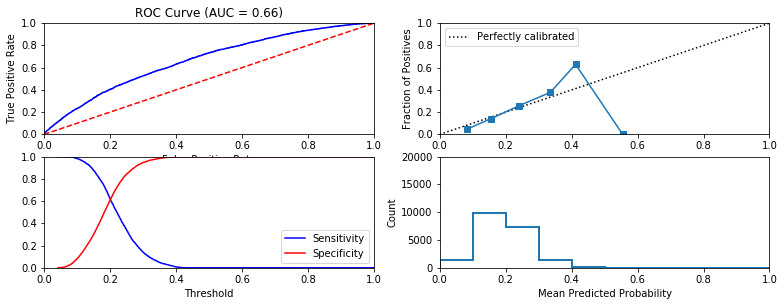


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



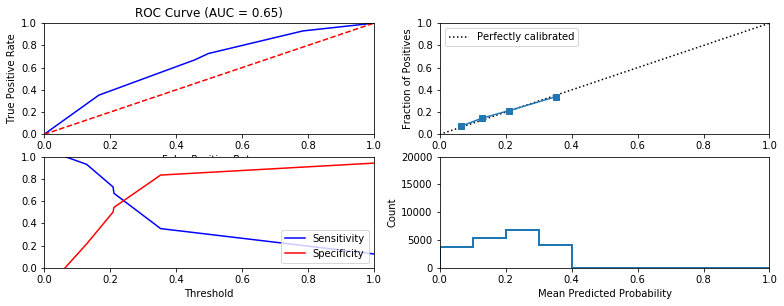


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.77 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



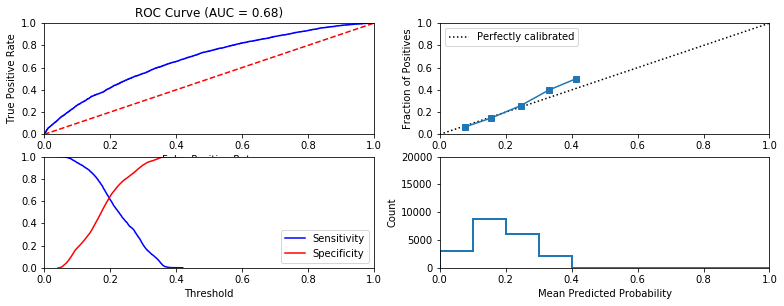


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.87 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



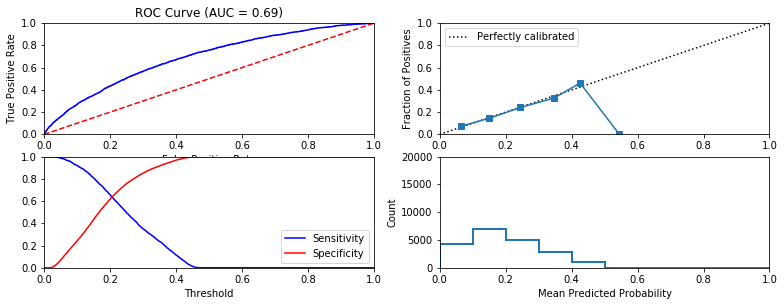


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



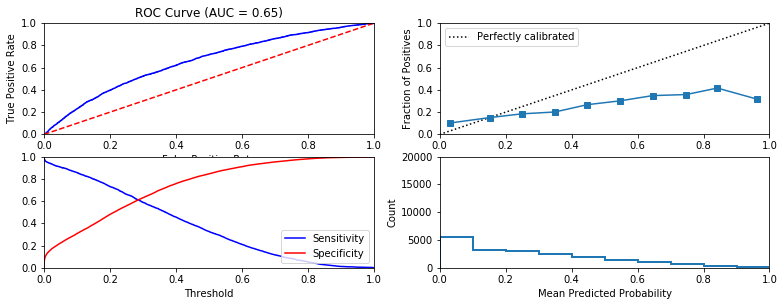


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



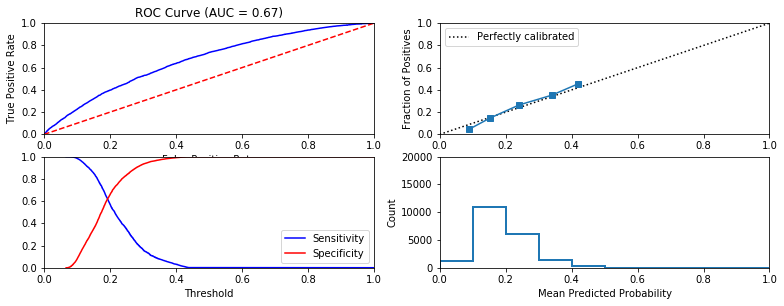


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



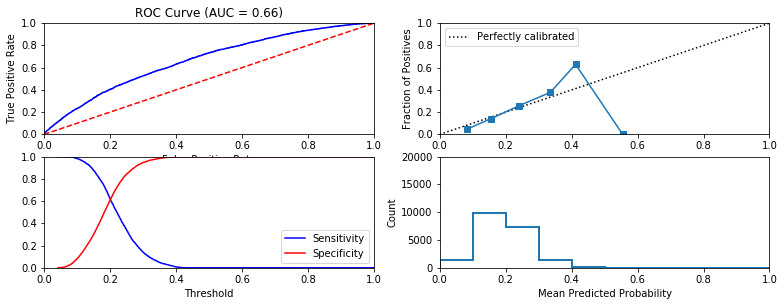


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



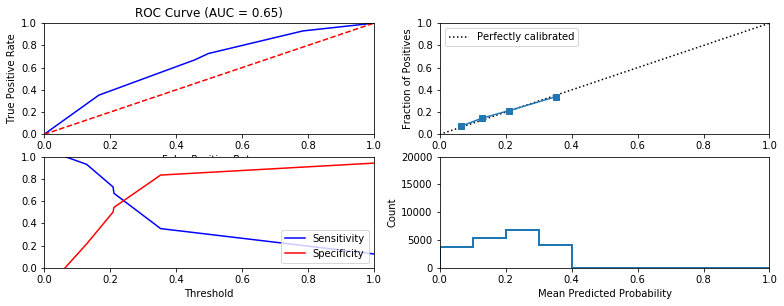


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.7 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



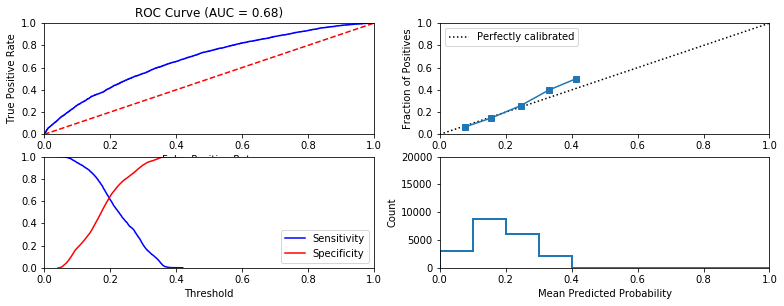


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.64 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



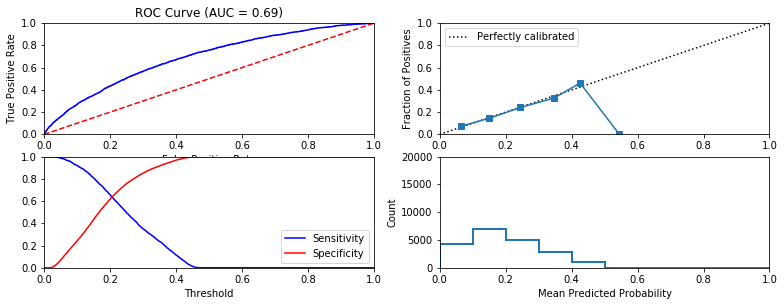


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



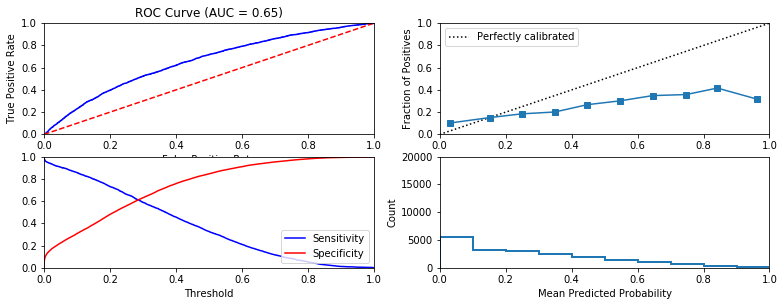


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



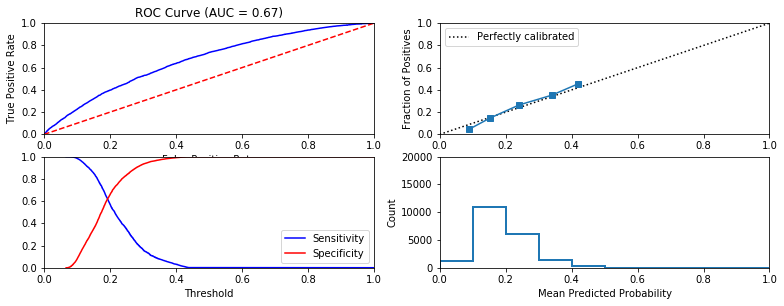


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



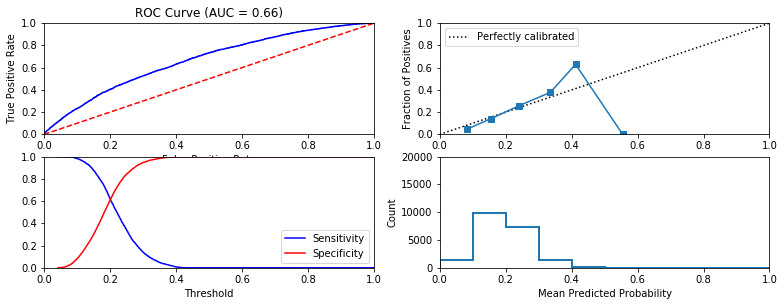


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



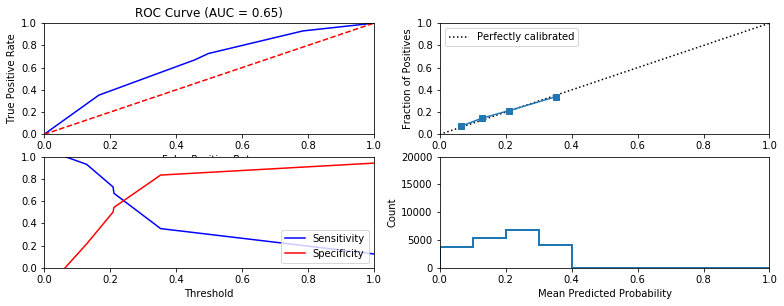


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



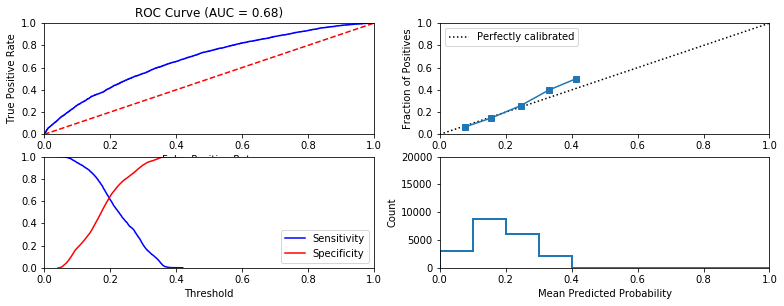


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.81 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



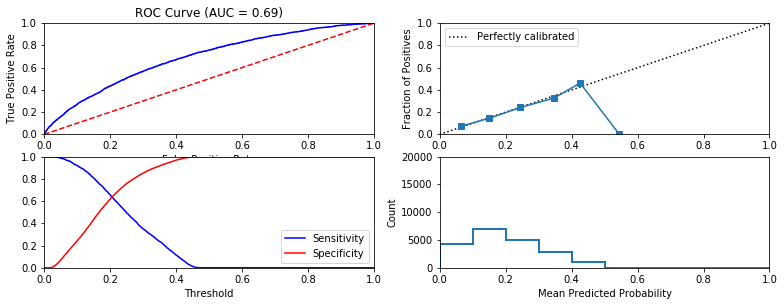


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



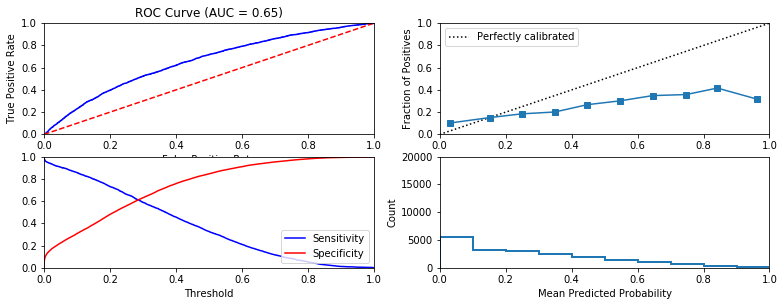


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



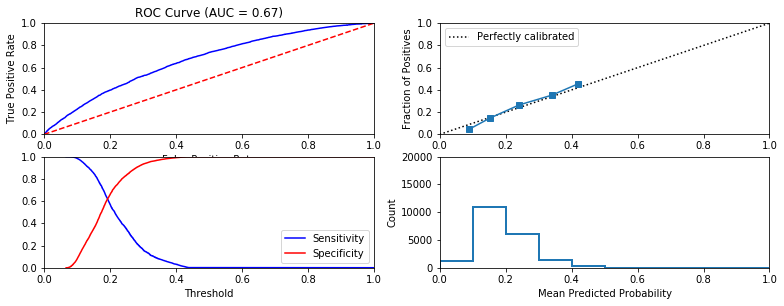


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



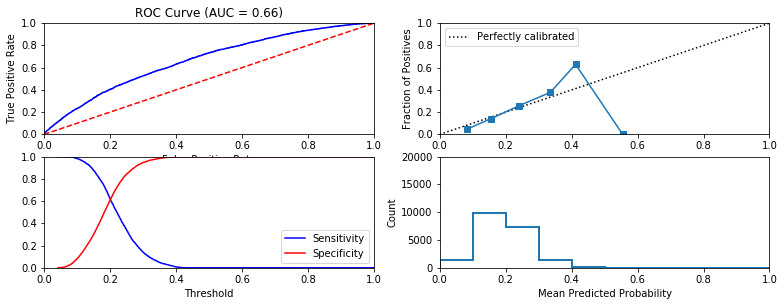


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



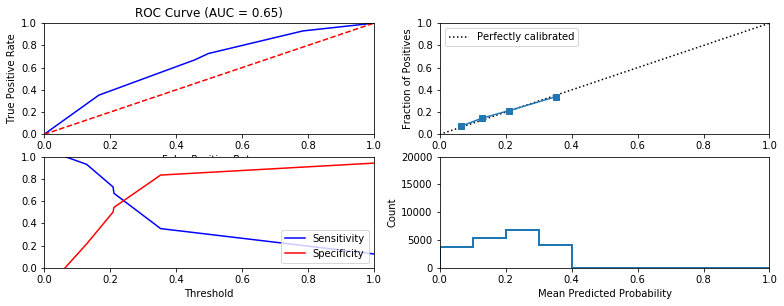


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.88 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



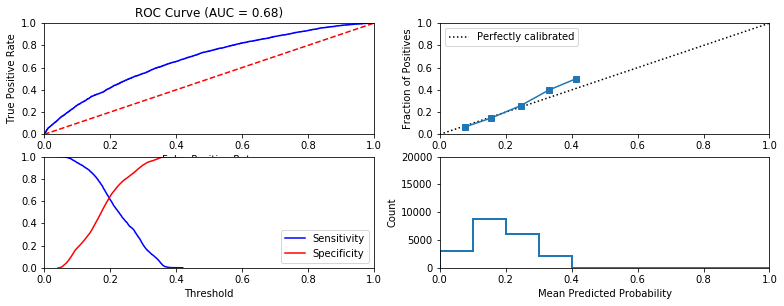


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.6 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



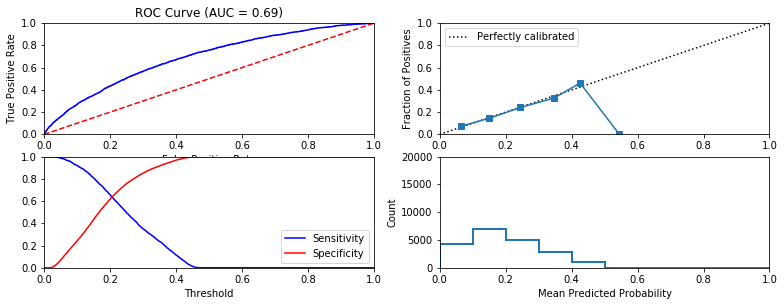


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



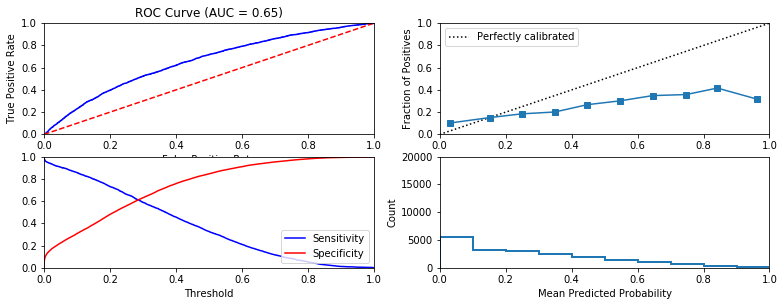


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



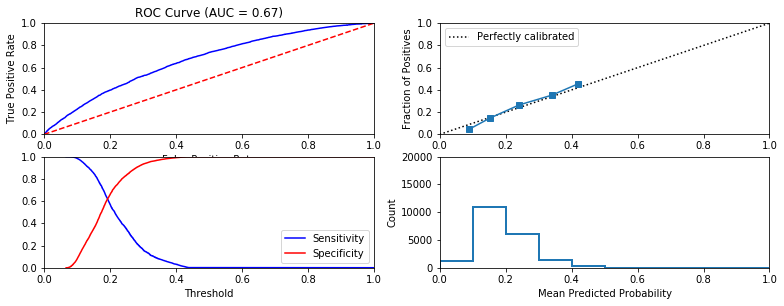


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



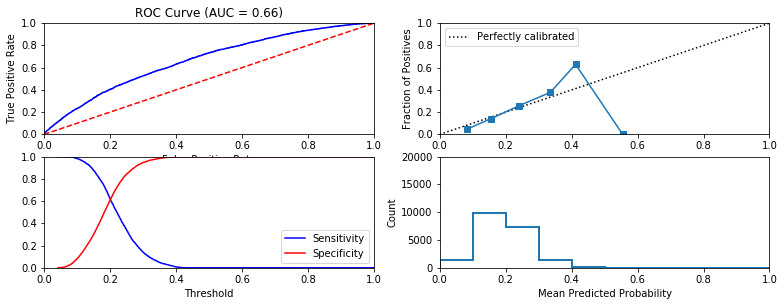


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



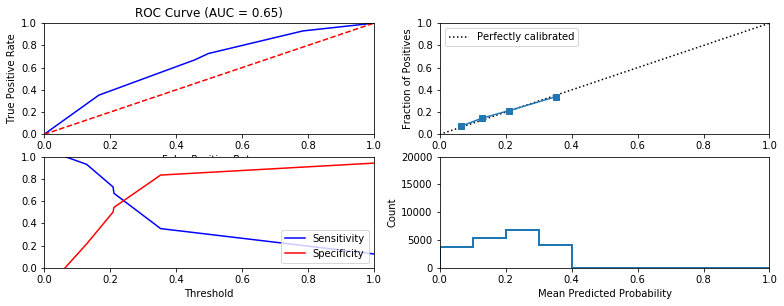


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



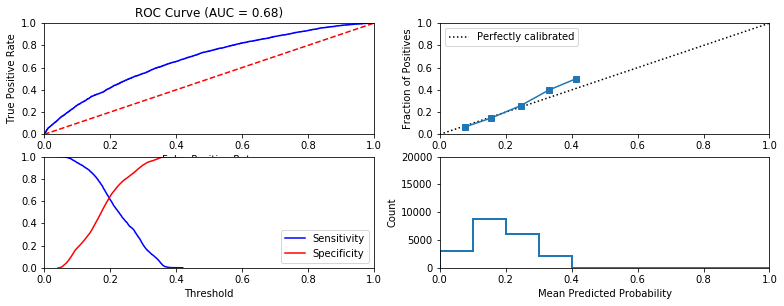


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.62 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



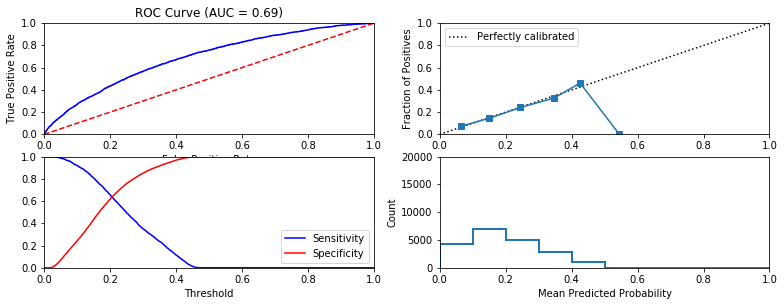


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



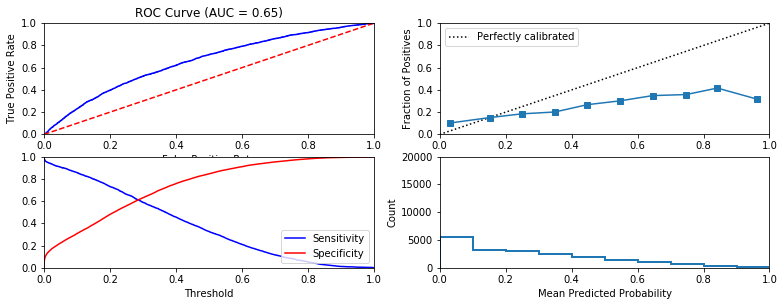


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



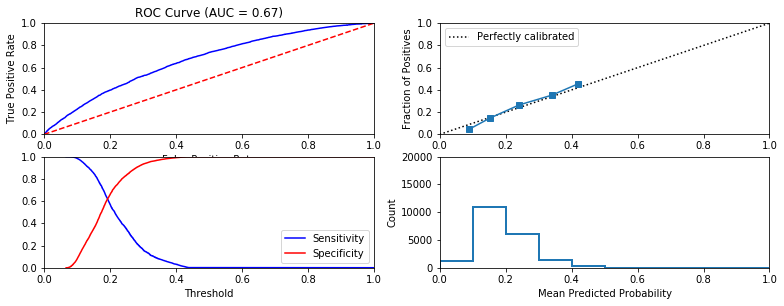


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



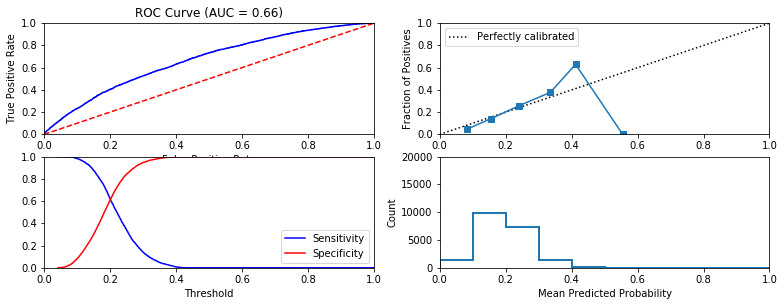


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



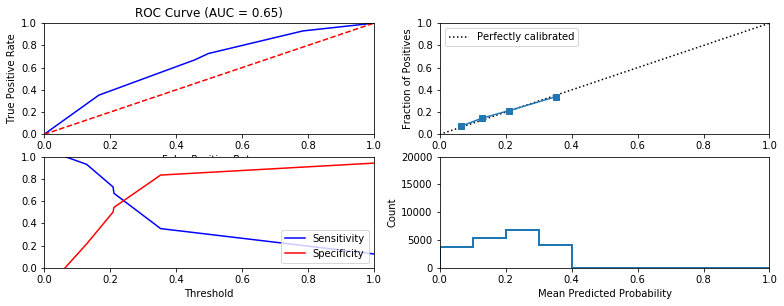


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



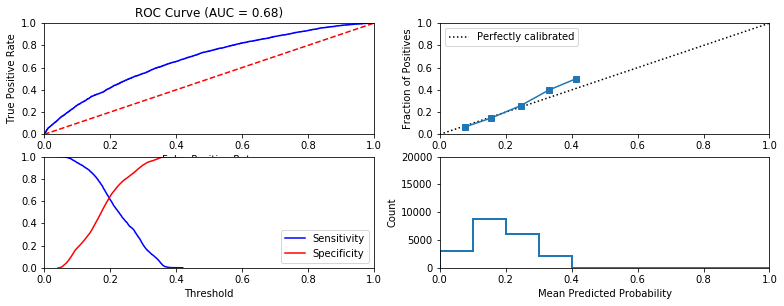


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.68 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



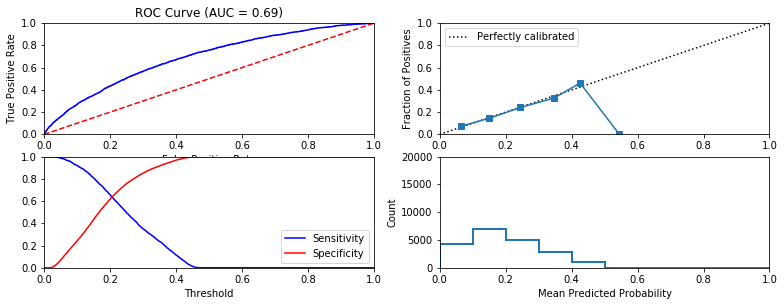


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



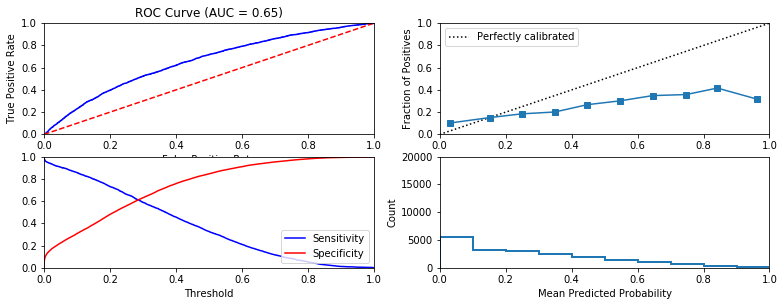


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



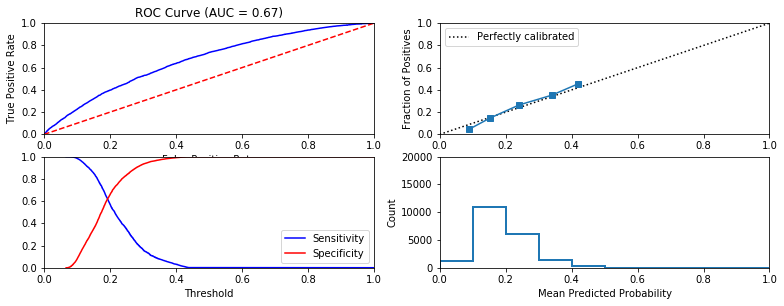


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



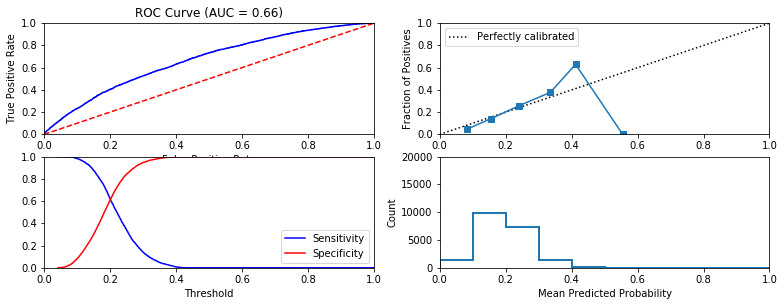


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



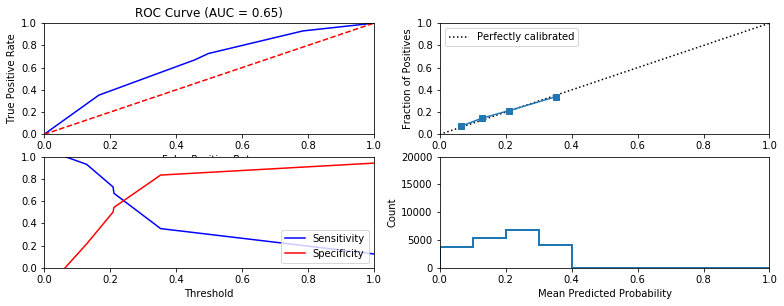


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



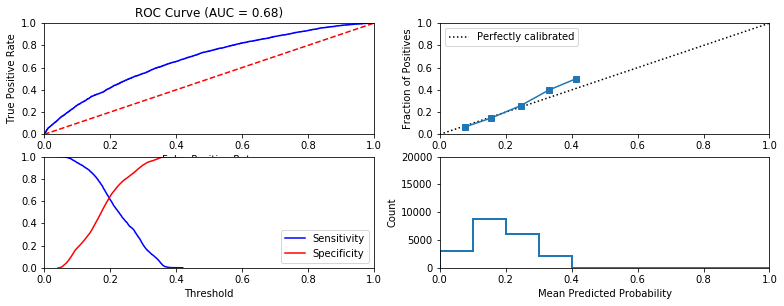


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.52 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



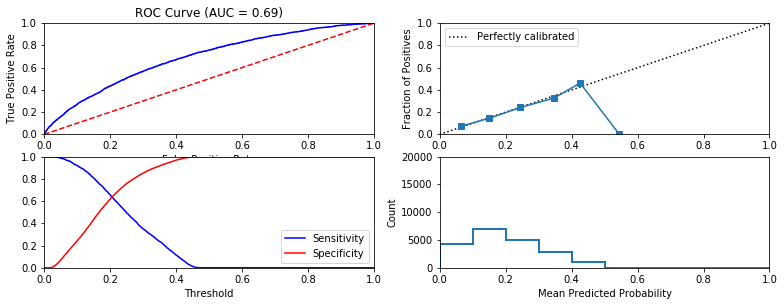


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



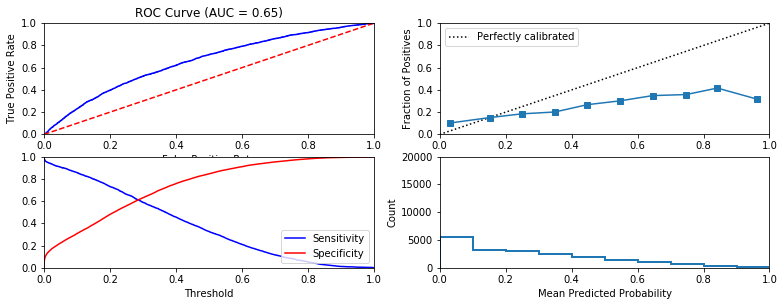


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



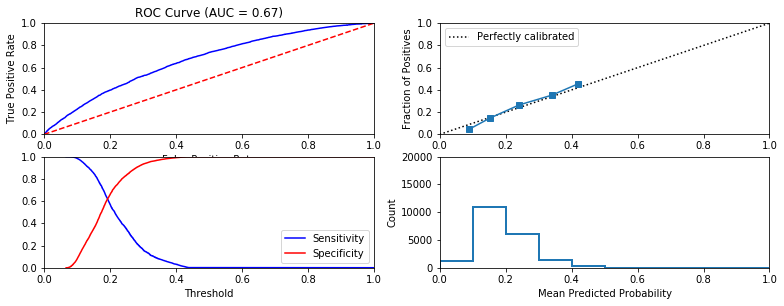


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



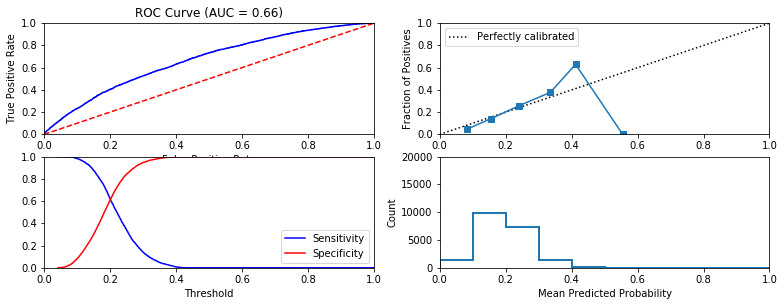


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



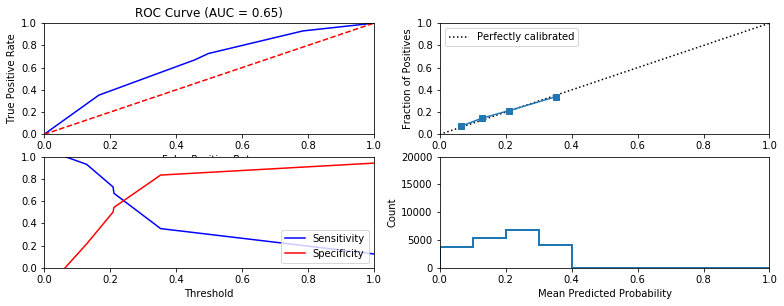


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.75 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



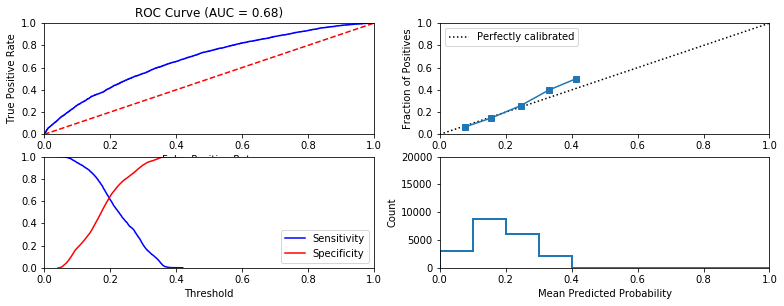


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.71 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



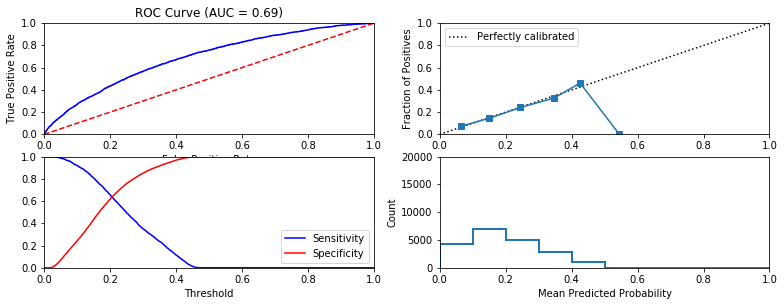


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



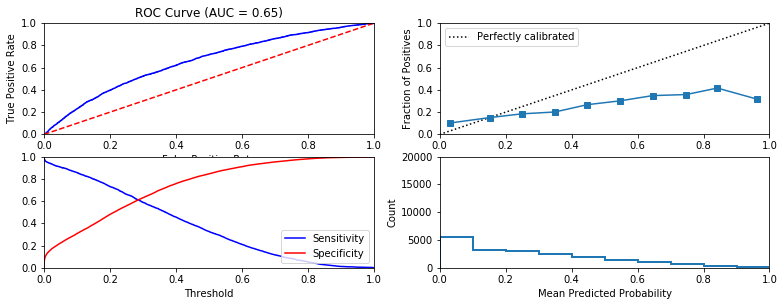


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



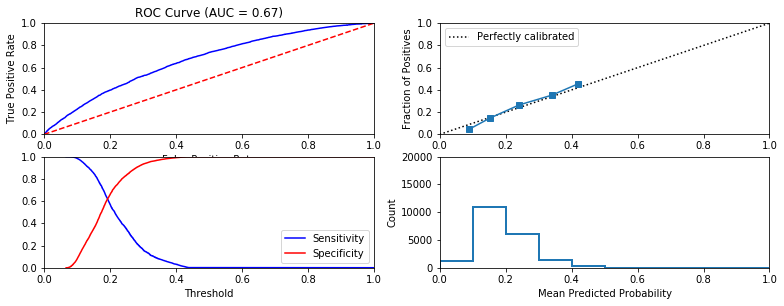


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



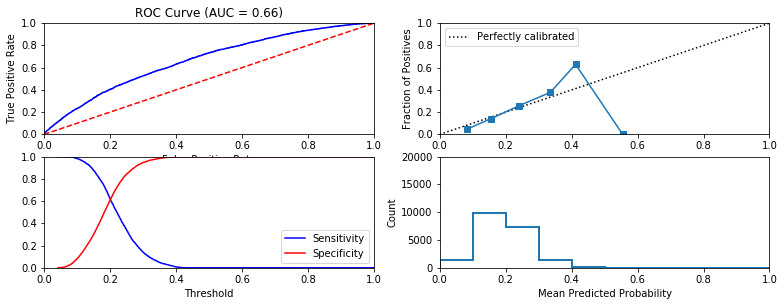


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



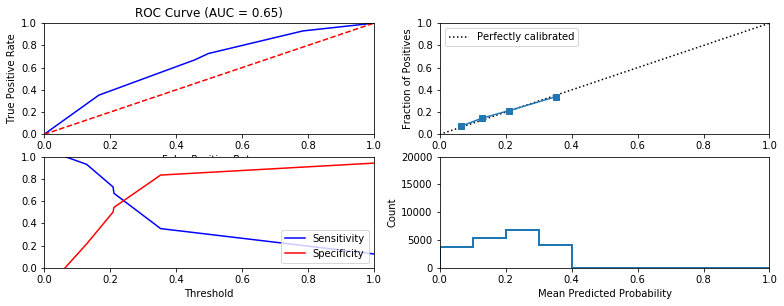


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.81 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



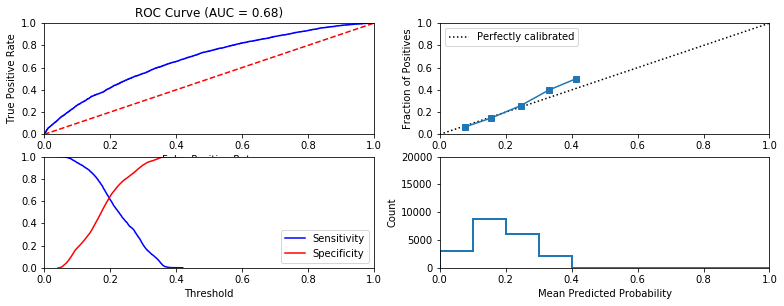


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.63 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



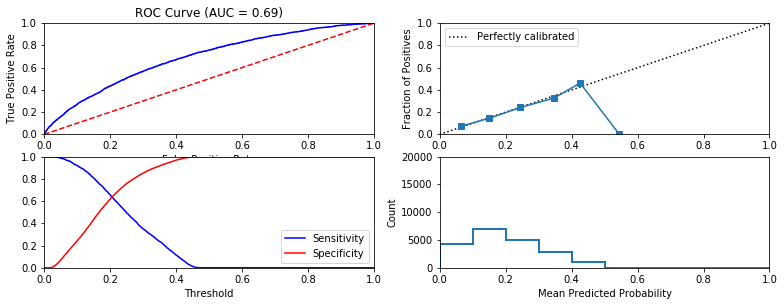


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



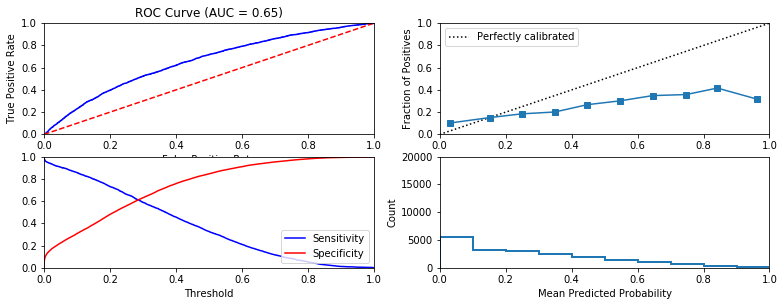


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



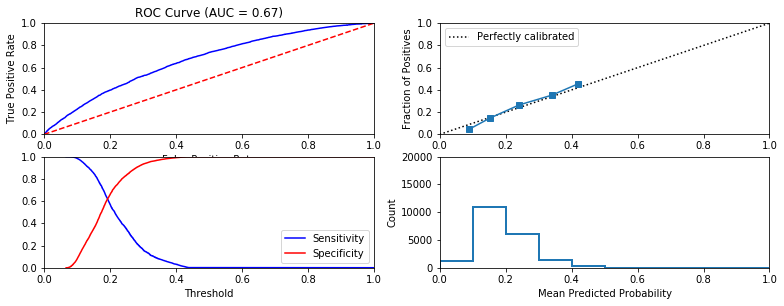


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.15 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



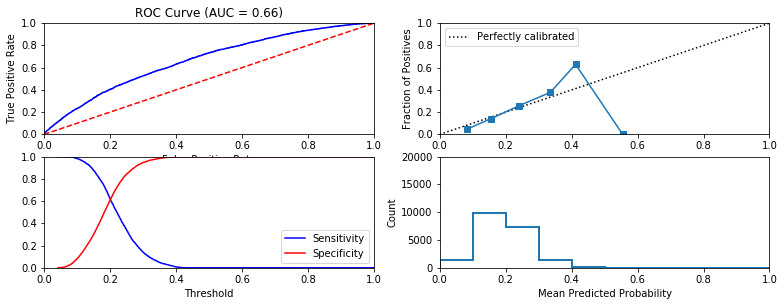


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



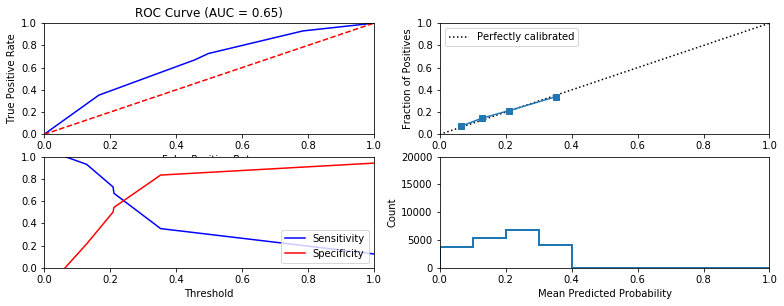


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



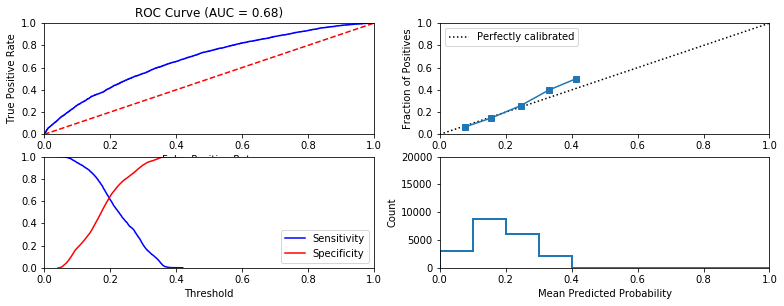


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.79 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



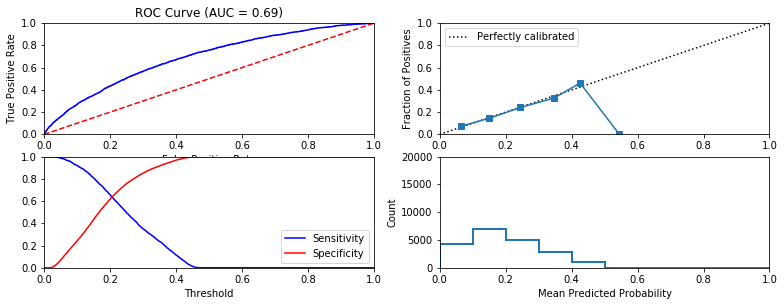


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



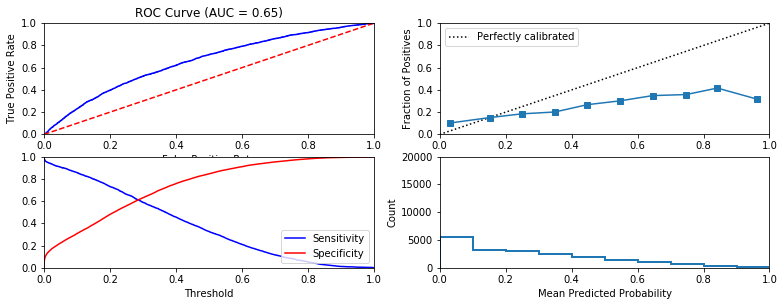


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



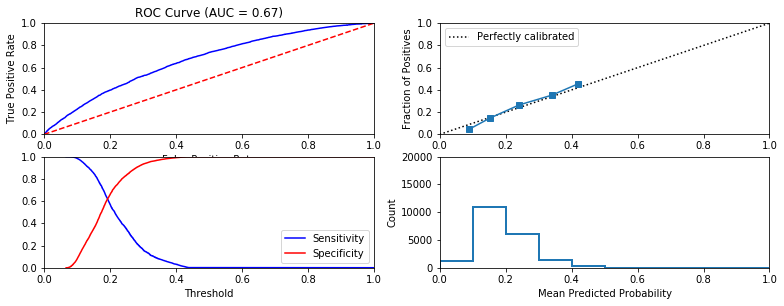


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



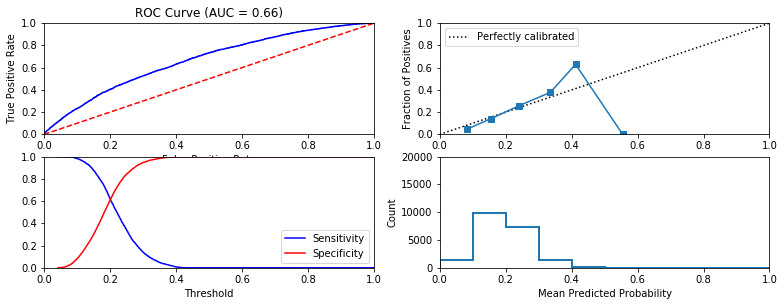


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



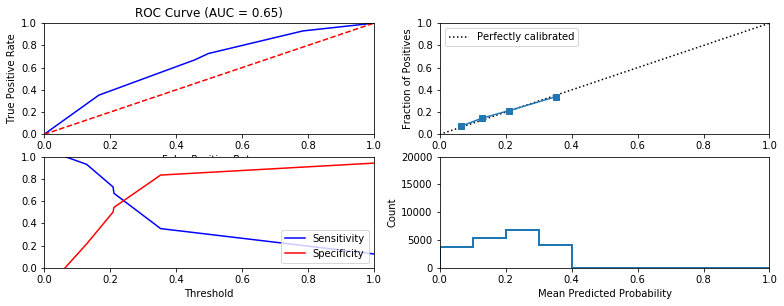


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.81 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



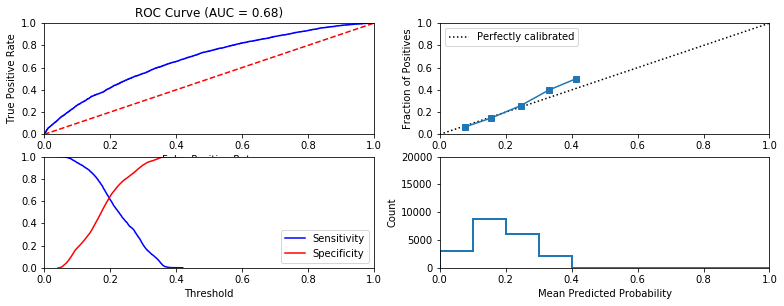


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.68 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



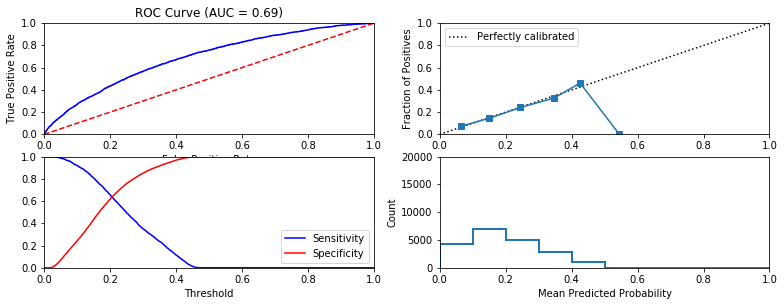


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



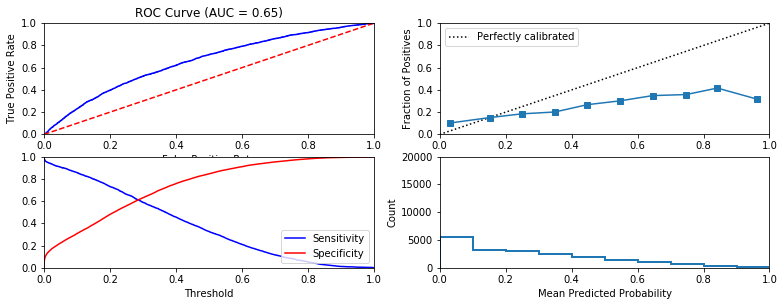


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



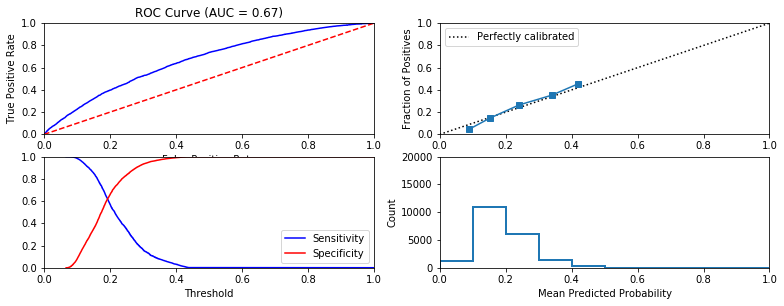


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



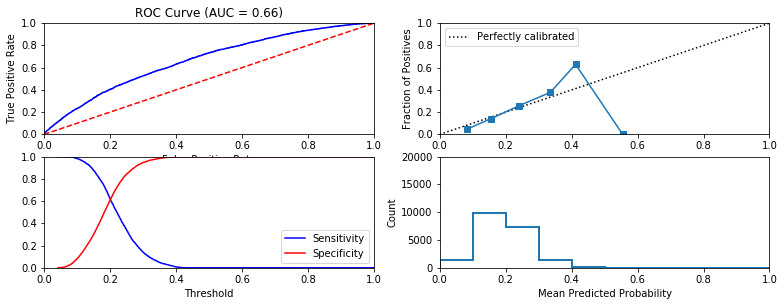


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



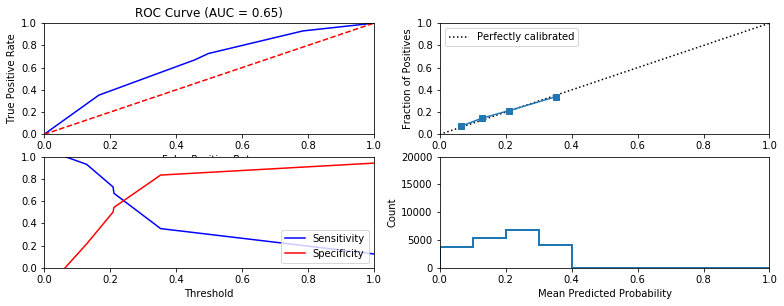


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



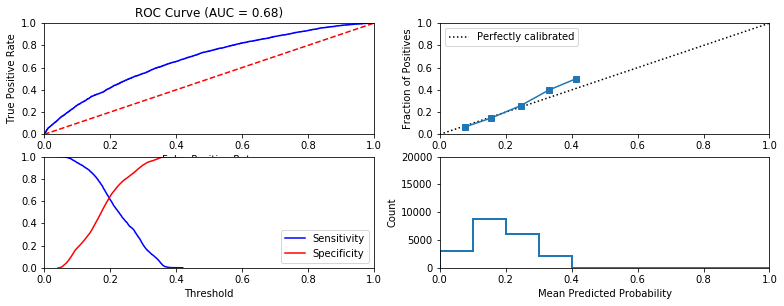


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.6 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



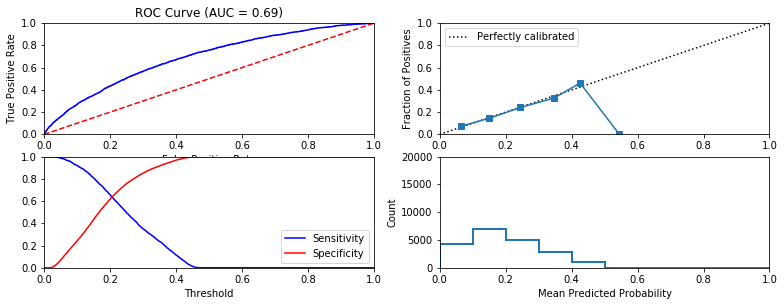


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



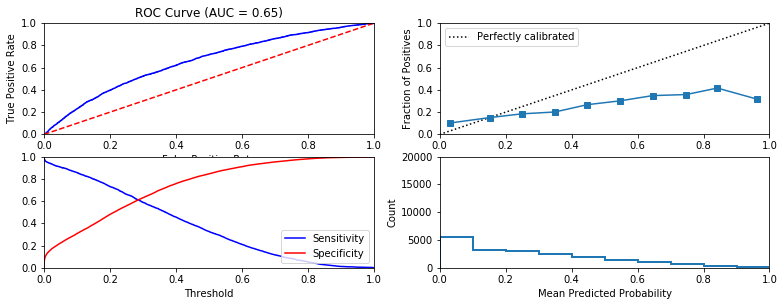


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.32 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



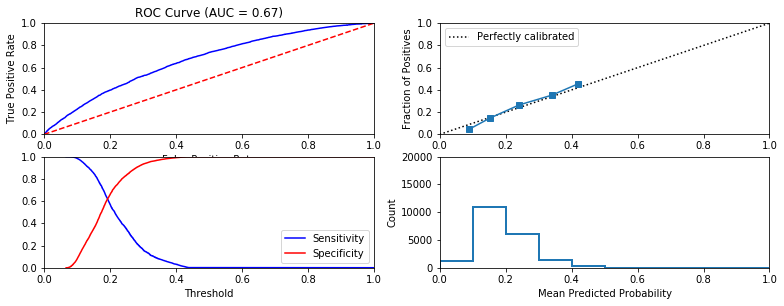


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



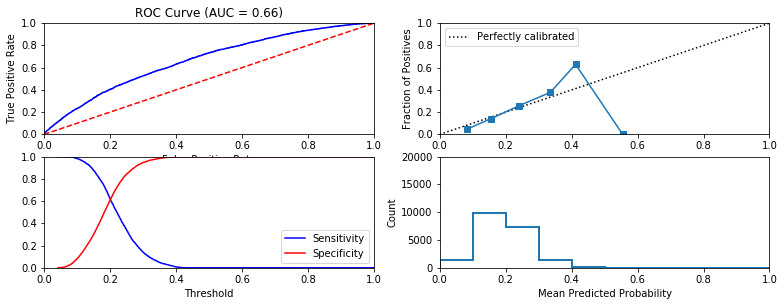


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



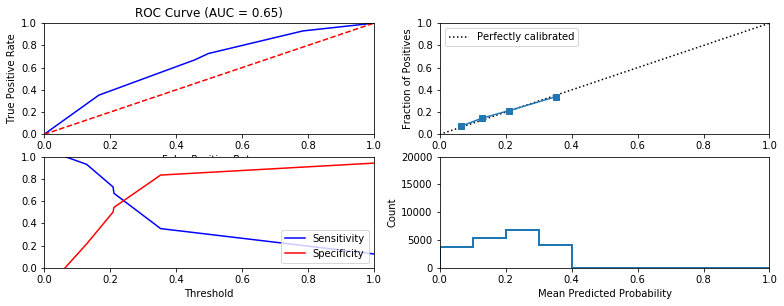


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



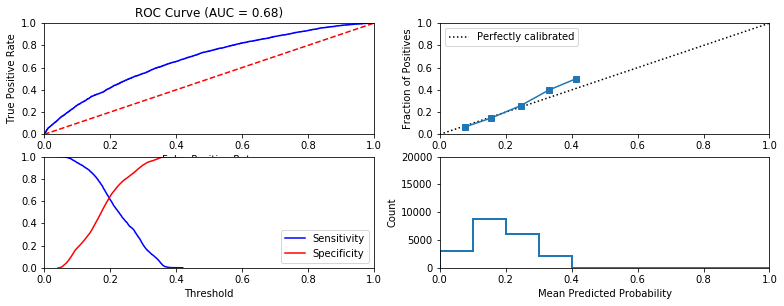


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



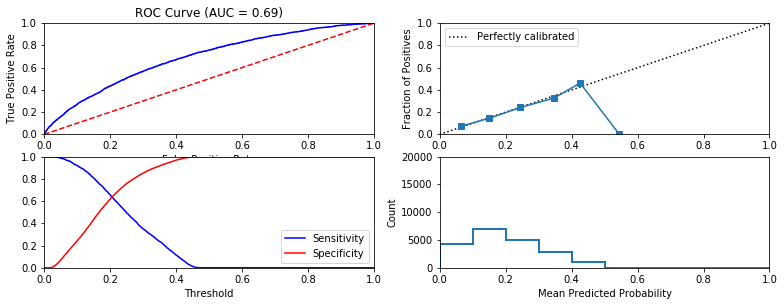


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



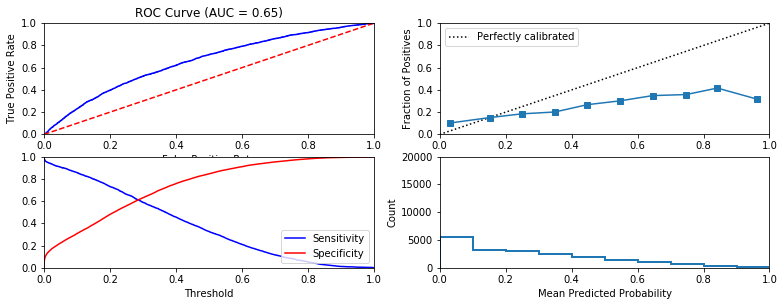


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



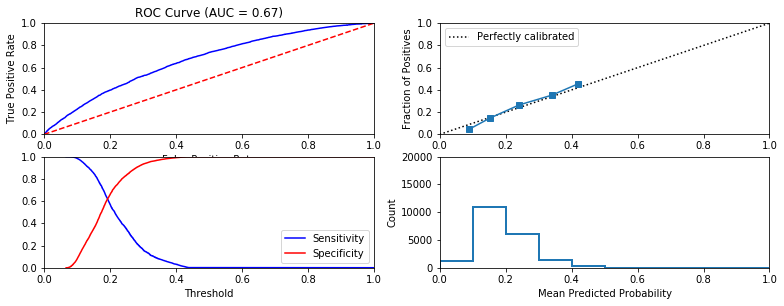


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



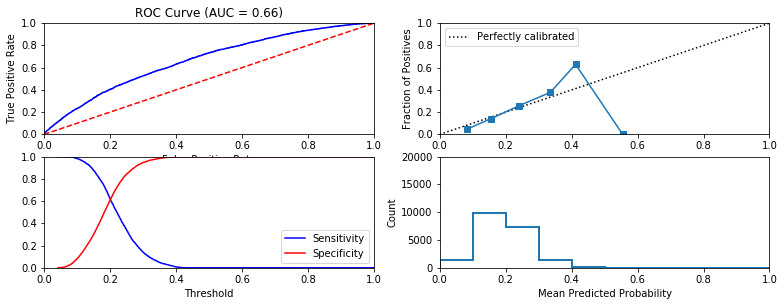


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



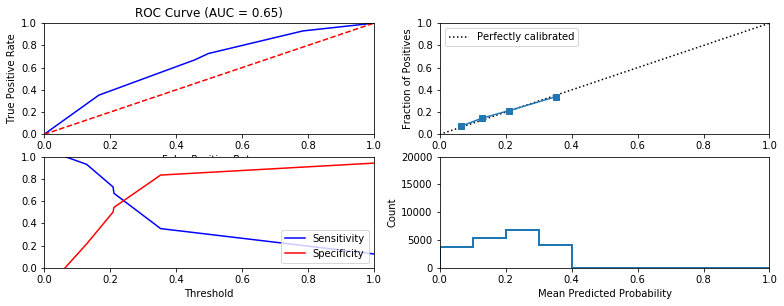


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.84 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



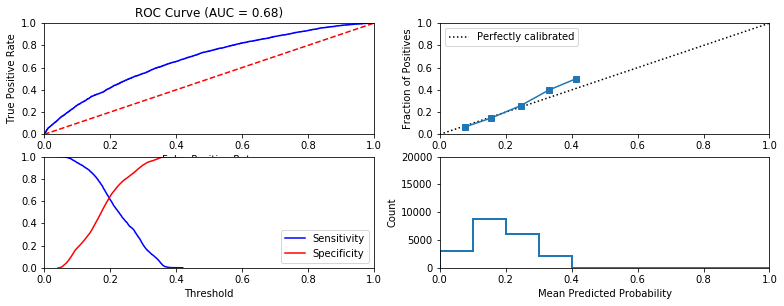


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.6 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



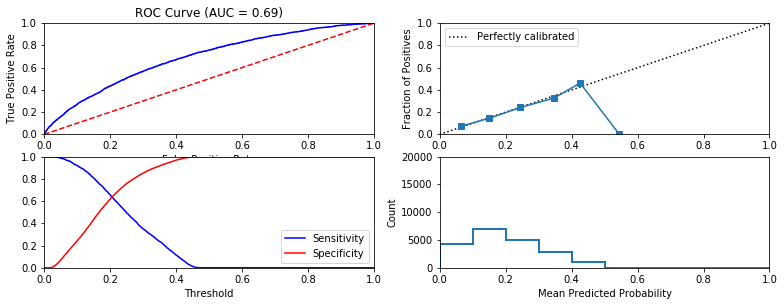


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



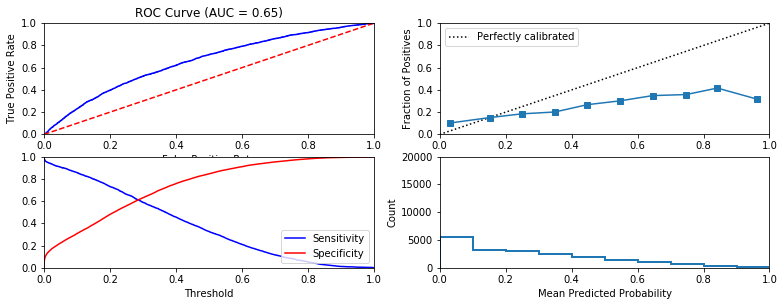


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.33 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



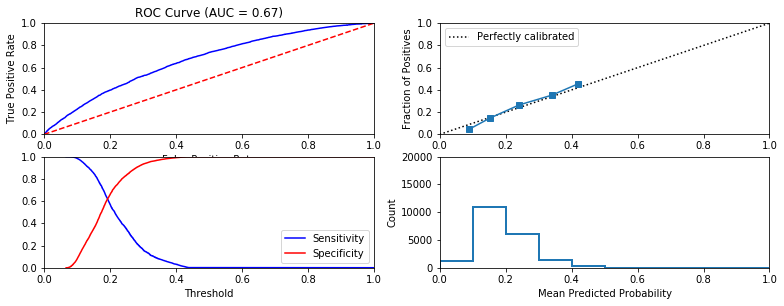


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



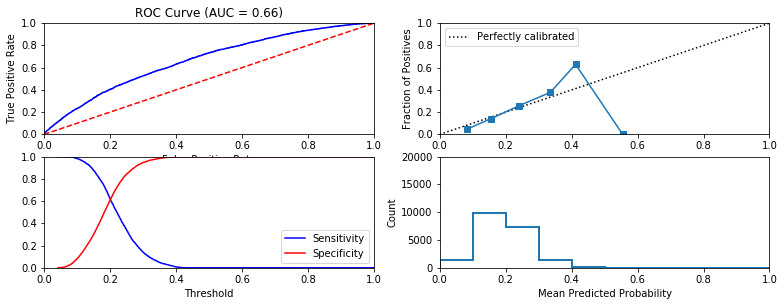


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



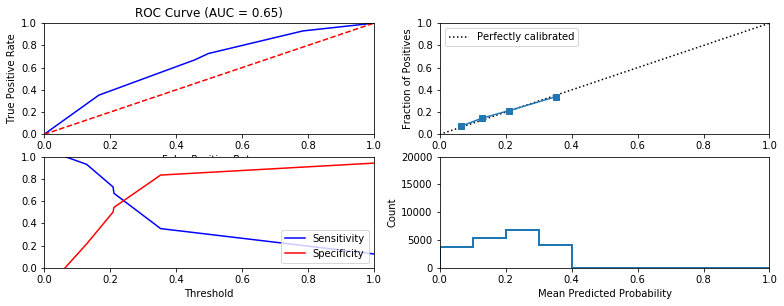


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



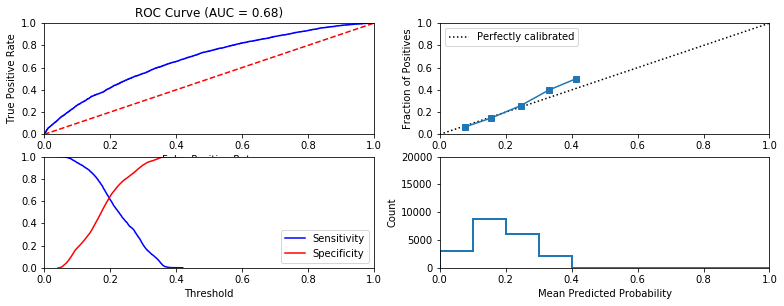


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.62 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



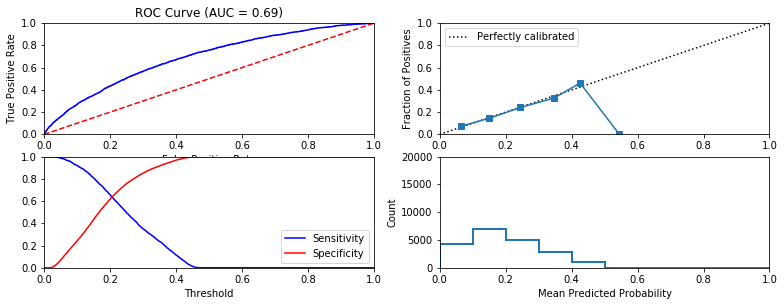


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



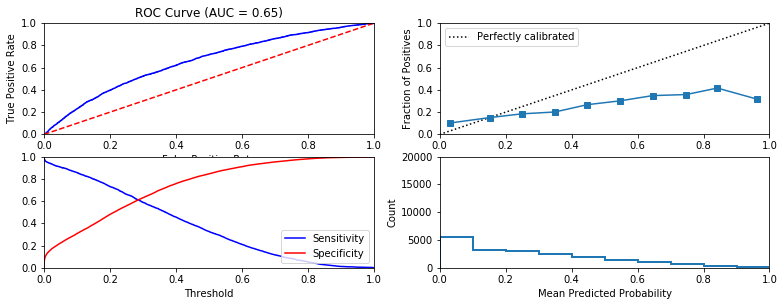


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



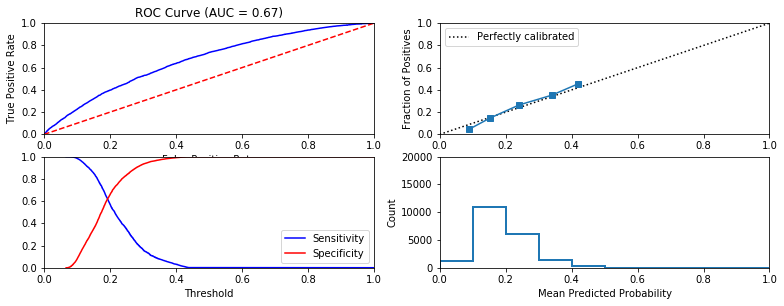


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



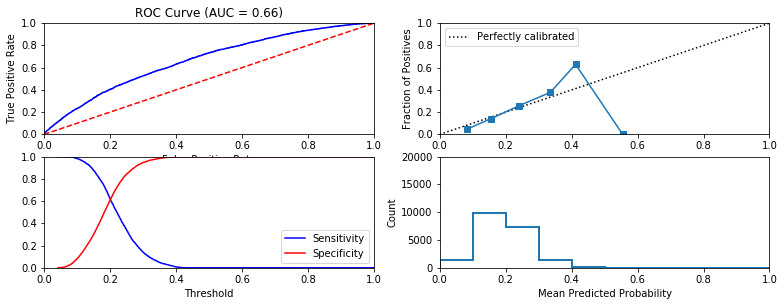


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



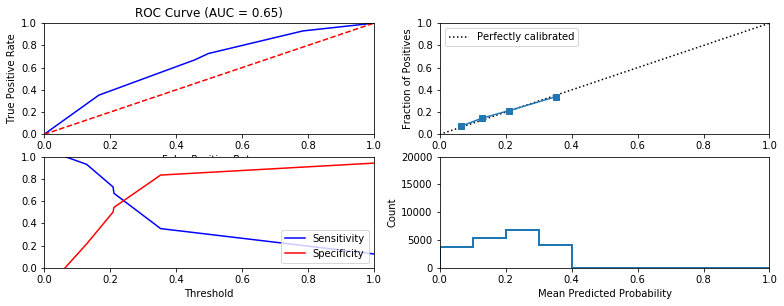


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



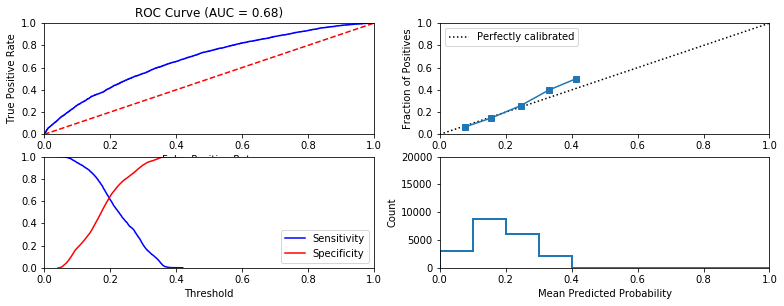


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.66 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



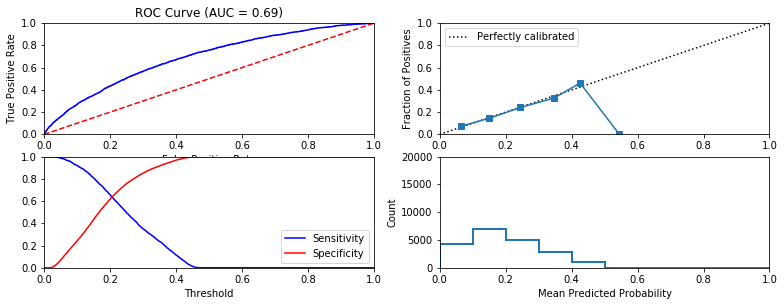


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



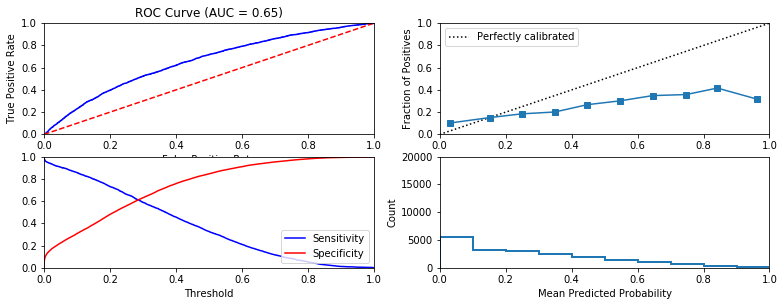


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



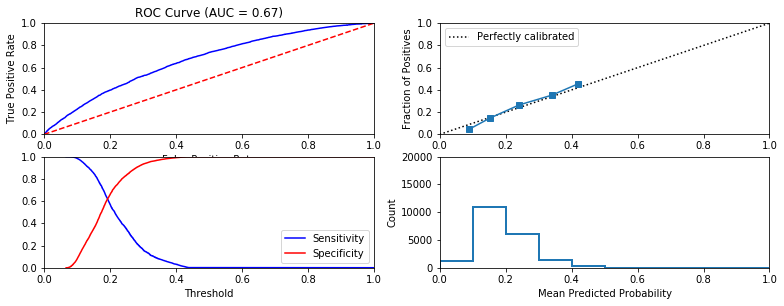


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



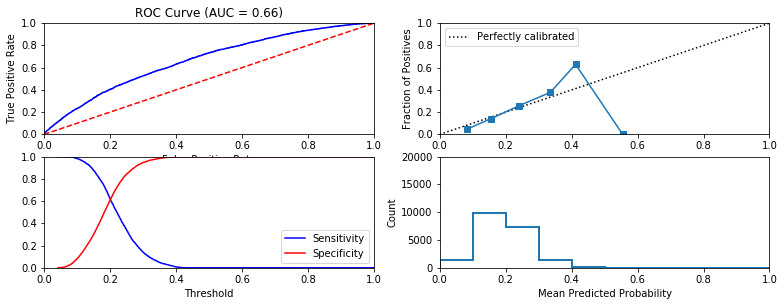


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.24 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



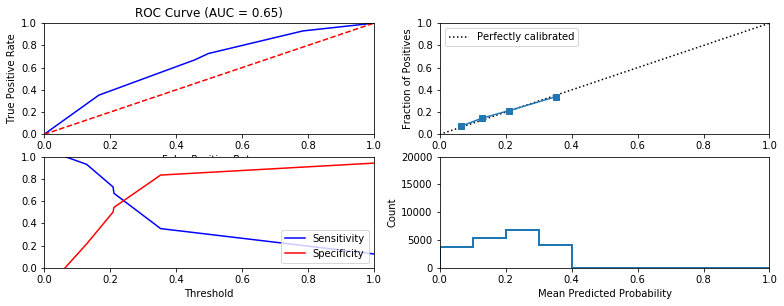


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



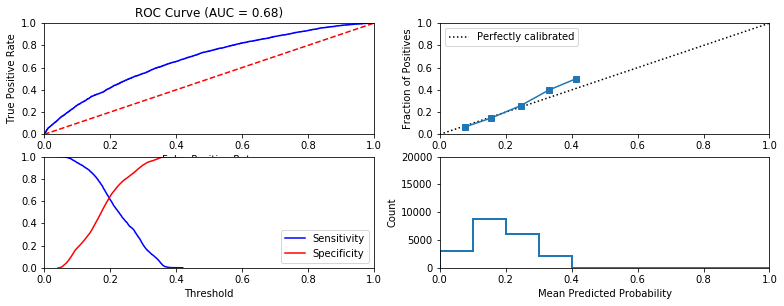


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.61 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



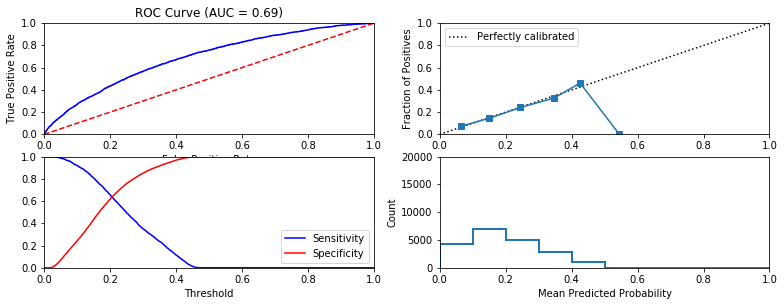


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



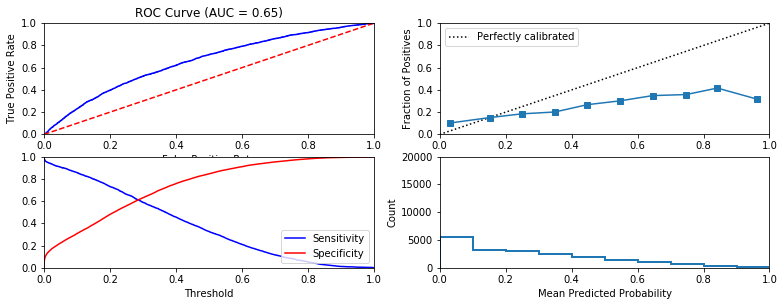


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



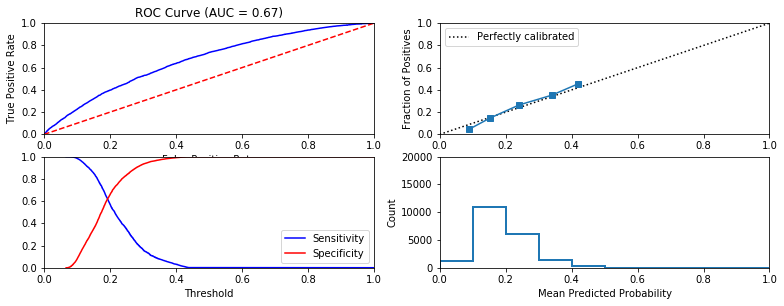


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.21 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



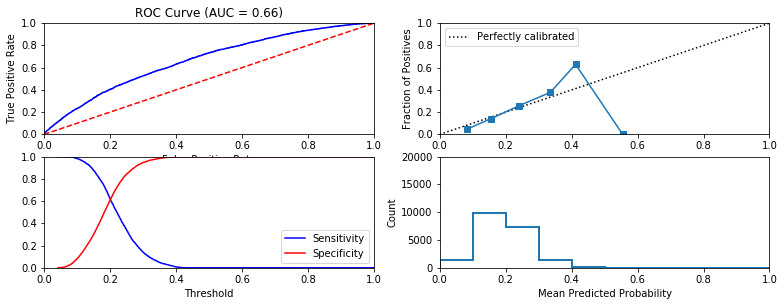


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.25 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



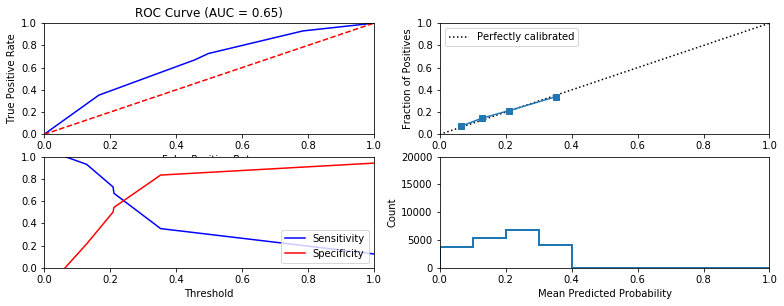


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



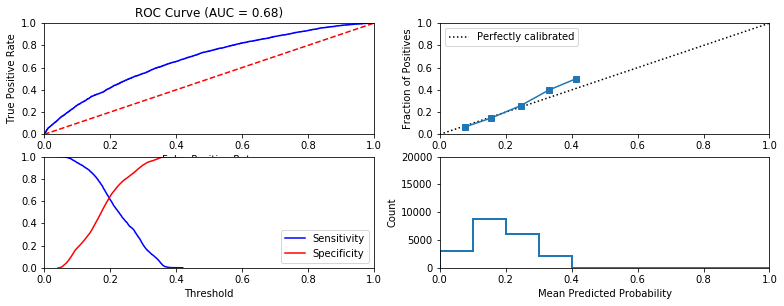


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.7 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



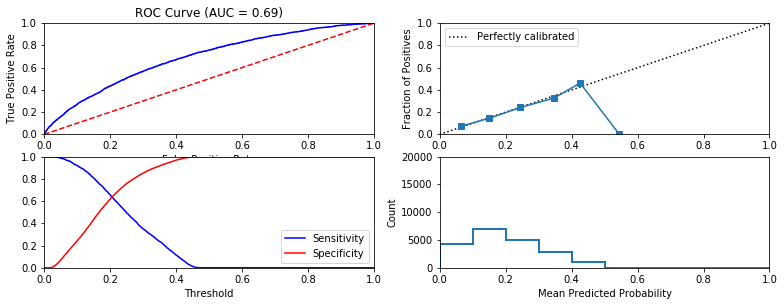


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



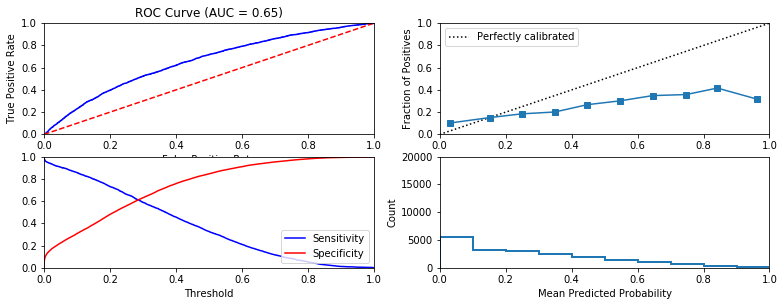


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



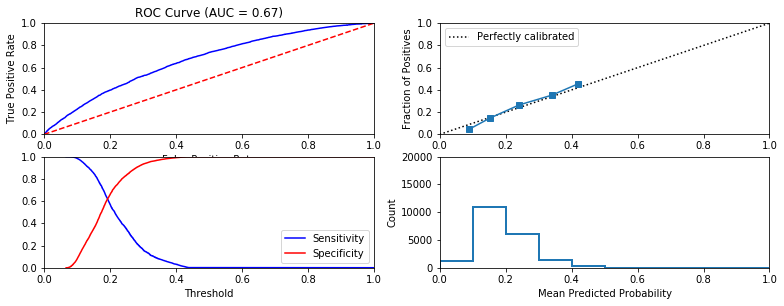


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



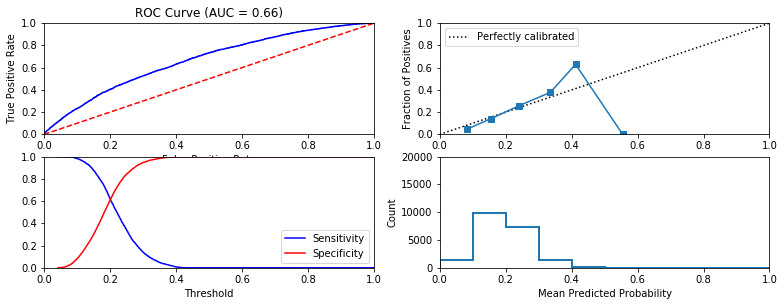


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



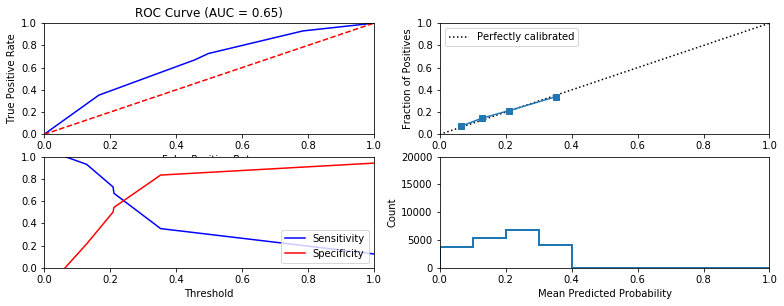


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



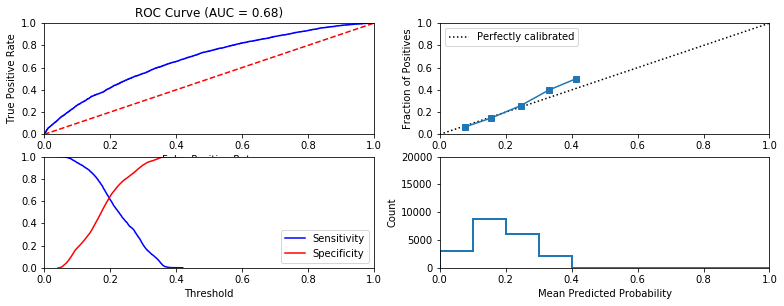


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.57 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



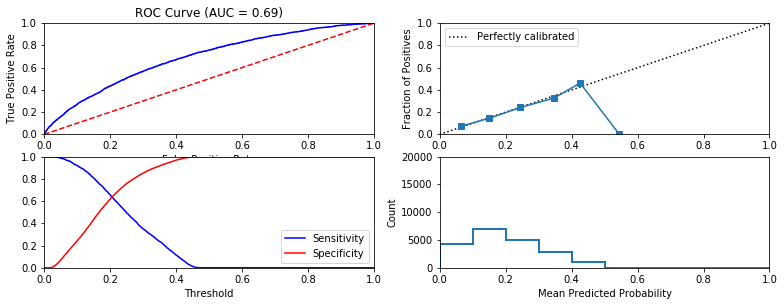


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



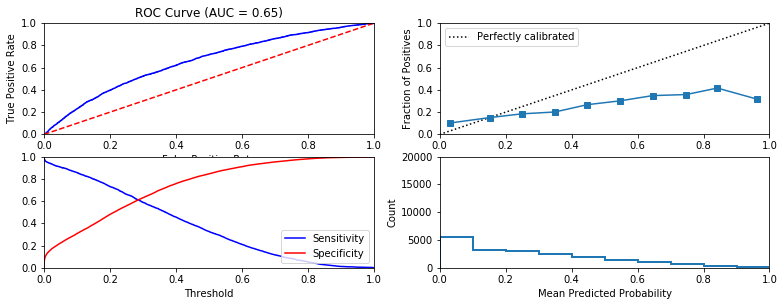


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



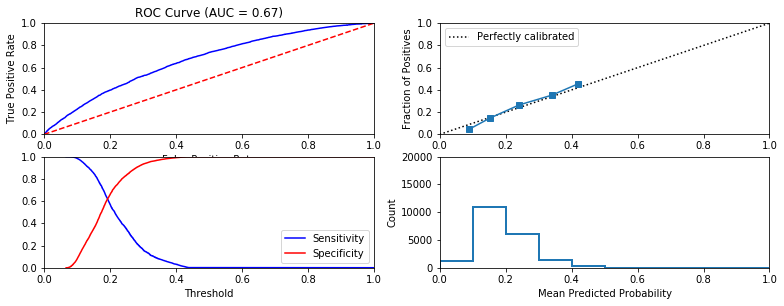


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



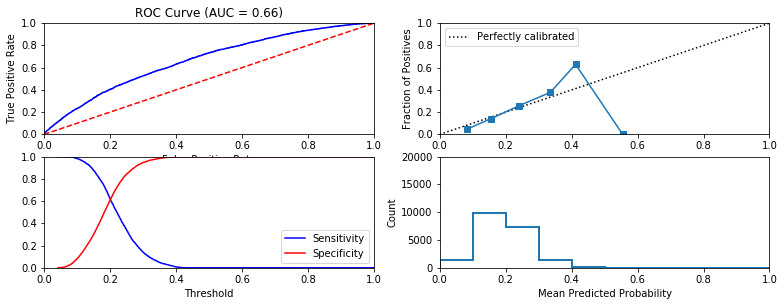


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



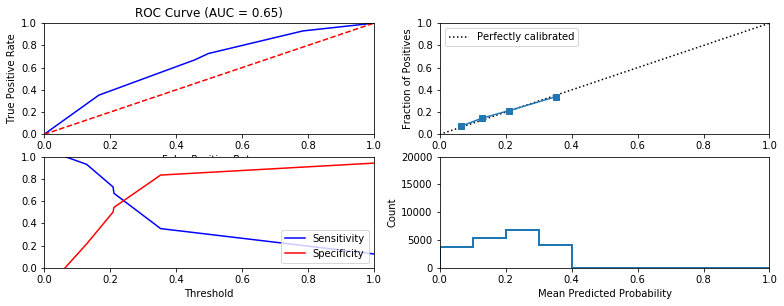


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.84 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



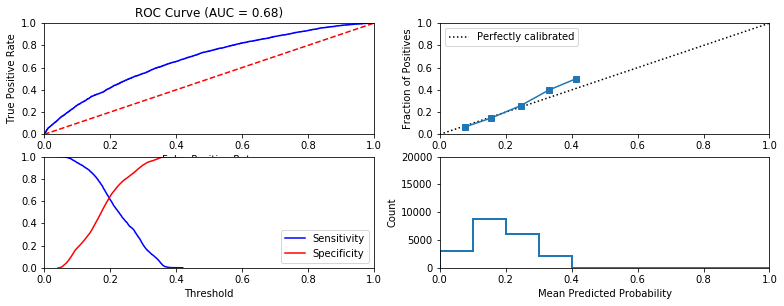


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.58 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



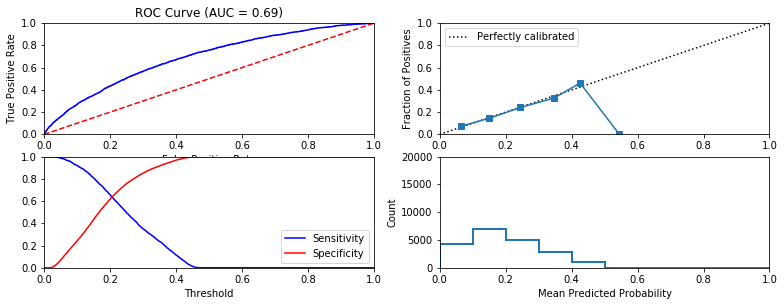


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



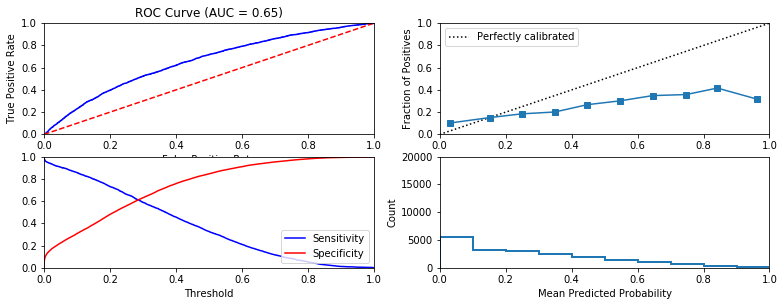


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



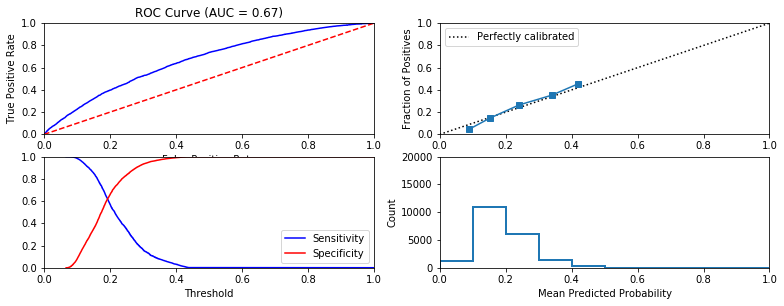


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



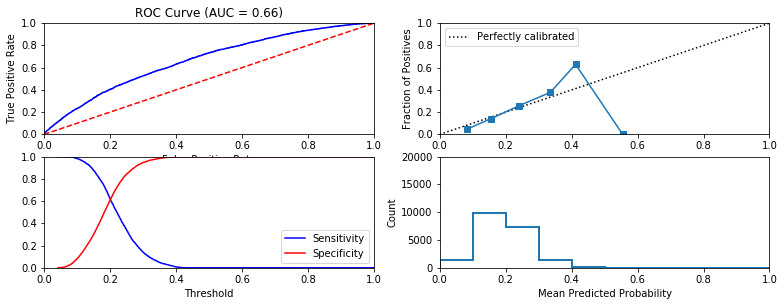


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



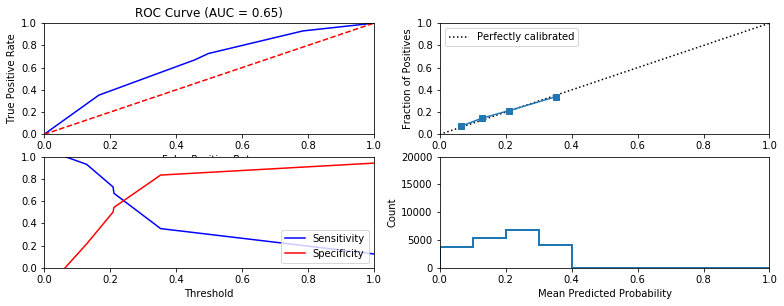


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



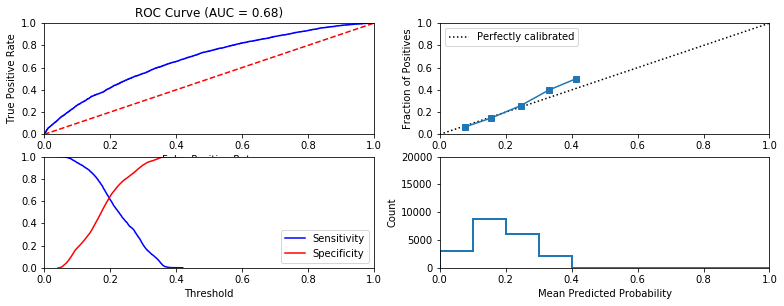


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.57 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



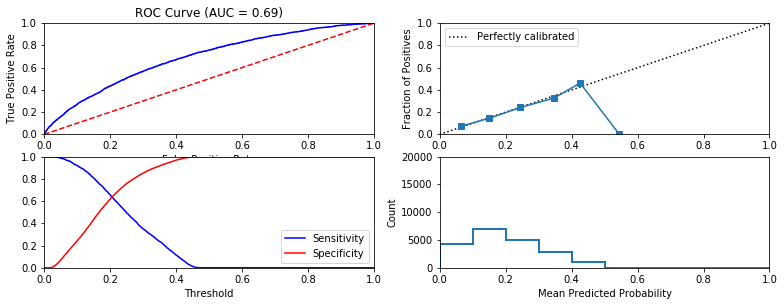


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



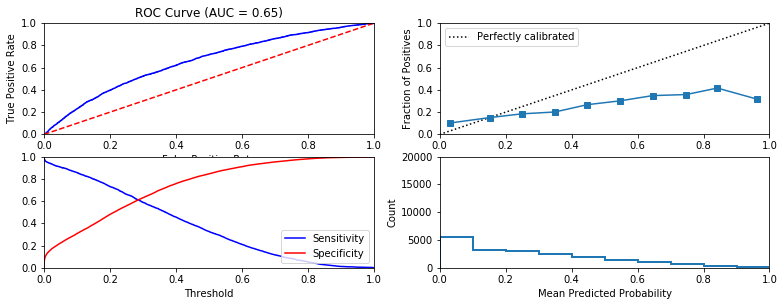


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.3 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



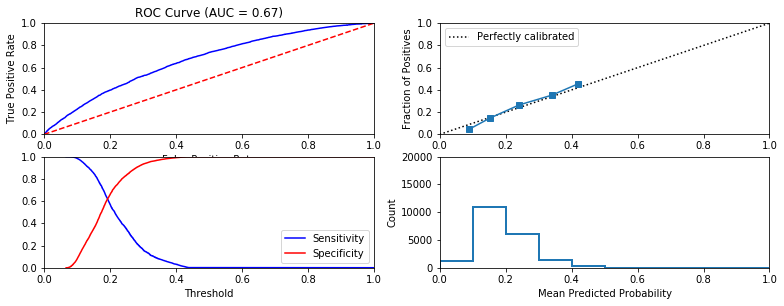


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



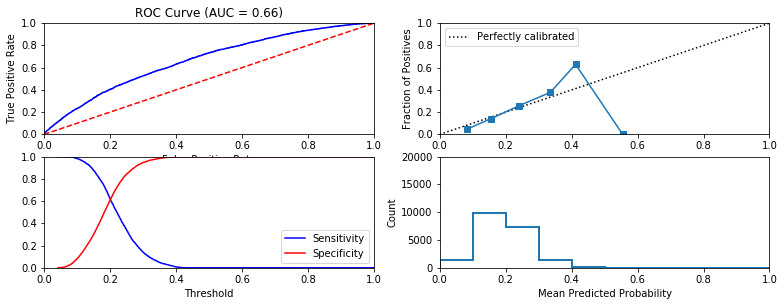


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



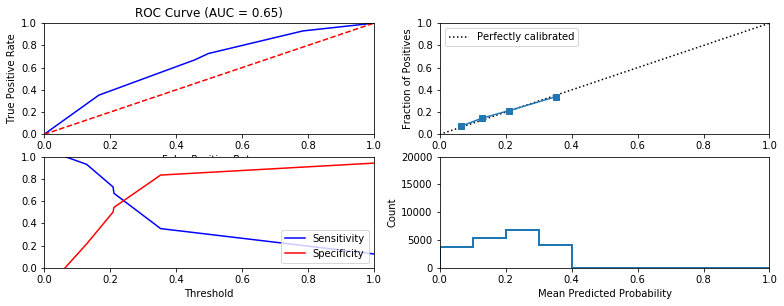


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



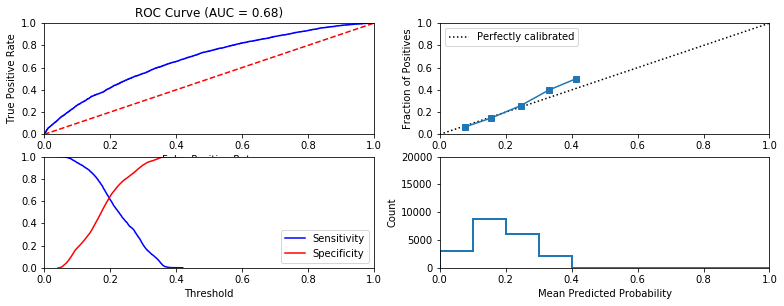


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.49 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



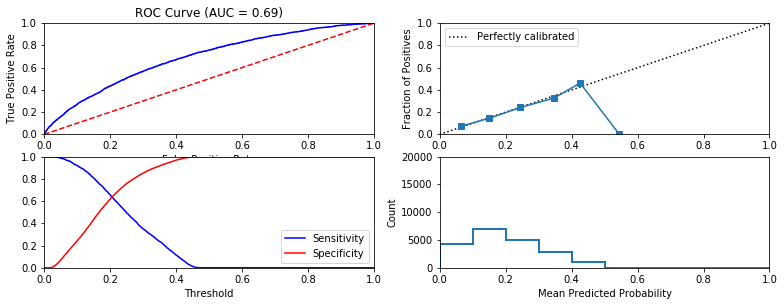


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



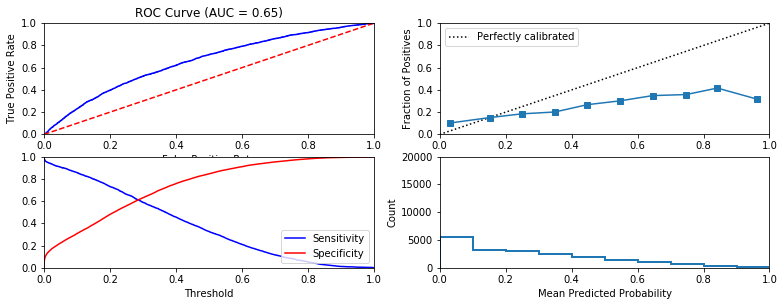


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.31 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



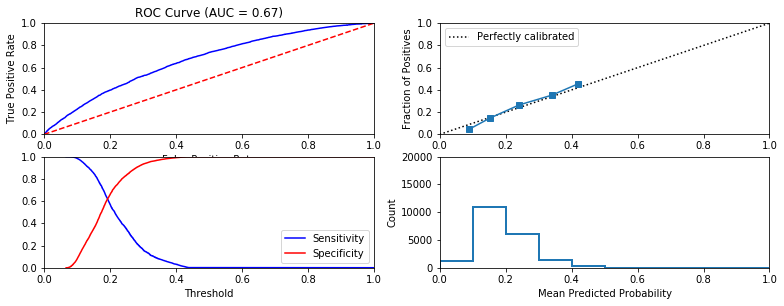


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



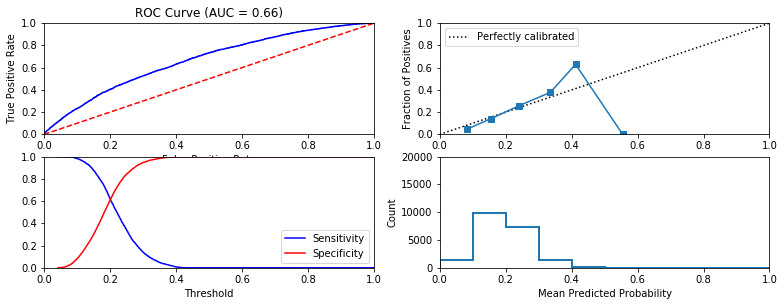


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.25 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



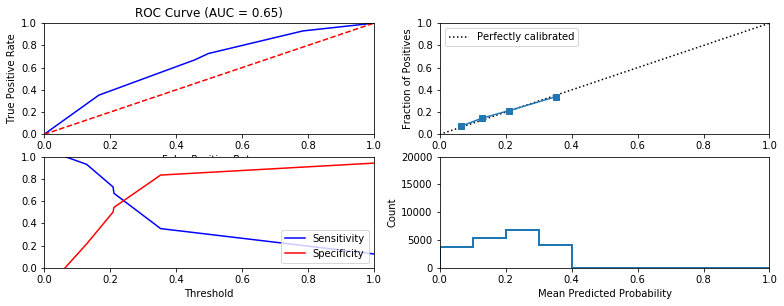


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.83 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



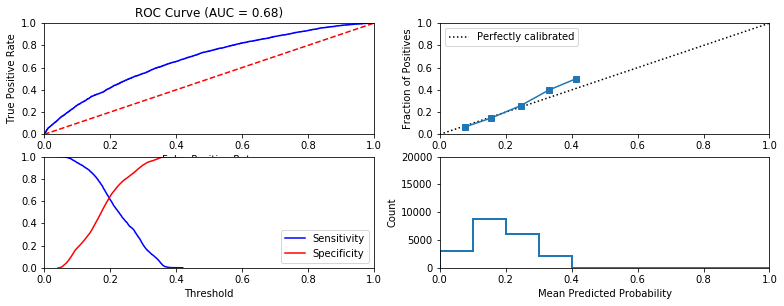


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.58 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



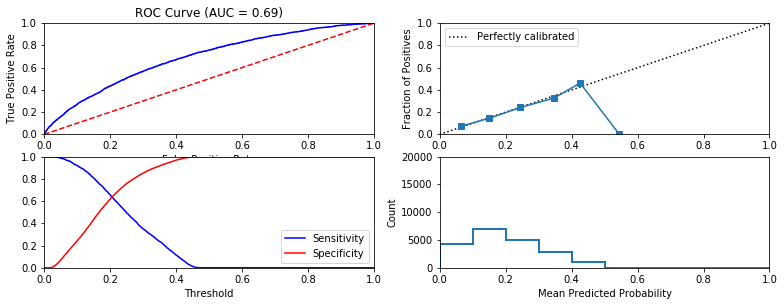


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



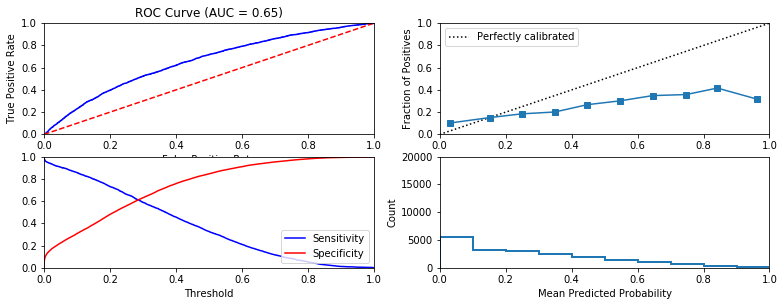


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



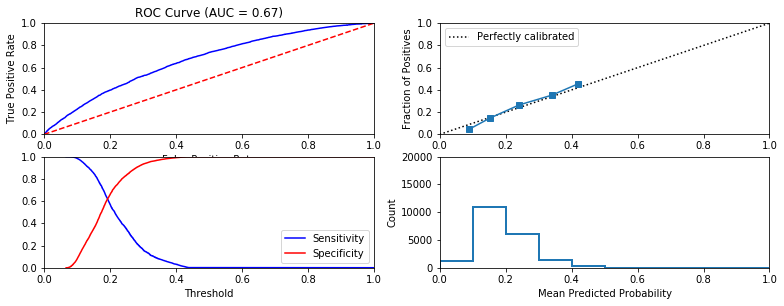


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



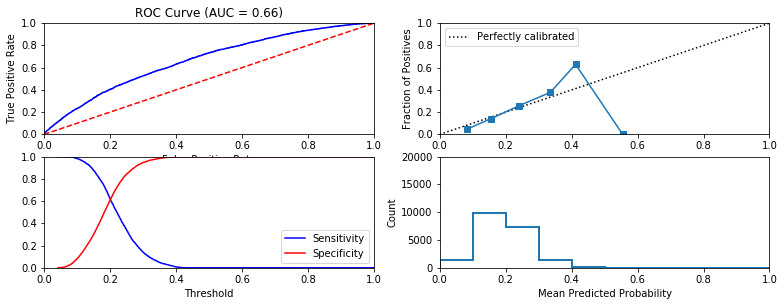


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



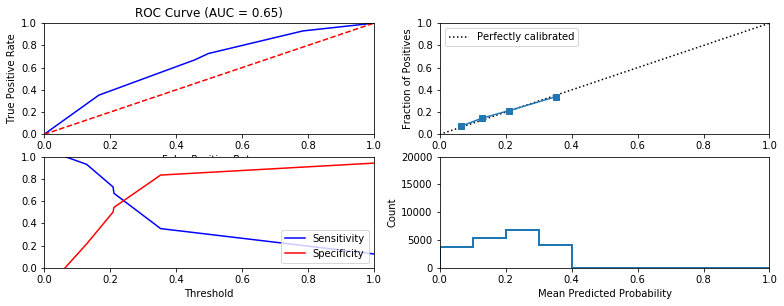


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



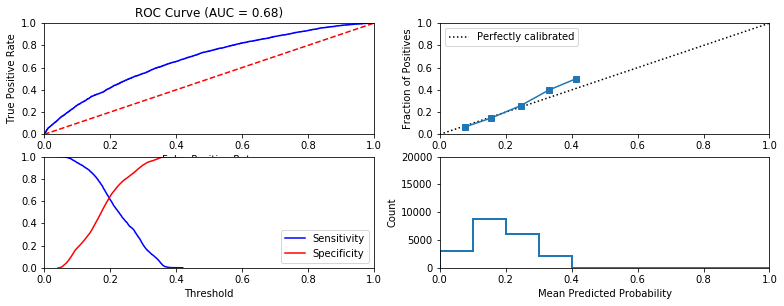


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.68 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



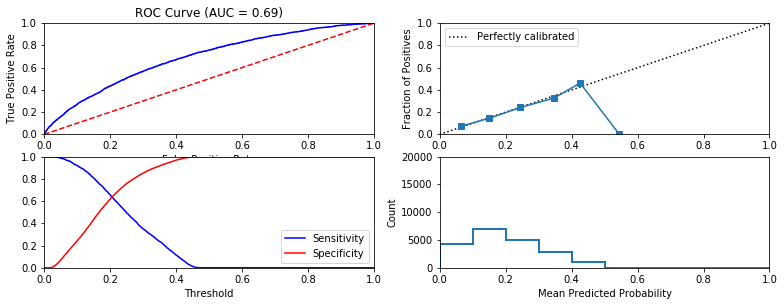


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



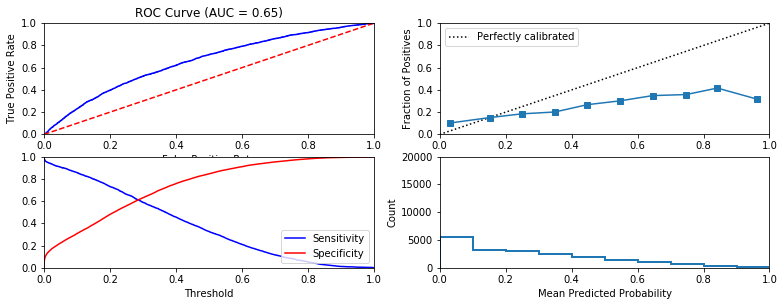


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



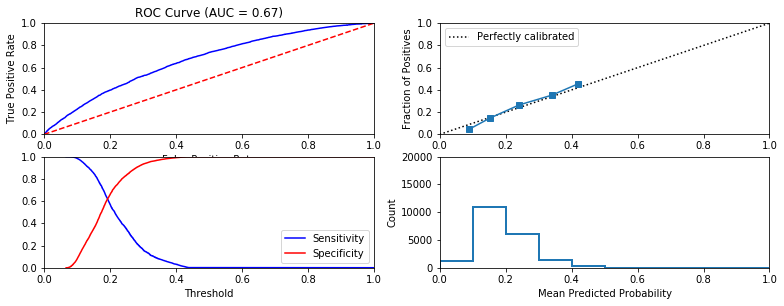


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.16 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



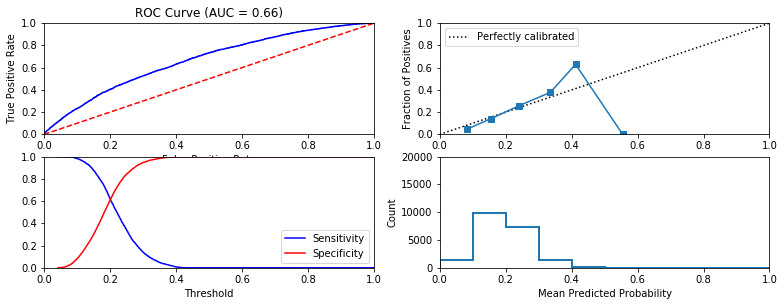


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



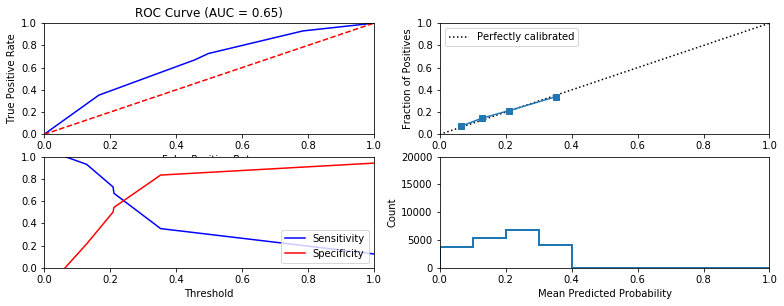


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.75 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



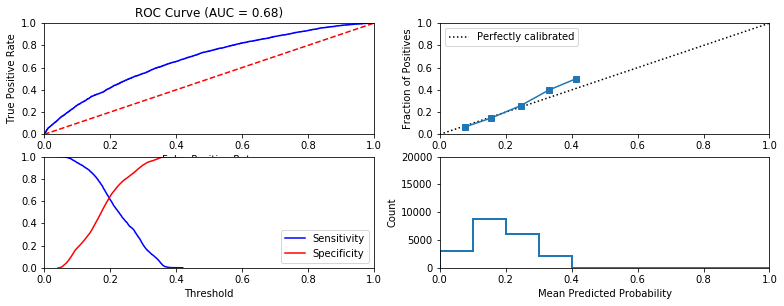


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.61 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



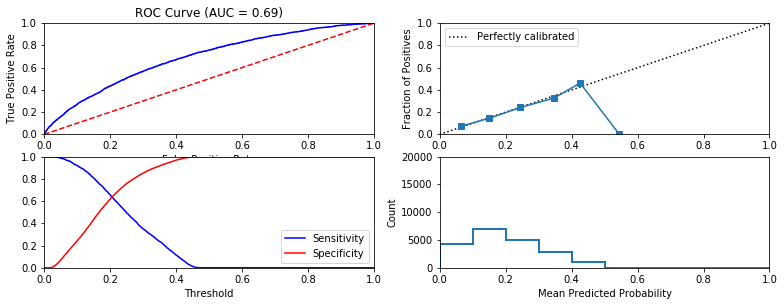


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



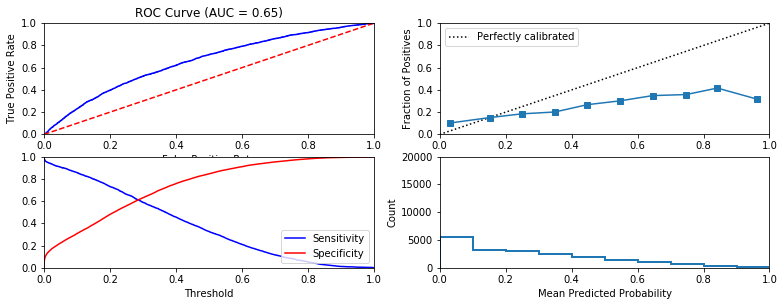


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



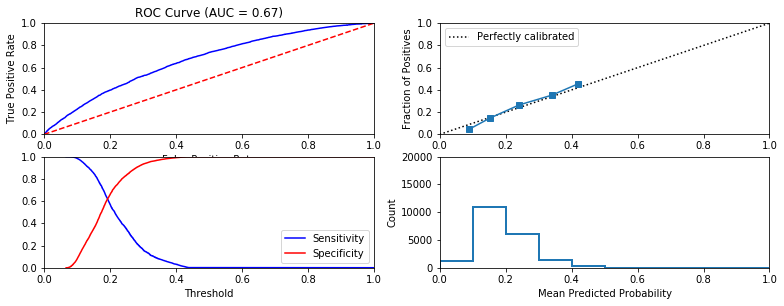


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



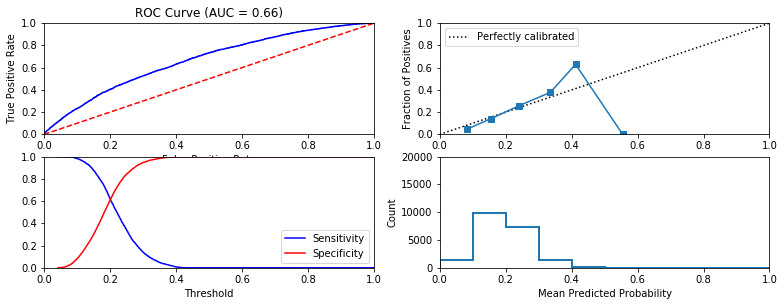


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



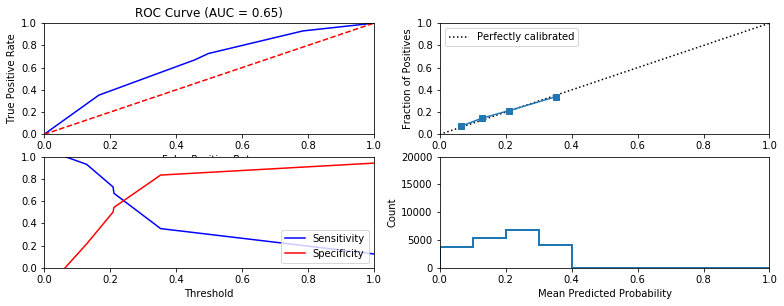


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.78 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



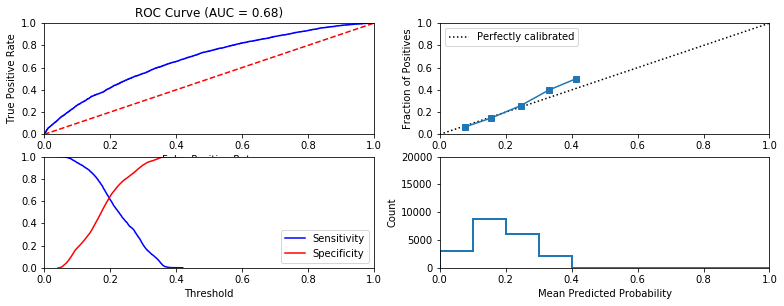


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



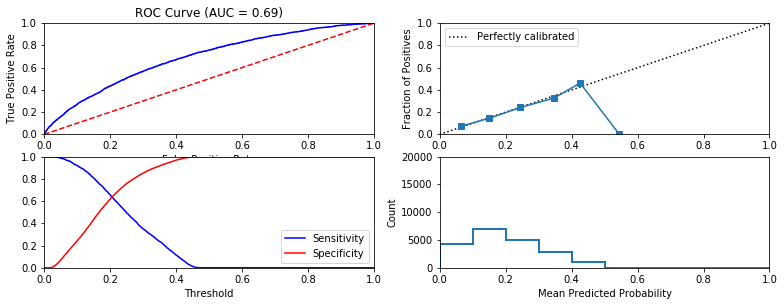


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.08 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



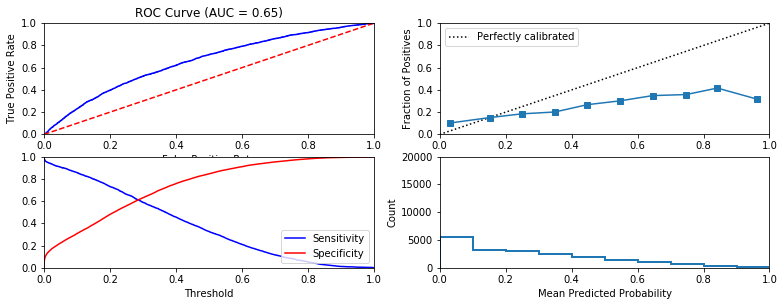


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.33 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



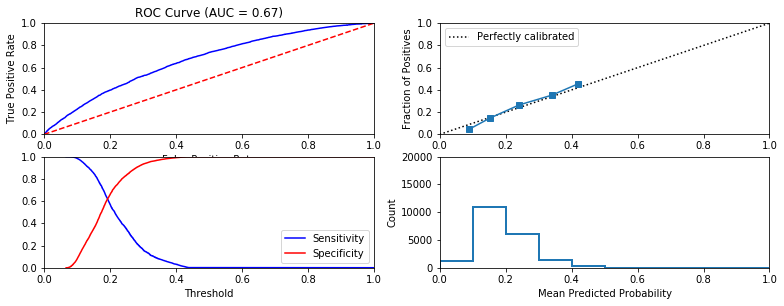


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



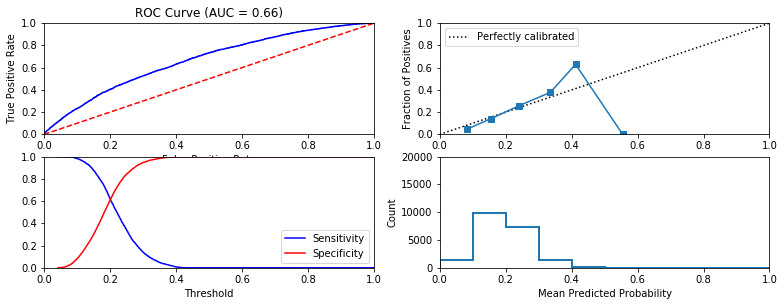


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



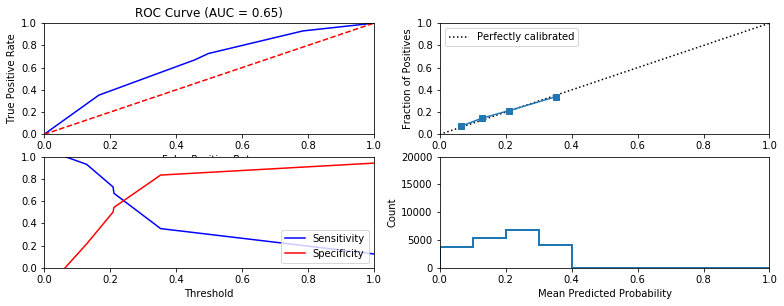


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.73 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



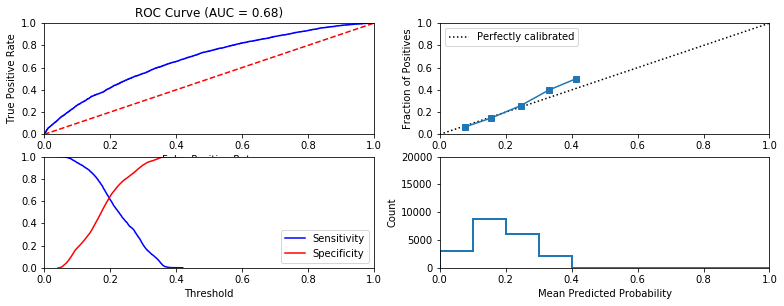


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.35 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



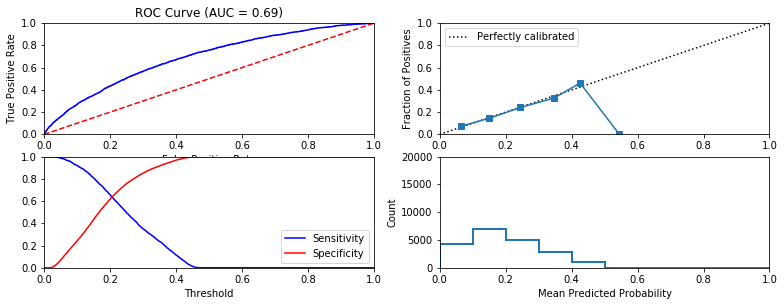


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



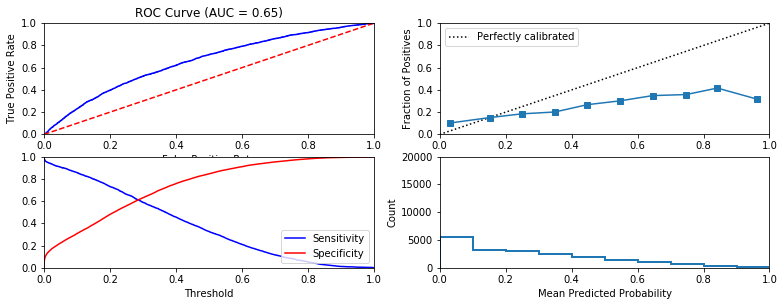


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



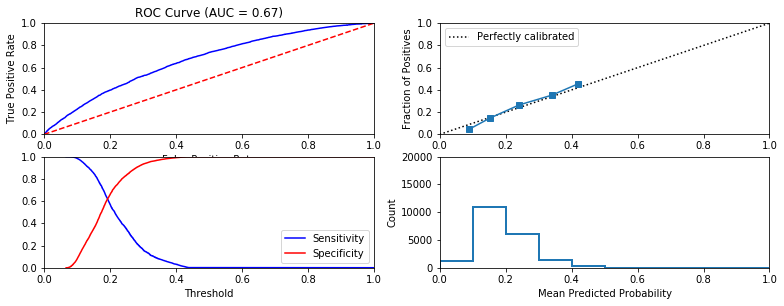


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



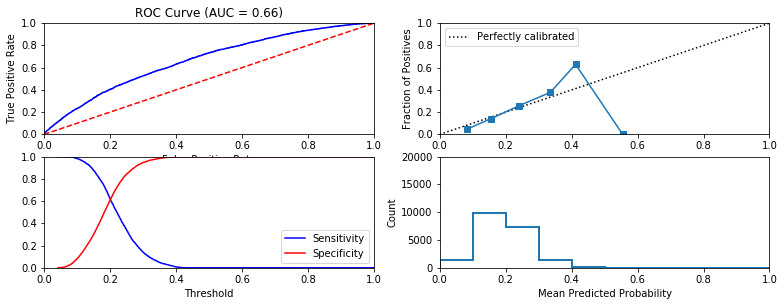


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.32 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



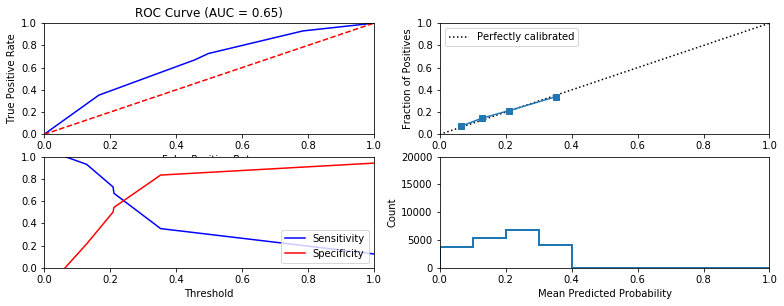


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.86 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



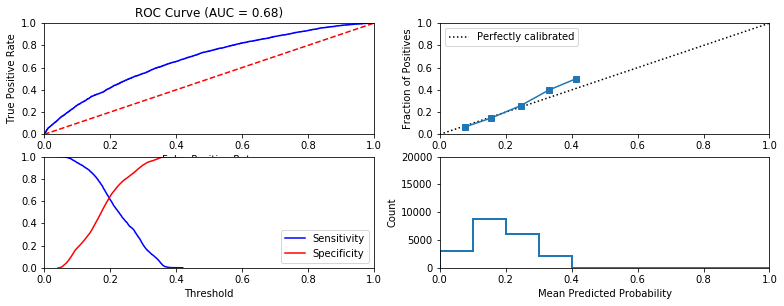


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.64 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



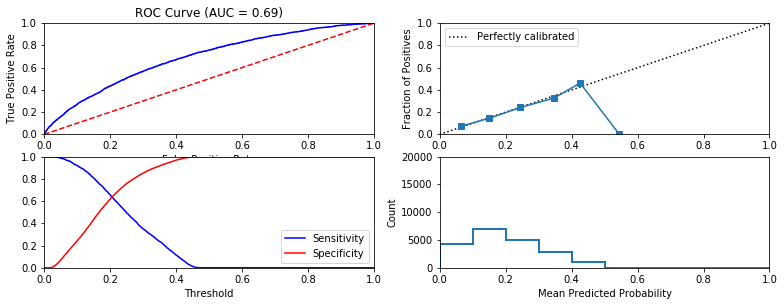


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



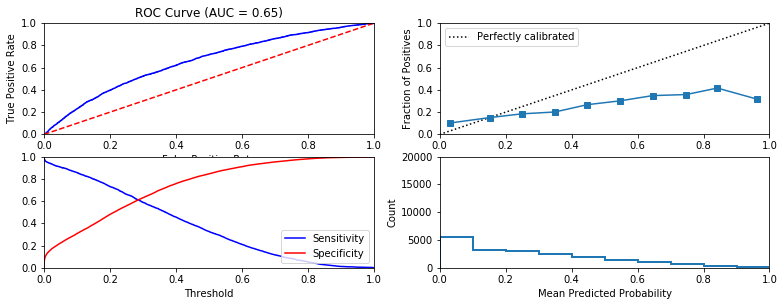


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



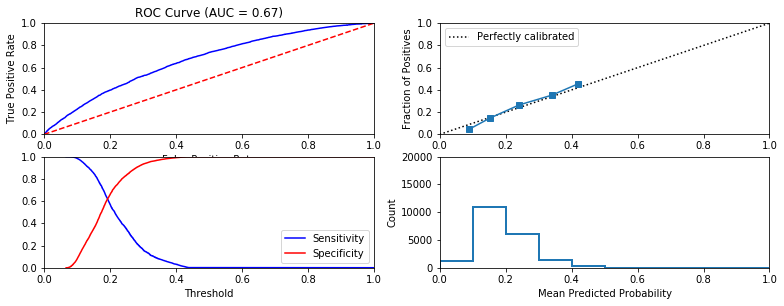


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



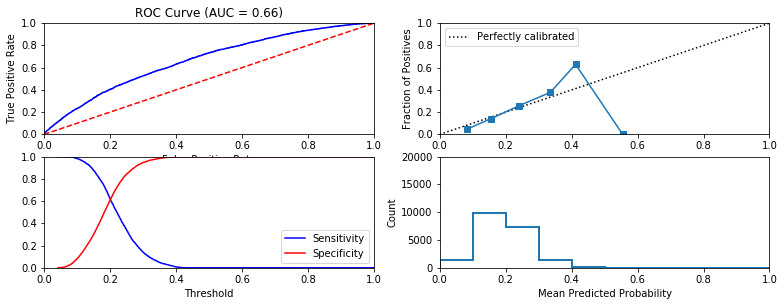


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



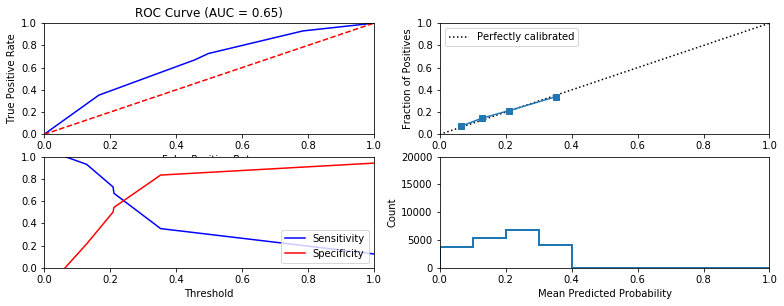


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.75 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



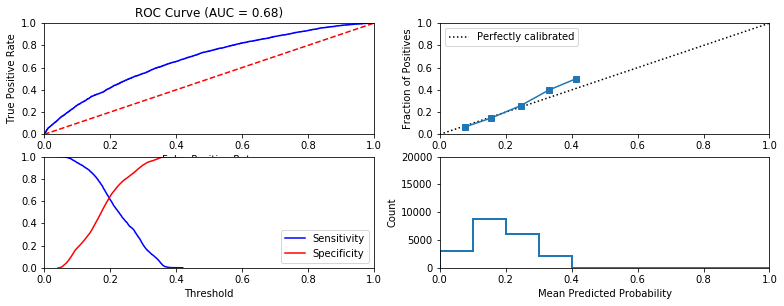


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.96 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



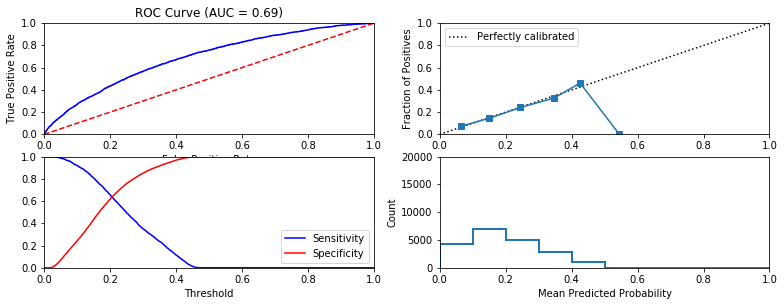


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



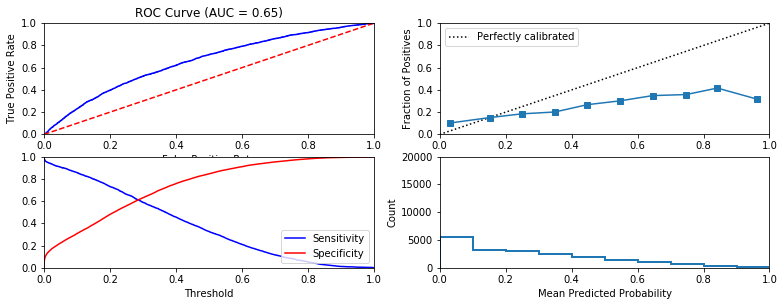


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



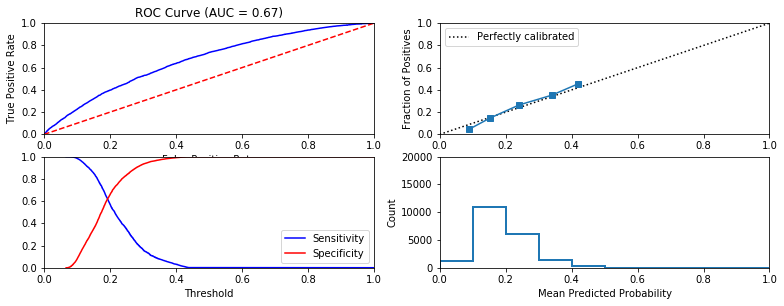


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



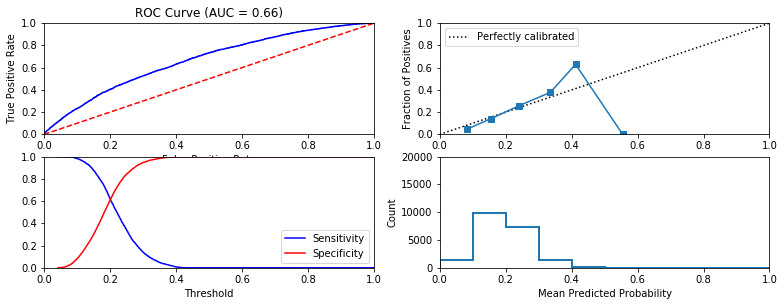


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



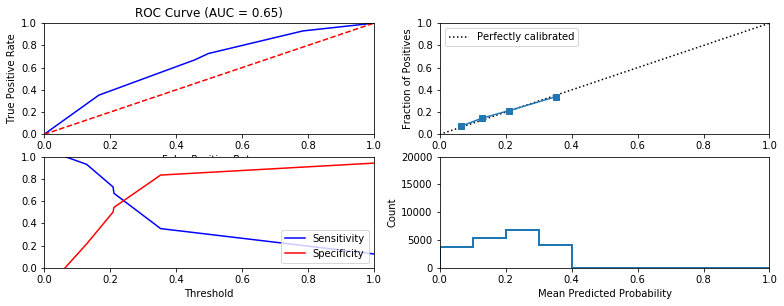


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.74 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



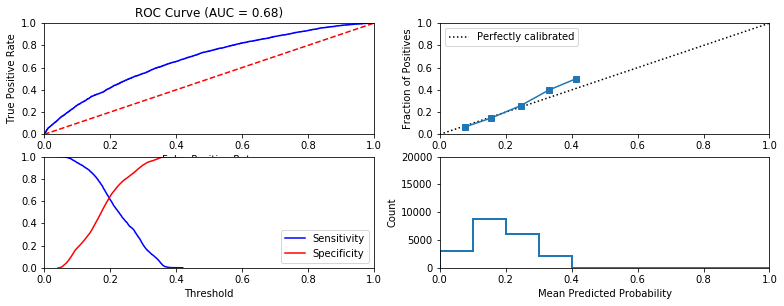


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.56 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



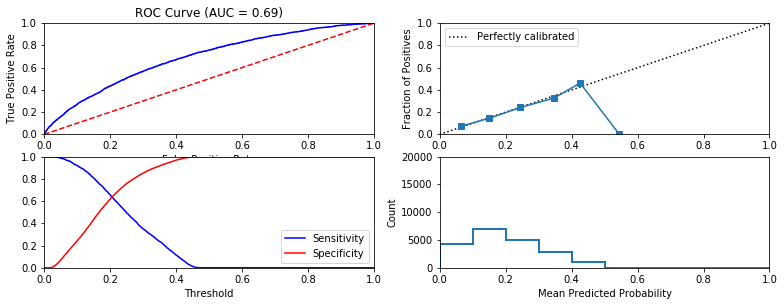


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



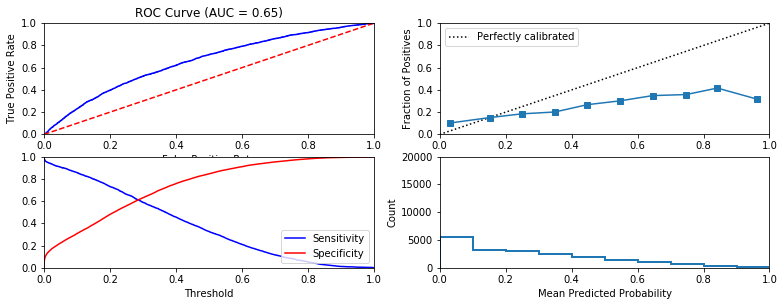


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



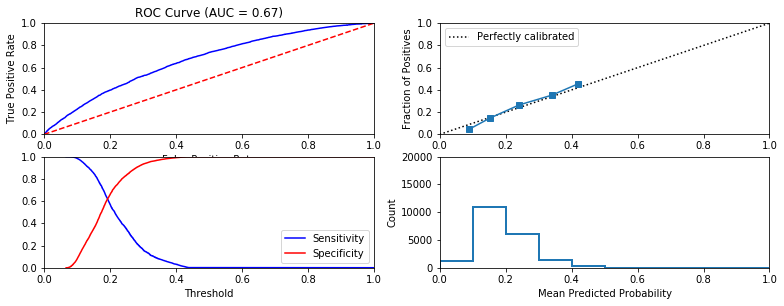


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



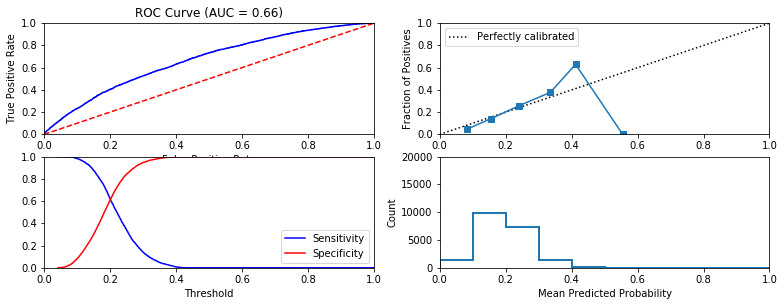


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



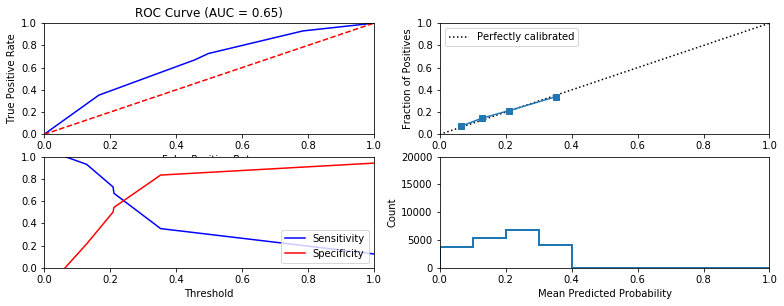


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 3.32 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



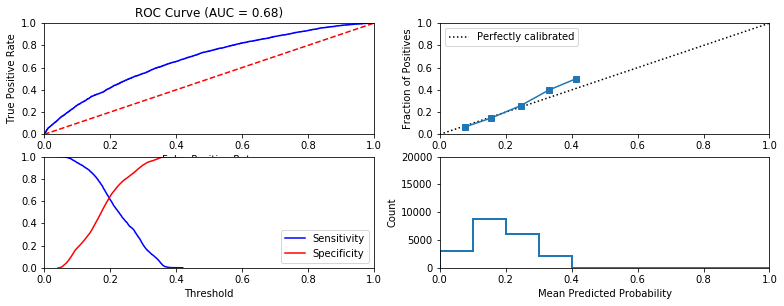


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 16.14 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



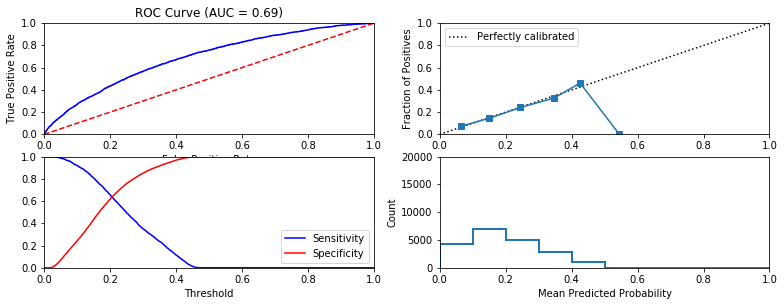


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



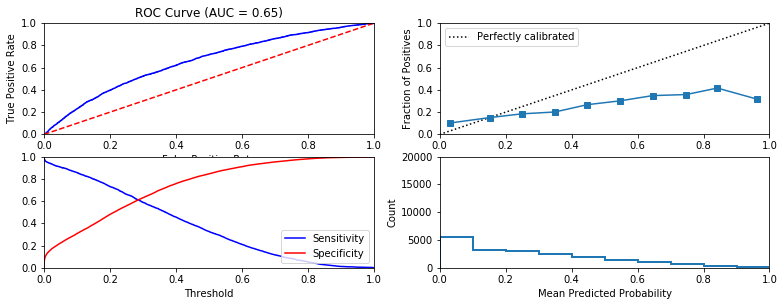


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.31 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



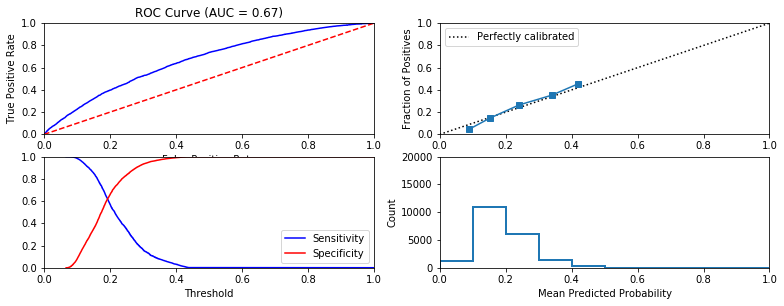


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



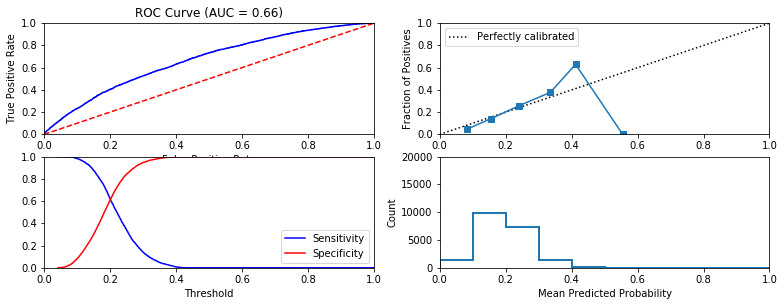


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



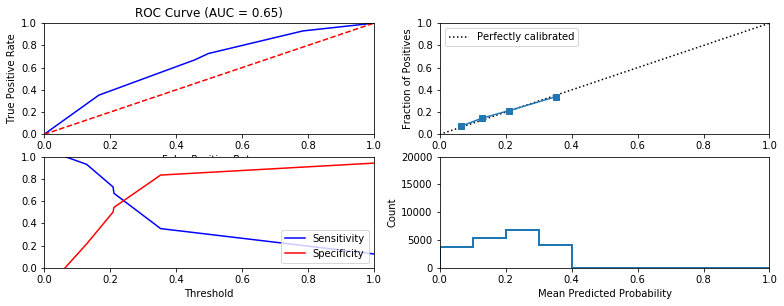


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 3.21 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



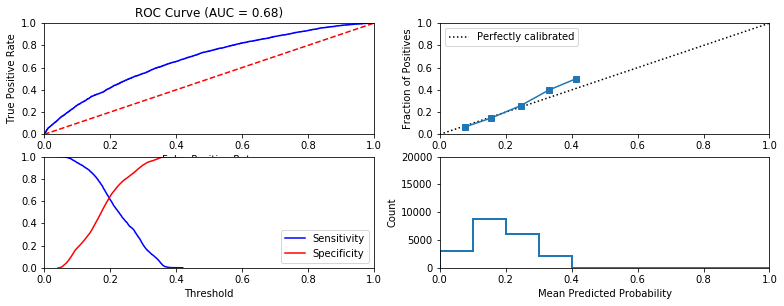


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.8 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



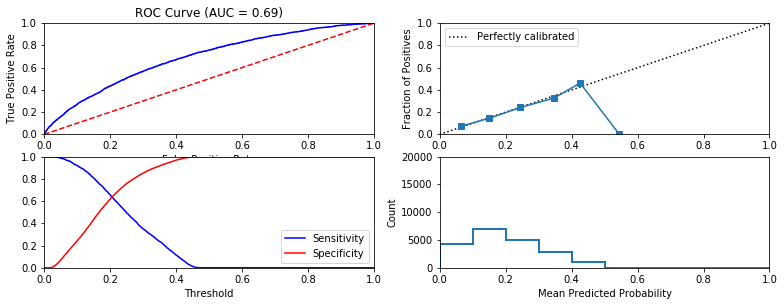


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.11 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



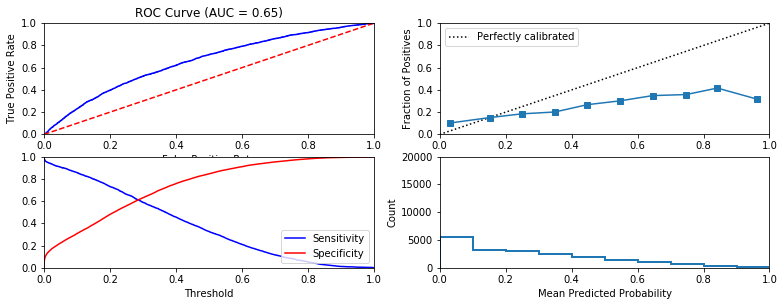


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.31 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



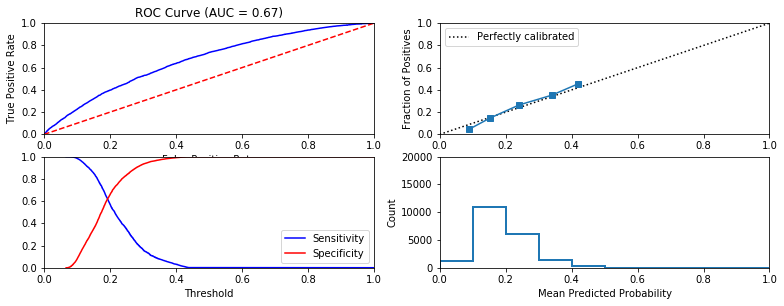


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.15 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



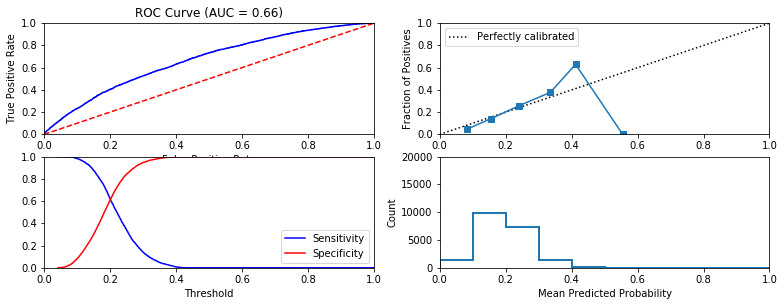


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



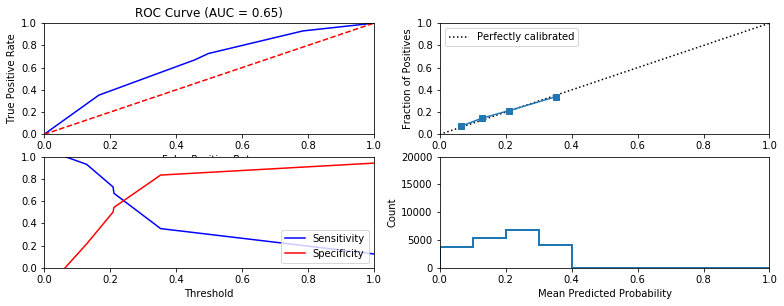


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 3.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



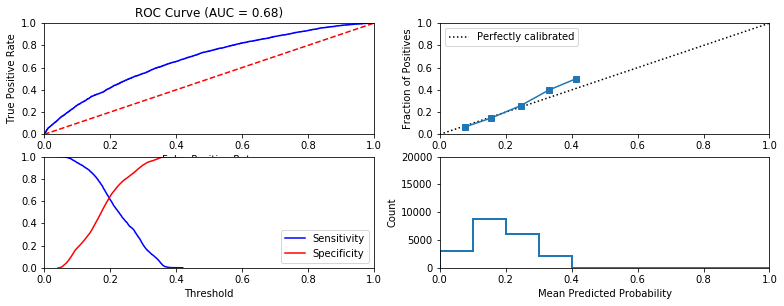


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.2 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



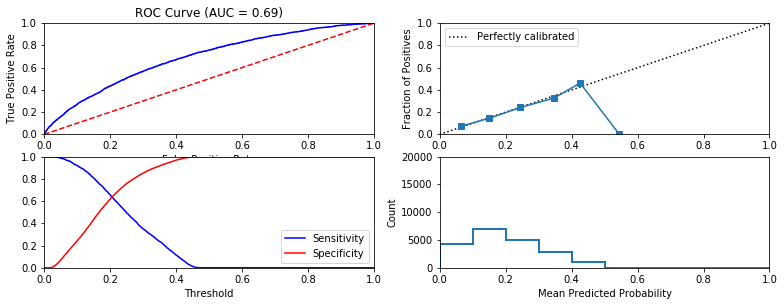


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



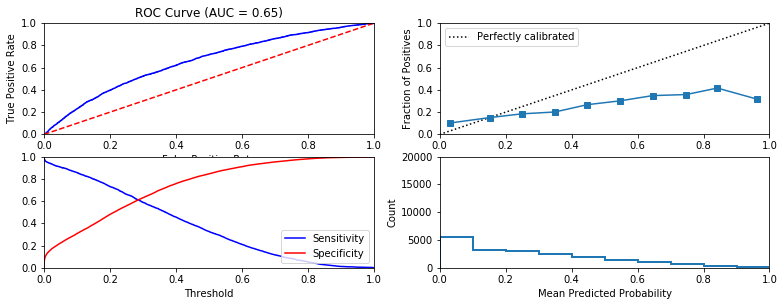


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.27 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



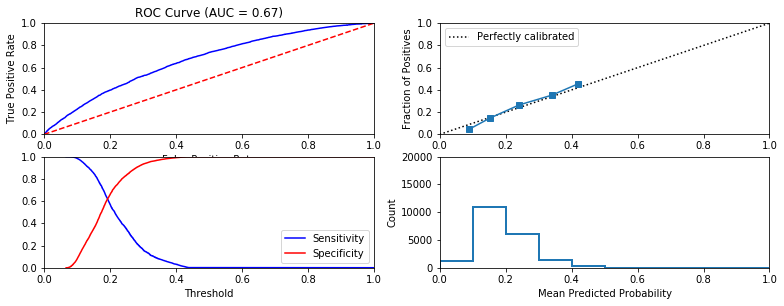


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.2 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



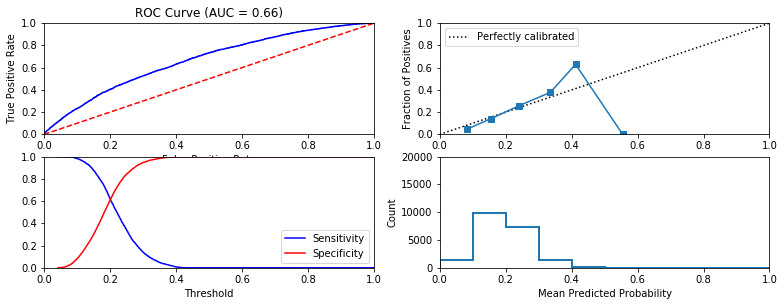


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.24 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



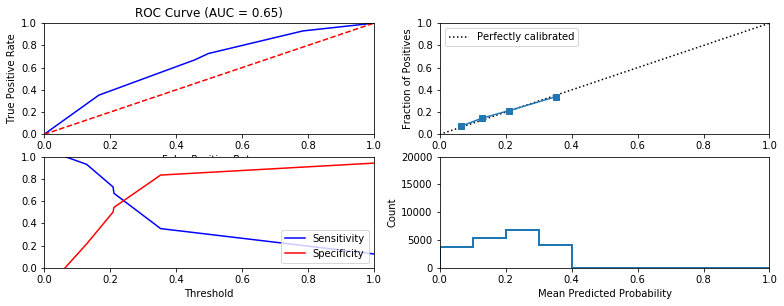


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.78 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



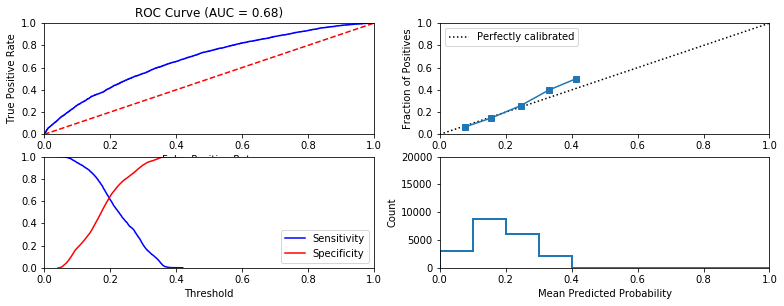


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



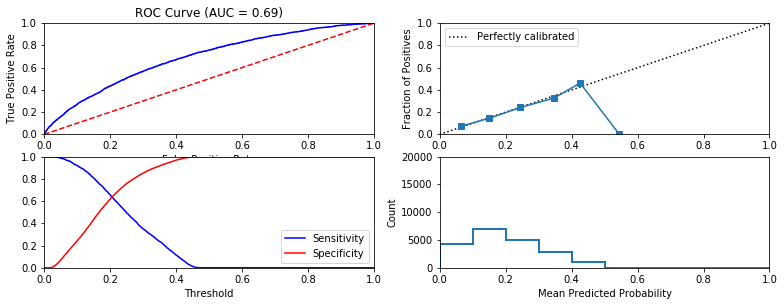


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



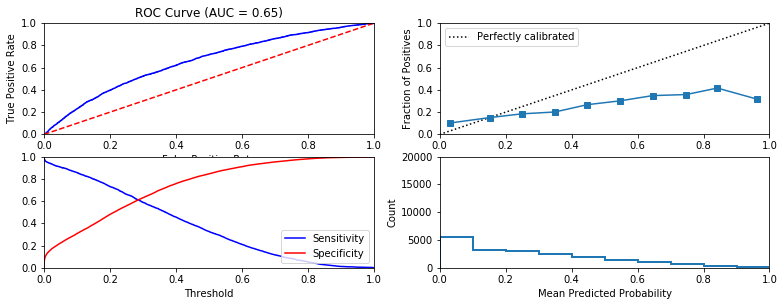


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



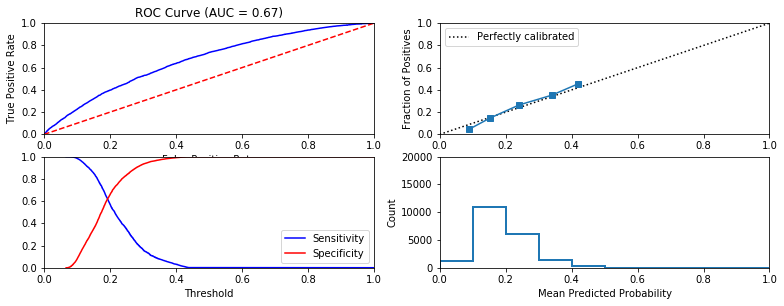


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



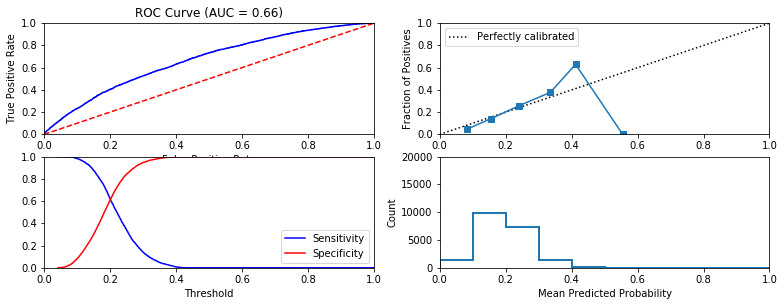


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



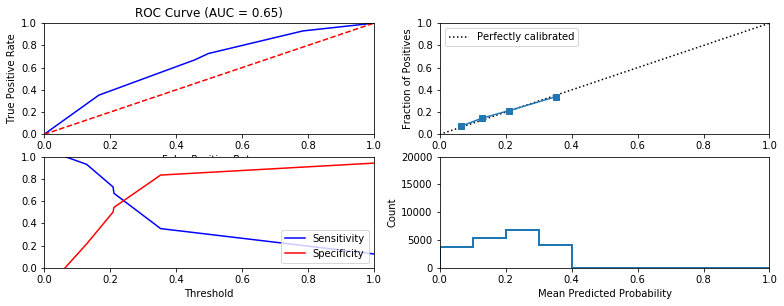


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.96 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



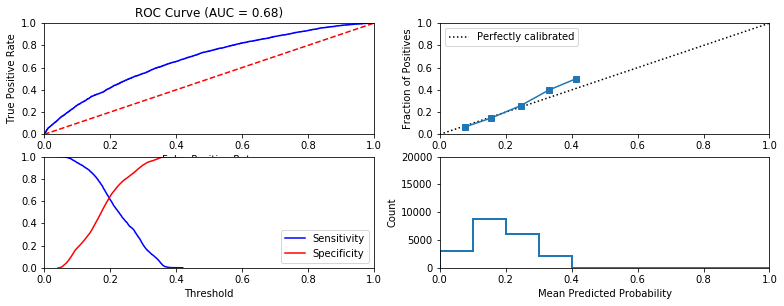


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.25 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



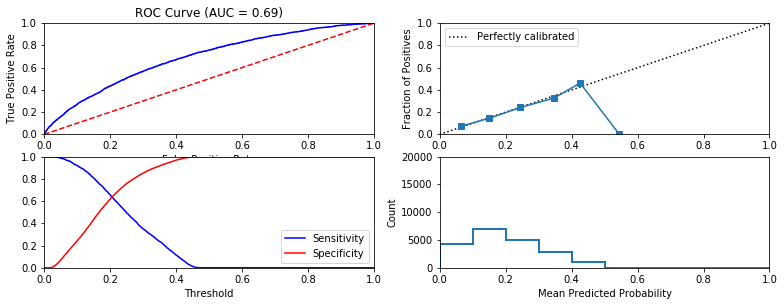


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



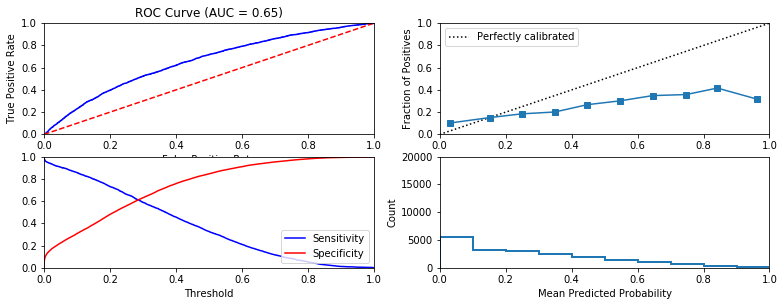


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.35 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



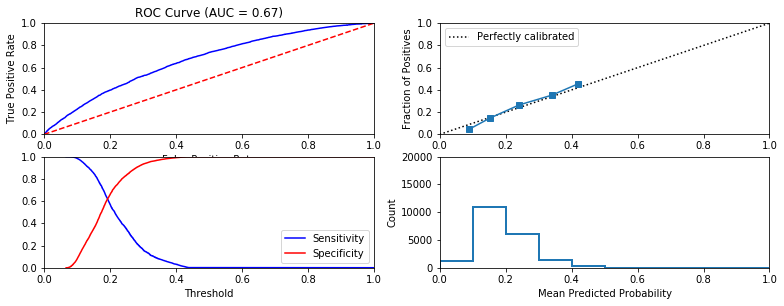


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



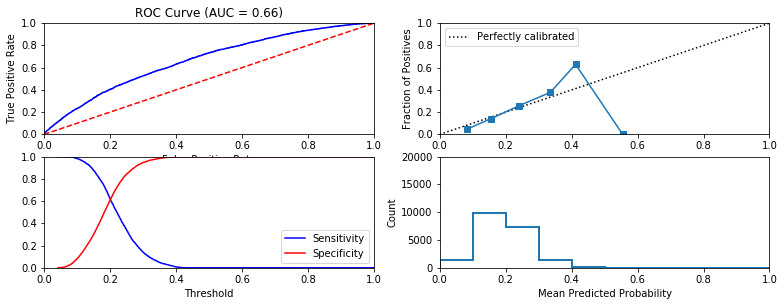


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



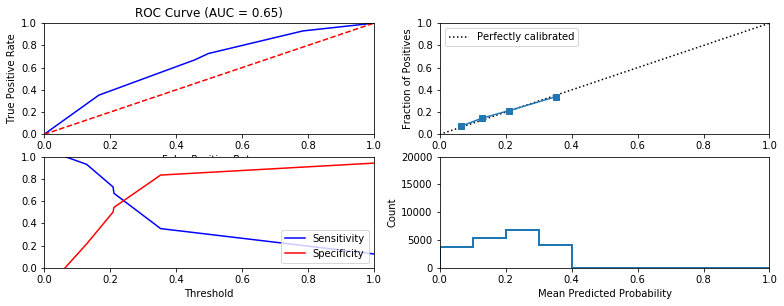


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.8 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



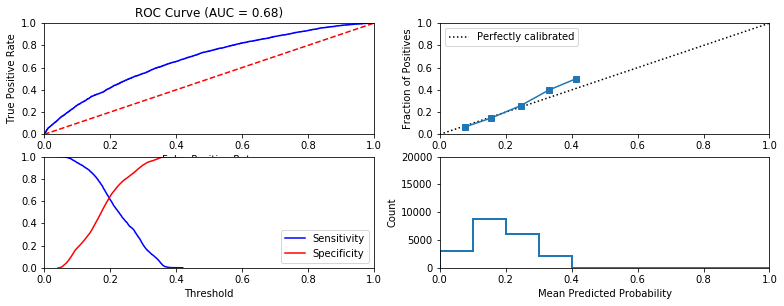


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



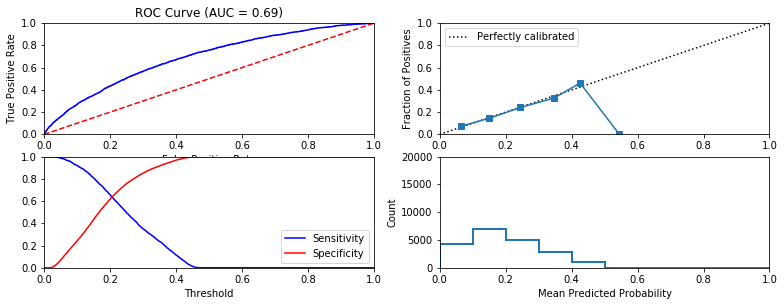


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



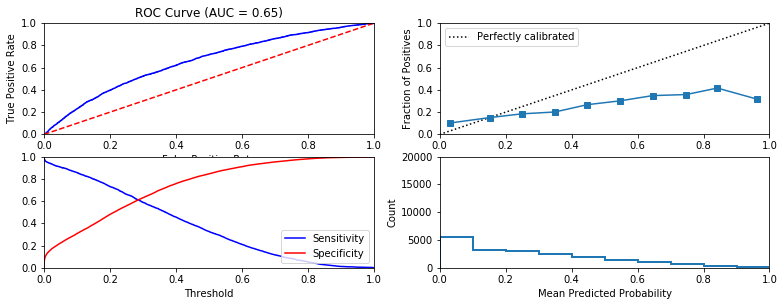


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



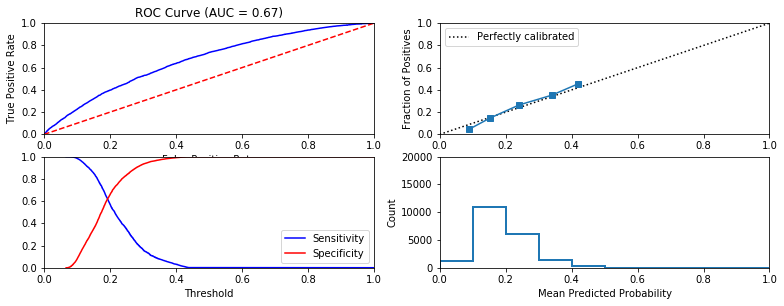


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.26 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



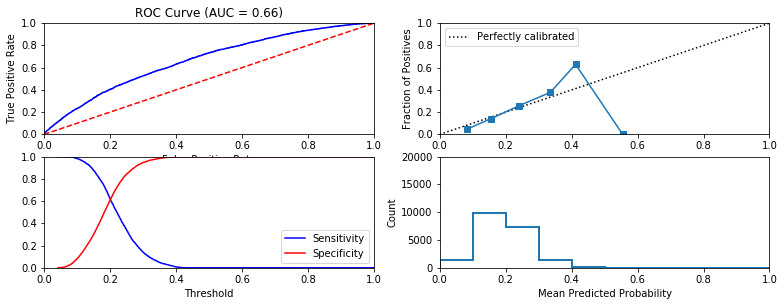


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



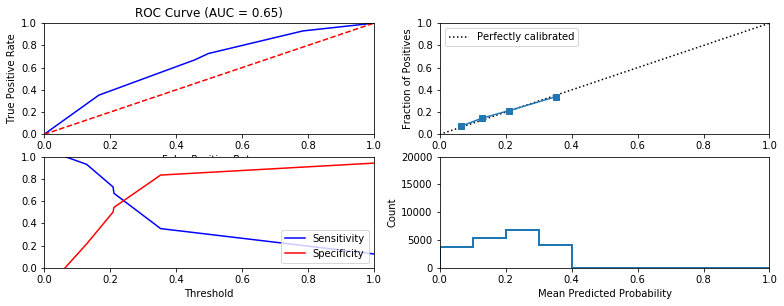


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 3.49 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



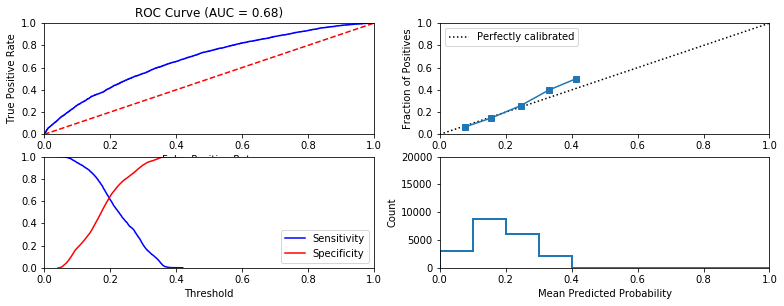


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 16.8 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



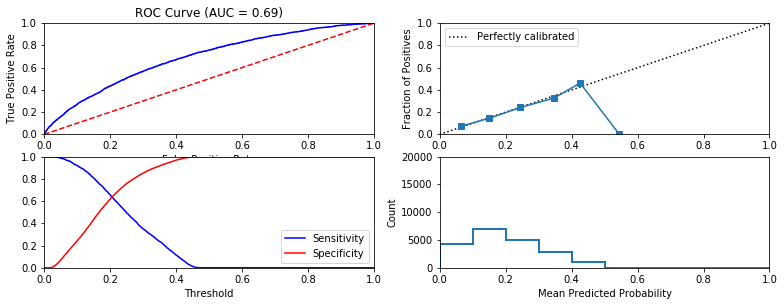


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



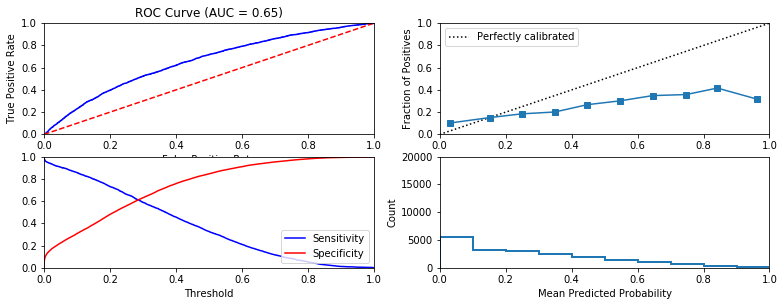


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.31 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



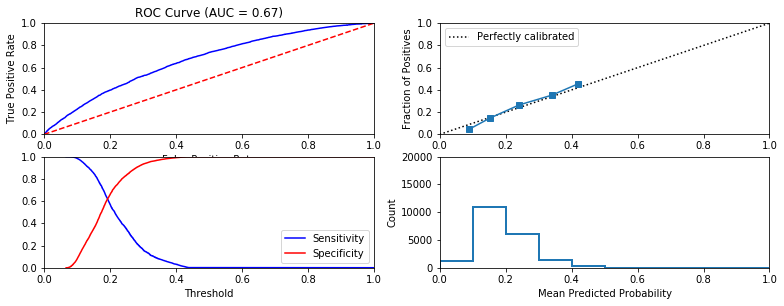


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.2 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



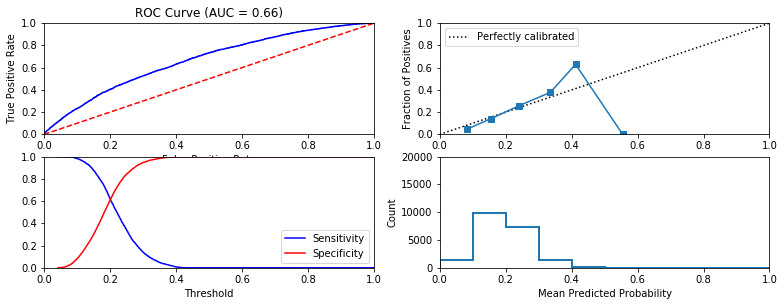


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



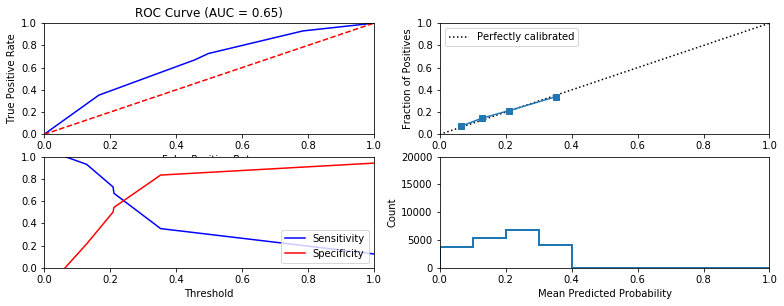


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.87 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



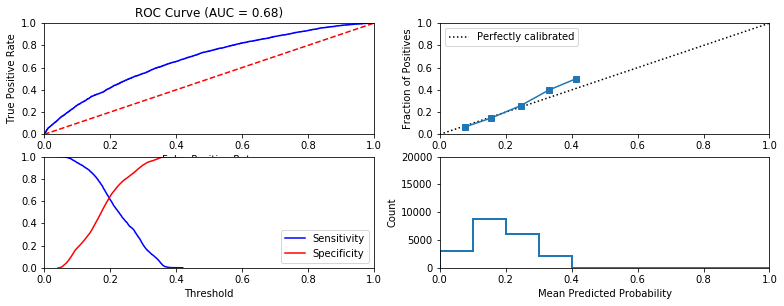


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



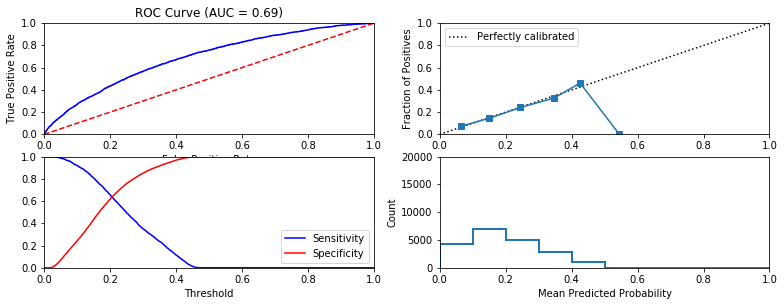


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



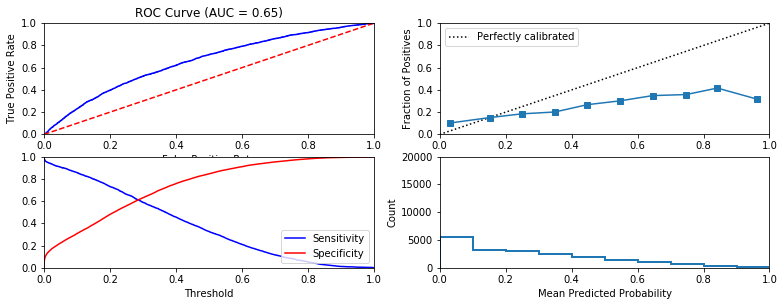


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.31 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



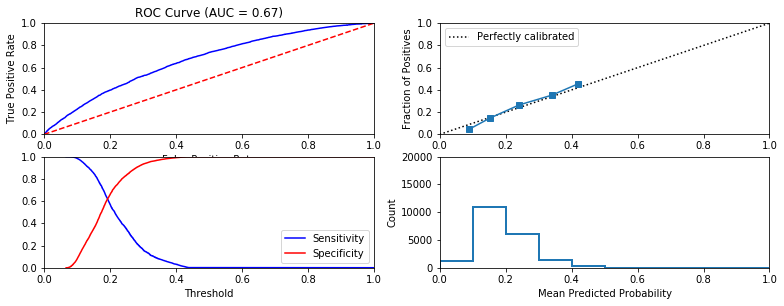


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



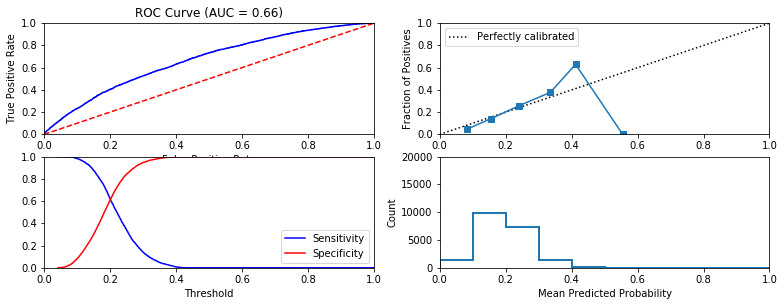


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



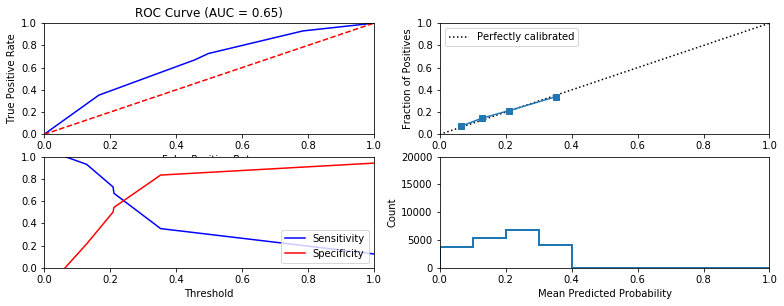


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.91 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



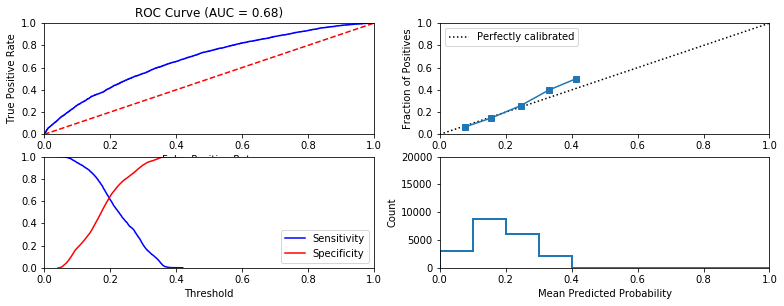


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



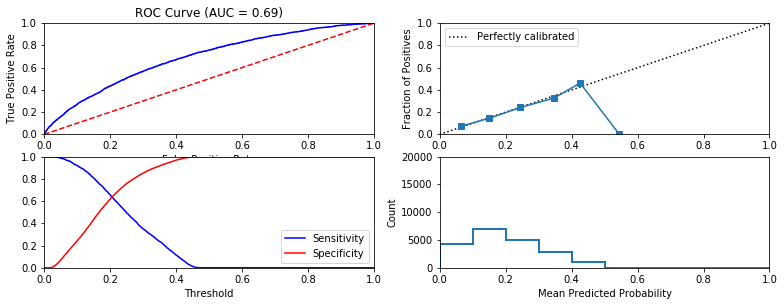


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



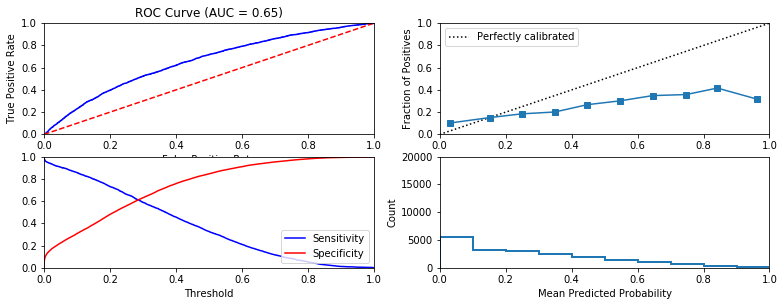


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



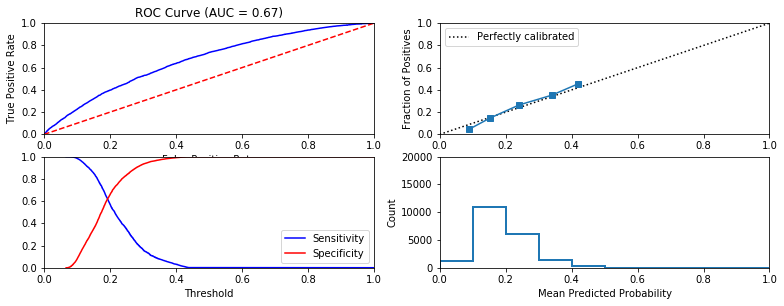


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.19 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



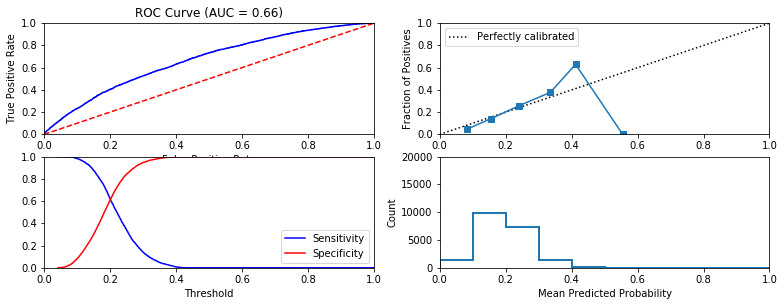


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.24 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



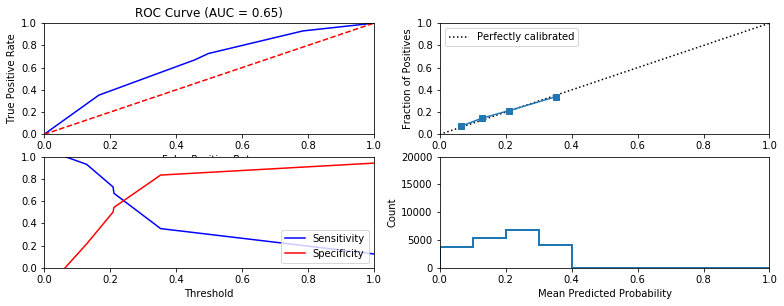


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.82 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



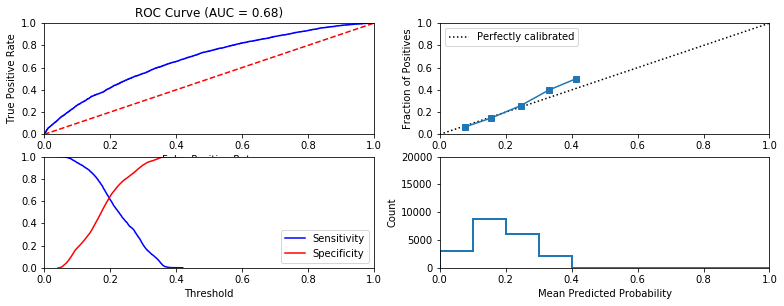


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.25 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



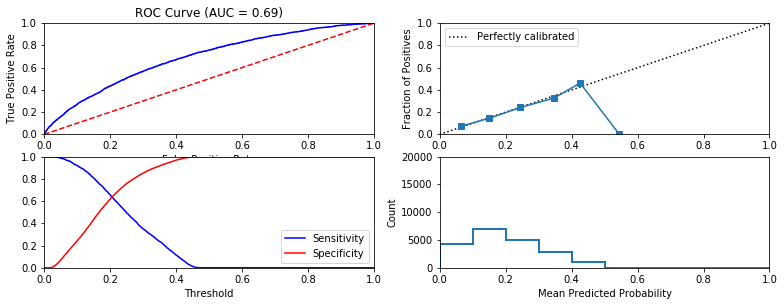


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



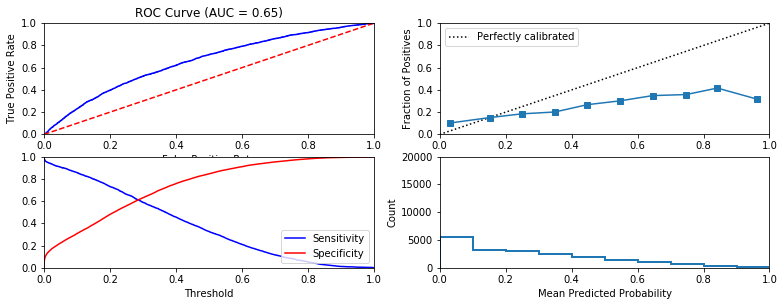


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.31 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



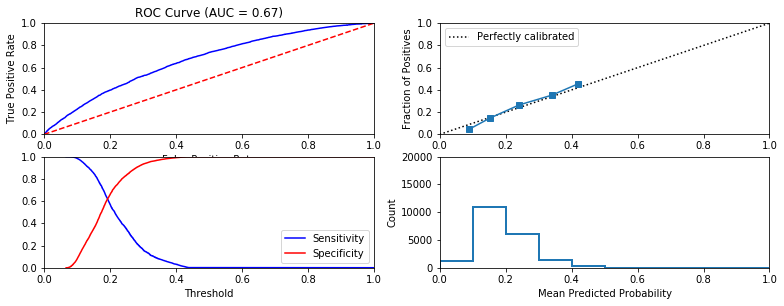


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.21 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



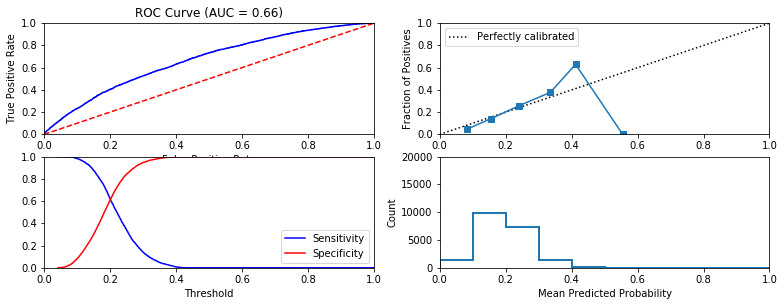


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



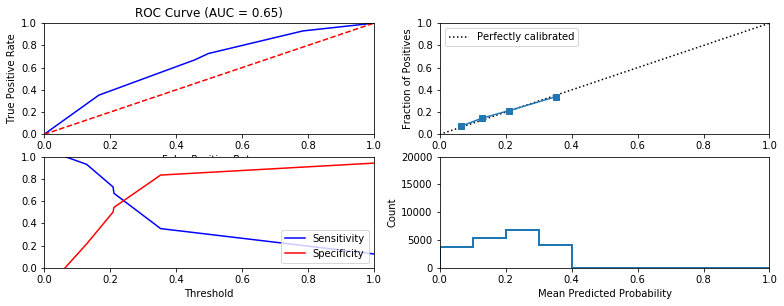


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.89 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



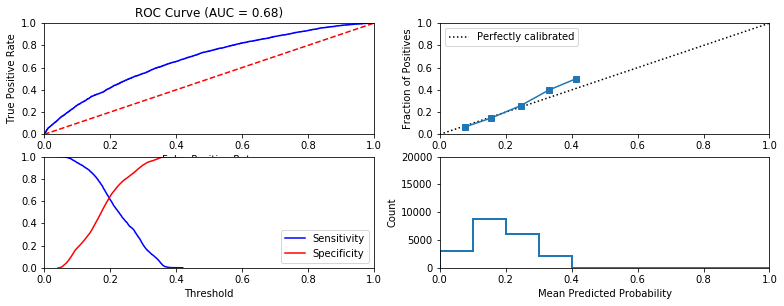


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.78 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



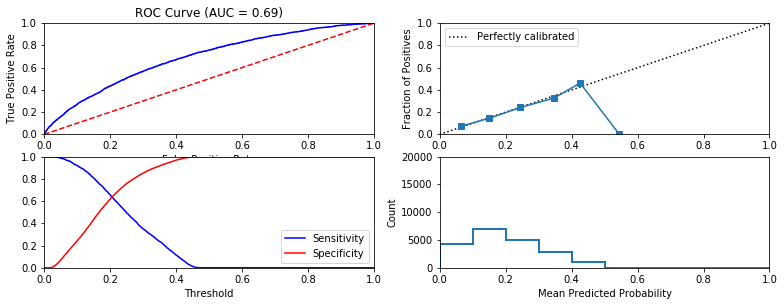


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



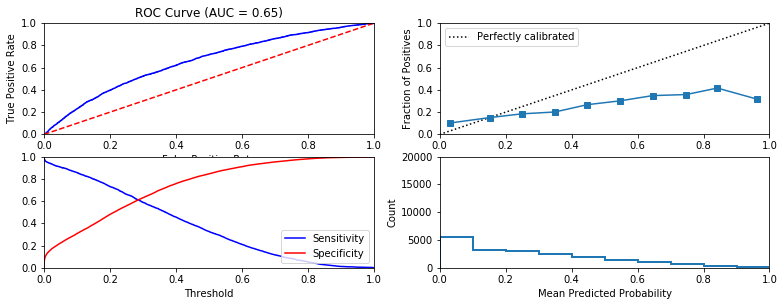


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.29 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



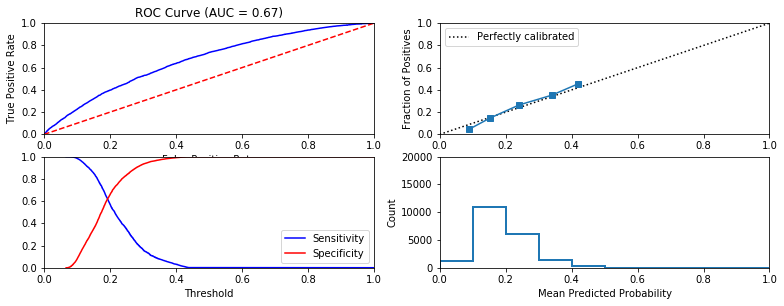


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.18 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



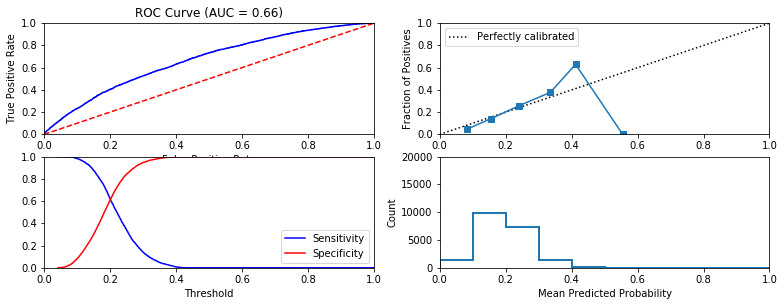


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.22 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



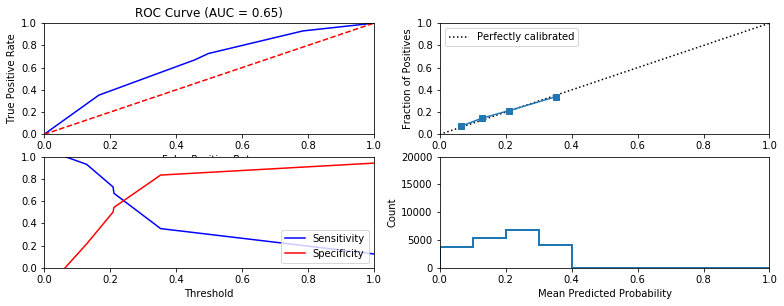


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.77 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



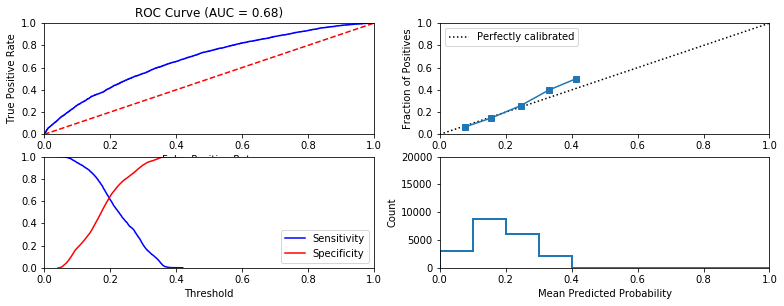


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 15.61 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



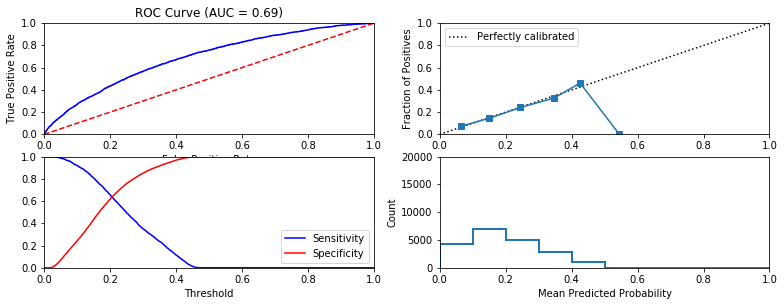


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



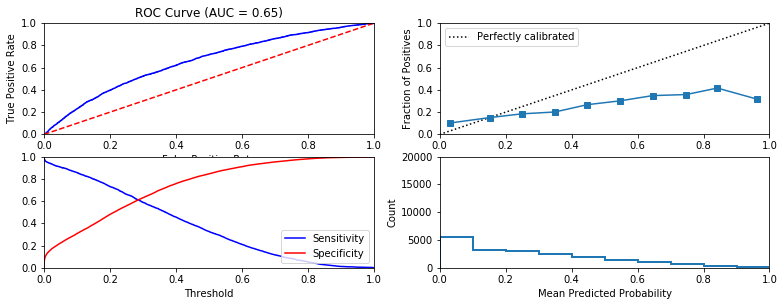


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



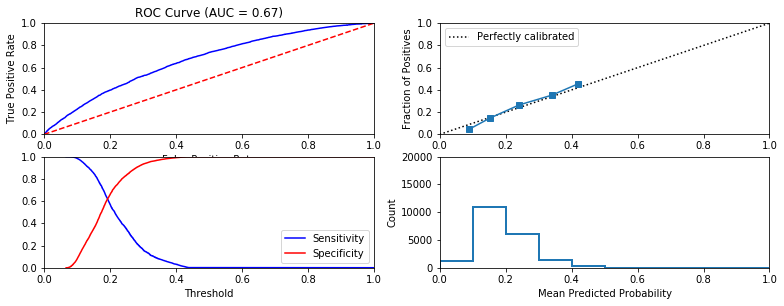


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.17 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



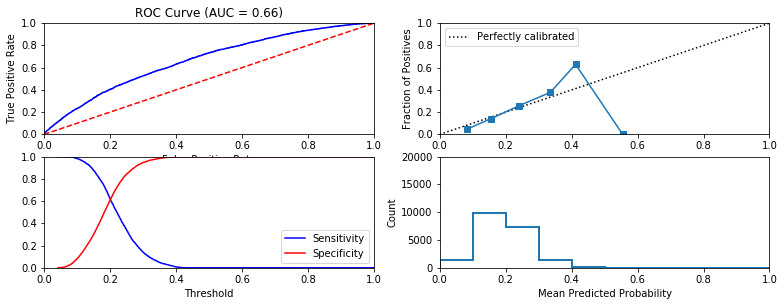


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



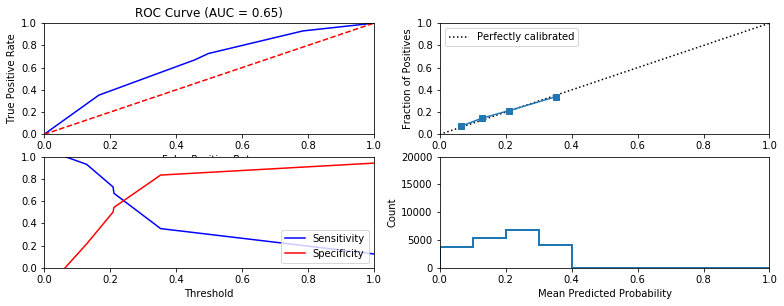


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.78 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



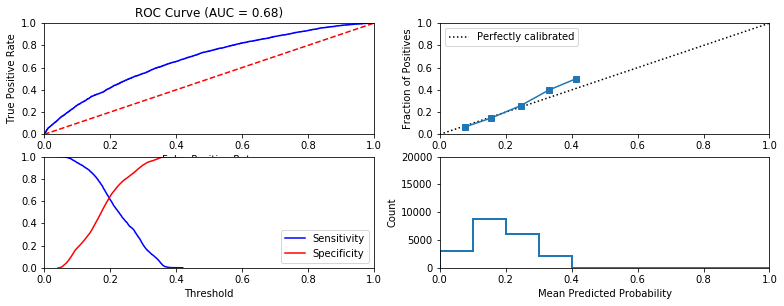


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.72 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



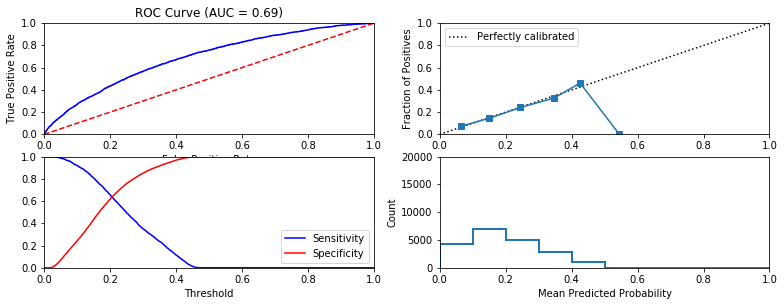


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: GNB
Fit time: 0.09 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



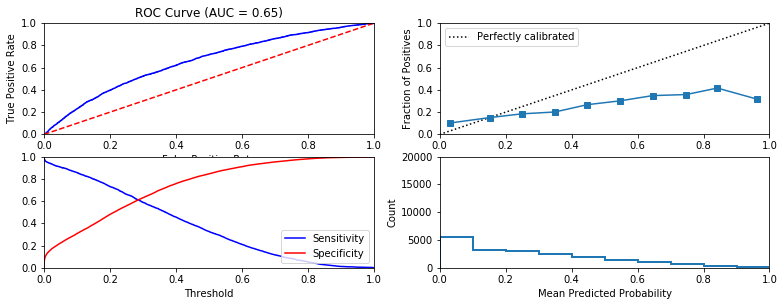


Similarity to LC grade ranking:  0.5666613898933162
Brier score: 0.178627408887228
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.74696667]
  Model: LC1_LOGIT
Fit time: 0.28 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.4364344845908716
Accuracy:  0.80505
             precision    recall  f1-score   support

 No default     0.8051    0.9998    0.8920     16097
    Default     0.7000    0.0018    0.0036      3903

avg / total     0.7846    0.8051    0.7186     20000



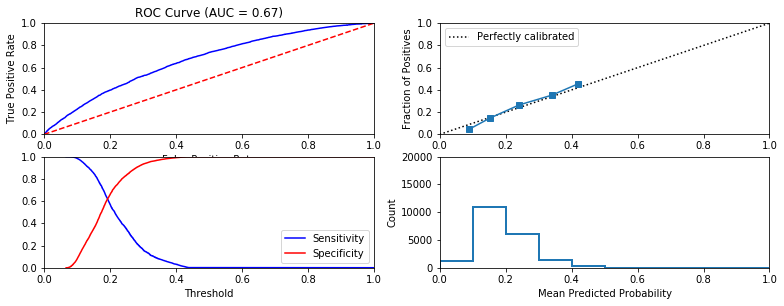


Similarity to LC grade ranking:  0.8421419846026605
Brier score: 0.14915993326697605
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: LC2_LOGIT
Fit time: 0.2 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.40694429031201185
Accuracy:  0.8053
             precision    recall  f1-score   support

 No default     0.8056    0.9993    0.8920     16097
    Default     0.6364    0.0054    0.0107      3903

avg / total     0.7726    0.8053    0.7200     20000



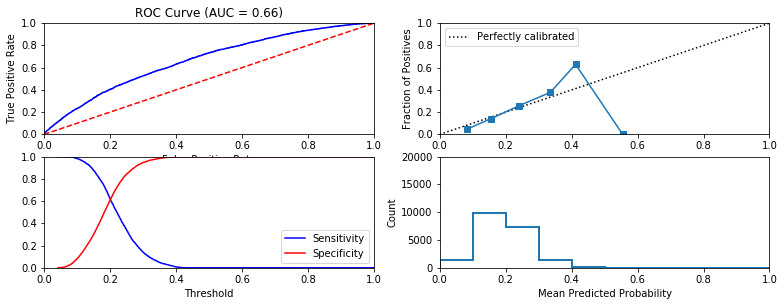


Similarity to LC grade ranking:  0.7593703271846298
Brier score: 0.14921035673534253
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: DECISION TREE
Fit time: 0.23 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 1
Accuracy:  0.80485
             precision    recall  f1-score   support

 No default     0.8048    1.0000    0.8919     16097
    Default     0.0000    0.0000    0.0000      3903

avg / total     0.6478    0.8048    0.7178     20000



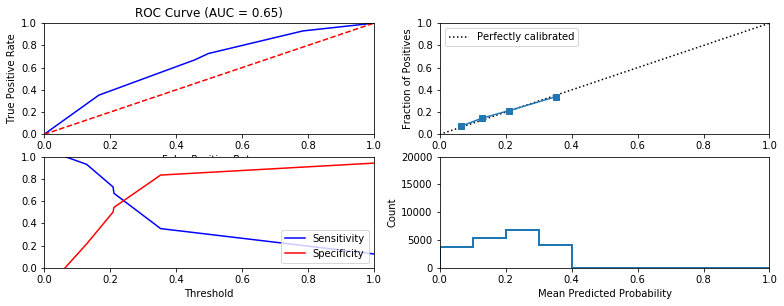


Similarity to LC grade ranking:  0.8289743768179657
Brier score: 0.14941700520284307
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: RANDOM FOREST
Fit time: 2.76 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.3593533361367014
Accuracy:  0.80495
             precision    recall  f1-score   support

 No default     0.8077    0.9943    0.8914     16097
    Default     0.5054    0.0238    0.0455      3903

avg / total     0.7487    0.8050    0.7263     20000



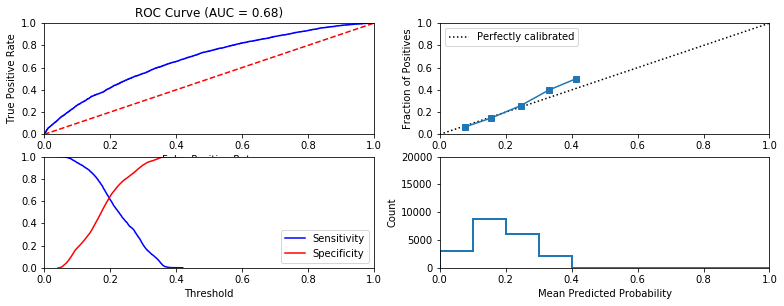


Similarity to LC grade ranking:  0.7157936292632473
Brier score: 0.1476957924731949
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]
  Model: MLP
Fit time: 14.63 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.44370077805348257
Accuracy:  0.80555
             precision    recall  f1-score   support

 No default     0.8077    0.9954    0.8918     16097
    Default     0.5432    0.0225    0.0433      3903

avg / total     0.7561    0.8055    0.7262     20000



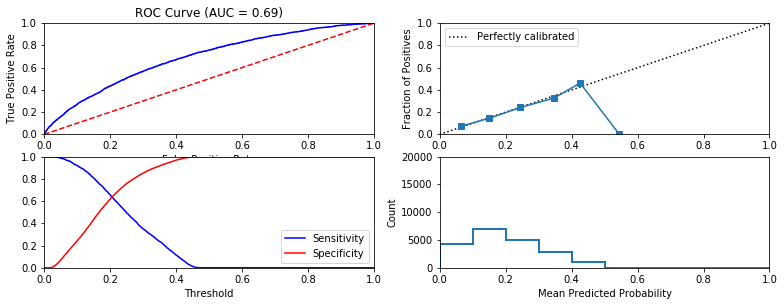


Similarity to LC grade ranking:  0.747023701166768
Brier score: 0.14594559035353388
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.8114]


In [147]:
seed_list = np.random.choice(10000,100)
for i in range(100):
    default_seed = seed_list[i]
    np.random.seed(seed)
    ## create the train columns where the value is True if it is a train instance and False otherwise. Hint: use np.random.choice with 70% for training and 30% for testing
#     mask = np.zeros([len(data)])
#     for i in range(mask.size):
#         mask[i] = int(np.random.choice(2,1,p=[0.3,0.7])) #1 for train, 0 for test
#     data['train'] = mask
#     data['train'] = data['train'].astype('bool')
    data['train'] = np.random.rand(len(data))<0.7
    # Create a matrix of features and outcomes, with dummies. Record the names of the dummies for later use
    X_continuous = data[continuous_features].values

    X_discrete = pd.get_dummies(data[discrete_features], dummy_na = True, prefix_sep = "::", drop_first = True)
    discrete_features_dummies = X_discrete.columns.tolist()
    X_discrete = X_discrete.values

    X = np.concatenate( (X_continuous, X_discrete), axis = 1 )

    y = data.outcome.values

    train = data.train.values
    
    
#     fit models
    gnb = GaussianNB()
    gnb = fit_classification(gnb,model_name="GNB",data_dict = prepare_data(feature_subset = features))
    lc1_logistic = LogisticRegression(C=0.01,penalty='l1')
    lc1_logistic = fit_classification(lc1_logistic,model_name="LC1_LOGIT",data_dict = prepare_data(feature_subset = features))
    lc2_logistic = LogisticRegression(C=0.01,penalty='l2')
    lc2_logistic = fit_classification(lc2_logistic,model_name="LC2_LOGIT",data_dict = prepare_data(feature_subset = features))
    decision_tree = DecisionTreeClassifier(max_depth=None,max_leaf_nodes = 5)
    decision_tree = fit_classification(decision_tree,model_name="DECISION TREE",data_dict = prepare_data(feature_subset = features))
    random_forest = RandomForestClassifier(max_depth = 5, n_estimators = 50)
    random_forest = fit_classification(random_forest,model_name="RANDOM FOREST",data_dict = prepare_data(feature_subset = features))
    mlp = MLPClassifier(activation='relu',alpha=0.05,hidden_layer_sizes = (50,100,50))
    mlp = fit_classification(mlp,model_name="MLP",data_dict = prepare_data(feature_subset = features))


## Time stability test of YOURMODEL

In [167]:
default_seed = 1

  Model: MLP
Fit time: 1.78 seconds
Optimal parameters:
{'alpha': 0.0001, 'hidden_layer_sizes': (50, 50)}

Accuracy-maximizing threshold was: 0.27856633059865255
Accuracy:  0.8217142857142857
             precision    recall  f1-score   support

 No default     0.8971    0.9043    0.9007      6260
    Default     0.1319    0.1230    0.1273       740

avg / total     0.8162    0.8217    0.8190      7000



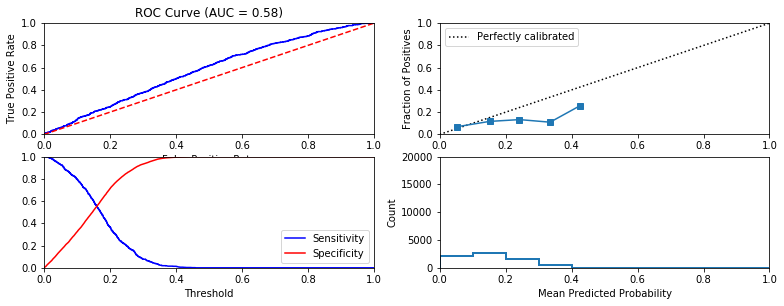


Similarity to LC grade ranking:  0.5976728459318894
Brier score: 0.10060777679518414
Were parameters on edge? : True
Score variations around CV search grid : 1.7857142857142874
[0.896 0.892 0.896 0.88 ]


In [159]:
## Define the time window of your train and test data
start_date_train = data[data['issue_d'].apply(lambda x: x.year)==2010].issue_d.min()
end_date_train = data[data['issue_d'].apply(lambda x: x.year)==2010].issue_d.max()
start_date_test = data[data['issue_d'].apply(lambda x: x.year)==2017].issue_d.min()
end_date_test = data[data['issue_d'].apply(lambda x: x.year)==2017].issue_d.max()

data_dict_test = prepare_data(date_range_train = (start_date_train, end_date_train), 
                         date_range_test = (start_date_test, end_date_test),
                         n_samples_train = 9000, n_samples_test = 7000, feature_subset = your_features)

## Train and test YOURMODEL using this data
mlp = MLPClassifier(activation='relu')
cv_parameters = {
    'hidden_layer_sizes': [(50,50), (50,100,50)],
    'alpha': [0.0001, 0.05],
}

mlp_2010 = fit_classification(mlp,model_name="MLP",cv_parameters = cv_parameters, data_dict =  data_dict_test)


  Model: MLP
Fit time: 10.87 seconds
Optimal parameters:
{'alpha': 0.0001, 'hidden_layer_sizes': (50, 50)}

Accuracy-maximizing threshold was: 0.45519885707367075
Accuracy:  0.8827142857142857
             precision    recall  f1-score   support

 No default     0.8918    0.9881    0.9375      6231
    Default     0.2292    0.0286    0.0509       769

avg / total     0.8190    0.8827    0.8401      7000



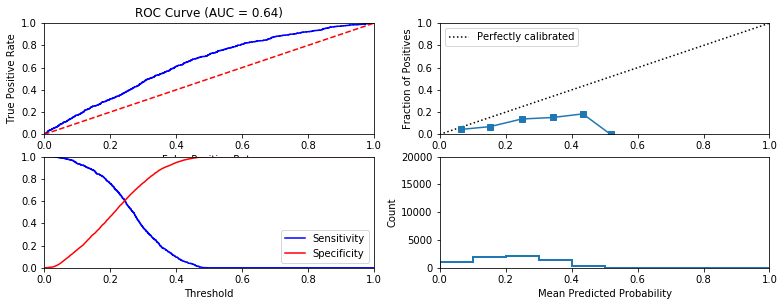


Similarity to LC grade ranking:  0.7162590711333129
Brier score: 0.11227731205916451
Were parameters on edge? : True
Score variations around CV search grid : 0.10079193664506689
[0.77166667 0.77111111 0.77111111 0.77088889]


In [160]:
## Define the time window of your train and test data
start_date_train = data[data['issue_d'].apply(lambda x: x.year)==2016].issue_d.min()
end_date_train = data[data['issue_d'].apply(lambda x: x.year)==2016].issue_d.max()
start_date_test = data[data['issue_d'].apply(lambda x: x.year)==2017].issue_d.min()
end_date_test = data[data['issue_d'].apply(lambda x: x.year)==2017].issue_d.max()

data_dict_test = prepare_data(date_range_train = (start_date_train, end_date_train), 
                         date_range_test = (start_date_test, end_date_test),
                         n_samples_train = 9000, n_samples_test = 7000, feature_subset = your_features)

## Train and test YOURMODEL using this data
mlp = MLPClassifier(activation='relu')
cv_parameters = {
    'hidden_layer_sizes': [(50,50), (50,100,50)],
    'alpha': [0.0001, 0.05],
}

mlp_2016 = fit_classification(mlp,model_name="MLP",cv_parameters = cv_parameters, data_dict = data_dict_test)

## Train and test YOURMODEL on the original data

In [189]:
full_features=['id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title', 'emp_length', 'home_ownership', 'annual_inc', 'verification_status', 'issue_d', 'loan_status', 'purpose', 'title', 'zip_code', 'addr_state', 'dti', 'total_pymnt', 'delinq_2yrs', 'earliest_cr_line', 'open_acc', 'pub_rec', 'last_pymnt_d', 'last_pymnt_amnt', 'fico_range_high', 'fico_range_low', 'last_fico_range_high', 'last_fico_range_low', 'application_type', 'revol_bal', 'revol_util', 'recoveries','outcome']

  Model: MLP
Fit time: 67.1 seconds
Optimal parameters:
{}

Accuracy-maximizing threshold was: 0.48502172920837355
Accuracy:  0.7781
             precision    recall  f1-score   support

 No default     0.8211    0.9260    0.8704     16097
    Default     0.3552    0.1681    0.2282      3903

avg / total     0.7302    0.7781    0.7451     20000



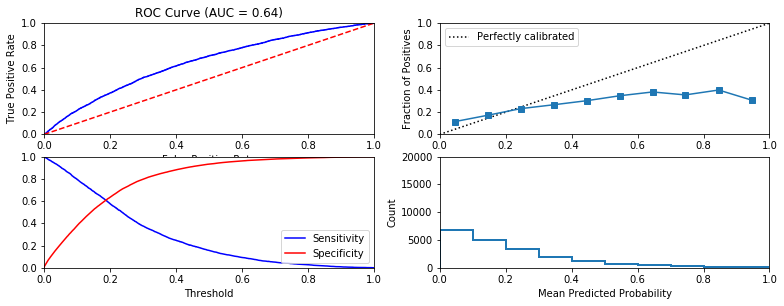


Similarity to LC grade ranking:  0.4440108371660221
Brier score: 0.16346435311236687
Were parameters on edge? : False
Score variations around CV search grid : 0.0
[0.777]


In [165]:
mlp_2016_new = MLPClassifier(activation='relu',alpha=0.0001,hidden_layer_sizes=(50,50))
mlp_2016_new = fit_classification(mlp_2016_new,model_name="MLP",data_dict = prepare_data(feature_subset = full_features))

## Test regression models

In [223]:
def fit_regression(model, data_dict,
                      cv_parameters = {},
                      separate = False, 
                      model_name = None,
                      random_state = default_seed,
                      output_to_file = True,
                      print_to_screen = True):
    '''
    This function will fit a regression model to data and print various evaluation
    measures. It expects the following parameters
      - model: an sklearn model object
      - data_dict: the dictionary containing both training and testing data;
                   returned by the prepare_data function
      - separate: a Boolean variable indicating whether we fit models for 
                  defaulted and non-defaulted loans separately
      - cv_parameters: a dictionary of parameters that should be optimized
                       over using cross-validation. Specifically, each named
                       entry in the dictionary should correspond to a parameter,
                       and each element should be a list containing the values
                       to optimize over      
      - model_name: the name of the model being fit, for printouts
      - random_state: the random seed to use
      - output_to_file: if the results will be saved to the output file
      - print_to_screen: if the results will be printed on screen
    
    This function returns a dictionary FOR EACH RETURN DEFINITION with the following entries
      - model: the best fitted model
      - predicted_return: prediction result based on the test set
      - predicted_regular_return: prediction result for non-defaulted loans (valid if separate == True)
      - predicted_default_return: prediction result for defaulted loans (valid if separate == True)
      - r2_scores: the testing r2_score(s) for the best fitted model
    '''
    
    np.random.seed(random_state)
    
    # --------------------------
    #   Step 1 - Load the data
    # --------------------------
    
    col_list = ['ret_PESS', 'ret_OPT', 'ret_INTa', 'ret_INTb']
    
    X_train = data_dict['X_train']
    filter_train = data_dict['train_set']  

    X_test = data_dict['X_test']
    filter_test = data_dict['test_set']
    out = {}
    
    for ret_col in col_list:
        
        y_train = data.loc[filter_train, ret_col].as_matrix()
        y_test = data.loc[filter_test, ret_col].as_matrix() 

        # --------------------------
        #   Step 2 - Fit the model
        # --------------------------

        if separate:
            outcome_train = data.loc[filter_train, 'outcome']
            outcome_test = data.loc[filter_test, 'outcome']

            # Train two separate regressors for defaulted and non-defaulted loans
            X_train_0 = X_train[outcome_train == False]
            y_train_0 = y_train[outcome_train == False]
            X_test_0 = X_test[outcome_test == False]
            y_test_0 = y_test[outcome_test == False]

            X_train_1 = X_train[outcome_train == True]
            y_train_1 = y_train[outcome_train == True]
            X_test_1 = X_test[outcome_test == True]
            y_test_1 = y_test[outcome_test == True]

            cv_model_0 = GridSearchCV(model, cv_parameters, scoring='r2')
            cv_model_1 = GridSearchCV(model, cv_parameters, scoring='r2')

            start_time = time.time()
            cv_model_0.fit(X_train_0, y_train_0)
            cv_model_1.fit(X_train_1, y_train_1)
            end_time = time.time()

            best_model_0 = cv_model_0.best_estimator_
            best_model_1 = cv_model_1.best_estimator_
            
            if print_to_screen:

                if model_name != None:
                    print("=========================================================")
                    print("  Model: " + model_name + "  Return column: " + ret_col)
                    print("=========================================================")

                print("Fit time: " + str(round(end_time - start_time, 2)) + " seconds")
                print("Optimal parameters:")
                print("model_0:",cv_model_0.best_params_, "model_1",cv_model_1.best_params_)

            predicted_regular_return = best_model_0.predict(X_test)
            predicted_default_return = best_model_1.predict(X_test)
            
            if print_to_screen:
                print("")
                print("Testing r2 scores:")
            # Here we use different testing set to report the performance
            test_scores = {'model_0':r2_score(y_test_0,best_model_0.predict(X_test_0)),
                              'model_1':r2_score(y_test_1,best_model_1.predict(X_test_1))}
            if print_to_screen:
                print("model_0:", test_scores['model_0'])
                print("model_1:", test_scores['model_1'])

            cv_objects = {'model_0':cv_model_0, 'model_1':cv_model_1}
            out[ret_col] = { 'model_0':best_model_0, 'model_1':best_model_1, 'predicted_regular_return':predicted_regular_return,
                      'predicted_default_return':predicted_default_return,'r2_scores':test_scores }

        else:
            cv_model = GridSearchCV(model, cv_parameters, scoring='r2')

            start_time = time.time()
            cv_model.fit(X_train, y_train)
            end_time = time.time()

            best_model = cv_model.best_estimator_
            
            if print_to_screen:
                if model_name != None:
                    print("=========================================================")
                    print("  Model: " + model_name + "  Return column: " + ret_col)
                    print("=========================================================")

                print("Fit time: " + str(round(end_time - start_time, 2)) + " seconds")
                print("Optimal parameters:")
                print(cv_model.best_params_)

            predicted_return = best_model.predict(X_test)
            test_scores = {'model':r2_score(y_test,predicted_return)}
            if print_to_screen:
                print("")
                print("Testing r2 score:", test_scores['model'])

            cv_objects = {'model':cv_model}
            out[ret_col] = {'model':best_model, 'predicted_return':predicted_return, 'r2_scores':r2_score(y_test,predicted_return)}

        # Output the results to a file
        if output_to_file:
            for i in cv_objects:
                # Check whether any of the CV parameters are on the edge of
                # the search space
                opt_params_on_edge = find_opt_params_on_edge(cv_objects[i])
                dump_to_output(model_name + "::" + ret_col + "::search_on_edge", opt_params_on_edge)
                if print_to_screen:
                    print("Were parameters on edge (" + i + ") : " + str(opt_params_on_edge))

                # Find out how different the scores are for the different values
                # tested for by cross-validation. If they're not too different, then
                # even if the parameters are off the edge of the search grid, we should
                # be ok
                score_variation = find_score_variation(cv_objects[i])
                dump_to_output(model_name + "::" + ret_col + "::score_variation", score_variation)
                if print_to_screen:
                    print("Score variations around CV search grid (" + i + ") : " + str(score_variation))

                # Print out all the scores
                dump_to_output(model_name + "::all_cv_scores", str(cv_objects[i].cv_results_['mean_test_score']))
                if print_to_screen:
                    print("All test scores : " + str(cv_objects[i].cv_results_['mean_test_score']) )

                # Dump the AUC to file
                dump_to_output( model_name + "::" + ret_col + "::r2", test_scores[i] )

    return out

### $l_1$ regularized linear regression

In [169]:
## First, trying l1 regularized linear regressrion with hyper-parameters

## trying l2 regularized linear regression with hyper-parameters

reg_lasso = linear_model.Lasso()

cv_parameters = {'alpha':[0.0001,0.001,0.01,0.1,1,10]}

reg_lasso = fit_regression(reg_lasso,data_dict = prepare_data(feature_subset = full_features), model_name = 'LASSO',cv_parameters = cv_parameters)

  Model: LASSO  Return column: ret_PESS
Fit time: 1.84 seconds
Optimal parameters:
{'alpha': 0.0001}

Testing r2 score: 0.02731592573072883
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -7.521982305416495
All test scores : [-0.11620151 -0.12494217 -0.12493542 -0.12493542 -0.12493542 -0.12493542]
  Model: LASSO  Return column: ret_OPT
Fit time: 2.84 seconds
Optimal parameters:
{'alpha': 0.0001}

Testing r2 score: 0.01896161929762974
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -99.48536593727329
All test scores : [-0.01208652 -0.0224516  -0.02411084 -0.02411084 -0.02411084 -0.02411084]
  Model: LASSO  Return column: ret_INTa
Fit time: 1.67 seconds
Optimal parameters:
{'alpha': 0.0001}

Testing r2 score: 0.028150221104133455
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -1.5619200965079116
All test scores : [-0.12018721 -0.12134177 -0.12206444 -0.12206444 -0.1220

### $l_2$ regularized linear regressor

In [168]:
## trying l2 regularized linear regression with hyper-parameters

reg_ridge = linear_model.Ridge()

cv_parameters = {'alpha':[0.0001,0.001,0.01,0.1,1,10]}

reg_ridge = fit_regression(reg_ridge,data_dict = prepare_data(feature_subset = full_features), model_name = 'RIDGE',cv_parameters = cv_parameters)

  Model: RIDGE  Return column: ret_PESS
Fit time: 1.25 seconds
Optimal parameters:
{'alpha': 10}

Testing r2 score: 0.028611562412888425
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -1.5714047304300454
All test scores : [-0.11710139 -0.11708925 -0.11704385 -0.11667235 -0.11566363 -0.11528972]
  Model: RIDGE  Return column: ret_OPT
Fit time: 0.82 seconds
Optimal parameters:
{'alpha': 0.01}

Testing r2 score: 0.01998759191581967
Were parameters on edge (model) : False
Score variations around CV search grid (model) : -5.498559696612901
All test scores : [-0.00983305 -0.00982872 -0.00982868 -0.00983365 -0.00987587 -0.01036911]
  Model: RIDGE  Return column: ret_INTa
Fit time: 0.89 seconds
Optimal parameters:
{'alpha': 10}

Testing r2 score: 0.030139131119849005
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -1.2971358894435723
All test scores : [-0.12082484 -0.12081032 -0.12078667 -0.12060387 -0.12014528 -0

### Multi-layer perceptron regressor

In [170]:
## trying multi-layer perceptron regression with hyper-parameters

reg_mlp = MLPRegressor(activation='relu')
cv_parameters = {
    'hidden_layer_sizes': [(50,50), (50,100,50)],
    'alpha': [0.0001, 0.05],
}

reg_mlp = fit_regression(reg_mlp,model_name="MLP REG",cv_parameters = cv_parameters, data_dict = prepare_data(feature_subset = full_features))



  Model: MLP REG  Return column: ret_PESS
Fit time: 20.67 seconds
Optimal parameters:
{'alpha': 0.05, 'hidden_layer_sizes': (50, 100, 50)}

Testing r2 score: 0.01852226743191676
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -74.10540628754256
All test scores : [-0.13152514 -0.16486073 -0.12024633 -0.09469019]
  Model: MLP REG  Return column: ret_OPT
Fit time: 22.58 seconds
Optimal parameters:
{'alpha': 0.05, 'hidden_layer_sizes': (50, 100, 50)}

Testing r2 score: 0.00807973669481854
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -321.36539612159373
All test scores : [-0.06232732 -0.03116261 -0.0326234  -0.01479175]
  Model: MLP REG  Return column: ret_INTa
Fit time: 21.78 seconds
Optimal parameters:
{'alpha': 0.05, 'hidden_layer_sizes': (50, 50)}

Testing r2 score: 0.029714411069508673
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -173.1964327230286
All test scor

### Random forest regressor

In [171]:
## trying random forest regression with hyper-parameters

reg_rf = RandomForestRegressor()

cv_parameters = {'n_estimators':[50,100,150],'max_depth':[None,5,10,15]}

reg_rf = fit_regression(reg_rf,model_name="RF REG",cv_parameters = cv_parameters, data_dict = prepare_data(feature_subset = full_features))

  Model: RF REG  Return column: ret_PESS
Fit time: 466.9 seconds
Optimal parameters:
{'max_depth': 10, 'n_estimators': 150}

Testing r2 score: 0.04667578529114025
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -39.638760705700875
All test scores : [-0.14902605 -0.13678415 -0.13470993 -0.11464894 -0.11339515 -0.11192247
 -0.11134928 -0.10820337 -0.10672256 -0.12571829 -0.11551731 -0.11573868]
  Model: RF REG  Return column: ret_OPT
Fit time: 472.27 seconds
Optimal parameters:
{'max_depth': 5, 'n_estimators': 150}

Testing r2 score: 0.02065191251988807
Were parameters on edge (model) : True
Score variations around CV search grid (model) : -360.333413291801
All test scores : [-0.06464496 -0.0529071  -0.04740826 -0.01559106 -0.01469811 -0.01404307
 -0.01829816 -0.0164955  -0.01521612 -0.03292872 -0.02739837 -0.02629258]
  Model: RF REG  Return column: ret_INTa
Fit time: 472.48 seconds
Optimal parameters:
{'max_depth': 10, 'n_estimators': 150}

Testi

## Test investment strategies 
Now we test several investment strategies using the learning models above

In [181]:
def test_investments(data_dict,
                        classifier = None,
                        regressor = None,
                        strategy = 'Random', 
                        num_loans = 1000,
                        random_state = default_seed,
                        output_to_file = True):
    '''
    This function tests a variety of investment methodologies and their returns. 
    It will run its tests on the loans defined by the test_set element of the data
    dictionary.
    
    It is currently able to test four strategies
      - random: invest in a random set of loans
      - default-based: score each loan by probability of default, and only invest
                 in the "safest" loans (i.e., those with the lowest probabilities
                 of default)
      - return-based: train a single regression model to predict the expected return
                    of loans in the past. Then, for loans we could invest in, simply
                    rank them by their expected returns and invest in that order.
      - default-& return-based: train two regression models to predict the expected return of
                   defaulted loans and non-defaulted loans in the training set. Then,
                   for each potential loan we could invest in, predict the probability
                   the loan will default, its return if it doesn't default and its
                   return if it does. Then, calculate a weighted combination of
                   the latter using the former to find a predicted return. Rank the
                   loans by this expected return, and invest in that order
    
    It expects the following parameters
      - data_dict: the dictionary containing both training and testing data;
                   returned by the prepare_data function
      - classifier: a fitted model object which is returned by the fit_classification function.
      - regressor: a fitted model object which is returned by the fit_regression function.
      - strategy: the name of the strategy; one of the three listed above
      - num_loans: the number of loans to be included in the test portfolio
      - num_samples: the number of random samples used to compute average return ()   
      - random_state: the random seed to use when selecting a subset of rows
      - output_to_file: if the results will be saved to the output file
      
    The function returns a dictionary FOR EACH RETURN DEFINITION with the following entries
      - strategy: the name of the strategy
      - average return: the return of the strategy based on the testing set
      - test data: the updated Dataframe of testing data. Useful in the optimization section
    '''
    
    np.random.seed(random_state)
    
    # Retrieve the rows that were used to train and test  the
    # classification model
    train_set = data_dict['train_set']
    test_set = data_dict['test_set']
    
    col_list = ['ret_PESS', 'ret_OPT', 'ret_INTa', 'ret_INTb']
    
    # Create a dataframe for testing, including the score
    data_test = data.loc[test_set,:]
    out = {}
    
    for ret_col in col_list:    
    
        if strategy == 'Random':
            # Randomize the order of the rows in the datframe
            data_test = data_test.sample(frac = 1).reset_index(drop = True)

            ## Select num_loans to invest in
            pf_test = data_test.sample(n=num_loans)

            ## Find the average return for these loans
            ret_test = pf_test[ret_col].mean()

            # Return
            out[ret_col] = {'strategy':strategy, 'average return':ret_test}

            # Dump the strategy performance to file
            if output_to_file:
                dump_to_output(strategy + "," + ret_col + "::average return", ret_test )

            continue
        
        elif strategy == 'Return-based':
            
            colname = 'predicted_return_' + ret_col 

            data_test[colname] = regressor[ret_col]['predicted_return']

            # Sort the loans by predicted return
            data_test = data_test.sort_values(by=colname, ascending = False).reset_index(drop = True)

            ## Pick num_loans loans
            pf_test = data_test.iloc[:num_loans,:]

            ## Find their return
            ret_test = pf_test[ret_col].mean()

            # Return
            out[ret_col] = {'strategy':strategy, 'average return':ret_test, 'test data':data_test}

            # Dump the strategy performance to file
            if output_to_file:
                dump_to_output(strategy + "," + ret_col + "::average return", ret_test )

            continue
            
        # Get the predicted scores, if the strategy is not Random or just Regression
        try:
            y_pred_score = classifier['y_pred_probs']
        except:
            y_pred_score = classifier['y_pred_score']

        data_test['score'] = y_pred_score


        if strategy == 'Default-based':
            # Sort the test data by the score
            data_test = data_test.sort_values(by='score').reset_index(drop = True)

            ## Select num_loans to invest in
            pf_test = data_test.iloc[:num_loans,:]

            ## Find the average return for these loans
            ret_test = pf_test[ret_col].mean()

            # Return
            out[ret_col] = {'strategy':strategy, 'average return':ret_test}

            # Dump the strategy performance to file
            if output_to_file:
                dump_to_output(strategy + "," + ret_col + "::average return", ret_test )

            continue


        elif strategy == 'Default-return-based':

            # Load the predicted returns
            data_test['predicted_regular_return'] = regressor[ret_col]['predicted_regular_return']
            data_test['predicted_default_return'] = regressor[ret_col]['predicted_default_return']

            # Compute expectation
            colname = 'predicted_return_' + ret_col 
            
            data_test[colname] = ( (1-data_test.score)*data_test.predicted_regular_return + 
                                             data_test.score*data_test.predicted_default_return )

            # Sort the loans by predicted return
            data_test = data_test.sort_values(by=colname, ascending = False).reset_index(drop = True)

            ## Pick num_loans loans
            pf_test = data_test.iloc[:num_loans,:]

            ## Find their return
            ret_test = pf_test[ret_col].mean()

            # Return
            out[ret_col] = {'strategy':strategy, 'average return':ret_test, 'test data':data_test}

            # Dump the strategy performance to file
            if output_to_file:
                dump_to_output(strategy + "," + ret_col + "::average return", ret_test )

            continue

        else:
            return 'Not a valid strategy'
        
    return out

In [182]:
## Test investment strategies using the best performing regressor

col_list = ['ret_PESS', 'ret_OPT', 'ret_INTa', 'ret_INTb']
test_strategy = 'Random'

print('strategy:',test_strategy)   
strat_rand = test_investments(data_dict = prepare_data(feature_subset = full_features),classifier = mlp_2016_new,regressor=reg_rf,strategy=test_strategy)

for ret_col in col_list:
    print(ret_col + ': ' + str(strat_rand[ret_col]['average return']))

strategy: Random
ret_PESS: -0.004403613356134849
ret_OPT: 0.03661450593838703
ret_INTa: 0.02278909577014669
ret_INTb: 0.06040573024473848


In [183]:
test_strategy = 'Default-based'

print('strategy:',test_strategy)
strat_def = test_investments(data_dict = prepare_data(feature_subset = full_features),classifier = mlp_2016_new,regressor=reg_rf,strategy=test_strategy)

for ret_col in col_list:
    print(ret_col + ': ' + str(strat_def[ret_col]['average return']))

strategy: Default-based
ret_PESS: 0.012481801327255997
ret_OPT: 0.044228057041013104
ret_INTa: 0.021545173394571432
ret_INTb: 0.05900725121024355


In [184]:
test_strategy = 'Return-based'

print('strategy:',test_strategy)
strat_ret = test_investments(data_dict = prepare_data(feature_subset = full_features),classifier = mlp_2016_new,regressor=reg_rf,strategy=test_strategy)

for ret_col in col_list:
    print(ret_col + ': ' + str(strat_ret[ret_col]['average return']))

strategy: Return-based
ret_PESS: 0.03493267516943509
ret_OPT: 0.04341710145798284
ret_INTa: 0.021273456019676413
ret_INTb: 0.05929600101675161


In [216]:
test_strategy = 'Default-return-based'

## For the Default-return-based strategy we need to fit a new regressor with separate = True
cv_parameters = {'n_estimators':[50,100,150],'max_depth':[None,5,10,15]}

reg_separate = RandomForestRegressor()


reg_separate = fit_regression(reg_separate,model_name="RF REG SEPARATE",separate=True,cv_parameters = cv_parameters, data_dict = prepare_data(feature_subset = full_features))

print('strategy:',test_strategy)
strat_defret = test_investments(data_dict = prepare_data(feature_subset = full_features),classifier = mlp_2016_new,regressor=reg_separate,strategy=test_strategy)

for ret_col in col_list:
    print(ret_col + ': ' + str(strat_defret[ret_col]['average return']))

  Model: RF REG SEPARATE  Return column: ret_PESS
Fit time: 435.28 seconds
Optimal parameters:
model_0: {'max_depth': 5, 'n_estimators': 100} model_1 {'max_depth': 5, 'n_estimators': 100}

Testing r2 scores:
model_0: 0.11409809380338609
model_1: 0.13608063552507021
Were parameters on edge (model_0) : False
Score variations around CV search grid (model_0) : -71.07268105062455
All test scores : [-0.58732923 -0.57483526 -0.55807007 -0.35316397 -0.34332147 -0.34630244
 -0.49486909 -0.48535892 -0.46978969 -0.54606056 -0.5321595  -0.51239891]
Were parameters on edge (model_1) : False
Score variations around CV search grid (model_1) : -28.673328837878415
All test scores : [-0.20673264 -0.1908396  -0.1877958  -0.16135655 -0.16066472 -0.16433049
 -0.16892504 -0.16670941 -0.16543711 -0.18904381 -0.182026   -0.17444015]
  Model: RF REG SEPARATE  Return column: ret_OPT
Fit time: 434.51 seconds
Optimal parameters:
model_0: {'max_depth': 5, 'n_estimators': 50} model_1 {'max_depth': 10, 'n_estimators

## Sensitivity test of portfolio size

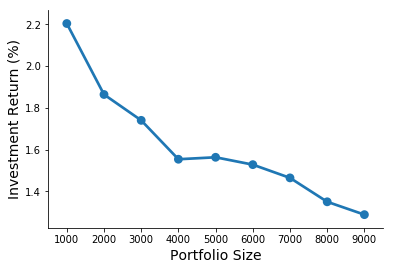

In [226]:
## Test the best-performing data-driven strategy on different portfolio sizes

result_sensitivity = []

## Vary the portfolio size from 1,000 to 10,000
for num_loans in list(range(1000,10000,1000)):

    reg_0 = test_investments(num_loans=num_loans,data_dict = prepare_data(feature_subset = full_features),classifier = mlp_2016_new,regressor=reg_separate,strategy='Default-return-based')
    result_sensitivity.append(reg_0['ret_PESS']['average return'])
    
result_sensitivity = np.array(result_sensitivity) * 100
sns.pointplot(np.array(list(range(1000,10000,1000))),result_sensitivity)
sns.despine()
plt.ylabel('Investment Return (%)',size = 14)
plt.xlabel('Portfolio Size',size = 14)
plt.show()

In [243]:
strat1_out_all = []
strat2_out_all = []
strat3_out_all = []
strat4_out_all = []

seed_list = np.random.choice(10000,100)
for i in range(100):
    default_seed = seed_list[i]
    np.random.seed(seed)
    ## create the train columns where the value is True if it is a train instance and False otherwise. Hint: use np.random.choice with 70% for training and 30% for testing
#     mask = np.zeros([len(data)])
#     for i in range(mask.size):
#         mask[i] = int(np.random.choice(2,1,p=[0.3,0.7])) #1 for train, 0 for test
#     data['train'] = mask
#     data['train'] = data['train'].astype('bool')
    data['train'] = np.random.rand(len(data))<0.7
    # Create a matrix of features and outcomes, with dummies. Record the names of the dummies for later use
    X_continuous = data[continuous_features].values

    X_discrete = pd.get_dummies(data[discrete_features], dummy_na = True, prefix_sep = "::", drop_first = True)
    discrete_features_dummies = X_discrete.columns.tolist()
    X_discrete = X_discrete.values

    X = np.concatenate( (X_continuous, X_discrete), axis = 1 )

    y = data.outcome.values

    train = data.train.values
    
    
#     fit models
    strat_out_1 = test_investments(data_dict = prepare_data(feature_subset = full_features),classifier = mlp_2016_new,regressor=reg_rf,strategy='Random') 
    strat_out_2 = test_investments(data_dict = prepare_data(feature_subset = full_features),classifier = mlp_2016_new,regressor=reg_rf,strategy='Return-based')
    strat_out_3 = test_investments(data_dict = prepare_data(feature_subset = full_features),classifier = mlp_2016_new,regressor=reg_rf,strategy='Default-based')
    strat_out_4 = test_investments(data_dict = prepare_data(feature_subset = full_features),classifier = mlp_2016_new,regressor=reg_separate,strategy='Default-return-based')
    strat1_out_all.append(strat_out_1)
    strat2_out_all.append(strat_out_2)
    strat3_out_all.append(strat_out_3)
    strat4_out_all.append(strat_out_4)

In [248]:
stra_list = [strat1_out_all, strat2_out_all, strat3_out_all, strat4_out_all]
col_list = ['ret_PESS', 'ret_OPT', 'ret_INTa', 'ret_INTb']
for stra in stra_list:
    for r in col_list:
        avg_return = [i[r]['average return'] for i in stra]
        avg = np.mean(avg_return)
        print('Strategy: ',stra[0][r]['strategy'], ' & Return: ', r, ' ',str(avg))

Strategy:  Random  & Return:  ret_PESS   -0.004403613356134851
Strategy:  Random  & Return:  ret_OPT   0.03661450593838703
Strategy:  Random  & Return:  ret_INTa   0.022789095770146695
Strategy:  Random  & Return:  ret_INTb   0.0604057302447385
Strategy:  Return-based  & Return:  ret_PESS   0.034932675169435094
Strategy:  Return-based  & Return:  ret_OPT   0.04341710145798285
Strategy:  Return-based  & Return:  ret_INTa   0.021273456019676423
Strategy:  Return-based  & Return:  ret_INTb   0.05929600101675161
Strategy:  Default-based  & Return:  ret_PESS   0.012481801327256
Strategy:  Default-based  & Return:  ret_OPT   0.04422805704101312
Strategy:  Default-based  & Return:  ret_INTa   0.021545173394571425
Strategy:  Default-based  & Return:  ret_INTb   0.059007251210243555
Strategy:  Default-return-based  & Return:  ret_PESS   0.022039124944332217
Strategy:  Default-return-based  & Return:  ret_OPT   0.043063324229720985
Strategy:  Default-return-based  & Return:  ret_INTa   0.0271098